# NBextensions
Not a necessary step!<br>
Use "conda install -c conda-forge jupyter_contrib_nbextensions jupyter_nbextensions_configurator" to see table of contents

In [1]:
%matplotlib notebook
%config IPCompleter.greedy=True
#unset PYTHONHOME; . /usr/local/share/Anaconda2/bin/activate python3;
#conda activate SilSpeech

from IPython.core.interactiveshell import InteractiveShell
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
InteractiveShell.ast_node_interactivity = "all"


# Function definition
Functions taken from others, you should specify ```save_dir``` (saves some figures) ```base_dir```, it is expected that directory structure is the same as in original data, i.e.

/session1/Session1_filtered_bio_data.npz<br>
/session1/audio.wav<br>
/session1/Session1_audio_trgr_mat.npz

If ```VISUALIZE``` set to False, some cells will not show anything (not perfect yet)

In [4]:
VISUALIZE = True

#base_dir = "/mnt/matylda6/szoke/SILENT_SPEECH/DATA/HoneyWell_pilot"
base_dir = "../Downloads/silent_data"
save_dir = "../Downloads/silent_data/visual"


import numpy as np
#import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import re
from scipy import stats
import os.path as path
from scipy.io import wavfile
import xlrd as xls
import os
from IPython.display import Audio
import scipy as sp
import scipy.fftpack
from pathlib import Path



def get_trial_desc(fname, wsh_idx=0):
    # Opening the excel desc workbook and worksheet ...
    desc_wb = xls.open_workbook(fname)
    desc_wsh = desc_wb.sheet_by_index(wsh_idx)
    
    # reading the data into a dictionary of lists ...
    data_table = {desc_wsh.cell(0,c_idx).value:[desc_wsh.cell(r_idx,c_idx).value
            for r_idx in range(1,desc_wsh.nrows)] for c_idx in range(desc_wsh.ncols)}
    
    # closing the workbook ...
    desc_wb.release_resources()
    del desc_wb
    #####################################################
    return data_table


def segment_bio_signal(EEG, EMG, Trgr, data_table):
    # getting triger edges ......
    trgr_edges = np.int32(Trgr[0,1:]) - np.int32(Trgr[0,:-1])
    trgr_edges = np.insert(trgr_edges,0,0)
    onset_idxs = np.where(trgr_edges!=0)[0]
    
    # getting trigger values ......
    trgr_vals = Trgr[:,onset_idxs]
    trgr_vals = np.reshape(trgr_vals,trgr_vals.shape[-1])
    
    # removing zero valued triggers and onsets .....
    onset_idxs = np.delete(onset_idxs,np.where(trgr_vals==0))
    trgr_vals = np.delete(trgr_vals,np.where(trgr_vals==0))
    
    # froming ordered pairs of trgr values and onsets .....
    onset_mat = np.reshape(onset_idxs,[int(onset_idxs.shape[0]/2),2])
    trgr_mat = np.reshape(trgr_vals,[int(trgr_vals.shape[0]/2),2])
    
    SEG_EEG = [EEG[:,onset_mat[r_idx,0]:onset_mat[r_idx,1]] for r_idx in range(onset_mat.shape[0])]
    SEG_EMG = [EMG[:,onset_mat[r_idx,0]:onset_mat[r_idx,1]] for r_idx in range(onset_mat.shape[0])]
    #data_table['biosemi_trgrs'] = trgr_mat
    #trigger_dict = {'trgr_mat':trgr_mat, 'trgr_vals': trgr_mat}
    
    #####################################################
    return SEG_EEG, SEG_EMG, trgr_mat, onset_idxs.reshape((-1,2)), data_table

def framing(a, window, shift=1):
    shape = ((a.shape[0] - window) // shift + 1, window) + a.shape[1:]
    strides = (a.strides[0]*shift,a.strides[0]) + a.strides[1:]
    return np.lib.stride_tricks.as_strided(a, shape=shape, strides=strides)



def exp_context_append(context, wav_melbanks, add_vect):
    fr=0
    frame_len=np.shape(wav_melbanks)[1];
    add_len=np.shape(add_vect)[0];    
    frame_len_stac=(context*2+1)*frame_len+add_len;
    wav_melbanks_stacked=np.zeros((np.shape(wav_melbanks)[0],frame_len_stac));
    frame=np.hstack((np.tile(wav_melbanks[fr,:],context).T, np.reshape(wav_melbanks[fr:(context+1),:],((context+1)*frame_len)).T))
    wav_melbanks_stacked[fr]=np.append(np.reshape(np.reshape(frame.T,[context*2+1,frame_len]),-1,order='F'),np.reshape(add_vect,-1))
    for fr in range(1,np.shape(wav_melbanks)[0]):
        frame=np.roll(frame,-frame_len,axis=0)
        pom=fr+context
        if pom >= np.shape(wav_melbanks)[0]:
            pom=np.shape(wav_melbanks)[0]-1
        frame[frame_len_stac-frame_len-add_len:frame_len_stac-add_len]=wav_melbanks[pom,:]
        wav_melbanks_stacked[fr]=np.append(np.reshape(np.reshape(frame.T,[context*2+1,frame_len]),-1,order='F'),np.reshape(add_vect,-1))
        #print fr, pom, frame_len_stac-frame_len ;
    return wav_melbanks_stacked

def mel_inv(x):
    return (np.exp(x/1127.)-1.)*700.

def mel(x):
    return 1127.*np.log(1. + x/700.)

def preemphasis(x, coef=0.97):
    return x - np.c_[x[..., :1], x[..., :-1]] * coef

def mel_fbank_mx(winlen_nfft, fs, NUMCHANS=20, LOFREQ=0.0, HIFREQ=None,  warp_fn=mel, inv_warp_fn=mel_inv):
    """Returns mel filterbank as an array (NFFT/2+1 x NUMCHANS)
    winlen_nfft - Typically the window length as used in mfcc_htk() call. It is
                  used to determine number of samples for FFT computation (NFFT).
                  If positive, the value (window lenght) is rounded up to the
                  next higher power of two to obtain HTK-compatible NFFT.
                  If negative, NFFT is set to -winlen_nfft. In such case, the
                  parameter nfft in mfcc_htk() call should be set likewise.
    fs          - sampling frequency (Hz, i.e. 1e7/SOURCERATE)
    NUMCHANS    - number of filter bank bands
    LOFREQ      - frequency (Hz) where the first filter strats
    HIFREQ      - frequency (Hz) where the last  filter ends (default fs/2)
    warp_fn     - function for frequency warping and its inverse
    inv_warp_fn - inverse function to warp_fn
    """

    if not HIFREQ: HIFREQ = 0.5 * fs
    nfft = 2**int(np.ceil(np.log2(winlen_nfft))) if winlen_nfft > 0 else -int(winlen_nfft)

    fbin_mel = warp_fn(np.arange(nfft / 2 + 1, dtype=float) * fs / nfft)
    cbin_mel = np.linspace(warp_fn(LOFREQ), warp_fn(HIFREQ), NUMCHANS + 2)
    cind = np.floor(inv_warp_fn(cbin_mel) / fs * nfft).astype(int) + 1
    mfb = np.zeros((len(fbin_mel), NUMCHANS))
    for i in range(NUMCHANS):
        mfb[cind[i]  :cind[i+1], i] = (cbin_mel[i]  -fbin_mel[cind[i]  :cind[i+1]]) / (cbin_mel[i]  -cbin_mel[i+1])
        mfb[cind[i+1]:cind[i+2], i] = (cbin_mel[i+2]-fbin_mel[cind[i+1]:cind[i+2]]) / (cbin_mel[i+2]-cbin_mel[i+1])
    if LOFREQ > 0.0 and float(LOFREQ)/fs*nfft+0.5 > cind[0]: mfb[cind[0],:] = 0.0 # Just to be HTK compatible
    return mfb

def fbank_htk(x, window, noverlap, fbank_mx, nfft=None, _E=None,
             USEPOWER=False, RAWENERGY=True, PREEMCOEF=0.97, ZMEANSOURCE=False,
             ENORMALISE=True, ESCALE=0.1, SILFLOOR=50.0, USEHAMMING=True):
    """Mel log Mel-filter bank channel outputs
    Returns NUMCHANS-by-M matrix of log Mel-filter bank outputs extracted form
    signal x, where M is the number of extracted frames, which can be computed
    as floor((length(x)-noverlap)/(window-noverlap)). Remaining parameters
    have the following meaning:
    x         - input signal
    window    - frame window lentgth (in samples, i.e. WINDOWSIZE/SOURCERATE)
                or vector of widow weights override default windowing function
                (see option USEHAMMING)
    noverlap  - overlapping between frames (in samples, i.e window-TARGETRATE/SOURCERATE)
    fbank_mx  - array with (Mel) filter bank (as returned by function mel_fbank_mx()).
                Note that this must be compatible with the parameter 'nfft'.
    nfft      - number of samples for FFT computation. By default, it is  set in the
                HTK-compatible way to the window length rounded up to the next higher
                pover of two.
    _E        - include energy as the "first" or the "last" coefficient of each
                feature vector. The possible values are: "first", "last", None.

    Remaining options have exactly the same meaning as in HTK.

    See also:
      mel_fbank_mx:
          to obtain the matrix for the parameter fbank_mx
      add_deriv:
          for adding delta, double delta, ... coefficients
      add_dither:
          for adding dithering in HTK-like fashion
    """
    from time import time
    tm = time()
    if type(USEPOWER) == bool:
        USEPOWER += 1
    if np.isscalar(window):
        window = np.hamming(window) if USEHAMMING else np.ones(window)
    if nfft is None:
        nfft = 2**int(np.ceil(np.log2(window.size)))
    x = framing(x.astype("float"), window.size, window.size-noverlap).copy()
    if ZMEANSOURCE:
        x -= x.mean(axis=1)[:,np.newaxis]
    if _E is not None and RAWENERGY:
        energy = np.log((x**2).sum(axis=1))
    if PREEMCOEF is not None:
        x = preemphasis(x, PREEMCOEF)
    #print(x.shape)
    #print(window.shape)
    x *= window
    if _E is not None and not RAWENERGY:
        energy = np.log((x**2).sum(axis=1))
    #x = np.abs(scipy.fftpack.fft(x, nfft))
    #x = x[:,:x.shape[1]/2+1]
    x = np.fft.rfft(x, nfft)
    #x = np.abs(x)
    x = x.real**2 + x.imag**2
    if USEPOWER != 2:
        x **= 0.5 * USEPOWER
    x = np.log(np.maximum(1.0, np.dot(x, fbank_mx)))
    if _E is not None and ENORMALISE:
        energy = (energy - energy.max())       * ESCALE + 1.0
        min_val  = -np.log(10**(SILFLOOR/10.)) * ESCALE + 1.0
        energy[energy < min_val] = min_val

    return np.hstack(([energy[:,np.newaxis]] if _E == "first" else []) + [x] +
                     ([energy[:,np.newaxis]] if (_E in ["last", True])  else []))


def get_aud_fea(wav, fs):
    #wav = wav / np.max([np.max(wav), -1.0*np.min(wav.astype("float"))])*32768.0;
    print(fs)
    if fs==8000:
        fbanks=mel_fbank_mx(256,fs,24,0,fs//2);
    if fs==16000:
        fbanks=mel_fbank_mx(512,fs,24,0,fs//2);
    if fs==44100:
        fbanks=mel_fbank_mx(2048,fs,24,0,fs//2);
    wav_melbanks=fbank_htk(wav,fs//1000*25,fs//1000*15,fbanks,USEPOWER=2,RAWENERGY=False,PREEMCOEF=0.00)
    sha= np.shape(wav_melbanks)    
    norms=wav_melbanks.sum(axis=0, keepdims=True)
    mean = norms/sha[0]
    wav_melbanks=wav_melbanks-mean;
    return wav_melbanks

def get_bio_fea(bio, fs):
    #wav = wav / np.max([np.max(wav), -1.0*np.min(wav.astype("float"))])*32768.0;
    if fs==2048:
        fbanks=mel_fbank_mx(64,fs,20,0,fs//2);
    if fs==16000:
        fbanks=mel_fbank_mx(512,fs,20,0,fs//2);
    if fs==44100:
        fbanks=mel_fbank_mx(2048,fs,24,0,fs//2);
    wav_melbanks=fbank_htk(wav,fs//1000*30,fs//1000*20,fbanks,USEPOWER=2,RAWENERGY=False,PREEMCOEF=0.00)
    sha= np.shape(wav_melbanks)    
    norms=wav_melbanks.sum(axis=0, keepdims=True)
    mean = norms/sha[0]
    wav_melbanks=wav_melbanks-mean;
    return wav_melbanks


def get_spect(data, window, overlap, use_log = True, take_only_first_coef = None):
    f = ((lambda x: np.log(x)) if use_log else (lambda x: x))
    return np.concatenate([(f(np.abs(spectrogram(x, window, overlap)[:,:take_only_first_coef]))) for x in data], axis = 1)


def get_bio_mel_bank(data, window, overlap, num_banks = 10, fs = 2048, HIFREQ = None):
    fbank_mx= mel_fbank_mx(window, fs=fs, NUMCHANS=num_banks, HIFREQ=HIFREQ)
    return np.concatenate([(fbank_htk(x, window, overlap, fbank_mx, USEPOWER=False, PREEMCOEF=None, ZMEANSOURCE=True)) for x in data], axis = 1)


def get_aud_mel_bank(data, window, overlap, num_banks = 20, fs = 8000, HIFREQ = None):
    fbank_mx= mel_fbank_mx(window, fs=fs, NUMCHANS=num_banks, HIFREQ=HIFREQ)
    return np.concatenate([(fbank_htk(x, window, overlap, fbank_mx, USEPOWER=False, PREEMCOEF=None, ZMEANSOURCE=True)) for x in data], axis = 1)




def spectrogram(x, window, noverlap=None, nfft=None, ZMEANSOURCE=False, PREEMCOEF=None):
    if np.isscalar(window): window = np.hamming(window)
    if noverlap is None:    noverlap = window.size / 2
    if nfft     is None:    nfft     = window.size
    x = framing(x, window.size, window.size-noverlap)
    if ZMEANSOURCE:
        x = x - x.mean(axis=1)[:,np.newaxis]
    if PREEMCOEF is not None:
        x = preemphasis(x, PREEMCOEF)
    x = scipy.fftpack.fft(x*window, nfft)
    return x[:,:int(x.shape[1]/2+1)]

def specgram2sig(sg, window, noverlap=None, nfft=None):
    """Reconstruct signal from spectrogram SG. WINDOW and NOVERLAP should be the same
   as the parameters passed to the function specgram while computating SG.

     Example:
       sr, sig_in = scipy.io.wavfile.read('test8kHz.wav')
       sg = spectrogram(sig_in, np.hanning(256), 128)
       sig_out = specgram2sig(sg, 256, 128)
     The sinal sig_out should be almost identical to sig_in.

     See also spectrogram."""
    window = np.array(window).ravel()
    winlen = len(window)
    if winlen == 1:
        winlen = window[0]
        window = 1.0;
    if noverlap is None: noverlap = winlen // 2
    if nfft     is None: nfft     = winlen
    sig=np.zeros(len(sg)*(winlen-noverlap)+noverlap)
    for i, spec in enumerate(sg):
        frmSig = np.real(scipy.fftpack.ifft(np.r_[spec, np.conjugate(spec[(nfft-1)//2:0:-1])], nfft))
        frmStrt = i * (winlen-noverlap);
        sig[frmStrt:frmStrt+winlen] = sig[frmStrt:frmStrt+winlen] + frmSig[:winlen] * window;
    return sig

def play_audio(data, autoplay = True):
    display(Audio(data, rate = AUD_fs, autoplay=autoplay))


# Load and segment recordings
Loads and segments <b>Audio</b>, <b>EEG</b> and <b>EMG</b>. 

If ```use_8k_audio``` is specify, it downsamples the audio using <b>sox</b> and saves in the same directory, ```use_corrected_bio_trigger_segmentation``` causes a recalculation of audio triggers based on BIO data triggers.



## Load directly - function definitions

In [5]:
sessionid = "1"
use_8k_audio = True

use_corrected_bio_trigger_segmentation = True
correct_orig_aud_fs = 44104

def load_and_segment_data(sessionid, use_8k_audio, use_corrected_bio_trigger_segmentation, correct_orig_aud_fs, use_audio = True):
    sessionid = str(sessionid)
    BIO=np.load(base_dir + "/session"+sessionid+"/Session"+sessionid+"_filtered_bio_data.npz"); #print(BIO.files)
    data_table=get_trial_desc(base_dir + "/session"+sessionid+"/Session"+sessionid+".xlsx")
    #data_table=get_trial_desc(base_dir + "trial_summary_20181224_215657_UO.xlsx")

    SEG_EEG,SEG_EMG,BIO_TRG_val,BIO_TRG_ind, BIO_DATA=segment_bio_signal(BIO["EEG"], BIO["EMG"], BIO["Trgr"], data_table)
    #BIO_TRG_ind, BIO_TRG_val= BIO_TRG_ind.tolist(), BIO_TRG_val.tolist()
    BIO_fs= BIO['fs']
    EEG_L = BIO["EEG_ch_L"]
    EMG_L = BIO["EMG_ch_L"]
    BIO_EEG=np.array(BIO["EEG"])
    BIO_EMG=np.array(BIO["EMG"])
    #BIO_EEG=np.array(session_BIO["EEG"])
    #BIO_EMG=np.array(session_BIO["EMG"])


    #TODO: resample bio signal if needed either resample or sox

    #from scipy import signal
    #BIO_EMG=np.zeros([np.shape(BIO_EMG_orig)[0],int(np.shape(BIO_EMG_orig)[1]/BIO_fs*1000.0)])
    #print(np.shape(BIO_EMG_orig))
    #print(np.shape(BIO_EMG))
    #for i in range(np.shape(BIO_EMG_orig)[0]):
    #    BIO_EMG[i,:]=signal.resample(BIO_EMG_orig[i,:],np.shape(BIO_EMG)[1])

    if use_audio:
        if use_8k_audio:
            # creates new downsampled file, you should have permission to write into new_wav
            new_wav = base_dir + "/session" + sessionid+ "/Session"+sessionid+"_8kHz.wav"
            old_wav = base_dir + "/session" + sessionid + "/audio.wav"    
            #TODO use resample from scipy?
            if not Path(new_wav).is_file():
                !sox {old_wav} {new_wav} channels 1 rate 8k 

            AUD_fs, AUD_wav = wavfile.read(new_wav, 'r')
            AUD_wav = AUD_wav.reshape(-1,1) # just to get matrix from vector
        else:
            AUD_fs, AUD_wav = wavfile.read(base_dir + "/session" + sessionid + "/audio.wav", 'r')
            AUD_fs = correct_orig_aud_fs 
        AUD_wav = AUD_wav / np.max([np.max(AUD_wav), -1.0*np.min(AUD_wav.astype("float"))])*32768.0;
        AUD_wav = AUD_wav.T


        pom =np.load(base_dir + "/session"+sessionid+"/Session"+sessionid+"_audio_trgr_mat.npz");
        data_len = min(len(pom["atrgr_mat"]),len(BIO_TRG_ind))

             
        if use_corrected_bio_trigger_segmentation:
            # computes the shift between audio and bio in ms
            shift = np.round(1000*(((pom["atrgr_mat"].astype("float")-pom["atrgr_mat"][0,1])/float(correct_orig_aud_fs))[:data_len] -((BIO_TRG_ind.astype("float")-BIO_TRG_ind[0,1])/BIO_fs)[:data_len]))
            #print(shift)
            # Audio triggers are recomputed from bio triggers,
            # exact time shift is computed based on the mode (in ms) of ends of all trials
            aud_trigger = np.round(pom["atrgr_mat"][0][1] + float(stats.mode(shift[:,1])[0][0]) * correct_orig_aud_fs / 1000  + (BIO_TRG_ind - BIO_TRG_ind[0][1]) * float(correct_orig_aud_fs) / BIO_fs)
        else:
            aud_trigger = pom["atrgr_mat"] # original audio triggers

        #AUD_TRG_ind=int(aud_trigger/(44100/8000))
        if use_8k_audio:    
            AUD_TRG_ind=(np.array(aud_trigger)/(float(correct_orig_aud_fs)/AUD_fs))
        else:
            AUD_TRG_ind=(np.array(aud_trigger))
        AUD_TRG_ind=AUD_TRG_ind.astype('int')


        SEG_AUD  = [AUD_wav[:,AUD_TRG_ind[r_idx,0]:AUD_TRG_ind[r_idx,1]] for r_idx in range(AUD_TRG_ind.shape[0])]
        #data_len = min(len(SEG_EEG),len(SEG_AUD))
    else:
        data_len = len(BIO_TRG_ind)
        SEG_AUD = None; AUD_TRG_ind = None; AUD_fs = None

    # Free memory
    #print(np.mean(BIO["EMG"],axis=-1,keepdims=True))
    #print(np.mean(BIO["EEG"],axis=-1,keepdims=True))
    del(BIO)    
    return data_table, SEG_EEG, SEG_EMG, SEG_AUD, BIO_TRG_ind, AUD_TRG_ind, BIO_fs, AUD_fs, EEG_L, EMG_L, data_len, BIO_EEG, BIO_EMG



## Save segmented files - function definitions

In [6]:
def create_dir_struct_if_not_ex(base, *rest):
    pref_rest = []
    for r in rest:
        pref_rest.append(r)
        final_path = os.path.join(base, *pref_rest)
        if not os.path.exists(final_path):
            os.mkdir(final_path)
    return final_path
    

            
session_prefix = "S"
data_dir_name = "data"
labels_dir_name = "labels"        
save_dir_name_emg = "seg_emg"
save_dir_name_eeg = "seg_eeg"
save_dir_name_aud = "seg_aud"
npy_suff = ".npy"




# TODO: save only data which are not rejected (currently it is done when loading data)
def save_all_seg_data():
    for sid in [1,2,3,4,5,7]:    
        sess_name = session_prefix + str(sid)
        use_audio = False if str(sid) == "7" else True # needs to be False for sess7
        data_table, SEG_EEG, SEG_EMG, SEG_AUD, BIO_TRG_ind, AUD_TRG_ind, BIO_fs, AUD_fs, EEG_L, EMG_L, data_len, BIO_EEG, BIO_EMG \
            = load_and_segment_data(sid, use_8k_audio, use_corrected_bio_trigger_segmentation, correct_orig_aud_fs, use_audio)


        # Create directories
        dd_emg = create_dir_struct_if_not_ex(base_dir, data_dir_name, save_dir_name_emg, sess_name)
        dd_eeg = create_dir_struct_if_not_ex(base_dir, data_dir_name, save_dir_name_eeg, sess_name)
        if(use_audio):
            dd_aud = create_dir_struct_if_not_ex(base_dir, data_dir_name, save_dir_name_aud, sess_name)
        ld  = create_dir_struct_if_not_ex(base_dir, labels_dir_name, sess_name)
        
        
        # Save data
        for i in range(len(SEG_EEG)):
            np.save(os.path.join(dd_emg, str(i)), SEG_EMG[i])
            np.save(os.path.join(dd_eeg, str(i)), SEG_EEG[i])            
            if(use_audio):
                # So far saves audio even for silent trials
                np.save(os.path.join(dd_aud, str(i)), SEG_AUD[i])

        # Save labels
        np.save(os.path.join(ld, "data_table" + npy_suff), data_table)
        # The rest is hopefully session-independent
        np.save(os.path.join(ld, "EEG_L" + npy_suff), EEG_L)
        np.save(os.path.join(ld, "EMG_L" + npy_suff), EMG_L)
        np.save(os.path.join(ld, "BIO_fs" + npy_suff), BIO_fs)
        np.save(os.path.join(ld, "AUD_fs" + npy_suff), AUD_fs)
        np.save(os.path.join(ld, "data_len" + npy_suff), data_len)
        



## Load, segment and save

In [7]:
LOAD_AND_SAVE_RECORDING_INTO_FILE = False
if (LOAD_AND_SAVE_RECORDING_INTO_FILE):
    use_audio = False if str(sessionid) == "7" else True # needs to be False for sess7
    data_table, SEG_EEG, SEG_EMG, SEG_AUD, BIO_TRG_ind, AUD_TRG_ind, BIO_fs, AUD_fs, EEG_L, EMG_L, data_len, BIO_EEG, BIO_EMG \
    = load_and_segment_data(sessionid, use_8k_audio, use_corrected_bio_trigger_segmentation, correct_orig_aud_fs, use_audio)

    save_all_seg_data()

## Load from segmented files

In [8]:
def get_filt_ind_maps_with_new_ind(data_table, loud = True, silent = False, command = True, timit = True, allow_only_targ = False, allow_list=[],data_len = None):
    fil_ind = []
    descr = []
    id2tar = {}
    tar2id = {}
    new_ind = 0
    for ind in range((len(data_table["Target"]) if data_len == None else data_len)):
        target = data_table['Target'][ind]
        if (data_table['Rejected'][ind] > 0.0):
            continue
        if not loud and (data_table['StimuliType'][ind] == "loud"):
            continue
        if not silent and (data_table['StimuliType'][ind] == "silent"):
            continue
        if not command and (data_table['PromptType'][ind] == "Command"):
            continue
        if not timit and (data_table['PromptType'][ind] == "Timit"):
            continue                
        if allow_only_targ and target not in allow_list:
            continue        
        
        fil_ind.append(ind)
        descr.append([data_table['StimuliType'][ind], target, data_table['PromptType'][ind]])
        id2tar[new_ind] = target
        if target in tar2id:
            tar2id[target].append(new_ind)
        else:
            tar2id[target] = [new_ind]
        new_ind = new_ind + 1
    return fil_ind, id2tar, tar2id, np.array(descr)

# Loads one session
# if want to use only some targets, use:
# allow_only_targ = True, allow_list = [u'add', u'divide']
def load_seg_data(sid, loud = True, silent = True, command = True, timit = True, allow_only_targ = False, allow_list=[]):
        if (not(silent) and not(loud)):
            raise ValueError("At least one of loud/silent has to be True")
        if (not(command) and not(timit)):
            raise ValueError("At least one of command/timit has to be True")
        
        sess_name = session_prefix + str(sid)
        use_audio = False if str(sid) == "7" else True # needs to be False for sess7
        
        dd_emg = os.path.join(base_dir, data_dir_name, save_dir_name_emg, sess_name)
        dd_eeg = os.path.join(base_dir, data_dir_name, save_dir_name_eeg, sess_name)
        if(use_audio):
            dd_aud = os.path.join(base_dir, data_dir_name, save_dir_name_aud, sess_name)            
        ld  = os.path.join(base_dir, labels_dir_name, sess_name)
        
        data_table = np.load(os.path.join(ld, "data_table" + npy_suff),allow_pickle=True).item()
        EEG_L = np.load(os.path.join(ld, "EEG_L" + npy_suff),allow_pickle=True)
        EMG_L = np.load(os.path.join(ld, "EMG_L" + npy_suff),allow_pickle=True)
        BIO_fs = np.load(os.path.join(ld, "BIO_fs" + npy_suff),allow_pickle=True)
        AUD_fs = np.load(os.path.join(ld, "AUD_fs" + npy_suff),allow_pickle=True)
        data_len = np.load(os.path.join(ld, "data_len" + npy_suff),allow_pickle=True)
        
        fil_ind, id2tar, tar2id, descr = get_filt_ind_maps_with_new_ind(data_table, loud = loud, silent = silent, command = command, timit = timit, data_len = data_len)
        SEG_EMG = []
        SEG_EEG = []
        SEG_AUD = []
        for i in fil_ind:
            SEG_EMG.append(np.load(os.path.join(dd_emg, str(i) + npy_suff)))
            SEG_EEG.append(np.load(os.path.join(dd_eeg, str(i) + npy_suff)))
            if(use_audio):
                # So far saves audio even for silent trials
                SEG_AUD.append(np.load(os.path.join(dd_aud, str(i) + npy_suff)))
        #print(descr)
        if len(descr) == 0:
            stim_type, target, prompt = [], [], []
        else:
            stim_type, target, prompt = descr[:,0], descr[:,1], descr[:,2]  
        
        return data_table, SEG_EEG, SEG_EMG, SEG_AUD, BIO_fs, AUD_fs, EEG_L, EMG_L, data_len, stim_type, target, prompt, id2tar, tar2id

data_table, SEG_EEG, SEG_EMG, SEG_AUD, BIO_fs, AUD_fs, EEG_L, EMG_L, data_len, stim_type, target, prompt, id2tar, tar2id = load_seg_data(7, True, True, True, False)
print(stim_type)
print(target)
print(prompt)

print(id2tar)
print(tar2id)


['silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent'
 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent'
 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent'
 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent'
 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent'
 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent'
 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent'
 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent'
 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent'
 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent'
 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent'
 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent'
 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'silent'
 'silent' 'silent' 'silent' 'silent' 'silent' 'sile

In [13]:


print(data_table.keys())
#print(ld)
get_filt_ind_maps(data_table, loud = True, silent = True, command = True, timit = True, allow_only_targ = False, allow_list=[],data_len = None)
data_table2 = np.load(os.path.join(ld, "test.npy")).item()

print(data_table2.keys())
#type(data_table2)
#type(data_table2.item())
get_filt_ind_maps(data_table2, loud = True, silent = True, command = True, timit = True, allow_only_targ = False, allow_list=[],data_len = None)
print(data_table == data_table2)
#print(data_table)


dict_keys(['Ndx', 'Target', 'AudioFile', 'PromptType', 'AudioDuration', 'TrialDuration', 'Block', 'StimuliOrder', 'StimuliType', 'tStart', 'tCompleted', 'Rejected', 'startTrig', 'endTrig'])


NameError: name 'get_filt_ind_maps' is not defined

In [8]:




print(get_filt_ind_maps(data_table2, loud = True, silent = True, command = True, timit = True, allow_only_targ = False, allow_list=[],data_len = None)[0])
print(get_filt_ind_maps(data_table2, loud = True, silent = True, command = True, timit = True, allow_only_targ = False, allow_list=[],data_len = None)[1])
print(get_filt_ind_maps(data_table2, loud = True, silent = True, command = True, timit = True, allow_only_targ = False, allow_list=[],data_len = None)[2])

NameError: name 'get_filt_ind_maps' is not defined

In [5]:
fs = 2048
print(fs//1000*30)
print(fs*30//1000)
print(fs*30/1000.)
print(1000*100*20/2048.)

print(44104./AUD_fs)
print((np.array(aud_trigger)/(44104./AUD_fs))[:10])
print(((np.array(aud_trigger)/(44104./AUD_fs)).astype("int"))[:10])
print((AUD_TRG_ind)[:10])
AUD_TRG_ind = (np.array(aud_trigger)/(44104./AUD_fs)).astype("int")

SEG_AUD  = [AUD_wav[:,AUD_TRG_ind[r_idx,0]:AUD_TRG_ind[r_idx,1]] for r_idx in range(AUD_TRG_ind.shape[0])]

60
61
61.44
976.5625
5.513
[[ 234902.59386904  283383.0945039 ]
 [ 362504.26265191  410988.57246508]
 [ 471707.41882822  518988.57246508]
 [ 632551.06112824  679832.39615454]
 [ 753039.36150916  785195.71920914]
 [ 840558.8608743   872719.02775258]
 [ 928082.35080718  970160.52965717]
 [1025683.83820062 1067766.00761836]
 [1123285.50698349 1155449.48304009]
 [1215449.48304009 1247609.64991837]]
[[ 234902  283383]
 [ 362504  410988]
 [ 471707  518988]
 [ 632551  679832]
 [ 753039  785195]
 [ 840558  872719]
 [ 928082  970160]
 [1025683 1067766]
 [1123285 1155449]
 [1215449 1247609]]
[[ 234902  283383]
 [ 362504  410988]
 [ 471707  518988]
 [ 632551  679832]
 [ 753039  785195]
 [ 840558  872719]
 [ 928082  970160]
 [1025683 1067766]
 [1123285 1155449]
 [1215449 1247609]]


# Data inspection

## Difference between audio and bio trigger synchronization

<IPython.core.display.Javascript object>


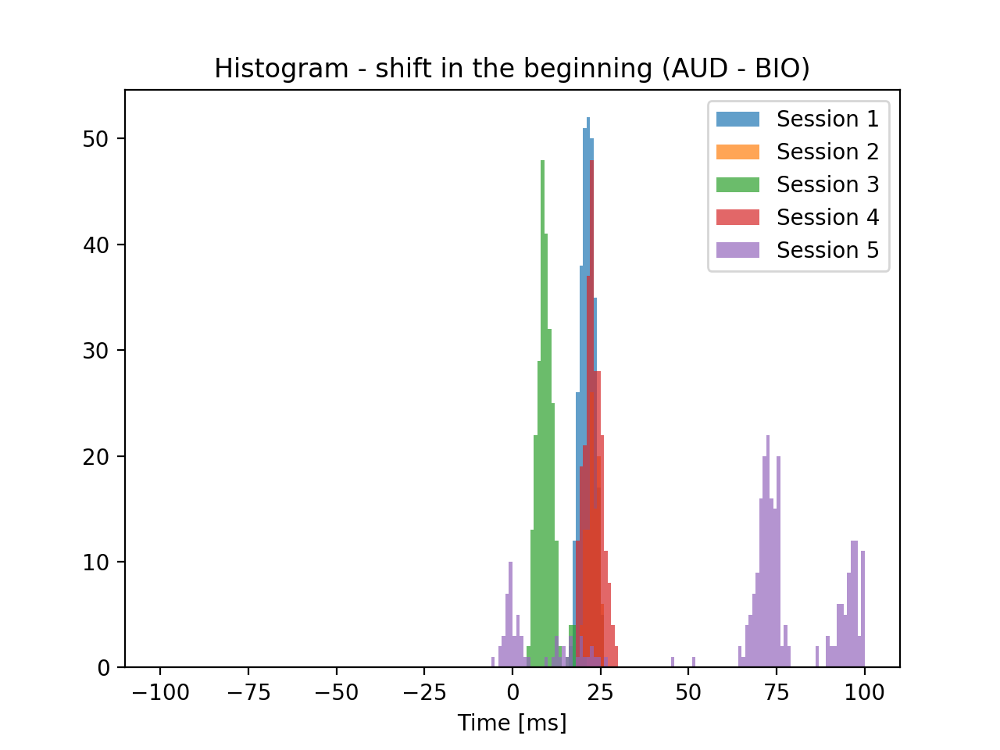

<IPython.core.display.Javascript object>


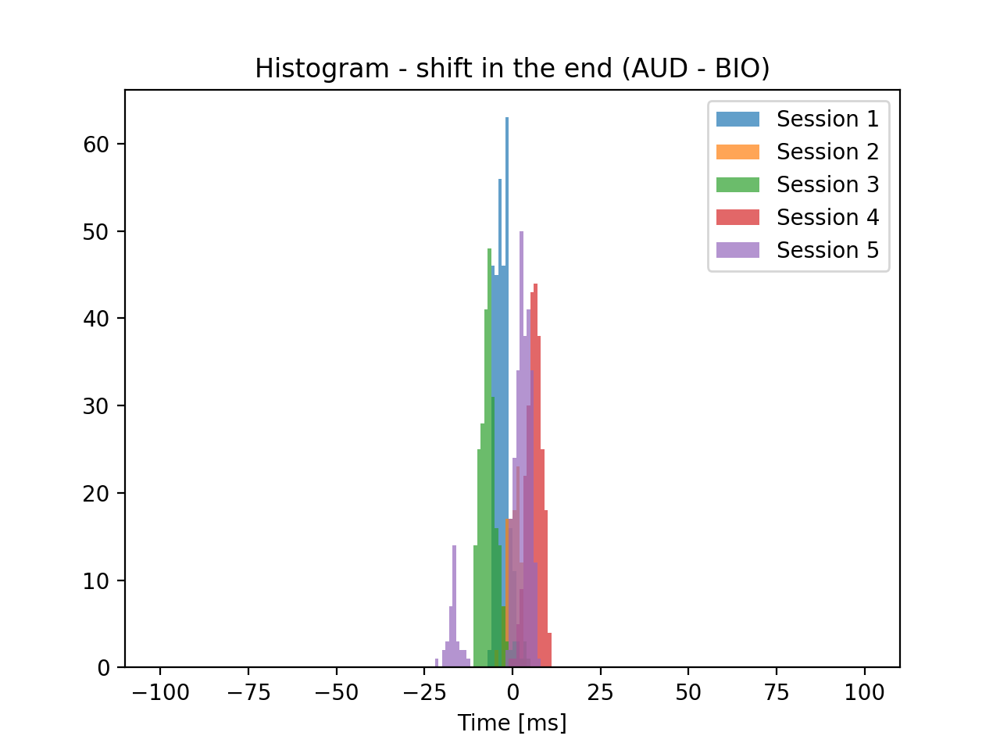

[-2.0, 1.0, -7.0, 6.0, 2.0]


In [229]:
# recording 1 both end and start stable
# recording 2 both end and start stable till data_len(97)
# recording 3 end stable, start quite stable
# recording 4 both end and start stable
# recording 5 ONLY end is stable (60 ms)
BIO_fs = 2048

#from scipy import stats
def show_time_shift(sess_id, use_assert, print_it, show_corrected = False):
    _pom =np.load(base_dir + "/session"+str(sess_id)+"/Session"+str(sess_id)+"_audio_trgr_mat.npz")
    _Trgr = np.load(base_dir + "/session"+str(sess_id)+"/Session"+str(sess_id)+"_filtered_bio_data.npz")["Trgr"]    
    _trgr_edges = np.int32(_Trgr[0,1:]) - np.int32(_Trgr[0,:-1])
    _trgr_edges = np.insert(_trgr_edges,0,0)
    _onset_idxs = np.where(_trgr_edges!=0)[0]
    _trgr_vals = _Trgr[:,_onset_idxs]
    _trgr_vals = np.reshape(_trgr_vals,_trgr_vals.shape[-1])
    _onset_idxs = np.delete(_onset_idxs,np.where(_trgr_vals==0))
    _trgr_vals = np.delete(_trgr_vals,np.where(_trgr_vals==0))
    _onset_mat = np.reshape(_onset_idxs,[int(_onset_idxs.shape[0]/2),2])    
    _BIO_TRG_ind = _onset_idxs.reshape((-1,2))
    _data_len = min(len(_pom["atrgr_mat"]),len(_BIO_TRG_ind))
    if show_corrected:
        _shift = np.round(1000*(((_pom["atrgr_mat"].astype("float")-_pom["atrgr_mat"][0,1])/float(correct_orig_aud_fs))[:_data_len] -((_BIO_TRG_ind.astype("float")-_BIO_TRG_ind[0,1])/BIO_fs)[:_data_len]))
        _aud_trigger = _pom["atrgr_mat"][0][1] + float(stats.mode(_shift[:,1])[0][0]) * correct_orig_aud_fs / 1000 + (_BIO_TRG_ind - _BIO_TRG_ind[0][1]) * float(correct_orig_aud_fs) / BIO_fs
    else:
        _aud_trigger = _pom["atrgr_mat"]


    #print(BIO_TRG_ind[:2])
    #print(_aud_trigger[:2])
    if (use_assert):
        assert(len(SEG_EEG)==len(SEG_AUD))
    #works even if assert fails, just warning
    
    comp_i = 1 # 1 = USE ENDS, 0 = USE BEGINING -––> DO NOT CHANGE
    time_shift = np.round(1000*(((_aud_trigger.astype("float")-_aud_trigger[0,comp_i])/float(correct_orig_aud_fs))[:_data_len] -((_BIO_TRG_ind.astype("float")-_BIO_TRG_ind[0,comp_i])/BIO_fs)[:_data_len]))
    #print(np.argmax(time_shift,axis = 0))
    #print(time_shift[235])
    #print(np.argmin(time_shift,axis = 0))
    #print(time_shift[47])
    if (print_it):        
        print("Segments: " + str(_data_len))
        print("Estimated audio frequency based on the first and the last trigger onset: " + str((_aud_trigger[_data_len-1][comp_i]-_aud_trigger[0][comp_i])/float(_BIO_TRG_ind[_data_len-1][comp_i]-_BIO_TRG_ind[0][comp_i])*BIO_fs))
        print("Segment length [ms]:")
        print(np.round(1000*(((_aud_trigger[:_data_len,1].astype("float") - _aud_trigger[:_data_len,0]))/float(correct_orig_aud_fs) -((_BIO_TRG_ind[:,1].astype("float") - _BIO_TRG_ind[:,0])/BIO_fs))))
        print("Segment start/end with changed sampling frequency (44100 -> " + str(correct_orig_aud_fs) + ") [ms]:")
        #print((np.round(1000*(((pom["atrgr_mat"].astype("float")-pom["atrgr_mat"][0,0])/float(correct_orig_aud_fs))[:data_len] -((BIO_TRG_ind.astype("float")-BIO_TRG_ind[0,0])/BIO_fs)[:data_len])))[46])
        print(time_shift)
        #print(stats.mode((time_shift[:,1]).ravel()))
    return time_shift


#show_time_shift(sessionid, True, True)
#show_time_shift(5, True, True)
show_corrected = False
if True:
#if False:
    time_shifts = []
    for i in range(1,6):        
        time_shifts.append(show_time_shift(i, False, False, show_corrected))

    name = "Histogram - shift in the beginning (AUD - BIO)"
    plt.figure(name)
    plt.title(name)
    for i in range(1,6):    
        ar_cou, ar_val, _ = plt.hist(time_shifts[i-1][:,0], 200, (-100,100), alpha = 0.7, label = "Session " + str(i))        
        plt.legend()
        plt.xlabel("Time [ms]")
    plt.savefig(os.path.join(save_dir, "shift_begin"))
    
    name = "Histogram - shift in the end (AUD - BIO)"
    plt.figure(name)
    plt.title(name)
    end_ind = []
    for i in range(1,6):    
        ar_cou, ar_val, _ = plt.hist(time_shifts[i-1][:,1], 200, (-100,100), alpha = 0.7, label = "Session " + str(i))
        end_ind.append(ar_val[np.argmax(ar_cou)])
        plt.legend()
        plt.xlabel("Time [ms]")
    plt.savefig(os.path.join(save_dir, "shift_end"))
    print(end_ind)
    #START: [-26.0, -23.0, -25.0, -12.0, -61.0]
    #END:   [-2.0, 1.0, -7.0, 6.0, 2.0]



In [20]:
print(AUD_fs)
#print(AUD_TRG_ind)
#print(pom["atrgr_mat"])
BIO_EEG.min()
BIO_EEG.max()
BIO_EMG.min()
BIO_EMG.max()
#print(np.convolve(BIO_EEG[0,:size],[0.25, 0.5, 0.25]).shape)
[1,2,3][2:]


8000


[3]

## Command picker functions
Function to support selection of data subset (such as only commands),

```get_comm_test``` returns first 2 occurrences of each command type for session ```test_id``` and remaining occurrences are returned through ```get_comm_train```.

In [34]:
use_commands = [u'add', u'divide', u'eight', u'four', u'five', u'multiply', u'nine', u'one', u'percent', u'seven', u'six', u'subtract', u'three', u'two', u'zero']
class_count = len(use_commands)
labels2id = {v:i for i,v in enumerate(use_commands)}
id2labels = {i:v for i,v in enumerate(use_commands)}


def get_filt_ind_maps(data_table, loud = True, silent = False, command = True, timit = True, allow_only_targ = False, allow_list=[],data_len = None):
    fil_ind = []
    id2tar = {}
    tar2id = {}
    for ind in range((len(data_table["Target"]) if data_len == None else data_len)):
        target = data_table['Target'][ind]
        if (data_table['Rejected'][ind] > 0.0):
            continue
        if not loud and (data_table['StimuliType'][ind] == "loud"):
            continue
        if not silent and (data_table['StimuliType'][ind] == "silent"):
            continue
        if not command and (data_table['PromptType'][ind] == "Command"):
            continue
        if not timit and (data_table['PromptType'][ind] == "Timit"):
            continue                
        if allow_only_targ and target not in allow_list:
            continue        
        
        fil_ind.append(ind)            
        id2tar[ind] = target
        if target in tar2id:
            tar2id[target].append(ind)
        else:
            tar2id[target] = [ind]
    return fil_ind, id2tar, tar2id

def get_comm_train(data_table, sess_id, test_id, labels_as_id = False, data_len = None, loud = True, silent = False, how_many_test = 2):
    _, id2comm, comm2id = get_filt_ind_maps(data_table, timit = False,allow_only_targ = True, allow_list=use_commands, data_len=data_len, loud = loud, silent = silent)
    if (sess_id == test_id):
        return [(vv,(labels2id[i] if labels_as_id else i)) for i,v in comm2id.items() if len(v)>how_many_test for vv in v[how_many_test:]]  
    else:
        return [(i,(labels2id[v] if labels_as_id else v)) for i,v in id2comm.items()]

def get_comm_test(data_table, sess_id, test_id, labels_as_id = False, data_len = None, loud = True, silent = False, how_many_test = 2):
    if (sess_id == test_id):
        _, _, comm2id = get_filt_ind_maps(data_table, timit = False,allow_only_targ = True, allow_list=use_commands, data_len=data_len, loud = loud, silent = silent)
        return [(vv,(labels2id[i] if labels_as_id else i)) for i,v in comm2id.items() for vv in v[:how_many_test]]
    else:
        return []



## Command inspection

In [22]:
test_id = 3
se_id = 1
# careful for se_id = 2 (set also properly data_len = 97)
labels_as_id = False


print("Number of commands + command counts:")
for s_id in range(1,6):
    data_tab = get_trial_desc(base_dir + "/session"+str(s_id)+"/Session"+str(s_id)+".xlsx")
    
    #if False:
    if s_id == 2:
        comm_ind, id2comm, comm2id = get_filt_ind_maps(data_tab, timit = False, data_len = 97)
    else:
        comm_ind, id2comm, comm2id = get_filt_ind_maps(data_tab, timit = False)

    comm_count = sorted([(i,len(l)) for i,l in comm2id.items()],key=lambda tup: tup[0])
    #print(id2comm)
    #print(comm2id)
    print(len(comm_count))
    print(comm_count)
    print("")





Number of commands + command counts:
20
[('add', 2), ('climb', 2), ('descend', 3), ('divide', 2), ('eight', 2), ('five', 2), ('four', 3), ('left', 2), ('level', 2), ('multiply', 3), ('nine', 2), ('one', 3), ('percent', 3), ('right', 2), ('seven', 2), ('six', 3), ('subtract', 2), ('three', 2), ('traffic', 3), ('two', 2)]

15
[('add', 1), ('divide', 1), ('eight', 1), ('five', 1), ('four', 1), ('multiply', 1), ('nine', 2), ('one', 1), ('percent', 1), ('seven', 1), ('six', 1), ('subtract', 1), ('three', 1), ('two', 1), ('zero', 1)]

15
[('add', 3), ('divide', 2), ('eight', 3), ('five', 3), ('four', 3), ('multiply', 3), ('nine', 2), ('one', 3), ('percent', 2), ('seven', 2), ('six', 3), ('subtract', 3), ('three', 2), ('two', 3), ('zero', 3)]

15
[('add', 2), ('divide', 3), ('eight', 3), ('five', 2), ('four', 3), ('multiply', 3), ('nine', 3), ('one', 2), ('percent', 3), ('seven', 3), ('six', 2), ('subtract', 3), ('three', 2), ('two', 3), ('zero', 3)]

15
[('add', 3), ('divide', 3), ('eight', 

In [23]:
print("")
print("TEST/TRAIN division:")
se_id = 2
te_id = -1
data_tab = get_trial_desc(base_dir + "/session"+str(se_id)+"/Session"+str(se_id)+".xlsx")
comm_ind, id2comm, comm2id = get_filt_ind_maps(data_tab, timit = False,allow_only_targ = True, allow_list=use_commands)

#comm_count = sorted([(i,len(l)) for i,l in comm2id.items()],key=lambda tup: tup[0])
#print(comm_count)
#print(len(comm_count))
print(id2comm)
print(get_comm_test(data_tab,se_id, te_id,labels_as_id=labels_as_id))
print(get_comm_train(data_tab,se_id, te_id,labels_as_id=labels_as_id))
print("")
print(sorted(list(id2comm)))
print(sorted([i[0] for i in get_comm_test(data_tab,se_id, te_id)]))
print(sorted([i[0] for i in get_comm_train(data_tab,se_id, te_id)]))


TEST/TRAIN division:
{0: 'three', 2: 'percent', 14: 'five', 20: 'subtract', 25: 'one', 29: 'six', 33: 'eight', 37: 'zero', 52: 'add', 56: 'seven', 64: 'two', 68: 'nine', 79: 'four', 83: 'multiply', 93: 'nine', 95: 'divide', 102: 'zero', 114: 'six', 116: 'one', 123: 'four', 127: 'two', 133: 'five', 141: 'seven'}
[]
[(0, 'three'), (2, 'percent'), (14, 'five'), (20, 'subtract'), (25, 'one'), (29, 'six'), (33, 'eight'), (37, 'zero'), (52, 'add'), (56, 'seven'), (64, 'two'), (68, 'nine'), (79, 'four'), (83, 'multiply'), (93, 'nine'), (95, 'divide'), (102, 'zero'), (114, 'six'), (116, 'one'), (123, 'four'), (127, 'two'), (133, 'five'), (141, 'seven')]

[0, 2, 14, 20, 25, 29, 33, 37, 52, 56, 64, 68, 79, 83, 93, 95, 102, 114, 116, 123, 127, 133, 141]
[]
[0, 2, 14, 20, 25, 29, 33, 37, 52, 56, 64, 68, 79, 83, 93, 95, 102, 114, 116, 123, 127, 133, 141]


In [24]:
data_len_session2 = 97

## cycle
for s_id in range(1,6):
    get_comm_test(data_tab, s_id, te_id, data_len = (data_len_session2 if s_id == 2 else None))
    get_comm_train(data_tab, s_id, te_id, data_len = (data_len_session2 if s_id == 2 else None))

## only actual session
get_comm_test(data_tab, sessionid, te_id, data_len = (data_len_session2 if sessionid == 2 else None))
get_comm_train(data_tab, sessionid, te_id, data_len = (data_len_session2 if sessionid == 2 else None))


# creation of fair dataset for NN training (excluding commands that will be used for evalution)
## cycle
for s_id in range(1,6):
    data_tab = get_trial_desc(base_dir + "/session"+str(s_id)+"/Session"+str(s_id)+".xlsx")
    
    loud_ind, _, _ = get_filt_ind_maps(data_tab, loud = True, silent = False, command = True, timit = True, data_len = (data_len_session2 if s_id == 2 else None))
    loud_ind = set(loud_ind)
    comm_forbid = set([i[0] for i in get_comm_test(data_tab,s_id, data_len = (data_len_session2 if s_id == 2 else None))])
    fil_ind = loud_ind - comm_forbid
    
## only actual session
loud_ind, _, _ = get_filt_ind_maps(data_table, loud = True, silent = False, command = True, timit = True, data_len = (data_len_session2 if sessionid == 2 else None))
loud_ind = set(loud_ind)
comm_forbid = set([i[0] for i in get_comm_test(data_table,sessionid, data_len = (data_len_session2 if sessionid == 2 else None))])
fil_ind = loud_ind - comm_forbid    



    


# Data Visualization

## BIO Histograms

<IPython.core.display.Javascript object>


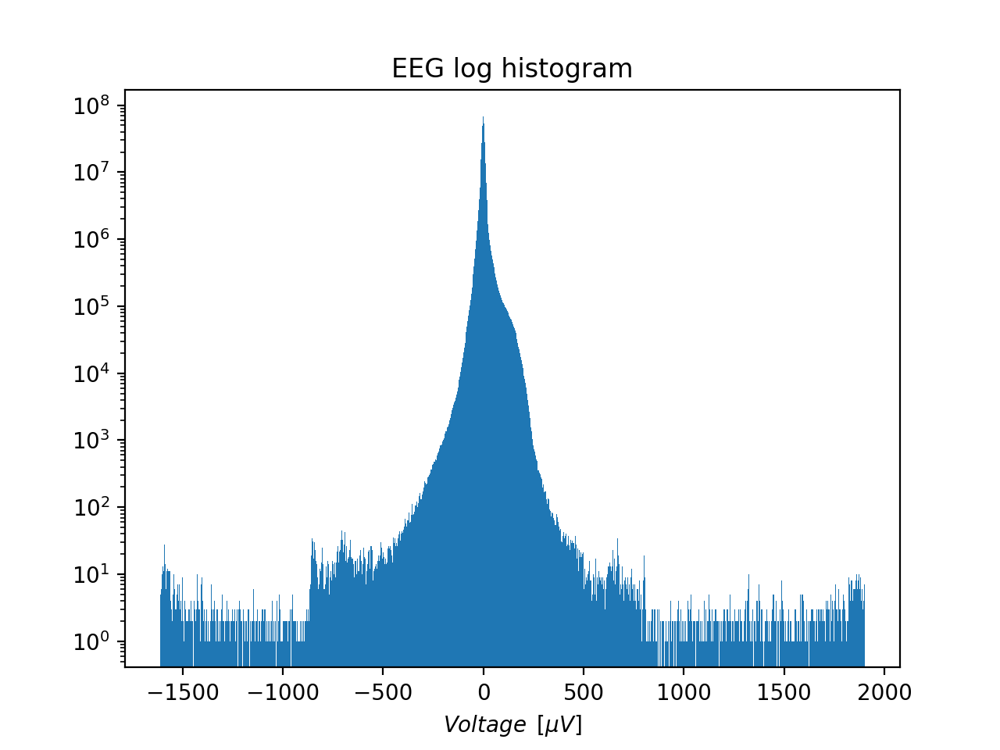

<IPython.core.display.Javascript object>


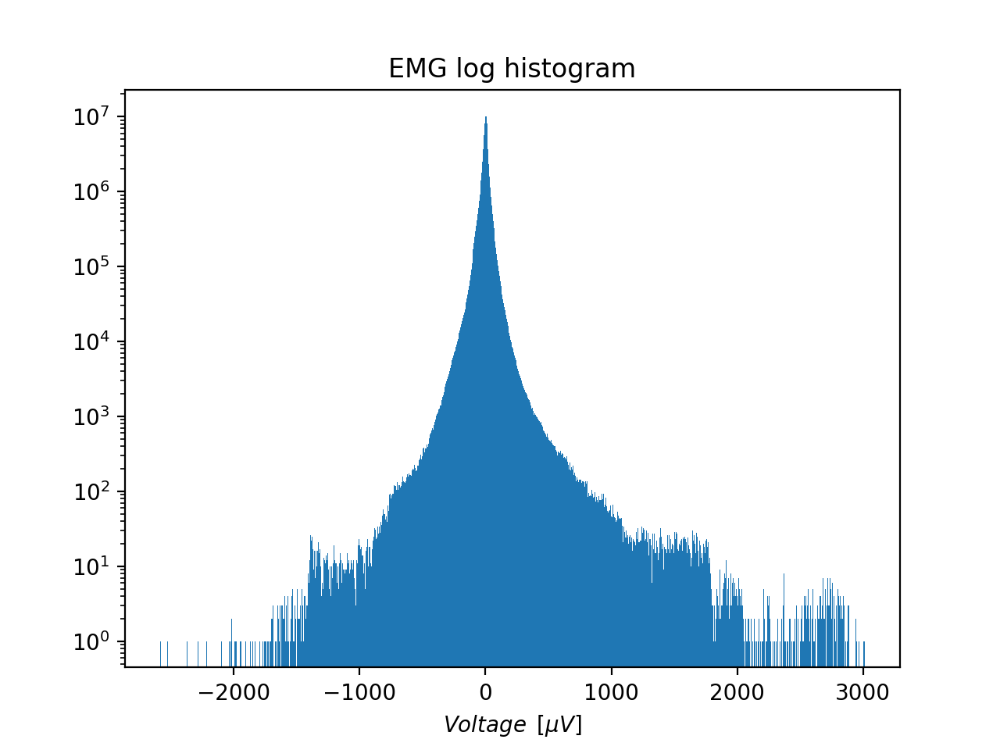

In [9]:
log = True


if VISUALIZE:
    tit = "EEG" + (" log " if log else " ") + "histogram"
    plt.figure(tit)
    plt.title(tit)
    plt.xlabel("$Voltage \/\/\/ [\mu V]$")
    #n, bins, patches = plt.hist(np.ravel(BIO_EEG),1000)
    n, bins, patches = plt.hist(np.ravel(BIO_EEG),1000, log = log)

    tit = "EMG" + (" log " if log else " ") + "histogram"
    plt.figure(tit)
    plt.title(tit)
    plt.xlabel("$Voltage \/\/\/ [\mu V]$")
    #n, bins, patches = plt.hist(np.ravel(BIO_EMG),1000)
    n, bins, patches = plt.hist(np.ravel(BIO_EMG),1000,  log = log)

## Function definition

In [153]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cbook as cbook
import matplotlib.cm as cm

from matplotlib.collections import LineCollection
from matplotlib.ticker import MultipleLocator


def show_data(name,data, labels, downsampl_factor = 1, win_start = 0 / 1000., win_len = 50 / 1000., fs = 2048, fig_name = None, sp_max = 1, sp_col = 1, sp_cnt = 1, use_same_scale = True, color = None):    
    # use_same_scale only for EEG so far
    seconds = data.shape[1] / float(fs)


    dmin = dmin_ = data.min()
    dmax = dmax_ = data.max()    
    print(dmin)
    print(dmax)
    
    if use_same_scale:
        if name[:3] == "EEG":
            dmin = -100
            dmax = 140
        elif name[:3] == "EMG":
            #print("EMG MAX " + str(dmin))
            #print("EMG MIN " + str(dmax))
            #dmin = -400
            #dmax = 300
            pass
        dr = 1500 
    else:
        dr = (dmax - dmin) * 0.7  # Crowd them a bit.

    
    #TODO: use scipy.signal.resample?

    n_samples, n_rows = data.shape[1], labels.shape[0]    
    t = seconds * downsampl_factor * np.arange(n_samples) / float(n_samples)
    if fig_name == None:
        fig_name = name
    fig = plt.figure(fig_name,figsize=(1.8 * seconds * sp_col, (1.7 + n_rows / 5.8)* sp_max))
    
    data = data[:n_rows,:n_samples*downsampl_factor:downsampl_factor].T 


    # Plot the EEG
    ticklocs = []
    ax2 = plt.subplot(sp_max, sp_col, sp_cnt)
    ax2.set_xlim(0, seconds)
    ax2.set_xticks(np.arange(seconds))
    ax2.set_title(name)

    

    y0 = dmin
    y1 = (n_rows - 0.5) * dr + dmax
    ax2.set_ylim(y0, y1)

    segs = []

    for i in range(n_rows):
        segs.append(np.column_stack((t, data[:, i])))
        ticklocs.append(i * dr + dr / 2)


    offsets = np.zeros((n_rows + 1, 2), dtype=float)
    offsets[:-1, 1] = ticklocs

    segs.append([[win_start,0],
                 [win_start + win_len,0],
                 [win_start + win_len,offsets[-2,1] + dr/2],
                 [win_start,offsets[-2,1] + dr/2],
                 [win_start,0]])

    if color is None:        
        color_line = "#1f77b4"
        color_window = 'r'
    else:
        color_line = color_window = color
    lines = LineCollection(segs, linewidths=[(1.5)]*n_rows + [(0.5)], offsets=offsets, transOffset=None, colors=[color_line]*n_rows + [color_window])
    ax2.add_collection(lines)

    # Set the yticks to use axes coordinates on the y axis
    ax2.set_yticks(ticklocs)
    ax2.set_yticklabels(labels[:n_rows])
    ax2.set_xlabel('Time [s]')
    plt.tight_layout()
    plt.show()
    return dmin, dmax
    
def show_one_chan(index,data, labels, fs = 2048 ):
    size = data.shape[1]
    seconds = size / float(fs)
    ax = plt.figure(labels[index], figsize=(1.8 * seconds,2))
    plt.title(labels[index])
    plt.xlim(0, seconds)
    plt.ylim(-1,1)
    plt.xlabel('Time [s]')
    #plt.plot(range(size),np.convolve(BIO_EEG[0,:size],[0.15,0.2, 0.3, 0.2,0.15])[2:-2])
    plt.tight_layout()
    plt.plot(np.arange(size) / float(fs),data[0,:size]/32768)#np.convolve(BIO_EEG[0,:size],[0.15,0.2, 0.3, 0.2,0.15])[2:-2])

    




## Show chosen segment - offset audio

<IPython.core.display.Javascript object>


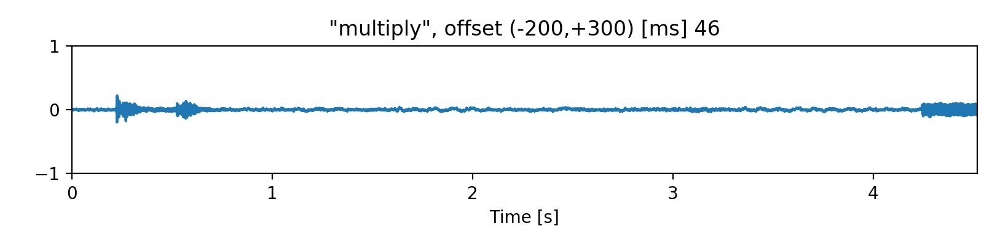

multiply -> [46, 47, 138, 139, 192, 193]


<IPython.core.display.Javascript object>


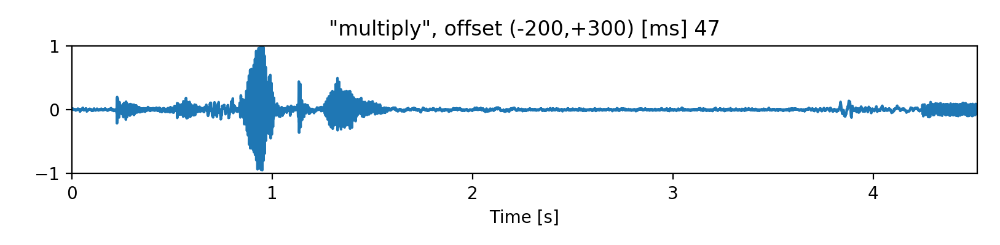

multiply -> [46, 47, 138, 139, 192, 193]


<IPython.core.display.Javascript object>


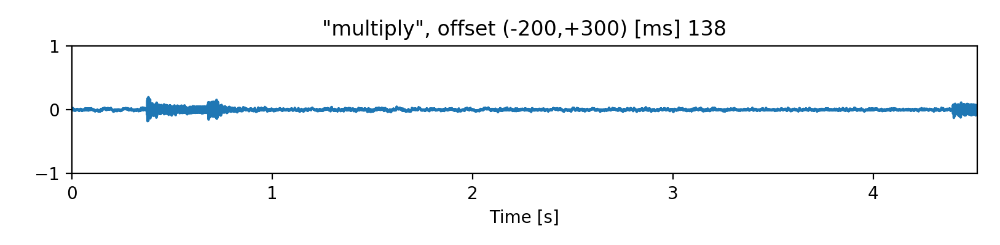

multiply -> [46, 47, 138, 139, 192, 193]


<IPython.core.display.Javascript object>


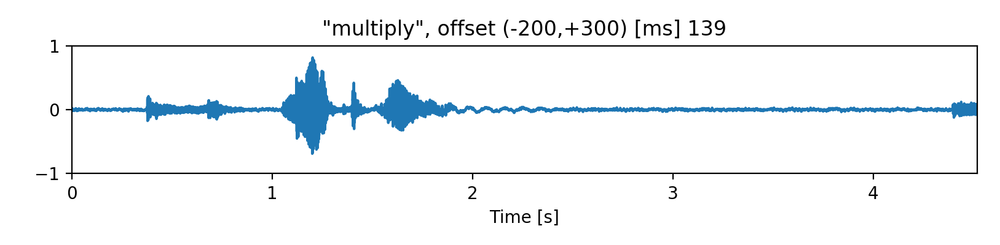

multiply -> [46, 47, 138, 139, 192, 193]


<IPython.core.display.Javascript object>


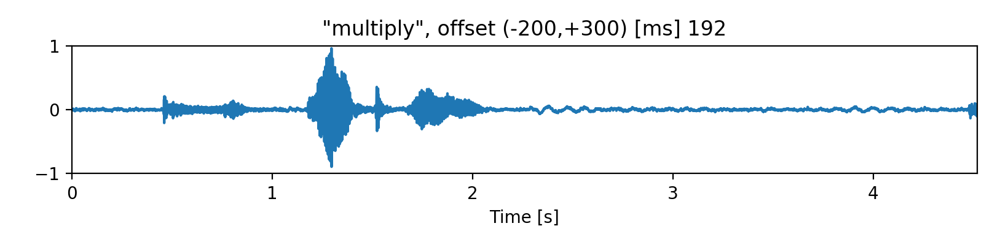

multiply -> [46, 47, 138, 139, 192, 193]


<IPython.core.display.Javascript object>


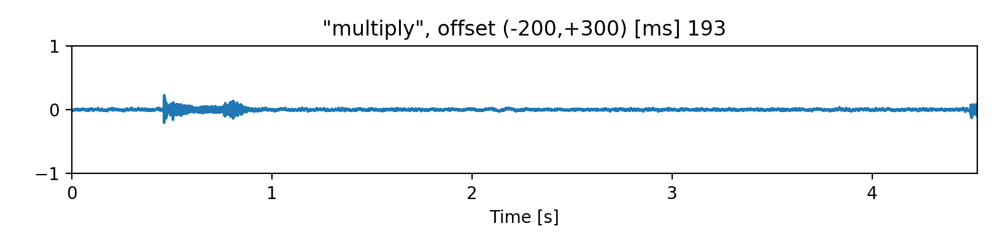

multiply -> [46, 47, 138, 139, 192, 193]


In [10]:
i = 46

# Offset in [ms]
OFF_ST = 200
OFF_END = 300
SILENT = True

def show_offset_audio(i, of_st, of_en, label = ""):
    """Compares audios      
    """
    label = str(label)
    #show_one_chan(0,SEG_AUD[i],["Audio - original " + label], fs = AUD_fs)
    targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = True, silent = SILENT)
    names = ["\"" + id2targ[i] + "\", offset (-" + str(OFF_ST) + ",+" + str(OFF_END) + ") [ms] "  + label]
    off_audio = AUD_wav[:,AUD_TRG_ind[i,0] - OFF_ST *AUD_fs//1000:AUD_TRG_ind[i,1] + OFF_END*AUD_fs//1000]
    show_one_chan(0,off_audio,names, fs = AUD_fs)
    #play_audio(off_audio)
    #print(SEG_AUD[i].shape)
    #print(SEG_EMG[i].shape)
    print(id2targ[i] + " -> " + str(targ2id[id2targ[i]]))

    #print(targ2id)
    #For session1: {u'the great black leopards': [125], u'afterwards you did well enough': [116], u'four': [10, 187, 223], u'his eyes burned feverishly': [81], u"now don't shut this door": [212], u'one': [31, 102, 196], u'the lifeboats were stuck fast': [62], u'melancholy obsession': [235], u'a bullet she answered': [146], u'add': [4, 106, 208], u'that dog chases cats mercilessly': [16], u'both cars were slightly damaged': [52], u'george seldom watches daytime movies': [110], u'milk appears twice a day': [191], u'readiness exercises are almost continuous': [160], u'salvation reconsidered': [225], u"don't lose the chuck key": [206], u"we're open every monday evening": [173], u'turn shaker upside down': [150], u'that worm a murderer': [75], u'five': [68, 179, 183], u"you're right now buddy": [139], u'exboyfriend meet exhusband': [27], u'use deductible insurance wherever feasible': [154], u'the car door crashed shut': [204], u'zero': [87, 158, 189], u'only lawyers love millionaires': [181], u'look somewhere else': [64], u'this is taxation without representation': [60], u'the trial balloons are afloat': [166], u'object a village crossroads': [210], u'there were other farmhouses nearby': [227], u'many shapes in bathtubs': [137], u'twenty two or twenty three': [79], u'does this bother you': [233], u'subtract': [73, 143, 231], u'the wagons were burning fiercely': [175], u'it all seemed rather hopeless': [200], u'we both had hangovers': [96], u'is his appetite improved': [219], u'it had gone like clockwork': [162], u'push back up and repeat': [43], u'shall we teach him some': [229], u'divide': [0, 156], u'they had slapped their thighs': [47], u'why should this be so': [12], u'he scowled at her flowers': [39], u'they polished the windshield': [104], u'she looked at me provocatively': [58], u'three': [6, 164], u'they were both very fluent': [18], u'two': [25, 144, 194], u'she overplayed her hand': [129], u'academic aptitude guarantees your diploma': [171], u'who would take over': [95], u'how permanent are their records': [237], u'do without fancy tablecloths': [56], u'did you eat yet': [8], u'what shall these effects be': [77], u'drunkenness was no longer tolerated': [141], u'nobody likes snakes': [192], u'they close sometime after eight': [35], u'he chuckled the memory vivid': [66], u'none should ask less': [45], u'nine': [89, 127], u'the courtyard is magnificently decorated': [185], u'look sweetheart some fool was': [100], u'such optimism was completely unjustified': [33], u'well then who brought it': [14], u'seven': [50, 121], u'brakes shrieked behind us': [169], u'complexity of complete marketing planning': [239], u'set aside to dry thoroughly': [118], u'either better nor worse': [133], u'regular attendance is seldom required': [98], u'six': [41, 114, 202], u'percent': [54, 123], u'the hotel owner shrugged': [214], u'now the hope was gone': [85], u'twice he nearly fell': [37], u'maybe twenty thirty fifty': [48], u'the shadow vanished': [20], u'hispanic costumes are quite colorful': [177], u'eight': [29, 108, 217], u'deep enough he decided': [2], u'multiply': [70, 83, 221], u'who wants this deed done': [135], u'perfect he thought': [131], u'a quick touchdown resulted': [152], u'he drew a deep breath': [198], u'inflammatory cells were strikingly absent': [93]}

    
#for i in range(30):
#    show_offset_audio(i,OFF_ST,OFF_END,i)

    
#sess 5, 46:[ 74. -64.] 47:[-71. -65.] -> more like a filter fault
#sess 5 id: 8 (looks like the start was not catched properly vs 248)    
if VISUALIZE:
    targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = True, silent = SILENT)
    for lab in targ2id[id2targ[i]]:
        show_offset_audio(lab,OFF_ST,OFF_END,lab)

    

{'we would establish no censorship': [0], 'look sweetheart some fool was': [2], 'three': [4, 102, 210], 'neither acknowledged the gift': [6], 'divide': [8, 156, 248], 'add': [10, 171, 181], 'how do oysters make pearls': [12], 'seven': [14, 114, 250], 'of course dear she said': [16], 'maybe they already got them': [18], 'clear pronunciation is appreciated': [20], "this kid's froze bad": [22], 'bricks are an alternative': [25], 'critical equipment needs proper maintenance': [27], "stimulating discussions keep students' attention": [29], 'hey come back he shouted': [31], 'one': [33, 189, 239, 271], 'eight': [35, 91, 179], 'the viewpoint overlooked the ocean': [37], 'either better nor worse': [39], 'zero': [41, 146, 219, 283], 'it had gone like clockwork': [43], 'so would radar picket ships': [45], 'multiply': [47, 139, 192], 'nine': [48, 127, 242, 277], 'subtract': [50, 123, 233], 'percent': [52, 160, 194], "we don't know this guy": [54], 'oh we managed she said': [56], 'six': [58, 143, 2

<IPython.core.display.Javascript object>


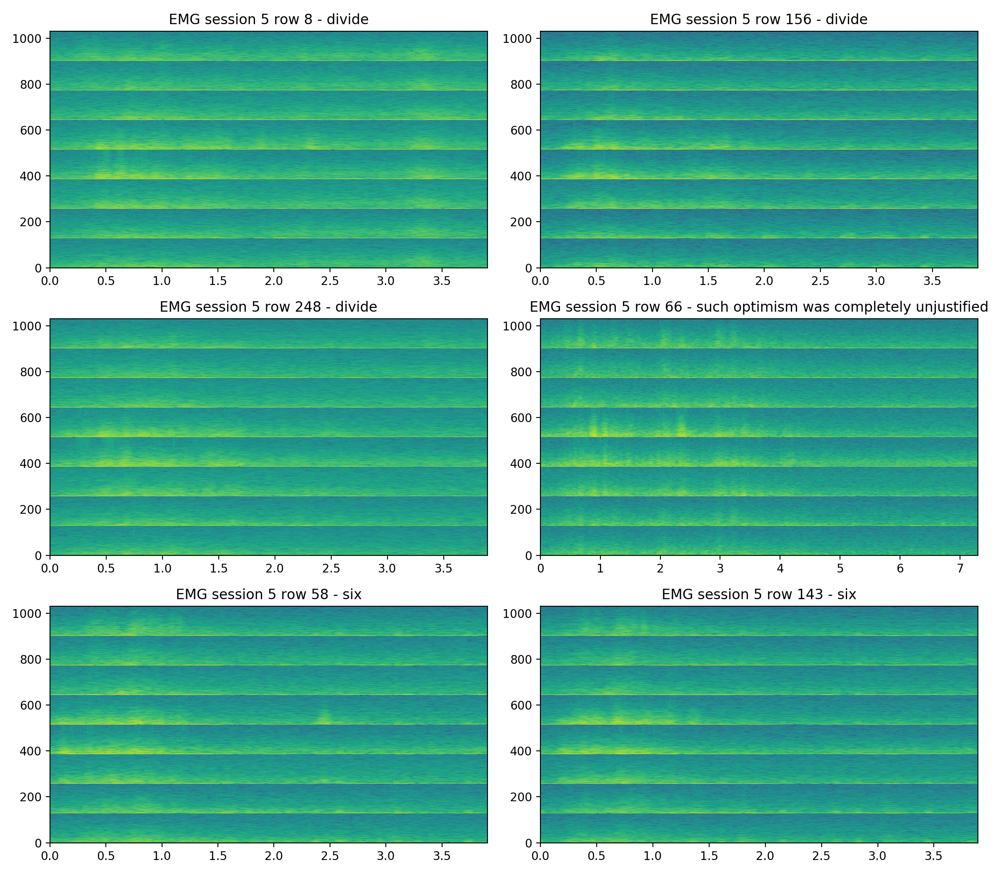

<IPython.core.display.Javascript object>


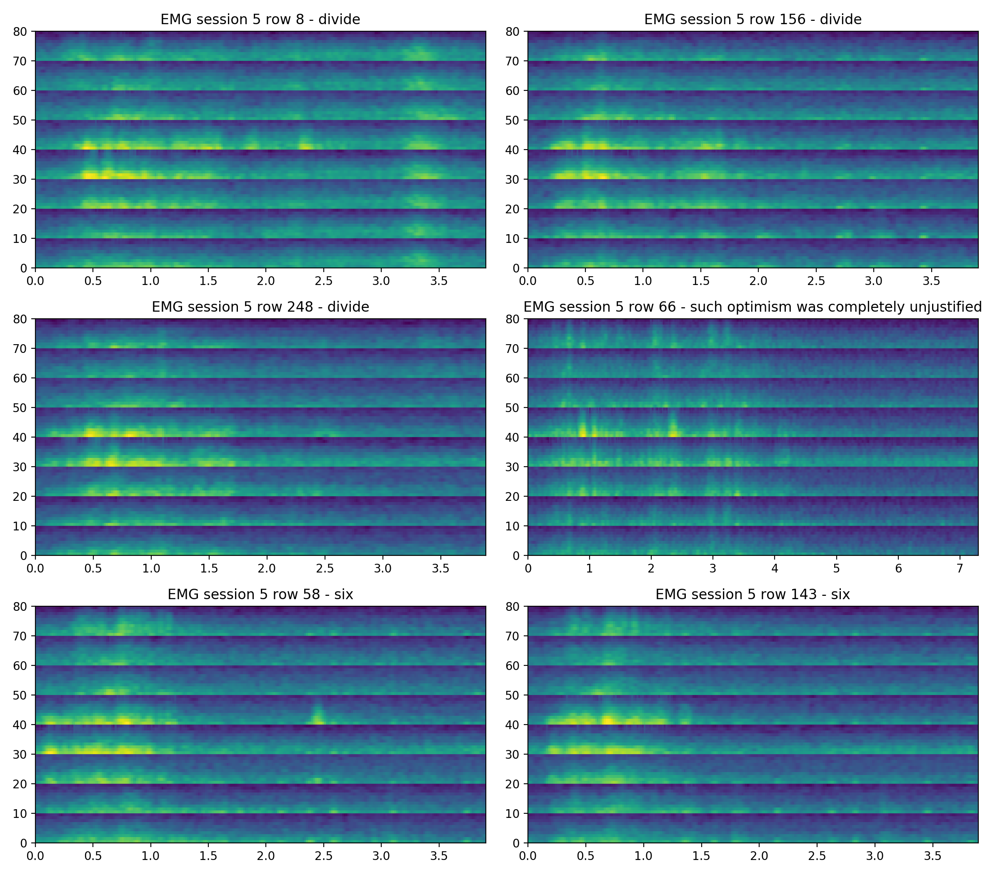

<IPython.core.display.Javascript object>


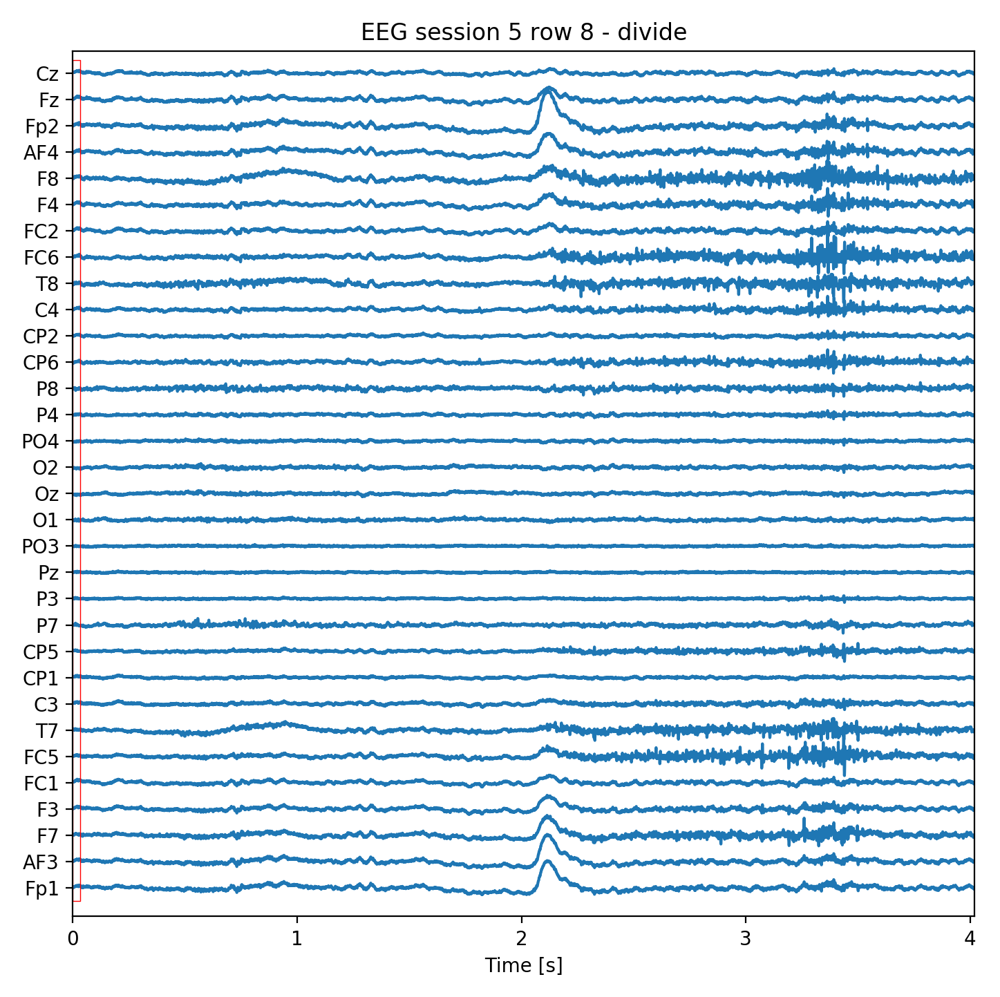

<IPython.core.display.Javascript object>


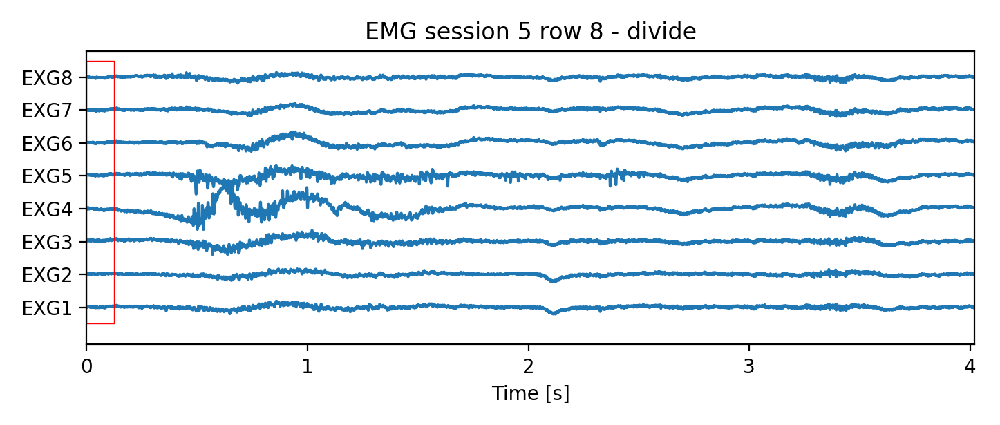

<IPython.core.display.Javascript object>


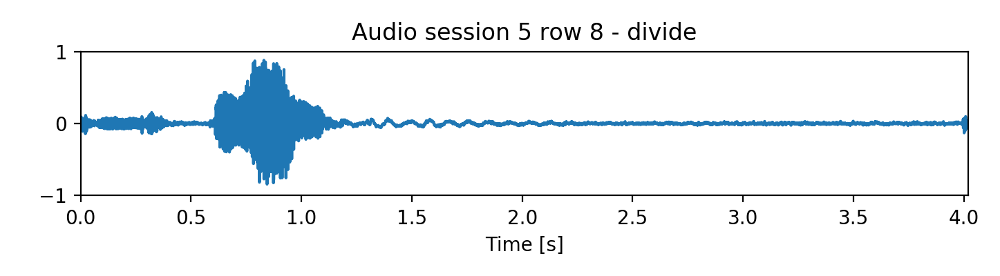

<IPython.core.display.Javascript object>


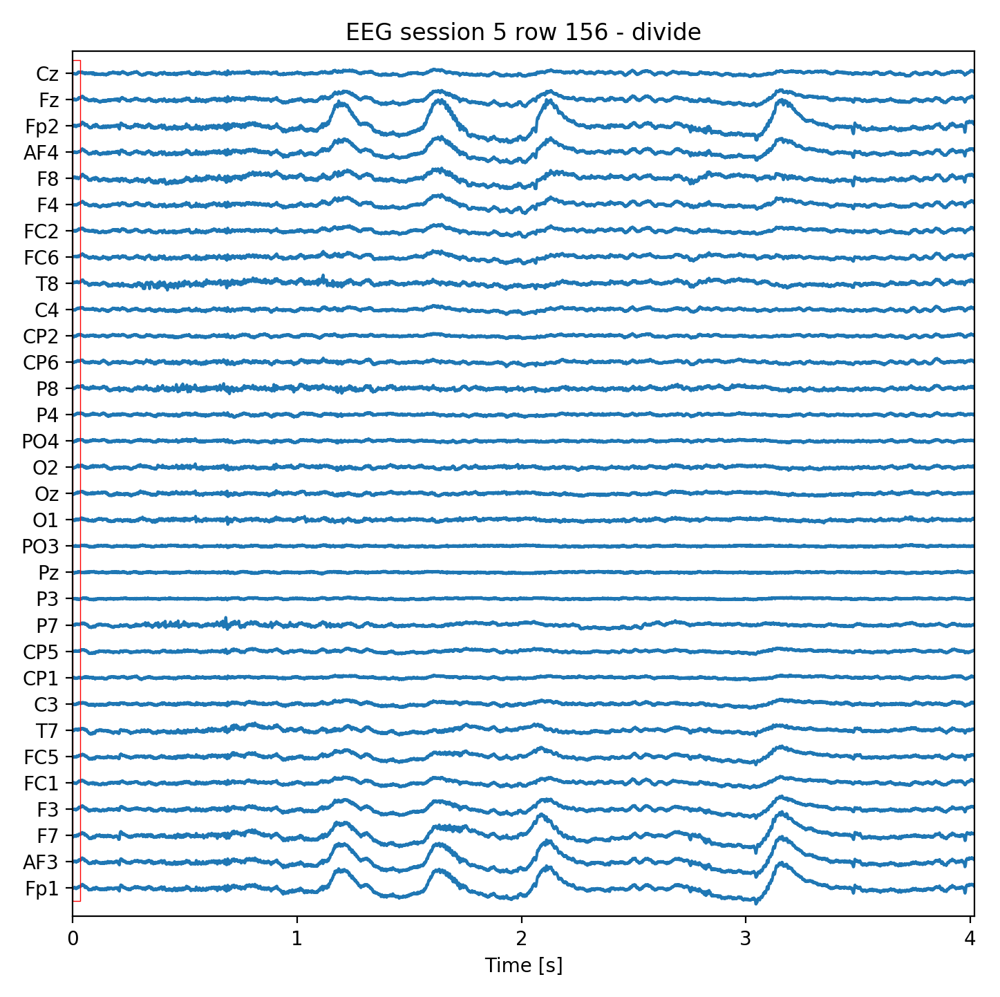

<IPython.core.display.Javascript object>


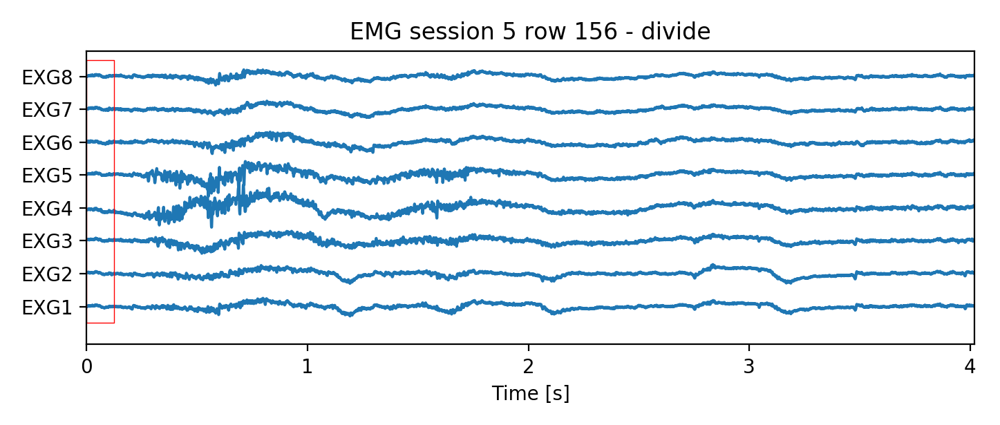

<IPython.core.display.Javascript object>


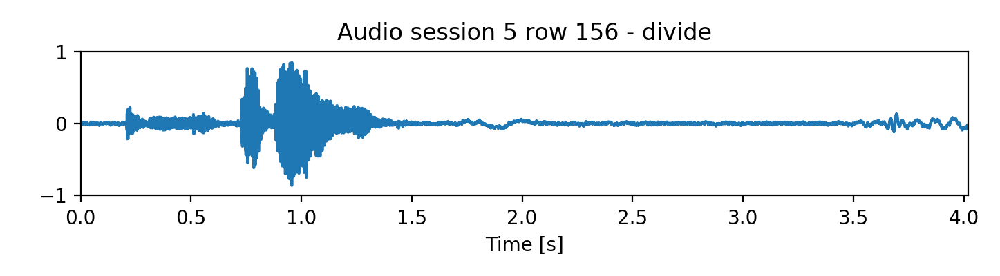

<IPython.core.display.Javascript object>


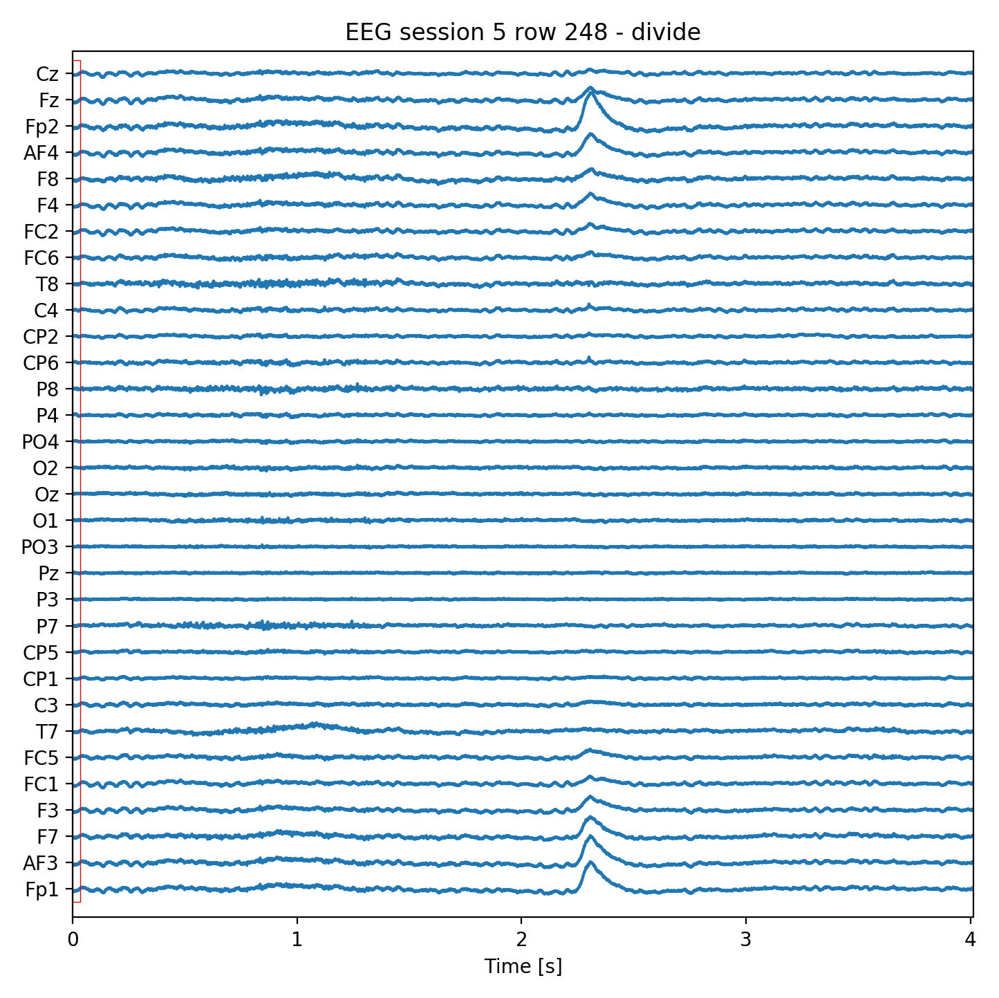

<IPython.core.display.Javascript object>


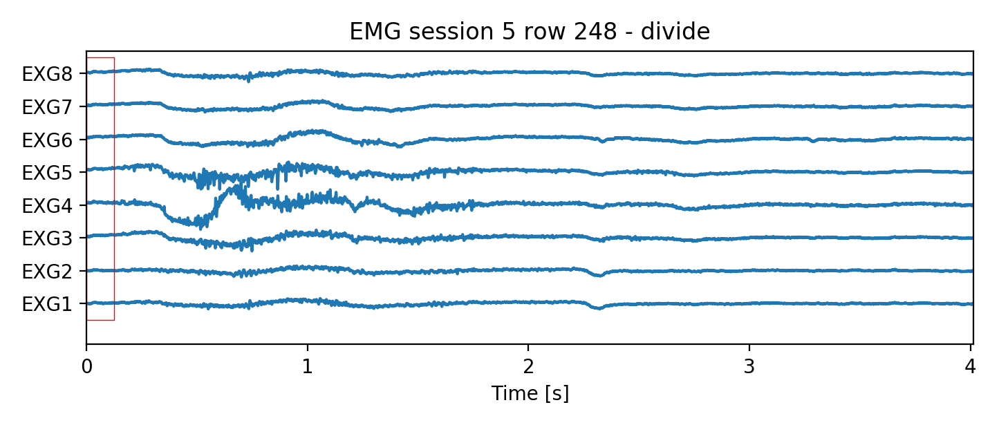

<IPython.core.display.Javascript object>


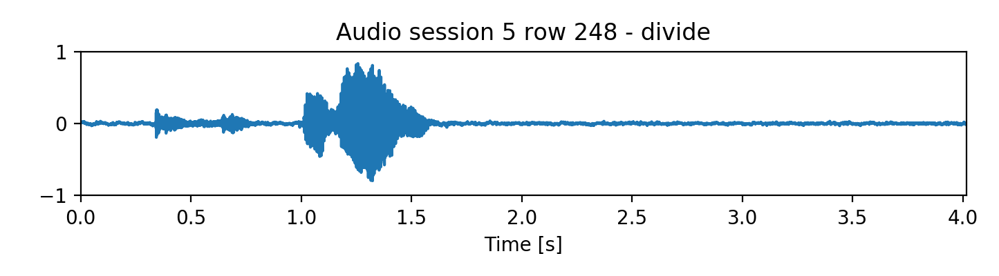

<IPython.core.display.Javascript object>


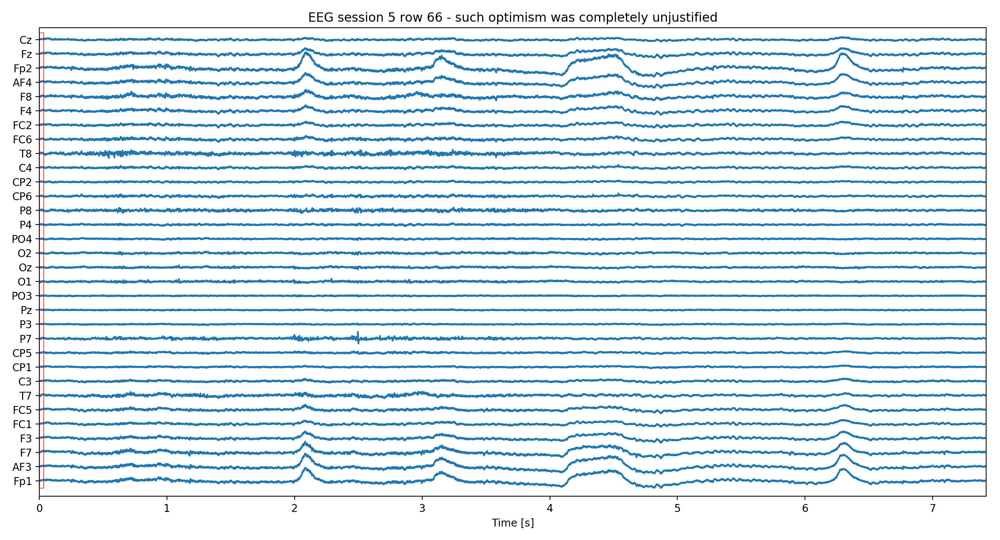

<IPython.core.display.Javascript object>


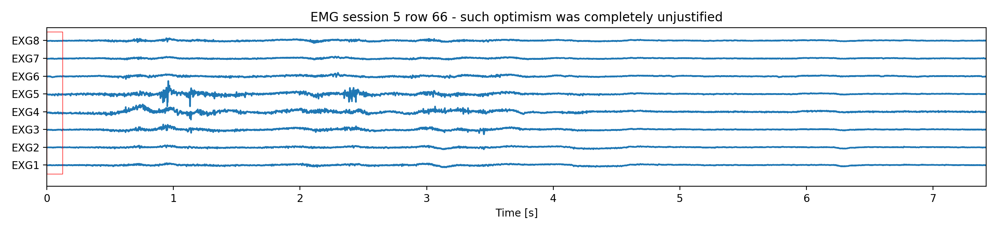

<IPython.core.display.Javascript object>


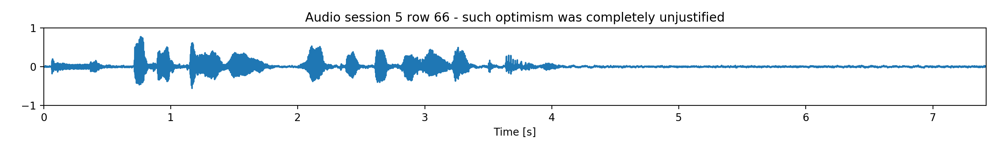

/anaconda2/envs/python3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


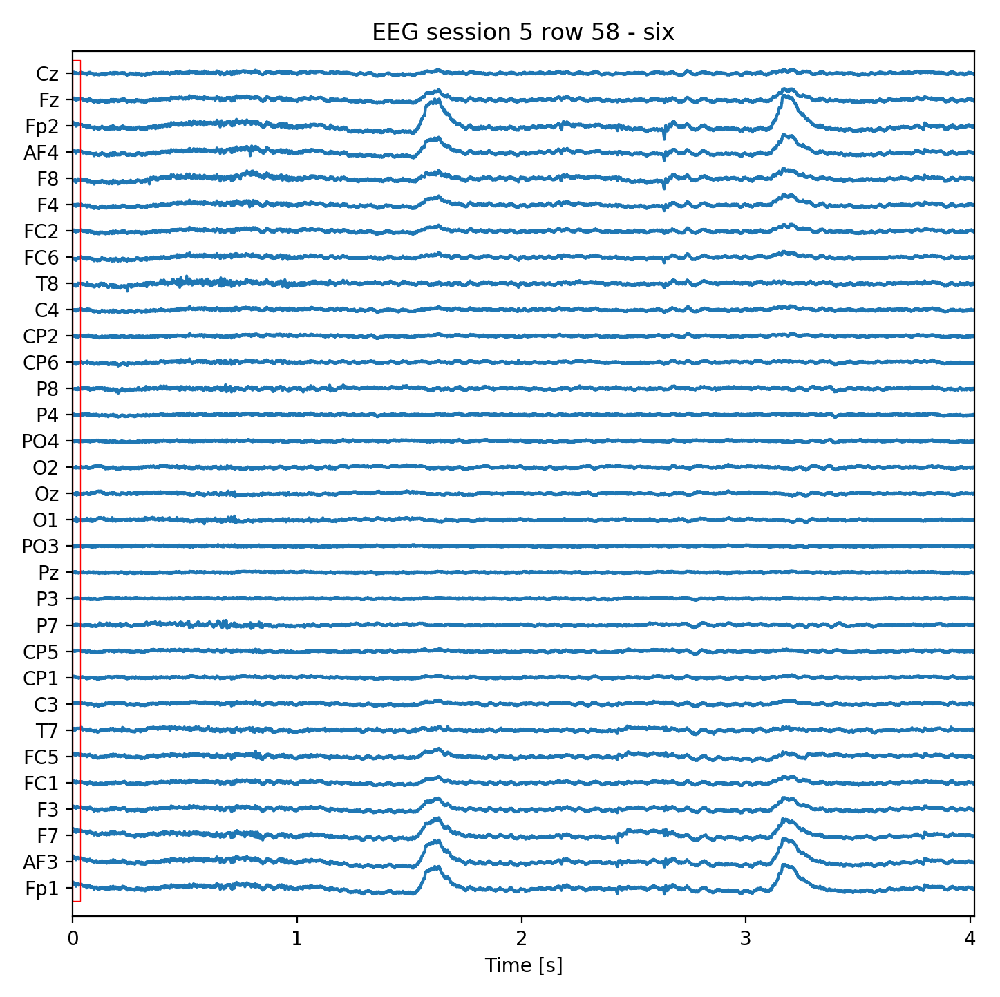

<IPython.core.display.Javascript object>


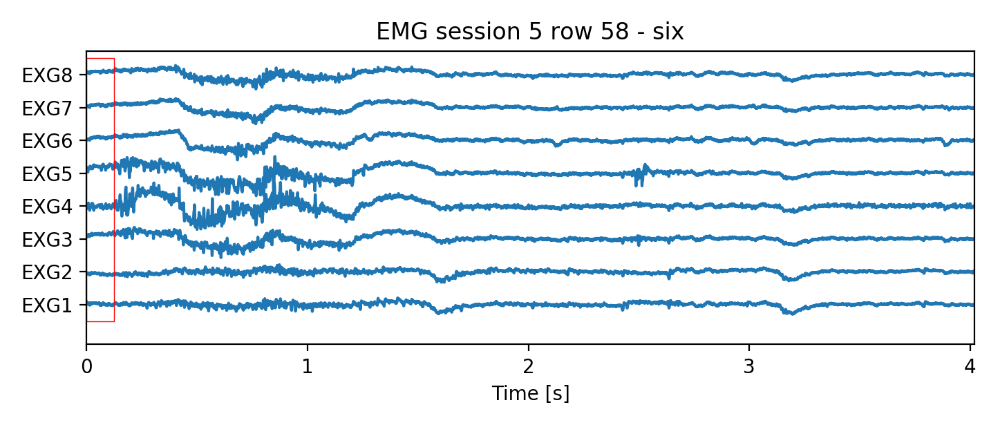

<IPython.core.display.Javascript object>


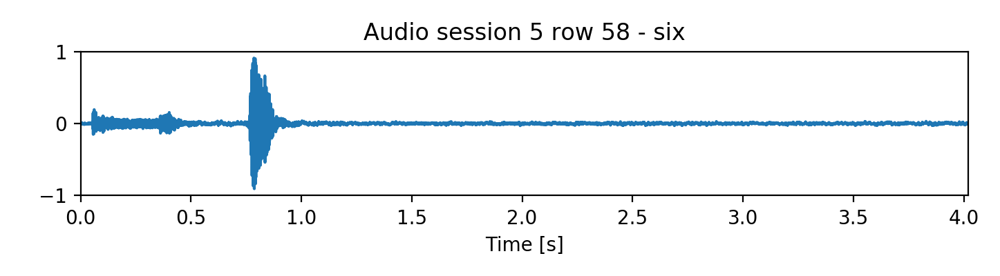

<IPython.core.display.Javascript object>


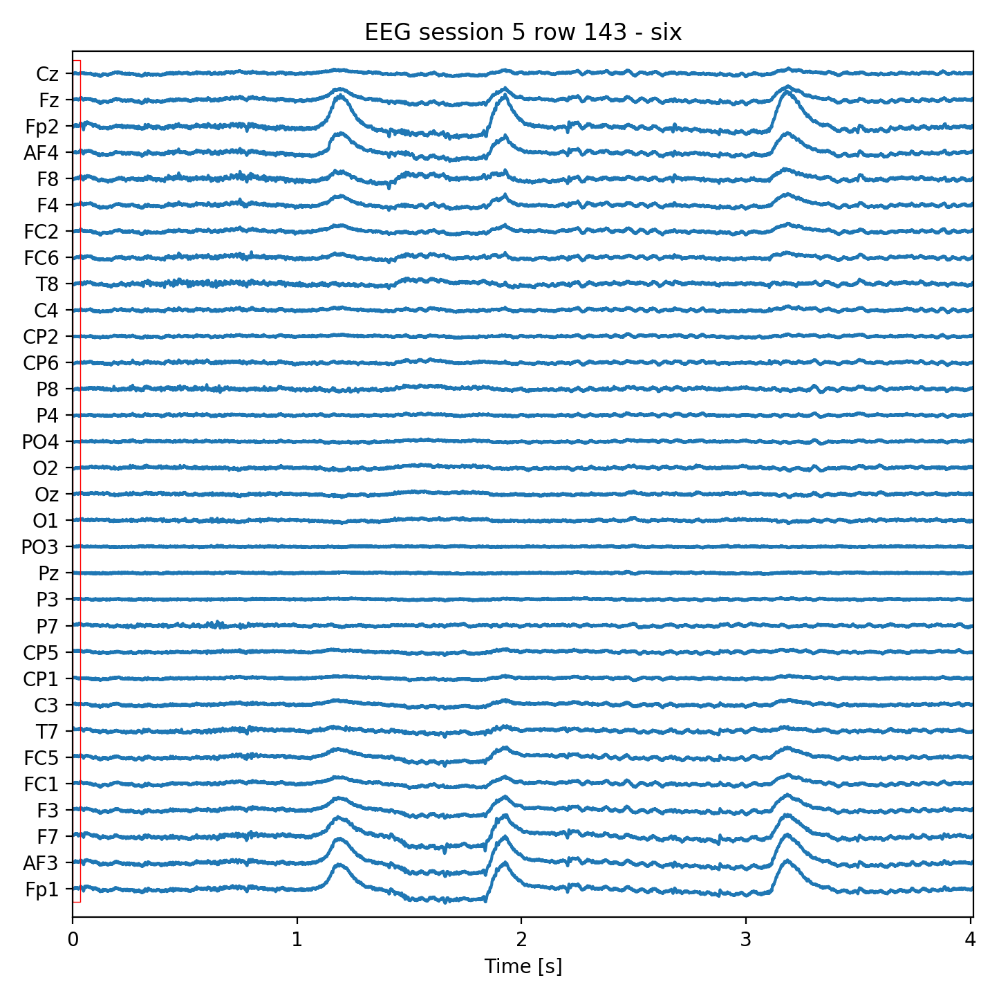

<IPython.core.display.Javascript object>


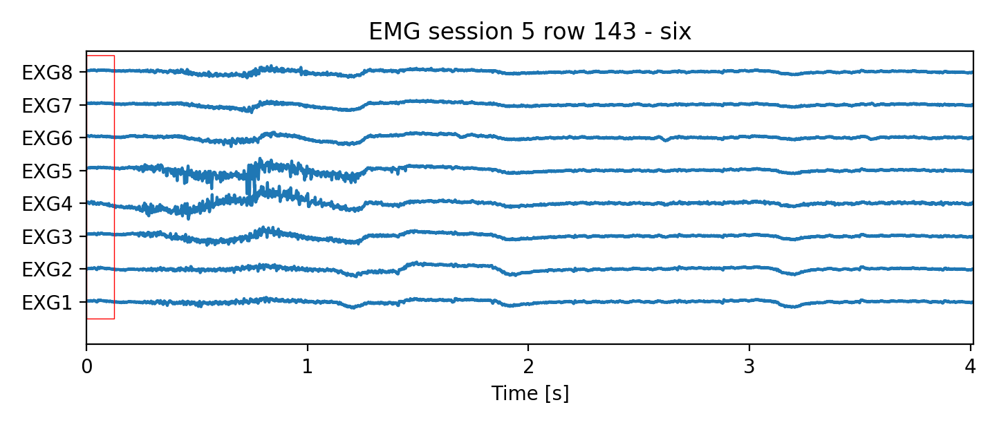

<IPython.core.display.Javascript object>


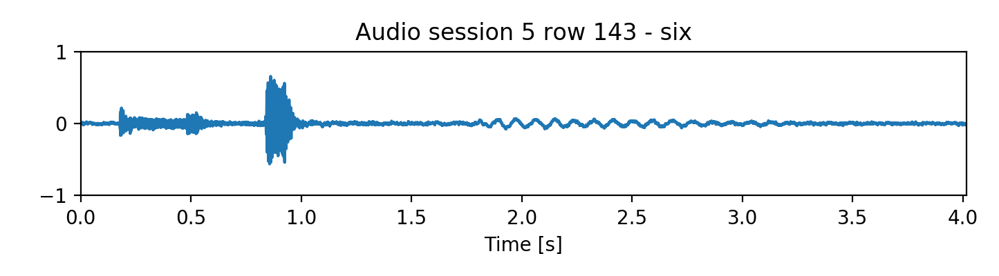

In [11]:
import IPython
from IPython.core.interactiveshell import InteractiveShell
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
#InteractiveShell.ast_node_interactivity = "all"

def show_all_plots(BIO_EEG, BIO_EMG, AUD, EEG_L, EMG_L, description = ""):#, window_bio, window_aud, noverlap):
    line_w = 3 # How many free (black) points (as separation) in figures between 2 electrodes    
    
    if True: #EEG
        eeg_down_s = 1
        eeg_time_down = 1./1
        
        eeg_window  = 64; eeg_window  = int(eeg_window  / eeg_time_down)
        eeg_overlap = 32; eeg_overlap = int(eeg_overlap / eeg_time_down)
        
        #show_data(name = "EEG",data =BIO_EEG, labels = session1_BIO["EEG_ch_L"], downsampl_factor = 1, win_start = 0 / 1000., win_len = 100 / 1000., fs = BIO_fs)
        show_data("EEG " + description, BIO_EEG,EEG_L, fs = BIO_fs, win_len= eeg_window/float(BIO_fs) * eeg_down_s)
        #print(BIO_EEG.shape)
    
    
    # 4,1 or 1, 0.25 seems reasonable
    if True: #EMG
        emg_mel_banks_count = 10        
        emg_down_s = 1
        emg_time_down = 1./4        
        #emg_down_s = 4
        #emg_time_down = 1./1
        emg_window  = 64; emg_window  = int(emg_window  / emg_time_down)
        #emg_overlap = 32; emg_overlap = emg_window - emg_overlap*2 
        emg_overlap = 32; emg_overlap = emg_window - emg_overlap 
        #emg_overlap = 32; emg_overlap = int(emg_overlap / emg_time_down)
                        
        show_data("EMG " + description, BIO_EMG,EMG_L, fs = BIO_fs, win_len= emg_window/float(BIO_fs) * emg_down_s) 
        
        # Spectral analysis                
        if True: 
            # if no need for line separation, use this
            emg_spect = get_spect(BIO_EMG[:][:,::emg_down_s], emg_window, emg_overlap)
            #emg_spect = get_spect(BIO_EMG[:][:,::emg_down_s], emg_window, emg_overlap, use_log = False)
            emg_mb = get_bio_mel_bank(BIO_EMG[:][:,::emg_down_s], emg_window, emg_overlap, emg_mel_banks_count, int(BIO_fs/emg_down_s))        
            add_emg_spect(emg_spect , "EMG " + description,((emg_window-emg_overlap)/float(BIO_fs)*emg_down_s)*emg_spect.shape[0], EMG_L)
            add_emg_mel(emg_mb , "EMG " + description,((emg_window-emg_overlap)/float(BIO_fs)*emg_down_s)*emg_mb.shape[0], EMG_L)
         
        if False:
            emg_spect = np.log(np.abs(spectrogram(BIO_EMG[0,::emg_down_s], emg_window, emg_overlap)))
            emg_spec_bins = emg_spect.shape[1]        
            emg_fbank_mx= mel_fbank_mx(emg_window, fs=int(BIO_fs/emg_down_s), NUMCHANS=emg_mel_banks_count)#, LOFREQ=0.0, HIFREQ=4000.0)
            emg_mb = fbank_htk(BIO_EMG[0,::emg_down_s], emg_window, emg_overlap, emg_fbank_mx, USEPOWER=False, PREEMCOEF=None, ZMEANSOURCE=True)
            emg_mel_bins = emg_mb.shape[1]
            for i in range(1,BIO_EMG.shape[0]):
                emg_spect = np.hstack((emg_spect, np.zeros((emg_spect.shape[0],line_w)), np.log(np.abs(spectrogram(BIO_EMG[i,::emg_down_s], emg_window, emg_overlap)))))
                emg_mb = np.hstack((emg_mb, np.zeros((emg_mb.shape[0],line_w)), fbank_htk(BIO_EMG[i,::emg_down_s], emg_window, emg_overlap, emg_fbank_mx, USEPOWER=False, PREEMCOEF=None, ZMEANSOURCE=True)))

            add_emg_spect(emg_spect , "EMG " + description,((emg_window-emg_overlap)/float(BIO_fs)*emg_down_s)*emg_spect.shape[0], EMG_L, True, BIO_EMG.shape[0], emg_spec_bins, line_w)
            add_emg_mel(emg_mb , "EMG " + description,((emg_window-emg_overlap)/float(BIO_fs)*emg_down_s)*emg_mb.shape[0], EMG_L, True, BIO_EMG.shape[0], emg_mel_bins, line_w)
    
    if True: # AUDIO
        show_one_chan(0,AUD,["Audio " + description], fs = AUD_fs);# add_spect(spec_fig, , "Aud")
    
    
    #show_data("AUDIO", AUD,np.array(["CH" + str(i) for i in range(AUD.shape[0])]), fs = AUD_fs)    

    
emg_spec_counter = 0
emg_mel_counter = 0
max_subplots = 3
col_subplots = 2
#window = 256
#noverlap = 128

# TODO: resample if want any frequencies
# 32  * 64 = 2048
# 125 * 64 = 8000

# 64  * 32 = 2048 31.25 s 
# 250 * 32 = 8000

def add_spect(fig_counter, spect, name, duration, labels = None, draw_line = False, line_max = 8, line_sampl = 20, line_w = 4):
    ax = plt.subplot(max_subplots, col_subplots, fig_counter)
    ax.set_title(name)
    
    if draw_line:
        for i in range(1,line_max):
            ax.axhspan((line_sampl + line_w)*i - line_w + 1.5, (line_sampl + line_w)*i - 0.5,color="black")
        ax.set_yticks([(line_sampl + line_w)*(i + 0.5) for i in range(line_max)])
        ax.set_yticklabels(labels)
        ax.set_xlabel("Time [s]")
    #plt.figure(figsize = figsize)
    plt.tight_layout()

    plt.imshow(spect.T,aspect='auto',extent=[0,duration,spect.shape[1],0]);plt.gca().invert_yaxis()
    
def add_emg_spect(*args):    
    global emg_spec_counter
    emg_spec_counter += 1
    plt.figure(emg_spect_fig_name) 
    add_spect(emg_spec_counter, *args)
    
def add_emg_mel(*args):
    global emg_mel_counter
    emg_mel_counter += 1
    plt.figure(emg_mel_fig_name) 
    add_spect(emg_mel_counter, *args)

emg_spect_fig_name = "EMG_spect"
emg_mel_fig_name = "EMG_Mel"
i = 8
# try i = 223, session1
if VISUALIZE:

    targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = True, silent = False, loud = True)
    print(targ2id)
    emg_spec_counter = 0
    emg_mel_counter = 0
    max_subplots = 3
    col_subplots = 2
    _ = plt.figure(emg_spect_fig_name, figsize = (6 * col_subplots,7 * max_subplots / col_subplots))
    _ = plt.figure(emg_mel_fig_name, figsize = (6 * col_subplots,7 * max_subplots / col_subplots))

    for i in targ2id[id2targ[i]]:
        show_all_plots(SEG_EEG[i], SEG_EMG[i], SEG_AUD[i], EEG_L, EMG_L, "session " + str(sessionid) + " row " + str(i) + " - " + id2targ[i])
        play_audio(SEG_AUD[i])
        play_audio(SEG_AUD[i])
        #ax2 = fig.add_subplot(1, 1, 1)
            
    for i in targ2id[id2targ[66]]:
        show_all_plots(SEG_EEG[i], SEG_EMG[i], SEG_AUD[i], EEG_L, EMG_L, "session " + str(sessionid) + " row " + str(i) + " - " + id2targ[i])
        play_audio(SEG_AUD[i])
        
    for i in targ2id[id2targ[58]][:2]:
        show_all_plots(SEG_EEG[i], SEG_EMG[i], SEG_AUD[i], EEG_L, EMG_L, "session " + str(sessionid) + " row " + str(i) + " - " + id2targ[i])
        play_audio(SEG_AUD[i])


# Component analysis

## PCA

### PCA for pure data

In [31]:
import numpy as np
from sklearn.decomposition import PCA

def compute_pca(data):
    pca = PCA()
    pca.fit(data.T)
    return pca

STACK_SEG_EMG = np.concatenate(SEG_EMG,axis=1)
STACK_SEG_EEG = np.concatenate(SEG_EEG,axis=1)
pca_EMG = compute_pca(STACK_SEG_EMG)
pca_EEG = compute_pca(STACK_SEG_EEG)

pca_FULL_EMG = compute_pca(BIO_EMG)
pca_FULL_EEG = compute_pca(BIO_EEG)


[ 0.95083562 -0.17990479  5.09507242  0.74091202  1.46852275  4.11367456
 17.76983184  2.5498517   3.75261141  6.67331297  7.7435171   2.22384799
  0.69312085  0.94459254  1.37444732 -1.04983865 -7.99371949 -2.01267859
 -3.48783346 -7.75746627 -8.36075465 -3.43479718 -4.93225819 -6.32281903
 -5.37070361 -2.0692147  -3.31913325 -4.53858423 -0.28788244 -4.70739741
 -1.45694345 -1.02700252]
(32,)
[ 1.33254752  0.20180711  5.47678432  1.12262392  1.85023465  4.49538646
 18.15154374  2.9315636   4.13432331  7.05502487  8.125229    2.60555989
  1.07483275  1.32630444  1.75615922 -0.66812675 -7.61200759 -1.63096669
 -3.10612156 -7.37575437 -7.97904275 -3.05308528 -4.55054629 -5.94110713
 -4.98899171 -1.6875028  -2.93742134 -4.15687233  0.09382946 -4.32568551
 -1.07523155 -0.64529062]


<IPython.core.display.Javascript object>


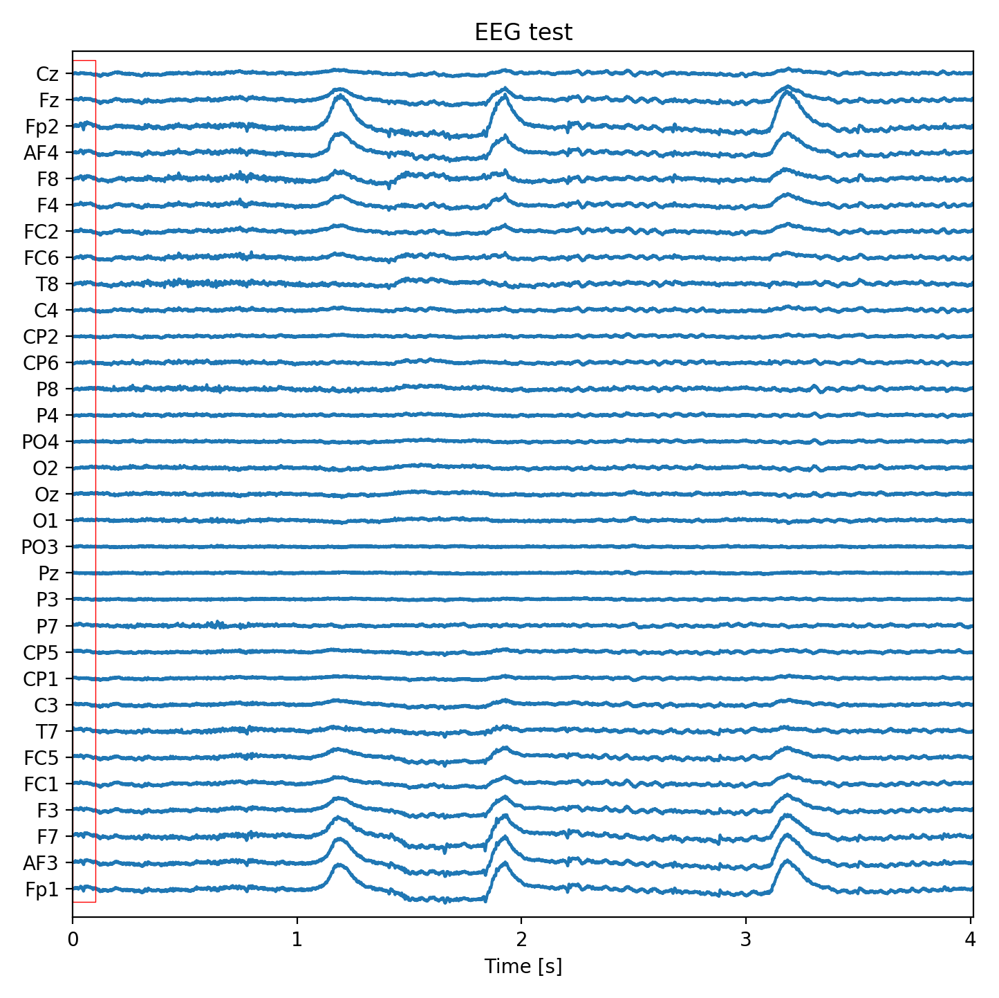

(32, 8223)


<IPython.core.display.Javascript object>


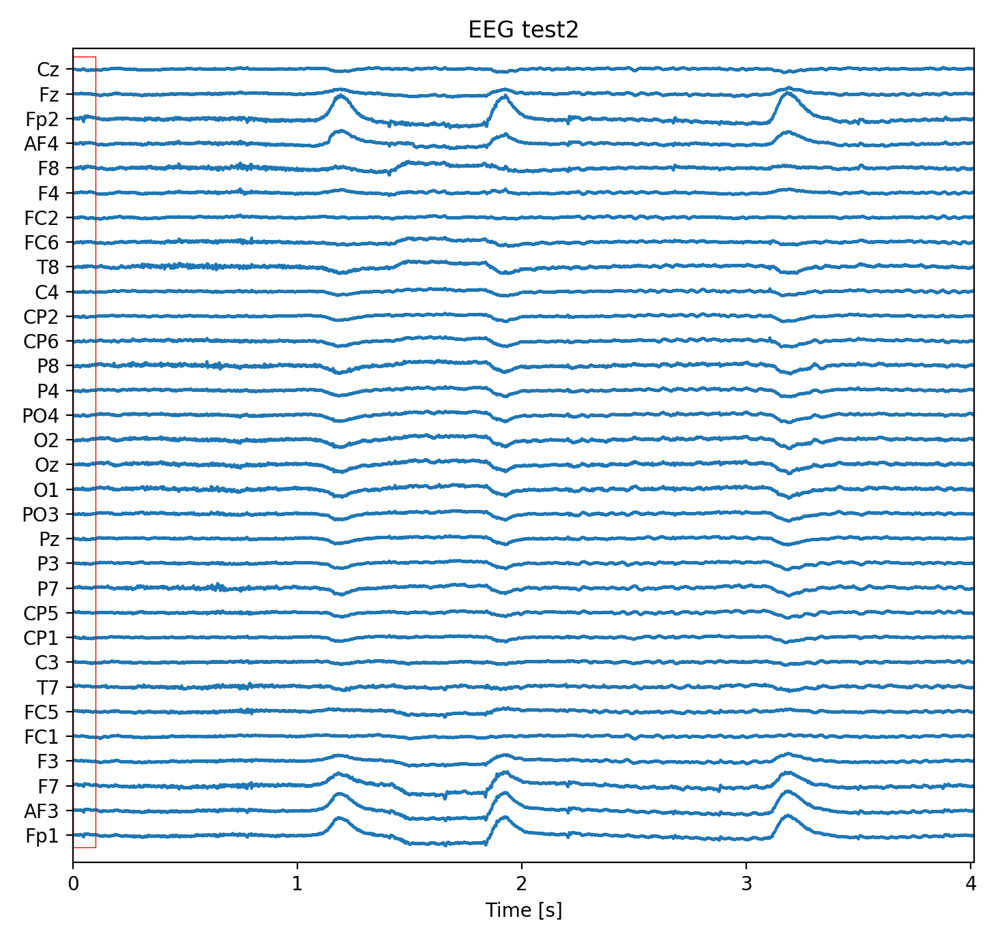

In [39]:
def perform_car(data): # Common average reference
    print(data.shape)
    return data - np.mean(data, axis = 0)

print(SEG_EEG[i][:,5])
print(perform_car(SEG_EEG[i][:,5]))

show_data("EEG test", SEG_EEG[i],EEG_L, fs = BIO_fs, win_len= 0.1) # show just fixed win_len
show_data("EEG test2", perform_car(SEG_EEG[i]),EEG_L, fs = BIO_fs, win_len= 0.1) # show just fixed win_len

/anaconda2/envs/python3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


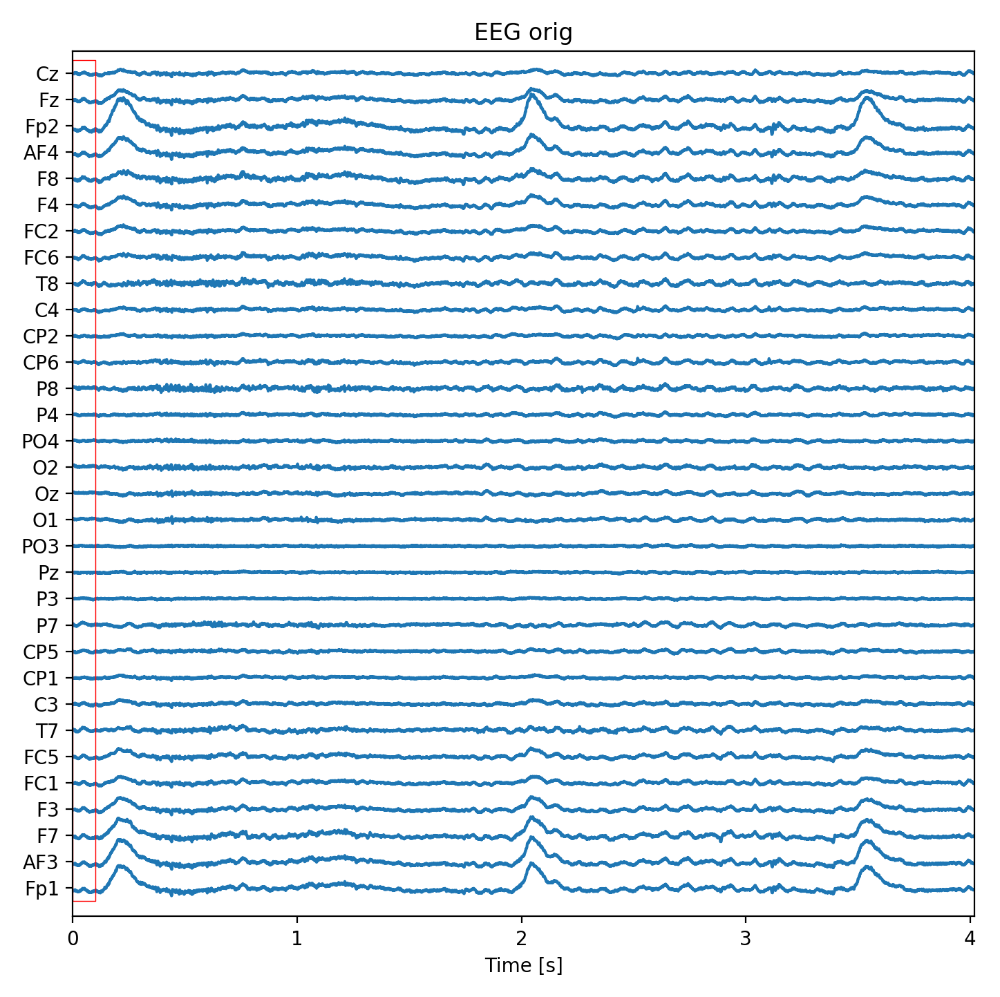

<IPython.core.display.Javascript object>

In [36]:
# Try to transofrm data without first dimension
#pca_EEG

def sh_fr_to(pca, data, fr, to, sp_max, sp_col, sp_cnt, all_same):    
    show_data("EEG  (" + (str(fr) if fr != None else "") + ":" + (str(to) if to != None else "") + ")", np.dot(pca.components_[fr:to].T, np.dot(pca.components_[fr:to], data)),EEG_L, fs = BIO_fs, win_len= 0.1
             , fig_name = "EEG_down", sp_max = sp_max, sp_col = sp_col, sp_cnt = sp_cnt, use_same_scale = all_same) 
    
def show_all_seg(pca, data, all_same):
    global sp_cnt
    for i in range(len(data)):
        sh_fr_to(pca,data, i,i+1 , len(data), 3, sp_cnt, all_same); sp_cnt += 1
        sh_fr_to(pca,data, 0,i   , len(data), 3, sp_cnt, all_same); sp_cnt += 1
        sh_fr_to(pca,data, i,None, len(data), 3, sp_cnt, all_same); sp_cnt += 1
    

targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = True, silent = False)
#print(targ2id)

i = 47
show_data("EEG orig", SEG_EEG[i],EEG_L, fs = BIO_fs, win_len= 0.1) # show just fixed win_len


sp_cnt = 1    
#sh_fr_to(pca_EEG, SEG_EEG[i], 1, None,4,2,1)
#sh_fr_to(pca_EEG, SEG_EEG[i], None, 1,4,2,2)
use_same_scale  = True
show_all_seg(pca_EEG, SEG_EEG[i], use_same_scale)
plt.savefig(os.path.join(save_dir, "EEG" + ("_all_same" if use_same_scale else "") + "_ses_" + sessionid + "_row_" + str(i) ))






    

[15515.37376116  5616.00442958  1453.35515337  1252.82368728
   600.60383464   308.13392935   135.91613785    72.05812135]


<IPython.core.display.Javascript object>


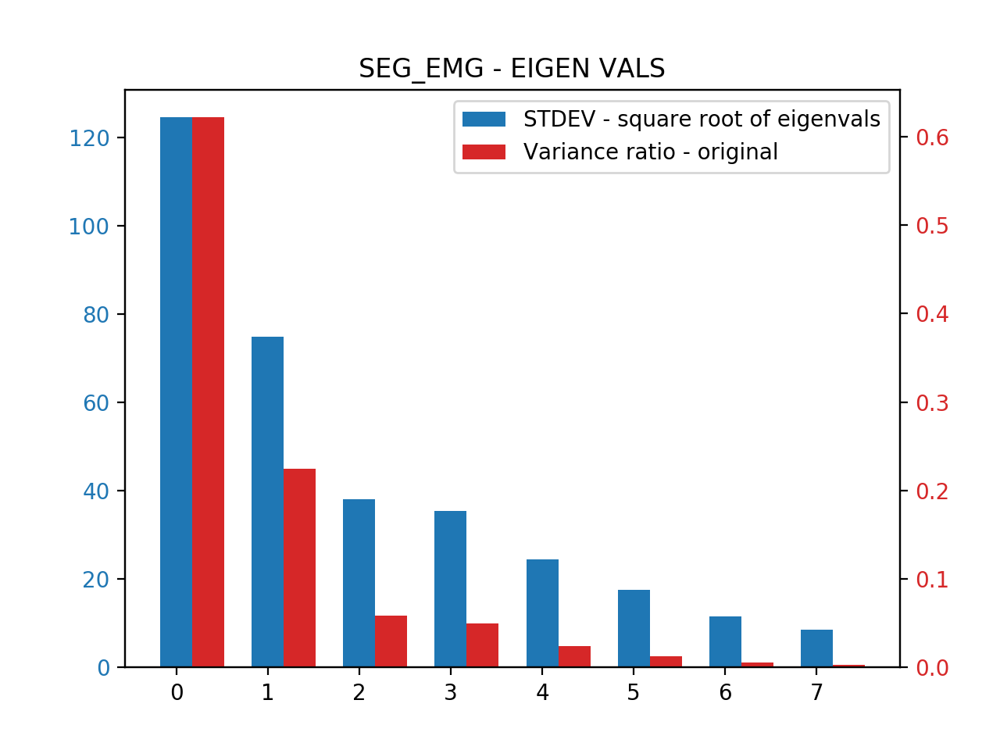

<IPython.core.display.Javascript object>


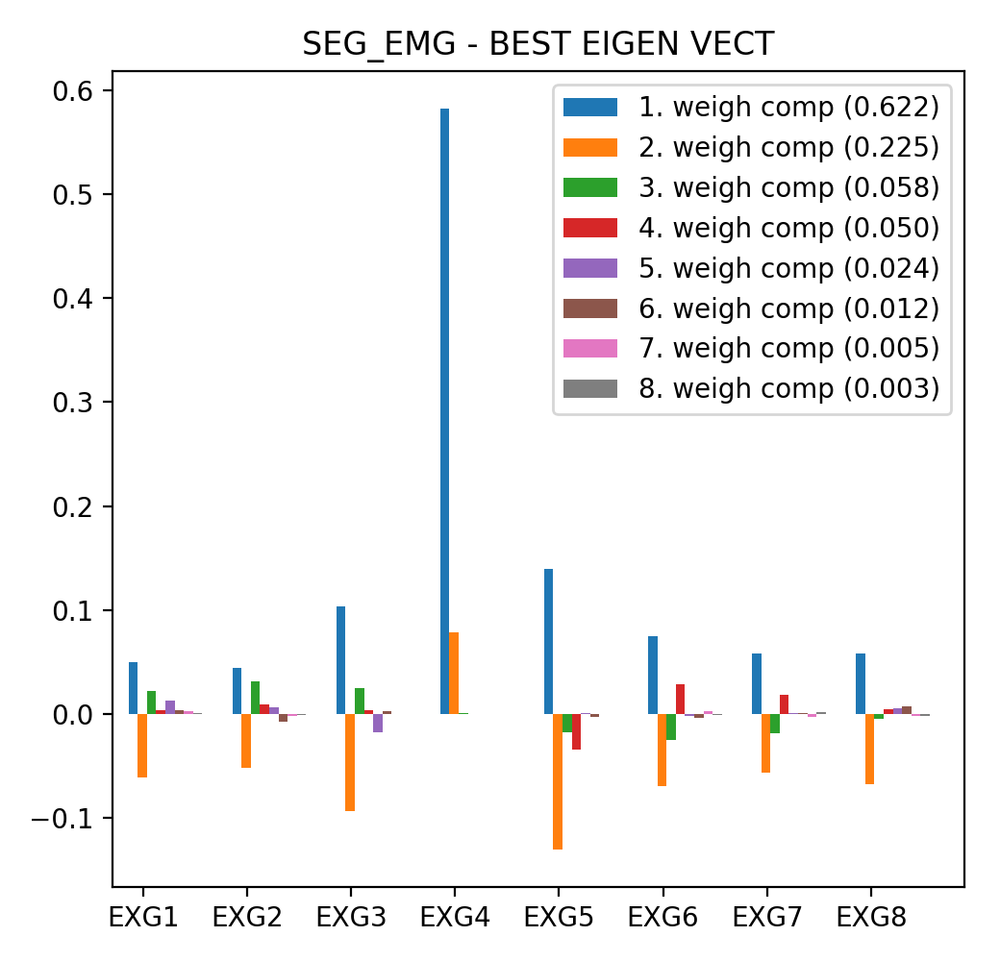

[7285.17247264 2872.87863847 1281.60309091  710.63560429  316.04524394
  250.05496945  150.61799318   75.10145482]


<IPython.core.display.Javascript object>


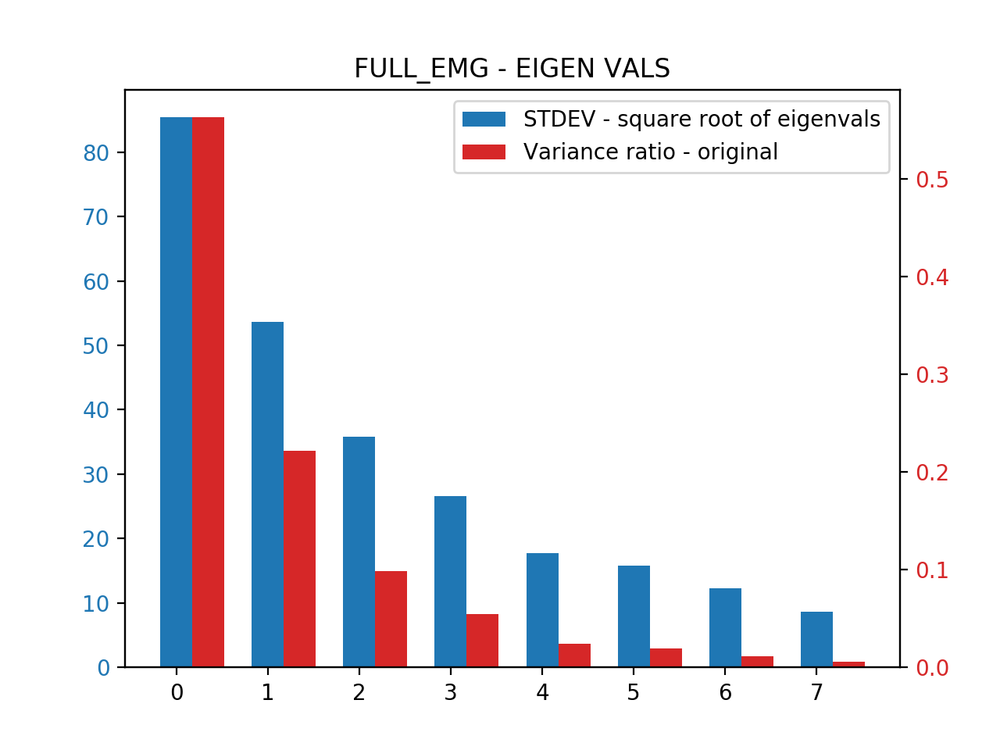

<IPython.core.display.Javascript object>


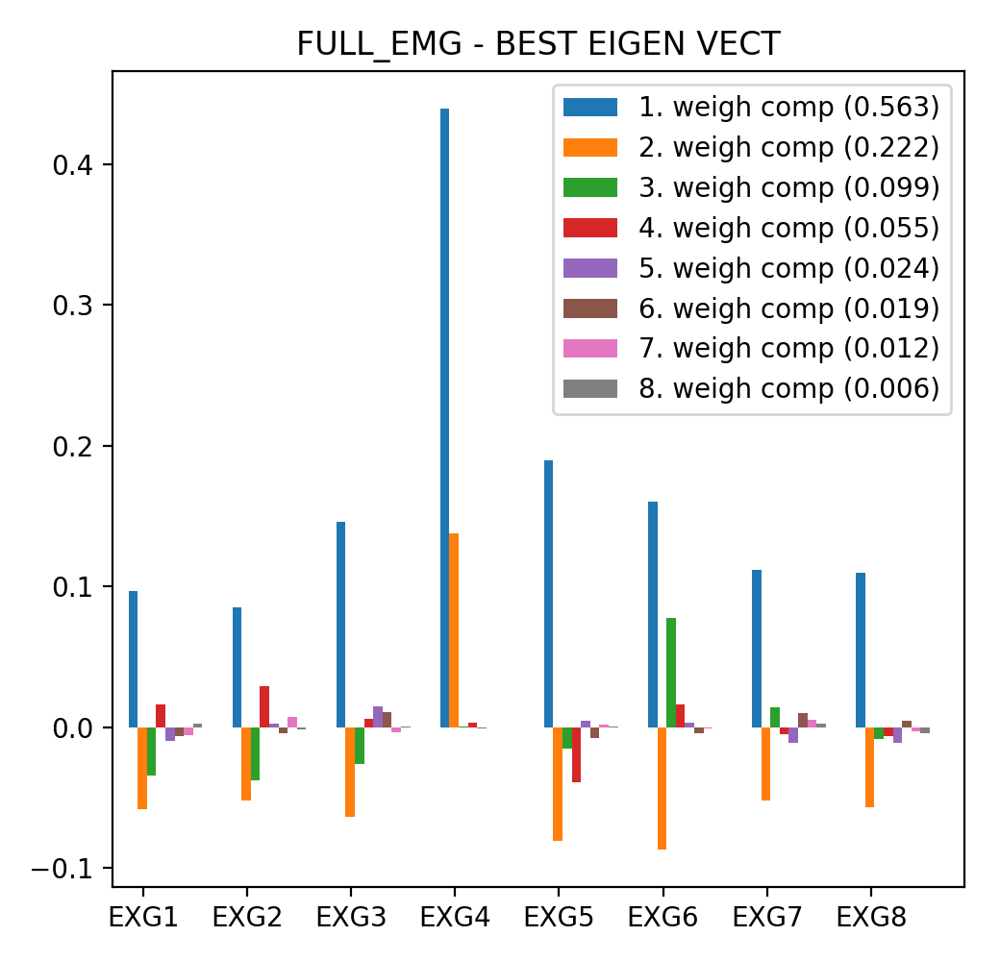

[7.18358834e+03 5.06611403e+02 3.22800755e+02 1.86132661e+02
 1.26448432e+02 6.38218089e+01 5.82973637e+01 4.99280682e+01
 3.52065254e+01 3.22204382e+01 2.66183868e+01 1.94395376e+01
 1.82705025e+01 1.30022497e+01 1.24460178e+01 9.63518240e+00
 8.59013253e+00 6.66649076e+00 5.86102262e+00 4.97302927e+00
 4.17107059e+00 3.81603987e+00 3.27506873e+00 2.57077517e+00
 2.36404488e+00 1.93466960e+00 1.73557173e+00 1.64978689e+00
 1.61119230e+00 1.46252241e+00 1.34887397e+00 9.41927365e-01]


<IPython.core.display.Javascript object>


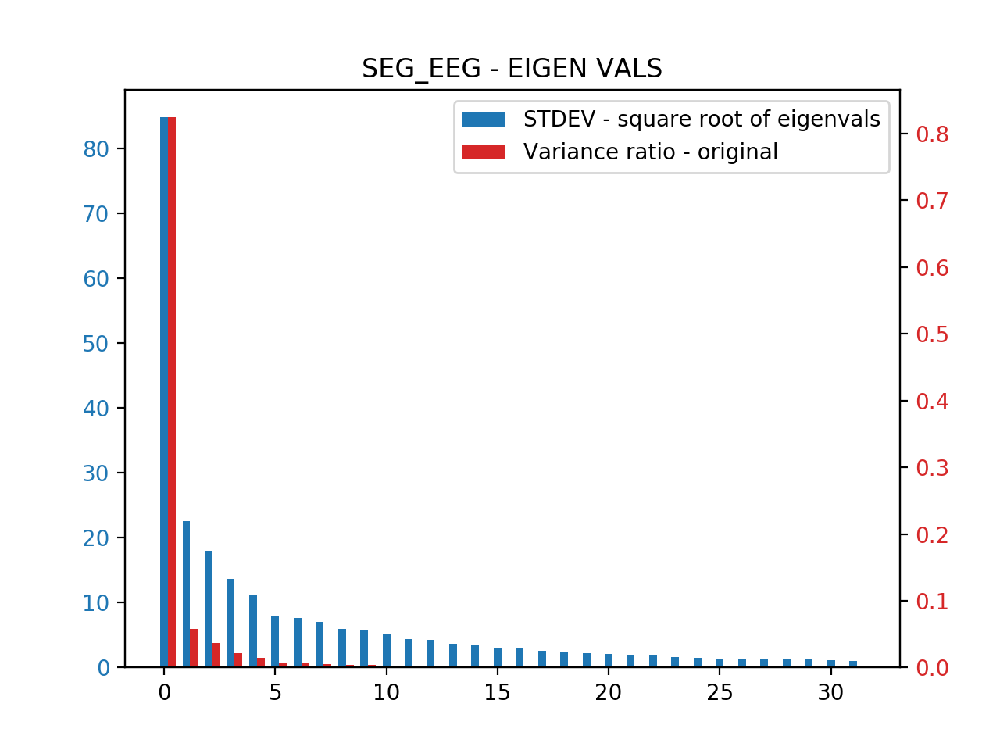

<IPython.core.display.Javascript object>


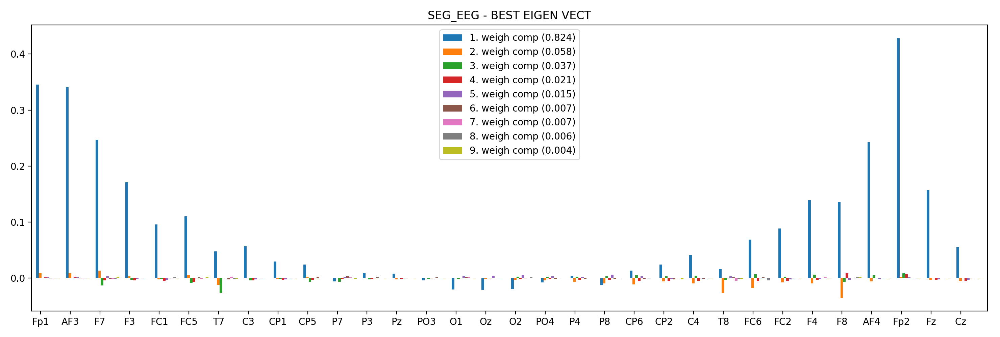

[7.10467002e+03 6.65083278e+02 6.08583272e+02 2.64906057e+02
 2.36102469e+02 1.78027753e+02 1.37511001e+02 8.74663832e+01
 8.28487727e+01 5.99595416e+01 5.27013855e+01 3.45908594e+01
 3.30637878e+01 2.14789793e+01 1.97819071e+01 1.80953504e+01
 1.17782533e+01 1.03728181e+01 8.97480947e+00 7.73536342e+00
 6.76283189e+00 5.39388232e+00 4.44584736e+00 3.15419418e+00
 2.79223837e+00 2.29099973e+00 2.17595341e+00 1.92426483e+00
 1.76076916e+00 1.53600297e+00 1.39651489e+00 9.69662879e-01]


<IPython.core.display.Javascript object>


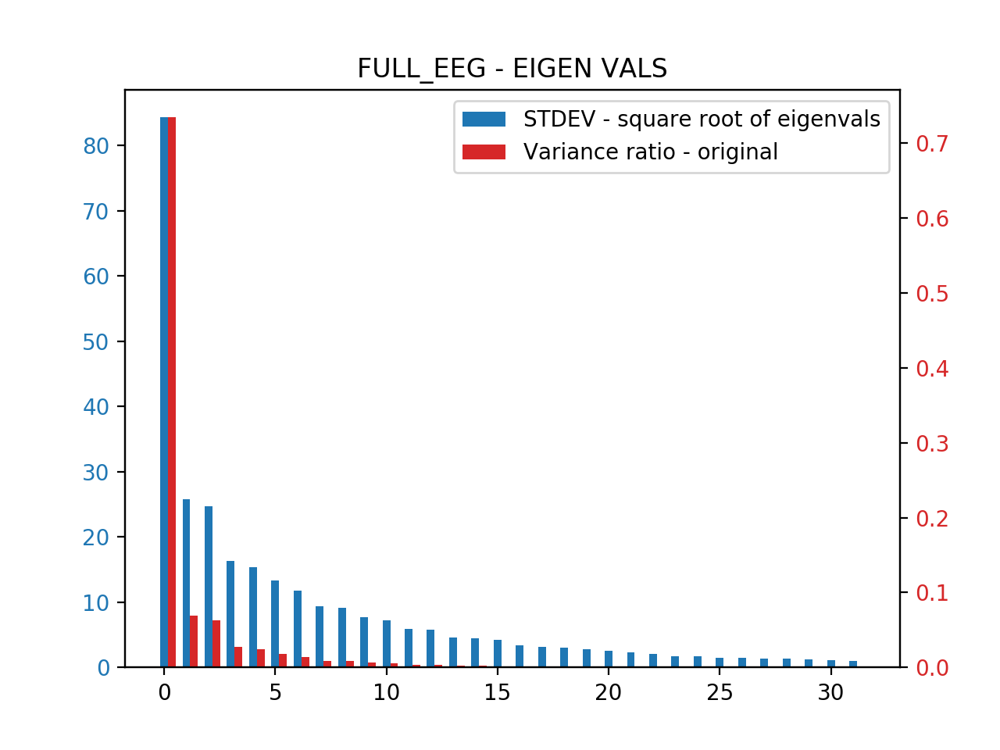

<IPython.core.display.Javascript object>


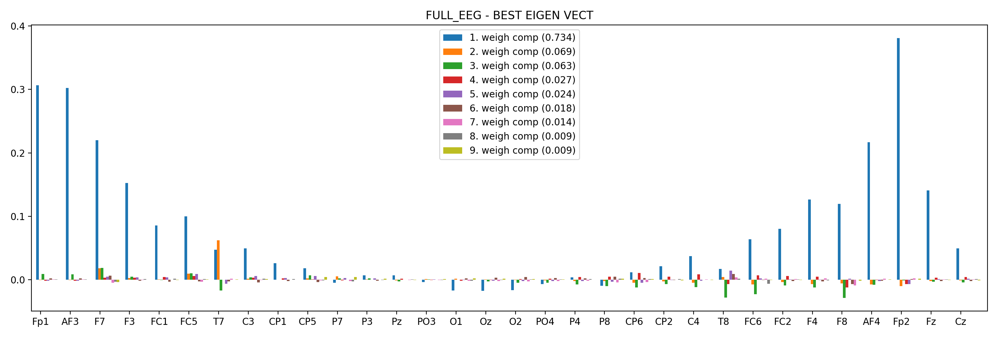

In [40]:
def show_pca(pca, name, labels):    
    eig_vals_ratio = pca.explained_variance_ratio_
    eig_vals = pca.explained_variance_
    eig_vect = pca.components_

    #print(STACK_SEG_EMG.shape)
    print(eig_vals)
    #print(eig_vect.shape)

    bar_width = 0.35

    fig, ax1 = plt.subplots(); plt.title(name + " - EIGEN VALS"); color = 'tab:blue'
    ax1.bar(np.arange(len(eig_vals)),np.sqrt(eig_vals), bar_width, label = "STDEV - square root of eigenvals", color = color );
    ax1.tick_params(axis='y', labelcolor=color)    
    ax2 = ax1.twinx(); color = 'tab:red'
    ax2.bar(np.arange(len(eig_vals_ratio)) + bar_width,eig_vals_ratio, bar_width, label = "Variance ratio - original", color = color );
    ax2.tick_params(axis='y', labelcolor=color)
    
    lines, lab1 = ax1.get_legend_handles_labels()
    lines2, lab2 = ax2.get_legend_handles_labels()
    ax2.legend(lines + lines2, lab1 + lab2, loc=0)
    
    fig, ax = plt.subplots(figsize = (2 + 0.4 * len(eig_vals),5))

    component_c = 9
    bar_width = 0.8 / component_c 
    indices = np.arange(len(eig_vals))
    #print(len(indices))
    #print(eig_vect[0].shape)
    #plt.bar(indices,eig_vect[0], bar_width , label = str(i + 1) + ". component")
    for i in range(min(component_c,len(eig_vals))):
        #plt.bar(indices + i * bar_width,eig_vect[i], bar_width , label = str(i + 1) + ". component")
        plt.bar(indices + i * bar_width,eig_vect[i] * eig_vals_ratio[i], bar_width , label = str(i + 1) + ". weigh comp (" + "{:.3f}".format(eig_vals_ratio[i]) + ")")
    plt.title(name + " - BEST EIGEN VECT")

    ax.set_xticks(indices + 0.1)
    ax.set_xticklabels(labels)
    ax.set_xlim(-0.2,len(eig_vals))
    
    plt.legend()
    plt.tight_layout()
    plt.savefig("sess1")
    #plt.bar(np.arange(1,len(eig_vals) + 1) + bar_width,eig_vect[1], 0.35 ); plt.title("EMG - BEST EIGEN VECT")

    
show_pca(pca_EMG, "SEG_EMG", EMG_L)
show_pca(pca_FULL_EMG, "FULL_EMG", EMG_L)
show_pca(pca_EEG, "SEG_EEG", EEG_L)
show_pca(pca_FULL_EEG, "FULL_EEG", EEG_L)



In [41]:
[seg.shape for seg in SEG_EEG]

[(32, 12411),
 (32, 12412),
 (32, 12104),
 (32, 12104),
 (32, 8232),
 (32, 8233),
 (32, 10772),
 (32, 10773),
 (32, 8234),
 (32, 8233),
 (32, 8223),
 (32, 8233),
 (32, 11654),
 (32, 11654),
 (32, 8234),
 (32, 8233),
 (32, 11060),
 (32, 11070),
 (32, 10988),
 (32, 10998),
 (32, 13354),
 (32, 13354),
 (32, 10179),
 (32, 10179),
 (32, 10118),
 (32, 10097),
 (32, 14971),
 (32, 14962),
 (32, 15995),
 (32, 15995),
 (32, 10854),
 (32, 10834),
 (32, 8234),
 (32, 8233),
 (32, 8223),
 (32, 8233),
 (32, 12330),
 (32, 12329),
 (32, 10466),
 (32, 10486),
 (32, 8235),
 (32, 8223),
 (32, 10977),
 (32, 10998),
 (32, 11797),
 (32, 11797),
 (32, 8233),
 (32, 8233),
 (32, 8243),
 (32, 8233),
 (32, 8233),
 (32, 8234),
 (32, 8233),
 (32, 8233),
 (32, 9892),
 (32, 9892),
 (32, 10835),
 (32, 10834),
 (32, 8233),
 (32, 8233),
 (32, 11367),
 (32, 11347),
 (32, 12472),
 (32, 12463),
 (32, 14685),
 (32, 14684),
 (32, 15197),
 (32, 15197),
 (32, 8233),
 (32, 8233),
 (32, 10404),
 (32, 10404),
 (32, 8233),
 (32, 8

[3060.85287049  549.52322142  240.88412197  141.4082853    94.71374308
   55.80398286   39.90803962   28.83113954]


/anaconda2/envs/python3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


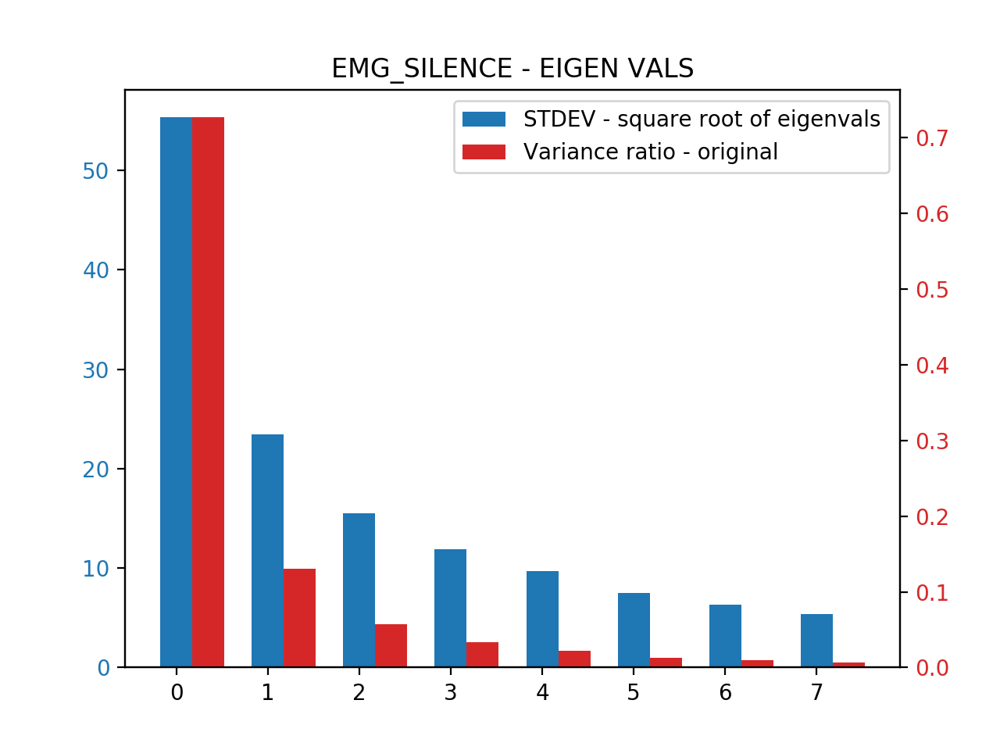

<IPython.core.display.Javascript object>


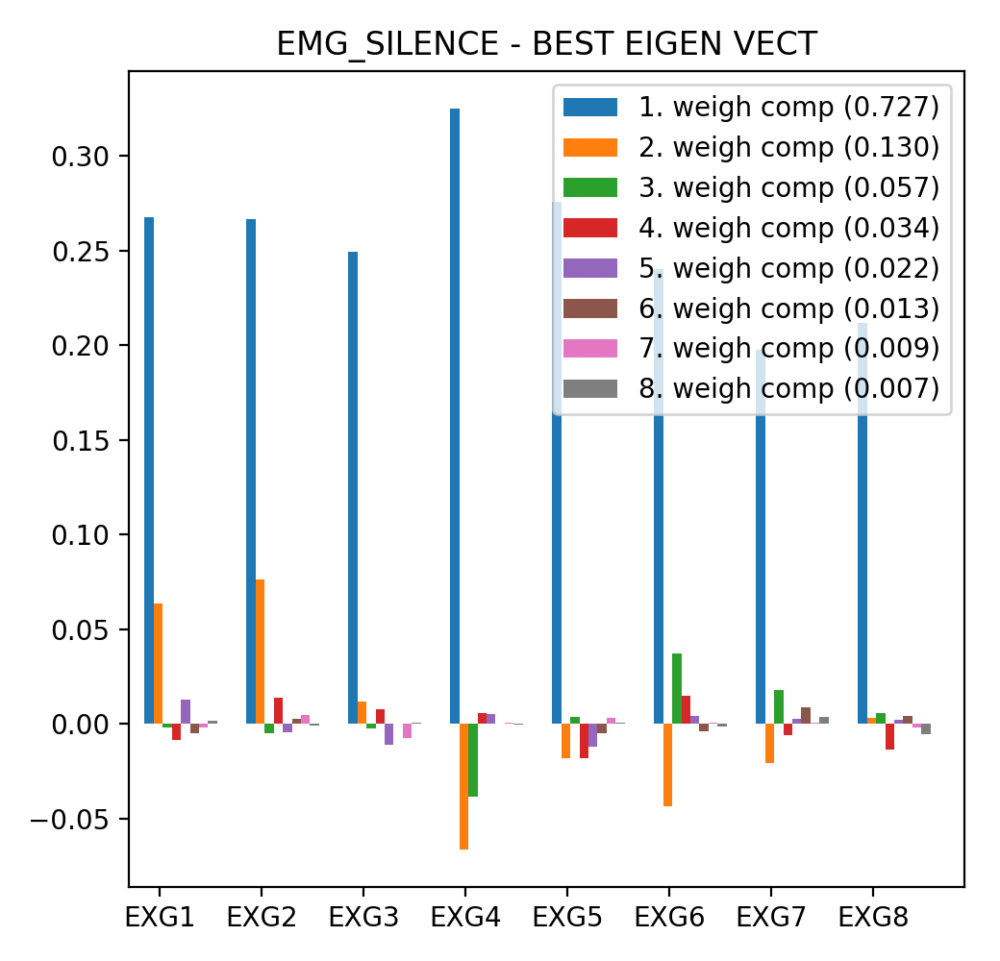

[7.54290056e+03 3.96108984e+02 2.12999310e+02 1.29679423e+02
 1.02183676e+02 5.73533062e+01 5.06425939e+01 4.15398171e+01
 3.56992247e+01 2.84431726e+01 2.48159977e+01 1.95045522e+01
 1.56648424e+01 1.47664552e+01 1.08591477e+01 9.94528458e+00
 7.58828550e+00 6.13168759e+00 5.48897640e+00 5.15105687e+00
 4.09123492e+00 3.61911429e+00 3.24322484e+00 2.54158912e+00
 2.17132137e+00 1.77210507e+00 1.65338765e+00 1.62998669e+00
 1.54553394e+00 1.42784344e+00 1.32015761e+00 9.43711333e-01]


/anaconda2/envs/python3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [42]:
show_pca(compute_pca(np.concatenate([seg[:,-1000:-500] for seg in SEG_EMG],axis=1)), "EMG_SILENCE", EMG_L)
show_pca(compute_pca(np.concatenate([seg[:,-1000:-500] for seg in SEG_EEG],axis=1)), "EEG_SILENCE", EEG_L)

### PCA for spectral 

In [45]:
STACK_SEG_EMG_spect = np.concatenate(SEG_EMG,axis=1)
STACK_SEG_EEG_spect = np.concatenate(SEG_EEG,axis=1)


mel_banks_count = 10        
down_s = 1
time_down = 1./4        
#down_s = 4
#time_down = 1./1
window  = 64; window  = int(window  /time_down)
#overlap = 32; overlap =     window - overlap*2 
overlap = 32; overlap =     window - overlap 
#overlap = 32; overlap = int(overlap /time_down)
                        

emg_spect = get_spect(STACK_SEG_EMG_spect[:,::down_s], window, overlap, take_only_first_coef = 20, use_log = False)
emg_spect_log = get_spect(STACK_SEG_EMG_spect[:,::down_s], window, overlap, take_only_first_coef = 20)
pca_EMG_spect = compute_pca(emg_spect.T)#, n_components = 10)
pca_EMG_spect_log = compute_pca(emg_spect_log.T)#, n_components = 10)

emg_mb = get_bio_mel_bank(STACK_SEG_EMG_spect[:][:,::down_s], window, overlap, mel_banks_count, int(BIO_fs/down_s))#, HIFREQ=512)        
pca_EMG_mb = compute_pca(emg_mb.T)#, n_components = 10)

#emg_spect = get_spect(STACK_SEG_EMG_spect[:][:,::emg_down_s], emg_window, emg_overlap, use_log = False)


#add_emg_spect(emg_spect , "EMG " + description,((emg_window-emg_overlap)/float(BIO_fs)*emg_down_s)*emg_spect.shape[0], EMG_L)
#add_emg_mel(emg_mb , "EMG " + description,((emg_window-emg_overlap)/float(BIO_fs)*emg_down_s)*emg_mb.shape[0], EMG_L)
         



In [46]:
print(STACK_SEG_EMG_spect.shape)

(8, 2941547)


[65.43173434  7.42854191  3.82117235  3.15179009  2.70139407  2.44958968
  2.02367012  1.82105837  1.52523718  1.48645303  1.37918283  1.36036321
  1.19422431  1.10707917  1.08992506  1.00763081  0.9194889   0.91041047
  0.8439407   0.83682204  0.80774838  0.79603918  0.77189381  0.72779912
  0.67865926  0.67274531  0.66953084  0.65160925  0.63878967  0.63201955
  0.60628197  0.59780196  0.59349456  0.58086061  0.57958844  0.57860796
  0.56654923  0.55423704  0.54699936  0.53513427  0.53128775  0.52191645
  0.51657369  0.51397343  0.51036685  0.49790867  0.4910324   0.4887073
  0.47764527  0.47042542  0.46677514  0.46291343  0.459075    0.4500331
  0.4476603   0.44298796  0.43455822  0.43331239  0.4180519   0.41244073
  0.4101785   0.40826452  0.40696633  0.40161939  0.39825379  0.3953708
  0.39043979  0.3880682   0.38506245  0.38094049  0.37539369  0.36504032
  0.36382451  0.35978367  0.35849606  0.35426791  0.35040936  0.34634761
  0.34397945  0.33820633  0.33508304  0.32933734  0.32

/anaconda2/envs/python3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


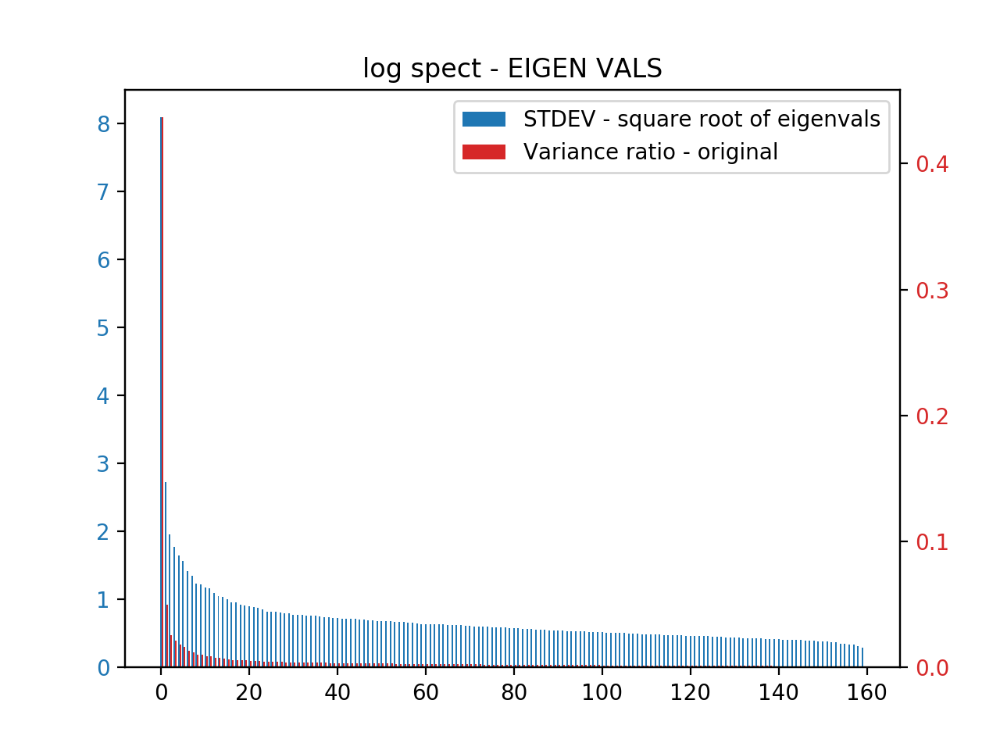

<IPython.core.display.Javascript object>


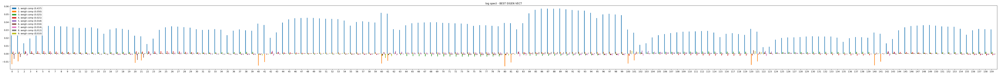

[2.21214366e+08 4.31603770e+07 1.27450000e+07 9.80805673e+06
 7.54957635e+06 3.14642453e+06 2.22009204e+06 1.51296136e+06
 1.37003858e+06 1.02956094e+06 9.39831517e+05 7.16650993e+05
 6.69651244e+05 5.22444366e+05 4.33792272e+05 3.66452816e+05
 3.54648926e+05 3.46942961e+05 3.26713869e+05 3.00267521e+05
 2.76634073e+05 2.70055569e+05 2.55005254e+05 2.43092439e+05
 2.38377927e+05 2.33594143e+05 2.07448395e+05 1.88272876e+05
 1.85610456e+05 1.77049085e+05 1.57555939e+05 1.50236483e+05
 1.37744365e+05 1.34694795e+05 1.26995883e+05 1.23856092e+05
 1.22734545e+05 1.20288150e+05 1.12777134e+05 1.08114442e+05
 1.03434676e+05 1.00116500e+05 9.48413988e+04 9.30742433e+04
 8.84307466e+04 8.70340241e+04 8.38265918e+04 8.22967249e+04
 7.64715457e+04 7.47159929e+04 7.35038610e+04 7.13786386e+04
 6.86615043e+04 6.57875279e+04 6.44491645e+04 6.22940604e+04
 5.82044574e+04 5.70933224e+04 5.67038367e+04 5.50619291e+04
 5.37260621e+04 4.97464214e+04 4.84029122e+04 4.76449717e+04
 4.68039579e+04 4.569996

<IPython.core.display.Javascript object>


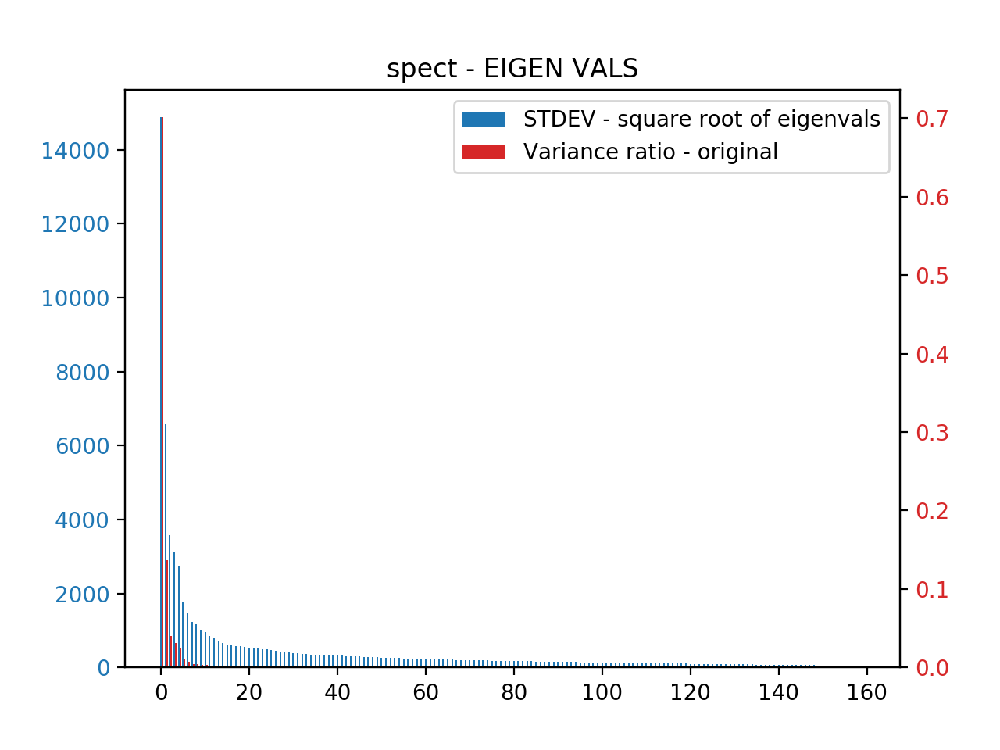

<IPython.core.display.Javascript object>


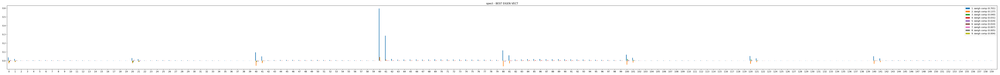

[1.53837478e+01 1.27364184e+00 6.37064444e-01 4.13879456e-01
 3.20554742e-01 2.85386153e-01 2.26060129e-01 1.75936529e-01
 1.37572265e-01 1.21373185e-01 1.08991669e-01 9.13737387e-02
 8.42497607e-02 7.91418018e-02 7.31448515e-02 6.73400012e-02
 6.51893967e-02 6.21479194e-02 5.99263839e-02 5.55086934e-02
 4.86055313e-02 4.69047425e-02 4.42202329e-02 4.15024987e-02
 4.06519877e-02 4.03095218e-02 3.85761070e-02 3.76826603e-02
 3.71910211e-02 3.42288940e-02 3.28984638e-02 3.22631712e-02
 3.13130801e-02 3.05965282e-02 2.96742908e-02 2.89981448e-02
 2.74844864e-02 2.68518614e-02 2.59924833e-02 2.48494190e-02
 2.45771833e-02 2.41216012e-02 2.31611545e-02 2.27049358e-02
 2.23230988e-02 2.13972783e-02 2.09563865e-02 2.05099260e-02
 1.98440445e-02 1.91998261e-02 1.87588580e-02 1.80296289e-02
 1.75070909e-02 1.70961037e-02 1.69615535e-02 1.65128372e-02
 1.60021791e-02 1.53101225e-02 1.48687704e-02 1.44586164e-02
 1.42630909e-02 1.39617912e-02 1.35712029e-02 1.26004333e-02
 1.23136935e-02 1.205933

<IPython.core.display.Javascript object>


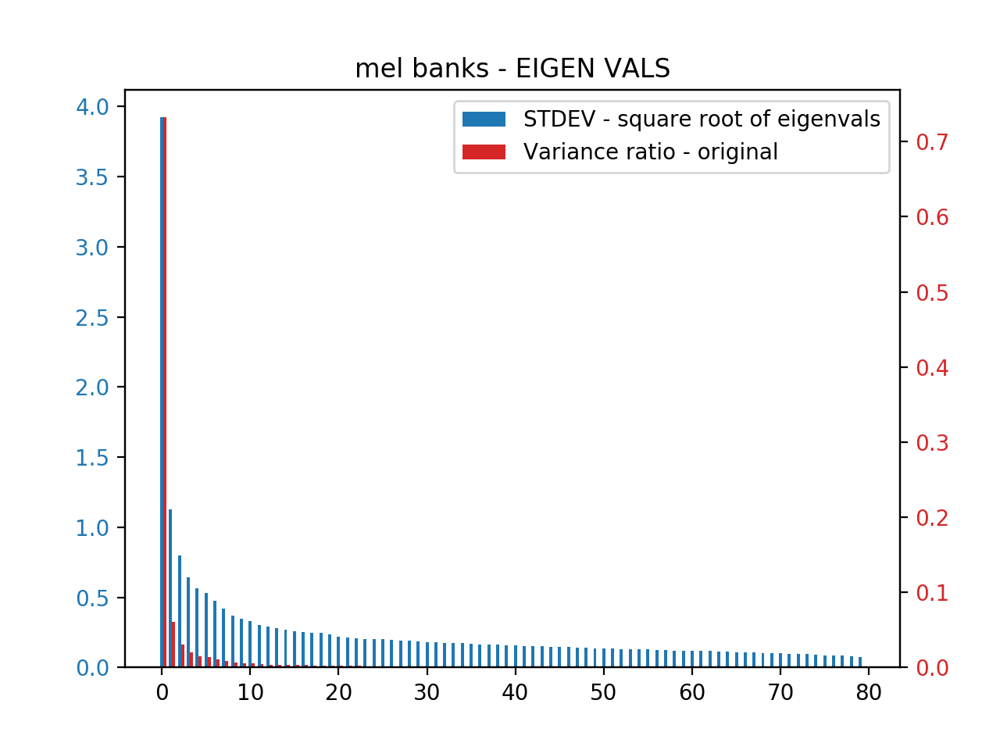

<IPython.core.display.Javascript object>


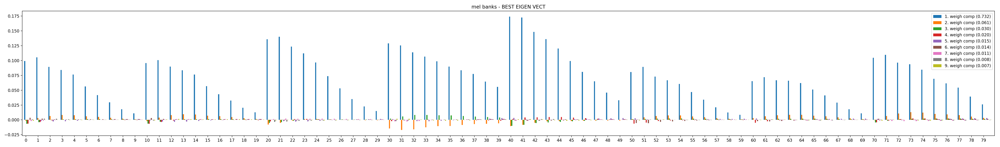

In [47]:
show_pca(pca_EMG_spect_log, "log spect", [str(i) for i in range(1032)])
show_pca(pca_EMG_spect, "spect", [str(i) for i in range(1032)])
show_pca(pca_EMG_mb, "mel banks", [str(i) for i in range(1032)])

In [48]:
eeg_spect = get_spect(STACK_SEG_EEG_spect[:,::down_s], window, overlap, take_only_first_coef = 20, use_log = False)
eeg_spect_log = get_spect(STACK_SEG_EEG_spect[:,::down_s], window, overlap, take_only_first_coef = 20)
pca_EEG_spect = compute_pca(eeg_spect.T)#, n_components = 10)
pca_EEG_spect_log = compute_pca(eeg_spect_log.T)#, n_components = 10)

mel_banks_count = 1
eeg_mb = get_bio_mel_bank(STACK_SEG_EEG_spect[:][:,::down_s], window, overlap, mel_banks_count, int(BIO_fs/down_s))#, HIFREQ=512)        
pca_EEG_mb = compute_pca(eeg_mb.T)#, n_components = 10)

[9.28688469e+00 6.63716049e-01 4.81815216e-01 3.38787429e-01
 2.32389826e-01 1.98643497e-01 1.86083569e-01 1.16296828e-01
 1.02683185e-01 8.68785420e-02 7.42224804e-02 6.95572178e-02
 6.55541966e-02 6.17846211e-02 4.98618094e-02 4.85925126e-02
 4.46576914e-02 4.27406834e-02 3.97127065e-02 3.78799160e-02
 3.59501449e-02 3.40422232e-02 3.27321259e-02 3.05374153e-02
 2.88648068e-02 2.74595349e-02 2.56462165e-02 2.41447549e-02
 2.37579035e-02 2.17744534e-02 2.09410891e-02 1.96276330e-02
 1.91951794e-02 1.84716319e-02 1.79038096e-02 1.76799225e-02
 1.71020836e-02 1.68854727e-02 1.63391463e-02 1.61054774e-02
 1.54507092e-02 1.51646532e-02 1.46987795e-02 1.44095310e-02
 1.42811867e-02 1.39316129e-02 1.37638168e-02 1.35566070e-02
 1.34806659e-02 1.31610270e-02 1.30799298e-02 1.29553931e-02
 1.28463129e-02 1.25411936e-02 1.22686948e-02 1.21453876e-02
 1.18989545e-02 1.18224771e-02 1.17096451e-02 1.15493110e-02
 1.12837169e-02 1.12144086e-02 1.10665796e-02 1.10396603e-02
 1.09784502e-02 1.066925

/anaconda2/envs/python3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


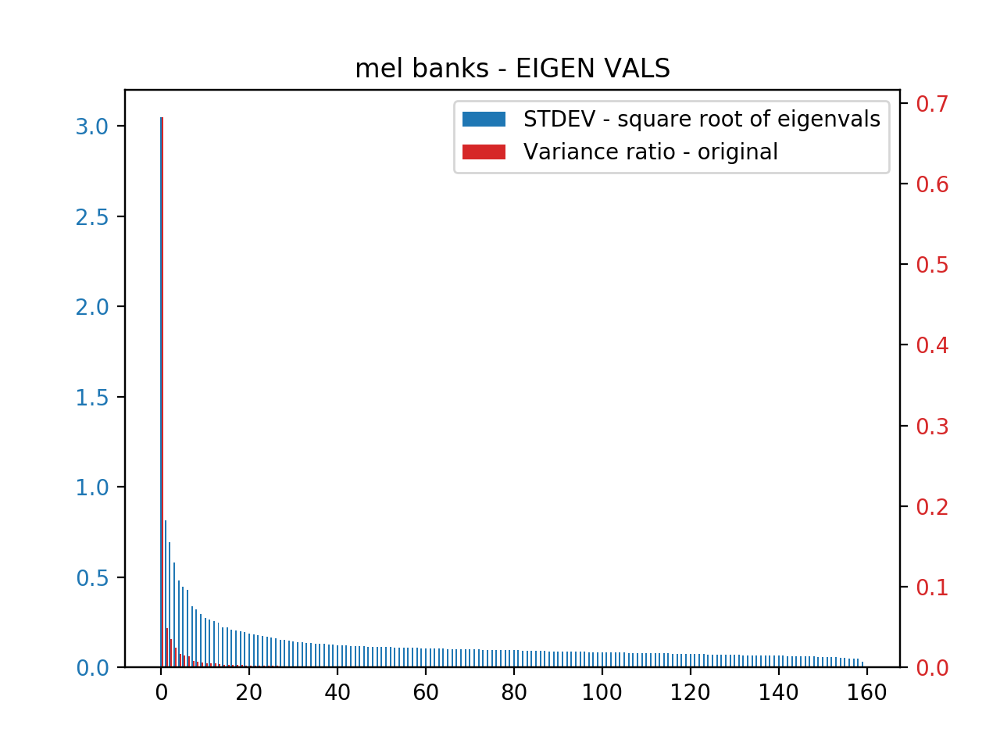

<IPython.core.display.Javascript object>


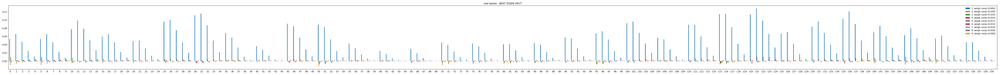

In [49]:
mel_banks_count = 5
eeg_mb = get_bio_mel_bank(STACK_SEG_EEG_spect[:][:,::down_s], window, overlap, mel_banks_count, int(BIO_fs/down_s))#, HIFREQ=512)        
pca_EEG_mb = compute_pca(eeg_mb.T)#, n_components = 10)
show_pca(pca_EEG_mb, "mel banks", [str(i) for i in range(1032)])

[7.30923636e+01 2.56547435e+01 9.57784411e+00 7.50018321e+00
 6.28367386e+00 5.11037111e+00 4.71401692e+00 4.27656487e+00
 4.08296238e+00 3.80316092e+00 3.66430424e+00 3.43982445e+00
 3.30165180e+00 3.20846887e+00 3.13190121e+00 2.92411941e+00
 2.77089420e+00 2.63145244e+00 2.58256243e+00 2.40725412e+00
 2.35940818e+00 2.29505748e+00 2.24709824e+00 2.07802574e+00
 2.02411334e+00 1.89683424e+00 1.89262177e+00 1.85222662e+00
 1.79302280e+00 1.75255155e+00 1.72871668e+00 1.71386220e+00
 1.64221172e+00 1.58286236e+00 1.50908767e+00 1.50180149e+00
 1.47450387e+00 1.42652825e+00 1.40746029e+00 1.37226713e+00
 1.33074778e+00 1.31493201e+00 1.31379328e+00 1.28643693e+00
 1.26389903e+00 1.24104991e+00 1.20649892e+00 1.18694206e+00
 1.15275049e+00 1.15049846e+00 1.13285866e+00 1.13016386e+00
 1.11462652e+00 1.08654493e+00 1.07439488e+00 1.06998353e+00
 1.04716949e+00 1.04242401e+00 1.01794464e+00 1.00208967e+00
 9.86788771e-01 9.67378768e-01 9.54173761e-01 9.43672142e-01
 9.37583748e-01 9.282700

<IPython.core.display.Javascript object>


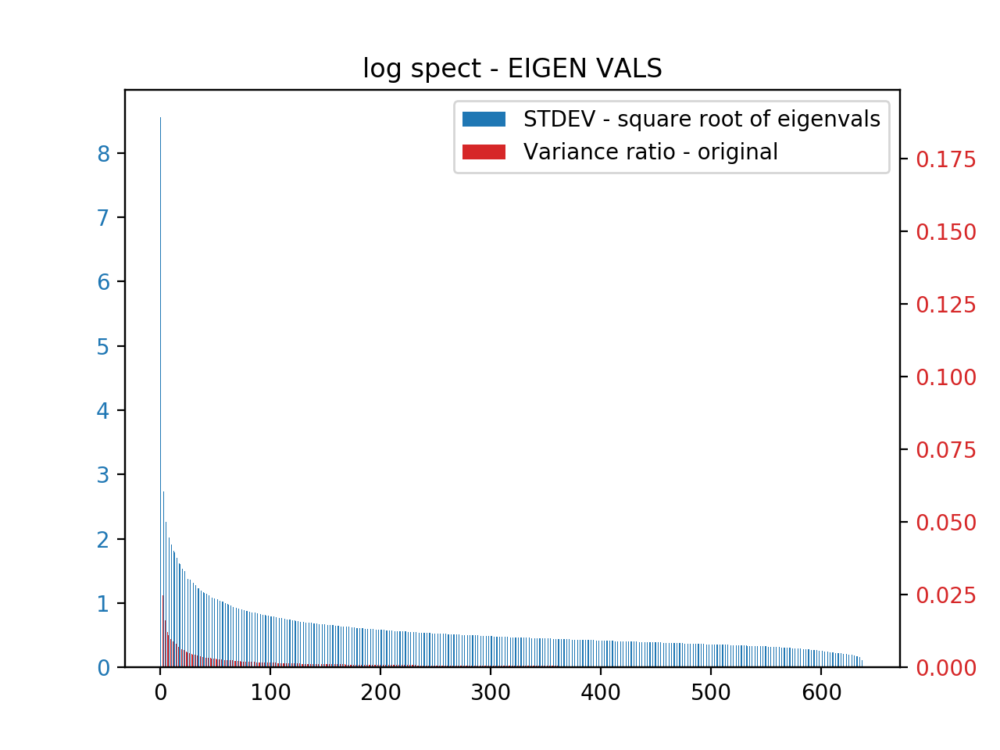

<IPython.core.display.Javascript object>

[8.35692440e+07 4.45439476e+06 2.04709286e+06 1.57433288e+06
 9.00582655e+05 8.52869722e+05 6.38088788e+05 5.47973456e+05
 4.63766419e+05 4.28403974e+05 3.36209143e+05 2.30412381e+05
 1.93677152e+05 1.61611899e+05 1.28926804e+05 1.22072816e+05
 1.14178615e+05 1.06724098e+05 1.01081476e+05 8.91347366e+04
 8.54645043e+04 7.64597075e+04 7.58919869e+04 6.57115759e+04
 6.31162613e+04 5.35208943e+04 5.19648482e+04 4.98691866e+04
 4.66901077e+04 4.39401219e+04 4.29442116e+04 3.84664360e+04
 3.71399678e+04 3.48277958e+04 3.37213178e+04 3.13717828e+04
 2.98326524e+04 2.82238322e+04 2.73776471e+04 2.59271270e+04
 2.56286674e+04 2.52091104e+04 2.40826490e+04 2.28262782e+04
 2.14000823e+04 2.10670792e+04 2.00513944e+04 1.95874185e+04
 1.93824118e+04 1.84956133e+04 1.83282913e+04 1.82142348e+04
 1.76737791e+04 1.71091921e+04 1.68014020e+04 1.62249291e+04
 1.56151535e+04 1.47186260e+04 1.43133325e+04 1.41468914e+04
 1.37589100e+04 1.34496960e+04 1.32359471e+04 1.30559706e+04
 1.25166095e+04 1.237209

<IPython.core.display.Javascript object>


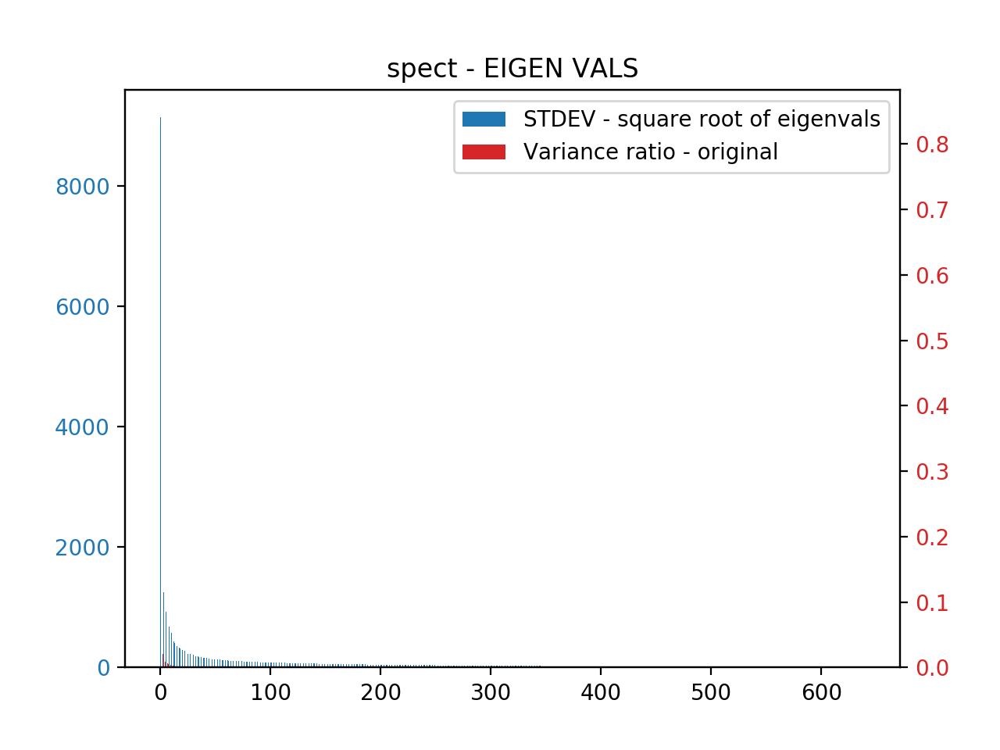

<IPython.core.display.Javascript object>

In [50]:
show_pca(pca_EEG_spect_log, "log spect", [str(i) for i in range(1032)])
show_pca(pca_EEG_spect, "spect", [str(i) for i in range(1032)])
#show_pca(pca_EEG_mb, "mel banks", [str(i) for i in range(1032)])

## LDA

In [52]:
import numpy as np
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = False, silent = True, loud = True)

classes = targ2id.keys()
labels2id = {v:i for i,v in enumerate(classes)}
id2labels = {i:v for i,v in enumerate(classes)}

print(targ_ind)
print(id2targ)
print(targ2id)
print(len(targ2id))



def compute_lda(data, labels):
    lda = LinearDiscriminantAnalysis(solver = "eigen")
    #lda = LinearDiscriminantAnalysis()
    lda.fit(data.T, labels)
    print(lda.score(data.T, labels))
    return lda


sam_start = 2500
sam_end = 2600


LDA_EMG_DATA = np.concatenate([SEG_EMG[row] for row in targ_ind],axis=1)
LDA_EMG_DATA_short = np.concatenate([SEG_EMG[row][:,sam_start:sam_end] for row in targ_ind],axis=1)
LDA_EEG_DATA = np.concatenate([SEG_EEG[row] for row in targ_ind],axis=1)
LDA_EMG_LABELS = [i for row in targ_ind for i in SEG_EMG[row].shape[1]*[labels2id[id2targ[row]]]]
LDA_EMG_LABELS_short = [i for row in targ_ind for i in SEG_EMG[row][:,sam_start:sam_end].shape[1]*[labels2id[id2targ[row]]]]
LDA_EEG_LABELS = [i for row in targ_ind for i in SEG_EEG[row].shape[1]*[labels2id[id2targ[row]]]] # should be same as EMG_LABELS

lda_EMG = compute_lda(LDA_EMG_DATA, LDA_EMG_LABELS)
lda_EMG_short = compute_lda(LDA_EMG_DATA_short, LDA_EMG_LABELS_short)
lda_EEG = compute_lda(LDA_EEG_DATA, LDA_EEG_LABELS)

print("S")
print(lda_EMG_short.score(LDA_EMG_DATA.T, LDA_EMG_LABELS))
print(lda_EMG.score(LDA_EMG_DATA_short.T, LDA_EMG_LABELS_short))

[4, 5, 8, 9, 10, 11, 14, 15, 32, 33, 34, 35, 40, 41, 46, 47, 48, 49, 50, 51, 52, 53, 58, 59, 72, 73, 78, 79, 88, 89, 90, 91, 102, 103, 108, 109, 114, 115, 116, 117, 122, 123, 126, 127, 138, 139, 142, 143, 146, 147, 156, 157, 160, 161, 162, 163, 170, 171, 178, 179, 180, 181, 188, 189, 192, 193, 194, 195, 202, 203, 210, 211, 218, 219, 220, 221, 233, 238, 239, 242, 243, 248, 249, 250, 251, 252, 253, 270, 271, 276, 277, 282, 283, 286, 287]
{4: 'three', 5: 'three', 8: 'divide', 9: 'divide', 10: 'add', 11: 'add', 14: 'seven', 15: 'seven', 32: 'one', 33: 'one', 34: 'eight', 35: 'eight', 40: 'zero', 41: 'zero', 46: 'multiply', 47: 'multiply', 48: 'nine', 49: 'nine', 50: 'subtract', 51: 'subtract', 52: 'percent', 53: 'percent', 58: 'six', 59: 'six', 72: 'four', 73: 'four', 78: 'two', 79: 'two', 88: 'five', 89: 'five', 90: 'eight', 91: 'eight', 102: 'three', 103: 'three', 108: 'two', 109: 'two', 114: 'seven', 115: 'seven', 116: 'five', 117: 'five', 122: 'subtract', 123: 'subtract', 126: 'nine', 

[0.52525691 0.17028169 0.1003914  0.07104524 0.05588429 0.04266573
 0.03264405 0.00183069]
(15, 8)


/anaconda2/envs/python3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


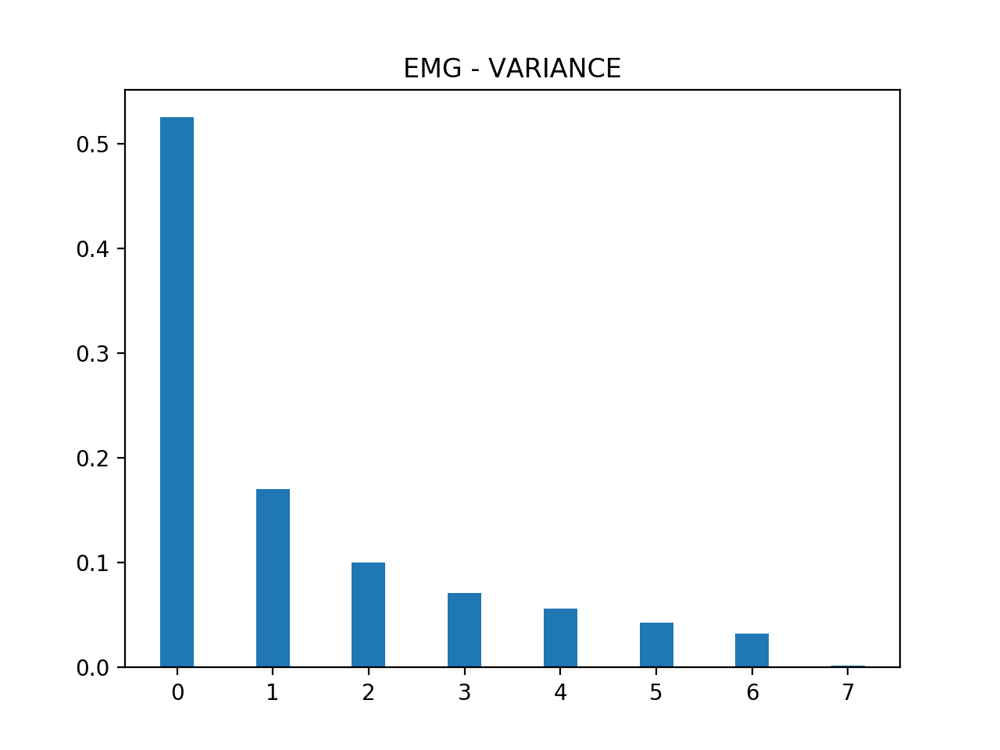

<IPython.core.display.Javascript object>


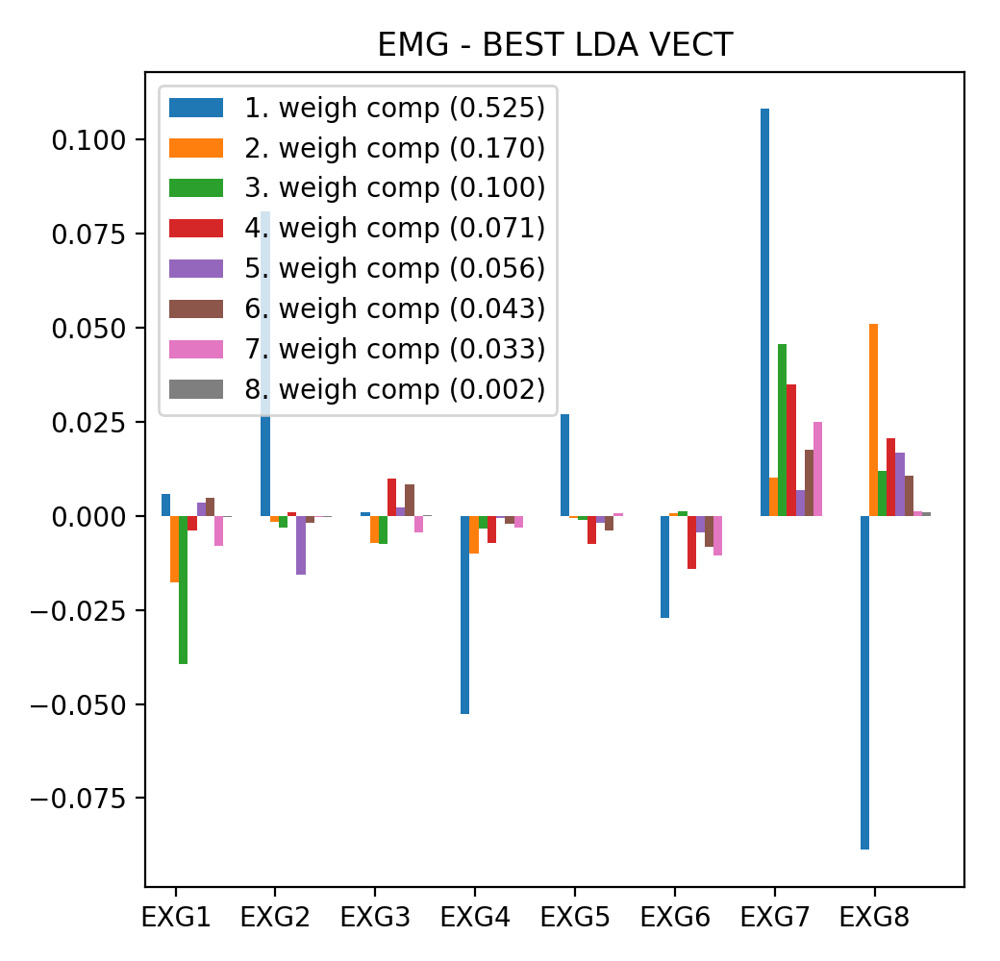

[0.2715164  0.16686048 0.09930722 0.08804208 0.07698726 0.07064583
 0.0548905  0.04904237 0.03451407 0.02910844 0.02111199 0.01819772
 0.01145266 0.00832299]
(15, 32)


<IPython.core.display.Javascript object>


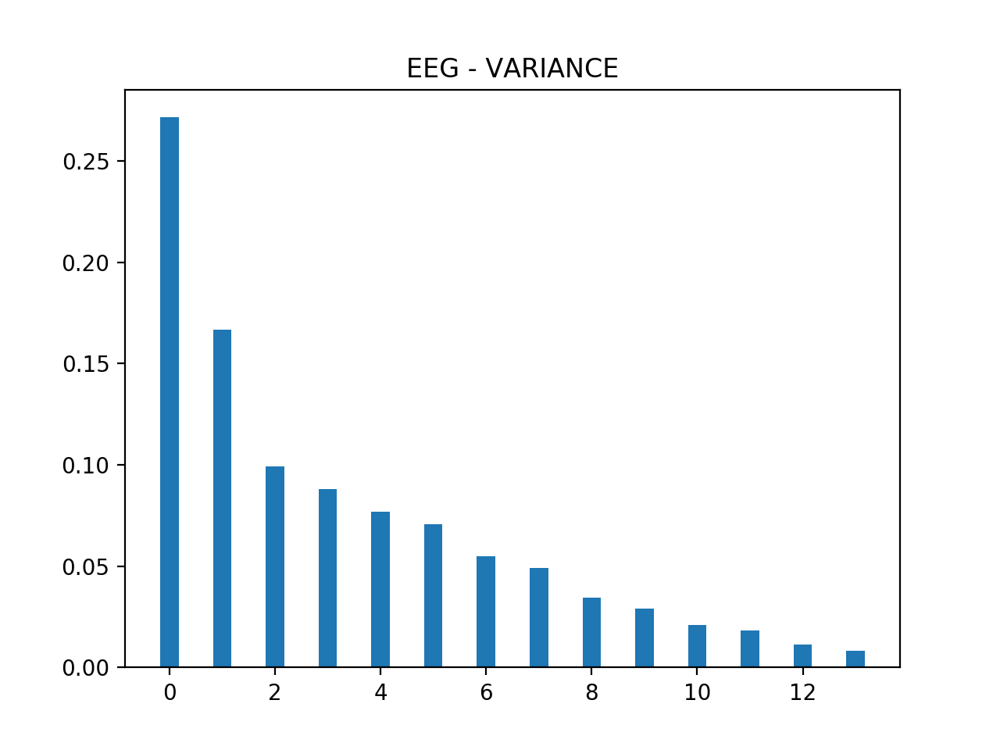

<IPython.core.display.Javascript object>


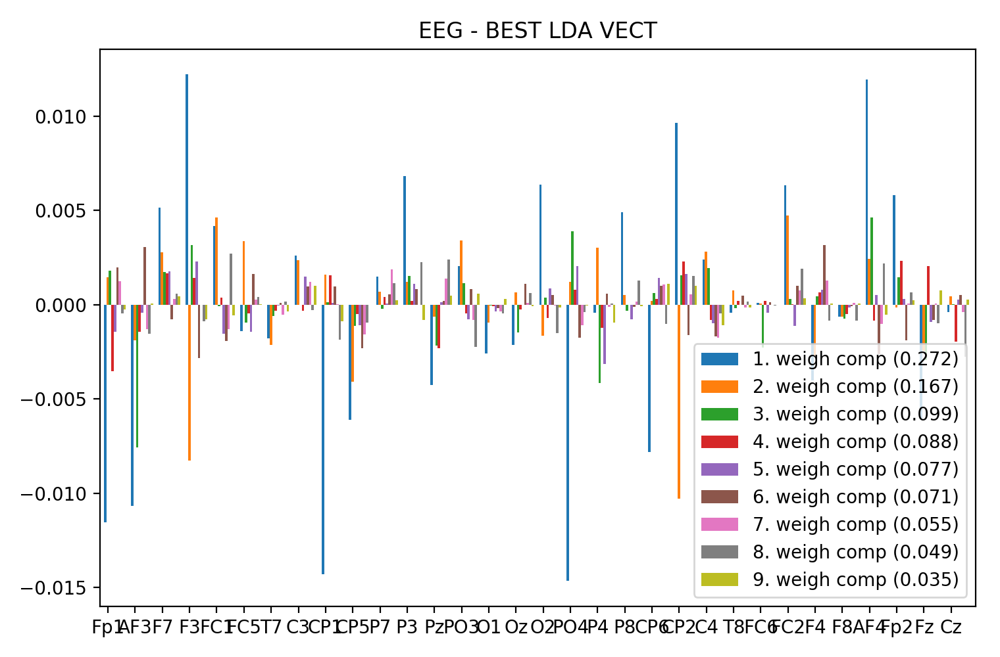

In [53]:
def show_lda(lda, name, labels):    
    lda_var = lda.explained_variance_ratio_
    lda_vect = lda.coef_

    #print(STACK_SEG_EMG.shape)
    print(lda_var)
    #print(lda_vect)
    print(lda_vect.shape)

    bar_width = 0.35

    plt.figure(); plt.bar(np.arange(len(lda_var)),lda_var, bar_width ); plt.title(name + " - VARIANCE")
    fig, ax = plt.subplots(figsize = (2 + 0.4 * len(lda_var),5))

    
    component_c = 9
    bar_width = 0.8 / component_c 
    indices = np.arange(lda_vect.shape[-1])
    #plt.bar(indices,lda_vect[i], bar_width , label = str(i + 1) + ". weigh comp (" + "{:.3f}".format(lda_var[i]) + ")")
    for i in range(min(component_c,len(lda_var))):
        #plt.bar(indices + i * bar_width,lda_vect[i], bar_width , label = str(i + 1) + ". component")
        plt.bar(indices + i * bar_width,lda_vect[i] * lda_var[i], bar_width , label = str(i + 1) + ". weigh comp (" + "{:.3f}".format(lda_var[i]) + ")")
    plt.title(name + " - BEST LDA VECT")

    ax.set_xticks(indices + 0.1)
    ax.set_xticklabels(labels)
    ax.set_xlim(-0.2,lda_vect.shape[-1])
    
    plt.legend()
    plt.tight_layout()
    plt.savefig("sess1")
    #plt.bar(np.arange(1,len(lda_var) + 1) + bar_width,lda_vect[1], 0.35 ); plt.title("EMG - BEST EIGEN VECT")

    
show_lda(lda_EMG, "EMG", EMG_L)
show_lda(lda_EEG, "EEG", EEG_L)

#PCA_SEG_EMG = 

(8,)
[  6.81729712   4.47501643   4.73803048 -36.24441437  11.77564147
  -4.3584358    6.02666581  14.00357223]


<IPython.core.display.Javascript object>


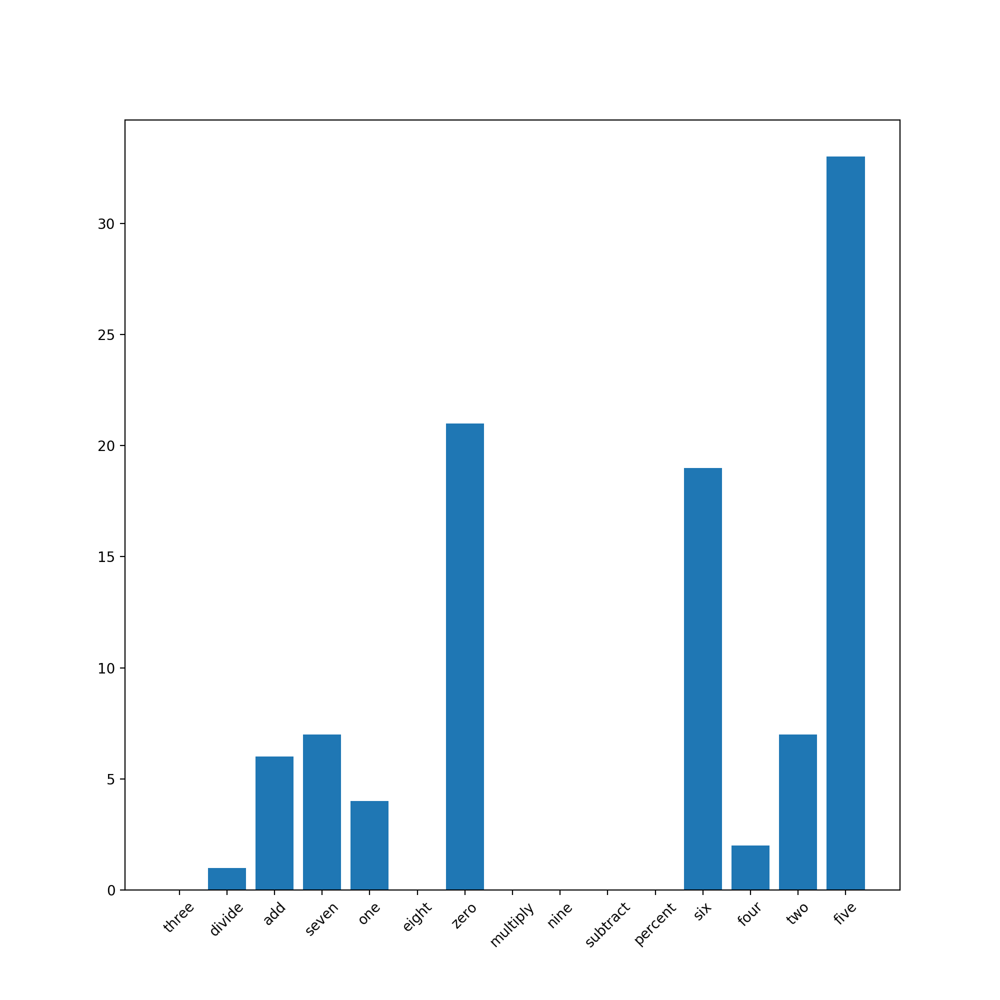

[14 14 14  1  3 14 14 14 14 13 13 13 13  6 13 13 13  4 14 14 14 14 14 14
 14  3  3  3  3  3  3 11 11  2  2  2  2  2  6  6  6  6  6  6  6  6  6  6
 14 14  6  6 14 14 14 14 14 14 14 14 14 11 11 11 11 11 11 11 11  4  4 14
 14 14 14 14 14  6 12 12 14 14 11 11 11 11 11 11 11 11 11  6  6  6  6  6
  2  6  6  4]
{'three': 0, 'divide': 1, 'add': 2, 'seven': 3, 'one': 4, 'eight': 5, 'zero': 6, 'multiply': 7, 'nine': 8, 'subtract': 9, 'percent': 10, 'six': 11, 'four': 12, 'two': 13, 'five': 14}
three
0
0.08030573665374864


In [54]:
print(SEG_EMG[targ_ind[0]][:,0].shape)
print(SEG_EMG[targ_ind[0]][:,0])
fig = plt.figure(figsize = (10,10))

index = 1
sam_start = 1000
sam_end = 1100
pred = lda_EMG.predict(SEG_EMG[targ_ind[index]].T[sam_start:sam_end])
print(pred)
y = np.bincount(pred)
zip(range(len(classes)),y)
plt.bar(range(len(classes)), y)[labels2id[id2targ[targ_ind[index]]]].set_color('r')



#print(plt.hist(lda_EMG.predict(SEG_EMG[targ_ind[0]].T), bins = len(classes)))
plt.xticks(range(len(classes)),  rotation=45)
ax = fig.axes[0]
ax.set_xticklabels(classes)
#lda_EEG.predict_proba
print(labels2id)
print(id2targ[targ_ind[index]])
print(labels2id[id2targ[targ_ind[index]]])

print(lda_EMG.score(LDA_EMG_DATA.T, LDA_EMG_LABELS))



def show_pred_class(fig, spect, name):
    global fig_counter
    fig_counter += 1
    ax = fig.add_subplot(max_subplots, col_subplots, fig_counter)
    ax.set_title(name)
    #plt.figure(figsize = figsize)
    plt.tight_layout()
    plt.imshow(spect.T,aspect='auto');plt.gca().invert_yaxis()



In [55]:
import numpy as np
x = np.array([1,1,1,2,2,2,5,25,1,1])
y = np.bincount(x)
y = np.bincount(lda_EMG.predict(SEG_EMG[targ_ind[0]].T))
ii = np.nonzero(y)[0]

print(y)
print(ii)



[ 175    0 1069 1192  633 1552  400   12    1    3    5  257  987 1173
  773]
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14]


# Try correlation

## Pure data
### Function definitions

In [14]:


def norm_signal_var(data):
    #data = data - np.mean(data) # small effect
    return data/np.std(data)

def correlation(data, test_case, st, end, calc_corr1 = True, calc_corr2 = True, calc_corr3 = True, calc_corr4 = True):
    electr_c = len(data[test_case])
    # Simple correlation 
    res = []
    best_shift = []
    if calc_corr1:
        for row in targ_ind:
            a = np.sum(np.array([(np.correlate(data[test_case][i,st:end], data[row][i,st:end], mode="full")) for i in range(electr_c)]), axis = 0)
            res.append(np.max(a))
            best_shift.append(np.argmax(a)  - (end - st - 1))

    # Correlation per electrode is normalized, so the maximum is 1
    res2 = []
    best_el2 = np.array(electr_c * [0])
    best_shift2 = []
    if calc_corr2:
        for row in targ_ind:
            a = np.array([(np.correlate(data[test_case][i,st:end], data[row][i,st:end], mode="full")) for i in range(electr_c)])
            #b = np.max(a, axis=1)
            #print(a.shape)
            #print(best_el.shape)
            #print(b)        
            best_el2 = np.max(np.vstack((best_el2,np.max(a, axis=1))), axis = 0)
            #print(best_el)    
            res2.append(a)
        #res2 = np.array(res2)/np.reshape(best_el2,(1,-1,1))
        best_shift2 = np.argmax(np.sum(np.array(res2)/np.reshape(best_el2,(1,-1,1)), axis = 1),axis = 1) - (end - st - 1)
        res2 = np.max(np.sum(np.array(res2)/np.reshape(best_el2,(1,-1,1)), axis = 1),axis = 1)


    # The energy of the signal on each electrode was set to 1
    res3 = []
    best_shift3 = []
    if calc_corr3:
        for row in targ_ind:
            a = np.sum(np.array([(np.correlate(norm_signal_var(data[test_case][i,st:end]), norm_signal_var(data[row][i,st:end]), mode="full")) for i in range(electr_c)]), axis = 0)
            res3.append(np.max(a))
            best_shift3.append(np.argmax(a) - (end - st - 1))


    #Energy equal to one
    res4 = []
    best_el4 = np.array(electr_c * [0])
    best_shift4 = []
    if calc_corr4:
        for row in targ_ind:
            a = np.array([(np.correlate(norm_signal_var(data[test_case][i,st:end]), norm_signal_var(data[row][i,st:end]), mode="full")) for i in range(electr_c)])
            #b = np.max(a, axis=1)
            #print(a.shape)
            #print(best_el.shape)
            #print(b)
            best_el4 = np.max(np.vstack((best_el4,np.max(a, axis=1))), axis = 0)
            #print(best_el)
            res4.append(a)
        #res4 = np.array(res4)/np.reshape(best_el4,(1,-1,1))
        best_shift4 = np.argmax(np.sum(np.array(res4)/np.reshape(best_el4,(1,-1,1)), axis = 1),axis = 1) - (end - st - 1)
        res4 = np.max(np.sum(np.array(res4)/np.reshape(best_el4,(1,-1,1)), axis = 1),axis = 1)
    

    return res, res2, res3, res4, best_shift, best_shift2, best_shift3, best_shift4, best_el2, best_el4

def put_zeroes(signal, st, end):
    ex = np.copy(signal)
    ex[:,:st] = 0
    ex[:,end:] = 0
    return ex

def show_res(id2targ, targ_ind, data, test_case, prefix, res, sh, show, win_start, win_len, st, end, w = None):
    args = np.argsort(res)
    true_labels = [id2targ[i] for i in targ_ind]
    speak_mode = [data_table['StimuliType'][i][0].capitalize() for i in targ_ind]

    if show:
        print(args)        
        print([true_labels[i] for i in args])
        if (prefix == "1"):
            tc = data[test_case]
            sc = put_zeroes(data[targ_ind[args[-2]]], st, end)
        elif (prefix == "2"):
            tc = data[test_case] / np.reshape(w,(-1,1)) * np.min(w)
            sc = put_zeroes(data[targ_ind[args[-2]]], st, end) / np.reshape(w,(-1,1)) * np.min(w)
        elif (prefix == "3"):

            tc = np.array([norm_signal_var(d) for d in put_zeroes(data[test_case],st,end)])
            sc = np.array([norm_signal_var(d) for d in put_zeroes(data[targ_ind[args[-2]]],st,end)])
        elif (prefix == "4"):
            tc = data[test_case] / np.reshape(w,(-1,1))
        show_data(prefix + "EMG_ORIG-" + str(id2targ[test_case]) + " " + str(test_case), tc,EMG_L, fs = BIO_fs, win_len= win_len, win_start = win_start, use_same_scale= False) 
        for ind in targ2id[id2targ[test_case]]:
            if (ind != test_case):
                show_data(prefix + "EMG_SAME_CLASS-" + str(ind)  , data[ind],EMG_L, fs = BIO_fs, win_len= win_len, win_start = win_start, use_same_scale= False) 


        #ex = np.zeros_like(data[targ_ind[args[-1]]])
        #ex = ex[:,st:end] = data[targ_ind[args[-1]]][:,st:end]

        
        print((sh[args[-1]]))
        show_data(prefix + "EMG_CLOSEST " + str(id2targ[targ_ind[args[-1]]]) + " " + str(targ_ind[args[-1]]), put_zeroes(data[targ_ind[args[-1]]],st,end),EMG_L, fs = BIO_fs, win_len= win_len, win_start =  win_start - (sh[args[-1]] / BIO_fs), use_same_scale= False) 
        show_data(prefix + "EMG_SECOND_CLOSEST " + str(id2targ[targ_ind[args[-2]]]) + " " + str(targ_ind[args[-2]]) , sc,EMG_L, fs = BIO_fs, win_len= win_len, win_start =  win_start - (sh[args[-2]] / BIO_fs), use_same_scale= False) 

        if (prefix == "1"):
            be_sh_pref = sh[args[-1]]
        else:
            be_sh_pref = sh[args[-2]]
        if  be_sh_pref > 0:
            orig_shift = be_sh_pref; targ_shift = 0
        else:
            targ_shift = be_sh_pref; orig_shift = 0
                            
        if (prefix == "1"):
            show_data(prefix + "EMG_BOTH ", put_zeroes(tc, st, end)[:,orig_shift:],EMG_L, fs = BIO_fs, win_len= win_len, win_start = win_start, color = "black") 
            show_data(prefix + "EMG_BOTH ", put_zeroes(data[targ_ind[args[-1]]],st,end)[:,targ_shift:],EMG_L, fs = BIO_fs, win_len= win_len, win_start = win_start) 
        elif (prefix == "2"):
            show_data(prefix + "EMG_BOTH ", 15* put_zeroes(tc,st,end)[:,orig_shift:],EMG_L, fs = BIO_fs, win_len= win_len, win_start = win_start, color = "black") 
            show_data(prefix + "EMG_BOTH ", 15*sc[:,targ_shift:],EMG_L, fs = BIO_fs, win_len= win_len, win_start = win_start) 
        elif (prefix == "3"):
            show_data(prefix + "EMG_BOTH ", 100* tc[:,orig_shift:],EMG_L, fs = BIO_fs, win_len= win_len, win_start = win_start, color = "black") 
            show_data(prefix + "EMG_BOTH ", 100*sc[:,targ_shift:],EMG_L, fs = BIO_fs, win_len= win_len, win_start = win_start) 
        elif (prefix == "4"):
            tc = data[test_case] / np.reshape(w,(-1,1))
        
        
    to_print = []
    tc_string = data_table['StimuliType'][test_case][0].capitalize() + " " + str(id2targ[test_case]) + " " + str(test_case) + " "
    for i in range(len(targ_ind)):
        to_print.append(tc_string + speak_mode[i] + " " + true_labels[i] + " " + str(targ_ind[i]) + " -" + str(res[i]))   
    return np.where(np.array([true_labels[i] for i in args][::-1]) == np.array(id2targ[test_case]))[0], to_print


def produce_all_corr(id2targ, targ_ind, data, st, end, show = False, use_corr = [True, True, True, True]):
    list_sc = [[],[],[],[]]
    to_print = [[],[],[],[]]

    for ind in targ_ind:
        res1, res2, res3, res4, sh1, sh2, sh3, sh4, _, _ = correlation(data, ind, st, end, *use_corr)    
        res = [res1, res2, res3, res4]
        sh = [sh1, sh2, sh3, sh4]
        for i in range(len(res)):    
            if use_corr[i]:
                indices ,tp = show_res(id2targ, targ_ind, data, ind, str(i + 1), res[i] , sh[i], show, st/BIO_fs, (end - st)/BIO_fs, st, end)
                list_sc[i].append(indices); to_print[i].extend(tp)
    return list_sc, to_print

def save_correlations(corr_num, to_print, file_name, save_corr_dir):
    with open(os.path.join(base_dir, save_corr_dir, file_name + "cor" + corr_num + ".txt"),"w+") as f: 
        for i in to_print:
            f.write(i + "\n")
            

def print_corr_results(lists_sc):
    # TODO: use cycles, not this hell
    for l in lists_sc:
        print(l); print()        
    list_sc1, list_sc2, list_sc3, list_sc4 = lists_sc 

    for l in lists_sc:
        tests = 0
        c = 0
        for v in l:
            if len(v) > 1:
                tests += 1
                if (v[1] == 1): # Two closest examples are from the same class
                    c += 1
        if (tests > 0):
            print("{:.3f}".format(c / tests)  + "  " + str(c))

def save_corr_results(lists_to_save, save_name, save_corr_dir = "corr"):  
    for i,l in enumerate(lists_to_save):
        save_correlations(str(i + 1), l, save_name, save_corr_dir)


In [15]:
#SILENT/LOUD DATA
SILENT_DATA = True
LOUD_DATA = False


if int(sessionid) == 2:
    data_len_session2 = 97
    targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = False, silent = SILENT_DATA, loud = LOUD_DATA, data_len= data_len_session2)
else:
    targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = False, silent = SILENT_DATA, loud = LOUD_DATA)    
    
print(targ_ind)
print(targ2id)

#classes = targ2id.keys()
#labels2id = {v:i for i,v in enumerate(classes)}
#id2labels = {i:v for i,v in enumerate(classes)}

#true_labels = [id2targ[i] for i in targ_ind]
#print(true_labels)

NameError: name 'get_filt_ind_maps' is not defined

### One example

In [251]:
targ_ind, id2targ, targ2id = list(range(len(id2tar))), id2tar, tar2id
print(tar2id)

#print(np.max(np.correlate(SEG_EMG[4][5], SEG_EMG[4][5], mode="same")))
#['percent', 'divide', 'seven', 'right', 'four', 'eight', 'five', 'two', 'six', 'climb', 'left', 'three', 'subtract', 'multiply', 'traffic', 'one', 'descend', 'level', 'nine', 'four', 'five', 'descend', 'right', 'traffic', 'three', 'multiply', 'left', 'six', 'percent', 'divide', 'subtract', 'one', 'seven', 'add', 'climb', 'eight', 'two', 'nine', 'level', 'descend', 'multiply', 'four', 'six', 'add', 'one', 'traffic', 'percent']
#[4, 10, 22, 25, 37, 43, 47, 56, 58, 60, 66, 73, 75, 77, 93, 96, 98, 102, 118, 123, 129, 135, 143, 148, 150, 154, 160, 173, 177, 181, 183, 198, 202, 208, 212, 217, 219, 233, 237, 246, 258, 260, 262, 269, 273, 277, 285]
test_case = 47
st = 500
end = 4000


data = SEG_EMG
#res, res2, res3, res4, sh, sh2, sh3, sh4, be2, be4 = correlation(data, test_case, st, end)
res, res2, res3, res4, sh, sh2, sh3, sh4, be2, be4 = correlation(data, test_case, st, end, False, False, True, False)
#print(true_labels)

#show = True
show = False
#sc1 = show_res(id2targ, targ_ind, data, test_case, "1", res, sh, show, st/BIO_fs, (end - st)/BIO_fs, st, end)[0]
#sc2 = show_res(id2targ, targ_ind, data, test_case, "2", res2, sh2, show, st/BIO_fs, (end - st)/BIO_fs, st, end, be2)[0]
sc3 = show_res(id2targ, targ_ind, data, test_case, "3", res3, sh3, show, st/BIO_fs, (end - st)/BIO_fs, st, end)[0]
#sc4 = show_res(id2targ, targ_ind, data, test_case, "4", res4, sh4, show, st/BIO_fs, (end - st)/BIO_fs, st, end, be4)[0]



#print(sc1)
#print(sc2)
print(sc3)
#print(sc4)

#[ 0  1  2  3  4  6 12 16 18 22 36 41 66 87]
#[ 0  1  2  4  5  6 11 13 18 22 36 42 58 88]


{'eight': [0, 1, 48, 49, 79, 80, 103, 104, 149, 150, 159, 160, 198, 199], 'divide': [2, 3, 36, 37, 52, 53, 107, 108, 139, 140, 173, 174, 187, 188], 'five': [4, 5, 33, 77, 78, 97, 98, 161, 162, 163, 164, 189, 190, 208, 209], 'multiply': [6, 7, 40, 41, 72, 73, 105, 106, 131, 132, 151, 152, 169, 170], 'two': [8, 9, 46, 47, 89, 90, 115, 116, 129, 130, 147, 148, 202, 203], 'four': [10, 11, 62, 63, 66, 67, 111, 112, 135, 136, 185, 186, 191, 192], 'seven': [12, 13, 38, 39, 56, 57, 109, 110, 117, 118, 175, 176, 193, 194], 'six': [14, 15, 58, 59, 64, 65, 99, 100, 133, 134, 145, 146, 204, 205], 'three': [16, 17, 50, 51, 68, 69, 93, 94, 137, 138, 171, 172, 177, 178], 'nine': [18, 19, 42, 43, 85, 86, 87, 88, 127, 128, 157, 158, 181, 182], 'add': [20, 21, 32, 74, 113, 114, 119, 120, 153, 154, 165, 166, 195, 196], 'one': [22, 23, 34, 35, 75, 76, 83, 84, 125, 126, 141, 142, 200, 201], 'subtract': [24, 25, 28, 29, 81, 82, 91, 92, 121, 122, 167, 168, 179, 180, 197], 'zero': [26, 27, 44, 45, 60, 61, 95,

In [510]:
[ 2 11 15]
[0 2 6]
[ 0 20 28]
[ 0  6 15]

SyntaxError: invalid syntax (<ipython-input-510-cf1877309fb5>, line 1)

### Produce results for all

In [286]:
len(targ2id)
lst_sc, to_print = produce_all_corr(id2targ, targ_ind, data, st, end, show = False, use_corr = [False, False, True, False])

In [287]:
print_corr_results(lst_sc)

[]

[]

[array([ 0,  2, 10, 13, 18, 20, 21, 26, 27, 33, 40, 48, 57, 66]), array([ 0,  4,  5,  8, 11, 14, 21, 27, 31, 35, 38, 40, 42, 57]), array([  0,   2,   7,  10,  16,  18,  24,  27,  67,  94,  99, 111, 119,
       122]), array([  0,   2,   4,  10,  16,  19,  25,  28,  55,  60,  70, 124, 131,
       149]), array([ 0,  1,  2,  3,  4,  8, 13, 21, 24, 53, 58, 73, 74, 77, 92]), array([  0,   1,   2,   3,   7,  10,  30,  33,  38,  57,  60,  82,  84,
        88, 107]), array([  0,  10, 124, 128, 145, 171, 179, 182, 190, 197, 199, 200, 203,
       209]), array([  0,   1,  36, 128, 131, 144, 154, 184, 192, 193, 195, 200, 205,
       208]), array([  0,   3, 100, 129, 132, 167, 170, 175, 180, 191, 193, 201, 203,
       204]), array([  0,   7,  13,  14,  34,  41,  62,  79,  87, 140, 176, 194, 198,
       206]), array([  0,   7,  23,  27,  53,  63,  75,  85,  87, 105, 171, 198, 202,
       203]), array([  0,   2,   5,   7,  14,  19,  26,  43,  53,  65, 174, 186, 198,
       204]), array([  0,  

In [ ]:
[array([  3,   7,  14,  20,  21,  22,  23,  42,  44,  59,  74,  82,  94,
       127]), array([  2,   7,  14,  19,  21,  22,  34,  37,  43,  75,  79,  83,  99,
       128]), array([ 11,  18,  24,  47,  48,  51,  64,  99, 107, 108, 109, 115, 130,
       153]), array([  7,  14,  24,  46,  47,  51,  57,  99, 104, 107, 109, 113, 128,
       150]), array([  8,  11,  16,  19,  20,  29,  35,  40,  49,  61,  68,  75,  77,
        88, 149]), array([  9,  13,  17,  21,  22,  28,  41,  42,  52,  55,  72,  76,  79,
       101, 176]), array([ 47,  69,  76,  99, 103, 107, 109, 123, 130, 132, 158, 168, 177,
       188]), array([ 50,  54,  66,  78,  89,  90,  94, 102, 111, 118, 126, 156, 185,
       196]), array([  0,   8,  28, 141, 164, 166, 195, 201, 203, 205, 206, 207, 208,
       209]), array([  1,  23, 127, 141, 147, 152, 183, 188, 201, 204, 205, 206, 207,
       208]), array([  2,   7,  46, 140, 161, 168, 173, 180, 183, 191, 192, 197, 208,
       209]), array([  0,   3,   4,  52, 135, 151, 155, 156, 163, 175, 177, 191, 197,
       203]), array([ 14,  16,  25,  44,  48,  49,  65,  66, 106, 110, 112, 116, 145,
       147]), array([ 24,  36,  39,  41,  53,  56,  70,  74,  95, 102, 108, 110, 121,
       142]), array([ 80,  83,  90, 106, 111, 114, 115, 120, 124, 126, 158, 168, 183,
       190]), array([ 73,  79,  94, 108, 109, 118, 129, 130, 131, 143, 160, 162, 179,
       189]), array([ 52,  78,  79,  87,  95, 127, 137, 144, 167, 171, 183, 190, 202,
       203]), array([ 46,  74,  81,  85, 113, 122, 125, 136, 167, 182, 184, 192, 194,
       205]), array([ 4,  8, 24, 30, 40, 41, 42, 50, 53, 62, 66, 74, 90, 96]), array([  6,  10,  24,  29,  36,  37,  48,  56,  60,  69,  71,  81,  95,
       109]), array([ 8, 11, 13, 16, 17, 24, 28, 31, 34, 37, 40, 47, 57, 97]), array([ 7, 10, 12, 14, 16, 24, 29, 30, 31, 33, 37, 45, 55, 88]), array([ 17,  19,  45,  54,  64,  69,  74,  77,  87,  92,  98, 119, 133,
       136]), array([ 21,  42,  60,  63,  76,  82,  89, 100, 105, 107, 132, 146, 169,
       177]), array([ 37,  46,  55,  60,  66,  80,  91, 109, 124, 130, 135, 149, 150,
       164, 197]), array([ 29,  30,  59,  70,  82, 102, 107, 123, 142, 155, 162, 177, 178,
       180, 197]), array([  4,  19,  28,  67,  80,  97, 102, 104, 112, 114, 122, 125, 126,
       164]), array([  4,  26,  32,  62,  70,  91, 111, 118, 120, 122, 137, 148, 150,
       186]), array([ 21,  30,  44,  66,  72,  75,  81,  98, 101, 114, 133, 146, 165,
       166, 197]), array([ 49, 107, 124, 135, 143, 151, 152, 154, 159, 168, 170, 172, 179,
       183, 203]), array([ 62,  68,  97, 114, 127, 136, 146, 152, 153, 154, 193, 194]), array([ 61,  71,  96, 105, 108, 121, 138, 140, 141, 161, 191, 193]), array([ 8, 12, 13, 14, 15, 22, 27, 32, 34, 41, 45, 48, 53, 95]), array([ 10,  12,  17,  19,  20,  26,  39,  45,  51,  63,  71,  75,  80,
        87, 142]), array([ 22,  27,  54,  60,  63,  75,  76,  79,  92,  99, 100, 118, 134,
       147]), array([ 19,  21,  54,  62,  65,  66,  79,  85,  86,  98,  99, 120, 139,
       140]), array([ 15,  26,  29,  49,  52,  65,  70,  88,  99, 100, 107, 112, 148,
       150]), array([  8,  17,  18,  29,  34,  54,  58,  66,  83,  94,  96, 105, 109,
       153]), array([ 12,  17,  31,  32,  47,  48,  54,  64,  73,  81,  91,  93, 104,
       134]), array([ 13,  18,  44,  46,  51,  54,  65,  79,  96, 100, 103, 104, 115,
       137]), array([ 19,  24,  31,  39,  40,  49,  55,  68,  83,  97, 104, 106, 133,
       161]), array([ 24,  27,  29,  58,  65,  70,  77, 140, 142, 152, 153, 157, 163,
       188]), array([  6,  11,  29,  31,  34,  48,  58,  64,  77,  80,  88,  89, 103,
       110]), array([ 4,  9, 21, 27, 40, 42, 43, 44, 49, 62, 63, 72, 85, 88]), array([  4,   8,  16,  20,  29,  54,  56,  57,  85, 109, 114, 121, 138,
       150]), array([  4,  10,  18,  24,  54,  59,  66,  80,  88, 111, 116, 127, 160,
       174]), array([  1,   6,  78,  82, 160, 167, 178, 191, 203, 204, 206, 207, 208,
       209]), array([  1,   6,  69,  74, 102, 148, 164, 169, 197, 200, 204, 207, 208,
       209]), array([  5,   7,  13,  19,  20,  25,  36,  37,  65,  69,  74, 104, 112,
       114]), array([  5,   7,  15,  18,  20,  25,  36,  45,  46,  51,  85,  92, 101,
       145]), array([ 45,  58,  75,  98, 108, 110, 111, 143, 166, 168, 173, 187, 190,
       205]), array([ 64,  65,  68,  76,  94, 118, 128, 142, 170, 173, 179, 191, 193,
       205]), array([ 14,  17,  20,  29,  42,  55,  73,  76,  88,  92, 102, 109, 121,
       160]), array([ 12,  15,  19,  43,  44,  50,  64,  83,  93, 102, 108, 109, 133,
       156]), array([ 57,  63,  96, 117, 128, 136, 155, 156, 158, 166, 192, 194]), array([ 77,  83,  84, 109, 112, 123, 139, 145, 149, 161, 193, 196]), array([  9,  12,  23,  27,  28,  30,  41,  67,  70,  95, 102, 111, 119,
       127]), array([ 17,  22,  42,  48,  49,  51,  62,  72,  76,  81, 105, 107, 117,
       136]), array([ 55,  88, 105, 106, 114, 116, 117, 124, 132, 150, 152, 156, 164,
       187]), array([ 58,  69, 108, 124, 127, 129, 145, 150, 160, 161, 162, 165, 171,
       183]), array([  4,  12,  17,  57,  66,  67,  69,  85,  92, 117, 120, 123, 156,
       163]), array([ 12,  16,  52,  61, 109, 138, 141, 156, 158, 163, 174, 179, 187,
       188]), array([  0,   1,   2,   5,   7,  20,  25,  29,  42, 118, 123, 197, 200,
       209]), array([  0,   1,   3,   5,   7,   9,  16,  30,  45,  95, 139, 156, 191,
       194]), array([ 28,  53,  65,  67,  70,  77,  86, 102, 117, 128, 130, 142, 185,
       197]), array([ 58,  63,  89,  92,  95,  97, 104, 105, 114, 128, 152, 154, 180,
       193]), array([  0,   2,   3,   7, 103, 119, 127, 158, 181, 182, 183, 191, 193,
       198]), array([  0,   2,   3,  34, 132, 147, 166, 171, 186, 187, 189, 190, 201,
       206]), array([ 56,  75,  86,  99, 100, 121, 125, 138, 146, 154, 161, 167, 193,
       198]), array([ 64,  70,  93,  96, 100, 140, 141, 161, 163, 167, 174, 189, 200,
       203]), array([ 60,  83, 104, 108, 110, 124, 125, 131, 134, 170, 188, 194]), array([ 58,  64,  97, 123, 124, 127, 145, 147, 150, 162, 183, 196]), array([ 48,  50,  53,  66,  83,  88, 106, 118, 121, 130, 137, 154, 175,
       182]), array([ 17,  31,  36,  48,  55,  65,  69, 118, 125, 127, 132, 152, 165,
       166]), array([ 6,  9, 10, 12, 15, 16, 22, 26, 28, 34, 38, 39, 48, 91]), array([ 16,  20,  54,  55,  57,  69,  71,  79,  81,  85, 110, 112, 128,
       135]), array([ 18,  20,  49,  54,  57,  59,  66,  73,  76,  87, 115, 117, 119,
       139]), array([  9,  10,  15,  16,  17,  28,  33,  37,  44,  52,  66,  67,  69,
        75, 104]), array([  8,  11,  18,  20,  22,  26,  28,  42,  48,  59,  65,  66,  69,
        85, 148]), array([  0,   4,  15,  16,  18,  20,  27,  32,  60,  66,  69,  84,  95,
       123]), array([  5,   7,  12,  20,  21,  25,  39,  41,  59,  68,  75, 103, 107,
       135]), array([ 19,  28,  58,  70,  84,  89,  96, 108, 120, 124, 135, 152, 155,
       164, 196]), array([ 20,  21,  65,  69,  74,  83,  84,  91, 100, 133, 144, 153, 157,
       161, 197]), array([ 13,  25,  57,  66,  74,  81,  82,  88,  90,  93,  99, 123, 155,
       157]), array([ 13,  17,  54,  56,  72,  73,  75,  76,  79,  90, 105, 118, 132,
       136]), array([ 5,  9, 28, 36, 42, 54, 57, 60, 64, 75, 77, 78, 95, 98]), array([ 3,  8, 28, 34, 41, 51, 53, 59, 63, 70, 71, 72, 89, 90]), array([ 6,  9, 26, 32, 40, 47, 49, 59, 69, 72, 78, 80, 95, 97]), array([ 3,  8, 29, 36, 45, 60, 61, 63, 64, 69, 78, 82, 84, 89]), array([  0,   6,  32, 124, 156, 159, 179, 184, 187, 199, 201, 203, 207,
       208]), array([  4,   5,  82,  91, 162, 178, 196, 197, 198, 202, 203, 205, 207,
       208]), array([ 21,  52,  64,  83, 101, 108, 112, 131, 132, 149, 151, 156, 163,
       165, 191]), array([  9,  21,  68,  86,  87,  88, 105, 110, 113, 116, 125, 133, 147,
       155, 186]), array([ 63,  76,  80, 106, 108, 126, 142, 145, 164, 167, 173, 179, 185,
       202]), array([ 63,  64,  82,  88,  99, 102, 107, 118, 124, 130, 154, 162, 180,
       194]), array([  4,  14,  17,  42,  63,  74,  77,  93,  94,  95, 103, 113, 151,
       171]), array([  4,  14,  20,  48,  73,  76,  80,  98, 122, 125, 132, 139, 159,
       178]), array([ 5,  9, 12, 13, 19, 25, 33, 34, 39, 44, 58, 60, 65, 81, 85]), array([ 6,  9, 12, 13, 18, 27, 35, 37, 41, 49, 58, 61, 64, 76, 94]), array([ 56,  84, 102, 109, 113, 116, 126, 129, 132, 144, 147, 163, 166,
       182]), array([ 50,  59,  61,  63,  73,  78,  86,  94, 111, 117, 132, 146, 173,
       196]), array([ 53,  89,  91,  99, 104, 108, 113, 116, 124, 165, 188, 192]), array([ 56,  89,  99, 103, 108, 109, 118, 119, 124, 163, 192, 193]), array([  4,   7,  13,  15,  16,  22,  25,  30,  64,  70,  72, 102, 116,
       127]), array([  2,   6,  12,  15,  16,  21,  29,  32,  56,  67,  73, 104, 110,
       134]), array([ 22,  24,  48,  53,  58,  60,  67,  87, 144, 149, 158, 166, 168,
       175]), array([ 25,  53,  58,  81,  97,  99, 102, 108, 143, 154, 156, 159, 172,
       177]), array([ 14,  17,  32,  49,  50,  71,  76,  91,  94, 103, 113, 114, 143,
       158]), array([ 15,  17,  18,  26,  31,  40,  56,  69,  70,  83,  94, 112, 124,
       169]), array([  9,  10,  23,  29,  31,  37,  46,  67,  74,  90,  99, 109, 111,
       140]), array([ 10,  16,  21,  23,  28,  33,  46,  56,  78,  79,  80,  92, 103,
       112]), array([  0,   2,   3,   6,  14,  28,  34,  52,  80, 135, 144, 170, 188,
       194]), array([  0,   2,   3,   8, 104, 150, 156, 168, 170, 174, 191, 194, 196,
       197]), array([ 8, 11, 15, 16, 24, 25, 28, 36, 38, 43, 48, 49, 54, 77]), array([ 7, 13, 20, 23, 24, 27, 28, 35, 41, 48, 49, 50, 59, 97]), array([  1,  11, 102, 122, 142, 169, 188, 197, 204, 205, 206, 207, 208,
       209]), array([  1,   9,  96, 130, 159, 167, 193, 197, 200, 202, 205, 207, 208,
       209]), array([  9,  12,  15,  21,  30,  45,  48,  61,  62,  89,  93, 106, 109,
       128]), array([ 12,  14,  25,  27,  41,  50,  56,  71,  89,  95,  96, 101, 106,
       138]), array([ 5,  9, 11, 13, 17, 20, 21, 26, 27, 38, 41, 47, 48, 99]), array([ 7, 10, 12, 13, 14, 21, 22, 27, 28, 38, 41, 47, 48, 93]), array([ 22,  54,  77,  84,  96, 101, 105, 108, 118, 130, 139, 149, 150,
       154, 189]), array([ 28,  60,  80,  83,  94, 108, 111, 112, 122, 134, 150, 152, 161,
       173, 189]), array([  5,  39,  40,  41,  80, 107, 117, 118, 130, 144, 159, 176, 179,
       189]), array([  3,  10,  14,  26,  29,  50,  51,  57,  58,  63,  86,  96, 130,
       136]), array([ 16,  21,  46,  58,  59,  66,  75,  78,  84,  89, 109, 116, 134,
       158]), array([ 16,  18,  52,  55,  65,  67,  72,  77,  78,  82, 110, 112, 126,
       138]), array([  5,  10,  29,  34,  43,  47,  51,  53,  62,  68,  70,  82,  89,
       100]), array([ 4, 11, 32, 36, 44, 60, 61, 62, 66, 68, 80, 87, 88, 95]), array([  1,   9,  77, 109, 121, 134, 140, 168, 183, 202, 204, 207, 208,
       209]), array([  1,  14, 115, 123, 140, 142, 156, 165, 181, 200, 204, 205, 206,
       207]), array([ 13,  15,  34,  36,  39,  44,  52,  71,  74,  77, 107, 109, 128,
       143]), array([  7,  37,  48,  55,  84,  97, 103, 134, 142, 148, 165, 167, 176,
       191]), array([ 71,  92, 109, 120, 128, 131, 132, 141, 145, 148, 150, 161, 165,
       171]), array([ 56,  58,  66,  84,  85,  90,  91, 105, 111, 136, 146, 152, 173,
       192]), array([  0,   1,   2,   5,   7,  12,  23,  24,  44, 112, 129, 187, 200,
       209]), array([  0,   2,   3,   5,   7,  11,  25,  38,  58, 165, 172, 198, 200,
       208]), array([ 10,  77,  82, 101, 116, 127, 129, 132, 137, 145, 162, 164, 190,
       192]), array([ 38,  56,  64,  86, 110, 119, 142, 154, 163, 173, 175, 186, 191,
       203]), array([ 15,  16,  25,  34,  38,  63,  73,  75,  78,  94, 107, 110, 124,
       146]), array([ 23,  26,  27,  49,  51,  64,  67,  79,  85,  88, 107, 109, 153,
       157]), array([ 11,  16,  42,  49,  65,  67,  72,  75,  76,  84, 108, 109, 122,
       126]), array([ 12,  18,  43,  49,  50,  52,  72,  75,  78,  79,  82, 118, 120,
       139]), array([ 44,  61,  94,  98, 101, 110, 120, 130, 132, 153, 162, 194]), array([ 50,  72, 101, 113, 117, 122, 123, 128, 131, 165, 192, 193]), array([ 60,  65,  66,  75,  82,  87,  93,  94,  99, 136, 141, 154, 157,
       193]), array([ 58,  75,  77,  79,  82,  89,  96, 102, 111, 115, 157, 161, 165,
       191]), array([  1,   5, 118, 122, 141, 163, 192, 196, 198, 200, 204, 205, 208,
       209]), array([  1,  34, 116, 129, 144, 160, 183, 194, 203, 205, 206, 207, 208,
       209]), array([  3,   6,  13,  15,  17,  18,  31,  40,  62,  65,  72,  96,  99,
       131]), array([  2,   6,  13,  16,  17,  21,  23,  29,  63,  67,  73,  97, 112,
       125]), array([ 12,  20,  41,  46,  52,  59,  60, 114, 126, 129, 159, 164, 165,
       166]), array([ 16,  19,  45,  49,  51,  55,  70, 116, 135, 143, 150, 160, 175,
       177]), array([  6,  11,  12,  13,  17,  21,  25,  30,  32,  45,  49,  50,  60,
       101]), array([  7,  11,  14,  15,  20,  23,  25,  31,  34,  35,  44,  51,  53,
       109]), array([ 61,  93,  97, 106, 114, 117, 123, 124, 127, 168, 192, 193]), array([ 56, 101, 106, 110, 120, 125, 128, 134, 136, 169, 193, 194]), array([ 2,  8, 29, 34, 42, 49, 51, 52, 57, 64, 69, 75, 87, 90]), array([ 2,  8, 31, 34, 44, 52, 54, 56, 64, 65, 70, 81, 86, 96]), array([  2,   7,  13,  14,  16,  22,  31,  32,  61,  64,  71, 102, 108,
       130]), array([  2,   7,  12,  15,  16,  20,  31,  32,  62,  64,  69,  99, 108,
       130]), array([ 4,  8, 12, 13, 16, 20, 25, 35, 39, 43, 47, 49, 54, 64, 88]), array([ 9, 11, 12, 16, 20, 21, 28, 30, 32, 40, 48, 56, 62, 66, 85]), array([  8,  10,  15,  16,  22,  27,  36,  38,  42,  50,  52,  65,  68,
        80, 109]), array([ 9, 11, 14, 21, 23, 25, 34, 38, 39, 42, 50, 57, 66, 77, 82]), array([  5,   9,  11,  15,  16,  19,  20,  25,  30,  41,  46,  49,  57,
       103]), array([ 5, 10, 12, 17, 21, 23, 26, 29, 34, 44, 47, 49, 55, 97]), array([ 34,  57,  66,  96, 101, 111, 115, 125, 134, 142, 154, 162, 172,
       173, 191]), array([ 15,  54,  89,  93, 102, 112, 116, 120, 127, 136, 151, 155, 161,
       162, 172]), array([  6,  16,  39,  43,  52,  55,  67, 122, 123, 135, 153, 166, 173,
       184]), array([ 14,  27,  57,  59,  62,  77, 123, 131, 143, 156, 161, 164, 167,
       172]), array([ 56,  57,  88,  94, 115, 138, 143, 152, 160, 165, 175, 188, 195,
       202]), array([ 66,  75,  91,  92, 111, 125, 130, 135, 143, 158, 165, 178, 195,
       200]), array([  9,  33,  34,  42,  57,  67,  79,  82,  93, 115, 116, 120, 123,
       162]), array([ 27,  35,  38,  39,  57,  58,  77,  85,  88,  98, 101, 119, 130,
       167]), array([  9,  15,  17,  20,  32,  39,  41,  42,  52,  54, 108, 110, 118,
       149]), array([ 10,  13,  26,  30,  32,  48,  51,  71,  88,  98, 102, 105, 106,
       134]), array([ 56,  64,  86,  92, 118, 132, 139, 164, 167, 172, 175, 190, 199,
       203]), array([ 57,  64,  71, 101, 114, 134, 153, 158, 165, 171, 175, 197, 200,
       202]), array([  9,  24,  34,  61,  70,  79,  90,  99, 134, 145, 156, 168, 169,
       177, 196]), array([  9,  47,  56,  83, 102, 106, 109, 116, 138, 139, 143, 145, 156,
       171, 190]), array([  6,  10,  15,  31,  36,  48,  56,  61,  66,  74,  78,  85,  97,
       105]), array([  5,  11,  29,  32,  41,  45,  52,  59,  70,  72,  75,  82,  95,
       104]), array([  4,   7,  11,  54,  56,  66,  70,  71,  91, 103, 110, 114, 166,
       181]), array([  4,   9,  10,  52,  53,  83,  94, 105, 112, 126, 127, 172, 178,
       179]), array([  0,   1,   2,   5,   7,  16,  24,  26,  47, 117, 134, 194, 204,
       207]), array([  0,   1,   2,   5,   7,  16,  17,  20,  35, 107, 130, 187, 201,
       203]), array([ 14,  17,  18,  31,  42,  61,  68,  74,  90,  94, 105, 115, 131,
       171]), array([ 12,  15,  22,  42,  47,  55,  65,  81,  97, 107, 110, 116, 138,
       173]), array([  7,   8,  10,  15,  19,  30,  33,  34,  40,  49,  66,  70,  76,
        89, 120]), array([  7,   9,  11,  12,  15,  21,  22,  34,  38,  43,  46,  62,  76,
        97, 149]), array([  0,   2,   3,   5,   9,  10,  42,  46,  50, 126, 130, 177, 184,
       209]), array([  0,   1,   3,   5,   8,   9,  21,  23,  45, 111, 145, 188, 203,
       208]), array([  9,  13,  22,  25,  26,  33,  36,  48,  55,  92,  94,  95, 110,
       132]), array([ 13,  17,  35,  40,  47,  55,  59,  74,  79,  99, 102, 112, 114,
       119]), array([ 8, 10, 14, 23, 25, 26, 30, 36, 40, 46, 49, 54, 55, 96]), array([ 6, 12, 13, 15, 21, 23, 25, 26, 32, 46, 50, 57, 63, 99]), array([ 16,  17,  22,  67,  83,  90,  92, 122, 140, 160, 165, 166, 172,
       179, 195]), array([  5,   7,   9,  23,  24,  26,  34,  40,  63,  68,  81, 104, 128,
       141]), array([  2,   6,  14,  15,  16,  21,  28,  31,  62,  66,  70,  94, 114,
       121]), array([ 18,  20,  55,  56,  65,  68,  73,  76,  87,  91, 103, 107, 109,
       134]), array([ 14,  18,  53,  54,  65,  66,  77,  81,  88,  90, 104, 105, 136,
       145]), array([  1,   7, 100, 144, 160, 170, 186, 193, 194, 200, 201, 205, 208,
       209]), array([  0,  14, 104, 111, 150, 157, 160, 180, 198, 199, 203, 205, 206,
       207]), array([ 64,  69,  71,  79,  80,  83,  94,  95, 124, 142, 151, 153, 172,
       192]), array([ 66,  93, 101, 113, 114, 118, 119, 128, 130, 159, 160, 161, 167,
       189]), array([  4,  10,  11,  13,  50,  70,  87,  91,  92, 102, 104, 142, 147,
       168]), array([  4,   9,  67,  89,  92, 110, 111, 113, 136, 145, 162, 186, 188,
       200]), array([  8,  11,  16,  17,  19,  27,  36,  39,  40,  41,  42,  51,  71,
        78, 110]), array([ 8, 10, 13, 18, 19, 21, 22, 29, 34, 39, 41, 49, 51, 66, 99])]

[array([  0,   4,  16,  17,  19,  23,  26,  29,  31,  36,  41,  66,  99,
       108]), array([ 0,  8,  9, 11, 13, 15, 17, 21, 35, 42, 64, 77, 93, 99]), array([  6,  22,  23,  29,  30,  46,  74,  99, 112, 125, 127, 129, 161,
       171]), array([  4,   9,  17,  28,  31,  60, 114, 115, 138, 140, 147, 148, 152,
       164]), array([ 3,  5, 10, 11, 19, 21, 24, 27, 29, 30, 31, 33, 41, 51, 60]), array([ 3,  5,  9, 17, 20, 21, 23, 24, 26, 29, 36, 37, 38, 40, 59]), array([ 43,  81,  89, 104, 108, 115, 162, 174, 175, 181, 184, 189, 196,
       203]), array([ 35,  49,  70,  77,  84, 128, 146, 154, 156, 162, 183, 187, 189,
       193]), array([  5,  13,  18,  26,  30,  34,  46,  57, 122, 146, 152, 154, 173,
       194]), array([ 15,  18,  21,  28,  44,  57,  63,  64,  85, 133, 160, 179, 193,
       208]), array([  9,  34,  37,  47,  59,  73,  82,  96, 116, 150, 153, 171, 184,
       189]), array([  1,  21,  28,  36,  70,  71,  96, 115, 119, 127, 139, 163, 164,
       169]), array([  4,  26,  28,  35,  46,  55,  59,  64,  68,  83,  93, 116, 118,
       129]), array([  4,  12,  40,  50,  69,  75,  77,  92, 106, 107, 109, 114, 140,
       164]), array([ 48,  49,  68,  73,  77, 135, 136, 144, 182, 186, 189, 194, 200,
       202]), array([ 46,  47,  58,  60, 121, 124, 141, 146, 156, 177, 186, 193, 196,
       199]), array([ 15,  59,  90, 100, 105, 112, 118, 138, 164, 168, 175, 187, 193,
       198]), array([  2,  25,  99, 116, 141, 144, 154, 156, 159, 185, 189, 193, 200,
       208]), array([  1,   3,  19,  22,  24,  26,  47,  51,  52,  65,  69, 105, 128,
       183]), array([  1,   3,  13,  20,  21,  22,  31,  43,  54,  63,  68, 118, 138,
       183]), array([ 2,  3,  4,  8,  9, 13, 16, 18, 21, 22, 28, 32, 33, 90]), array([  3,   5,   6,   7,   9,  15,  18,  20,  21,  25,  30,  37,  38,
       100]), array([  6,  14,  36,  37,  45,  49,  51,  74,  94,  95, 104, 123, 135,
       147]), array([ 19,  30,  34,  47,  49,  57,  66,  71,  85, 101, 102, 114, 161,
       168]), array([  2,   5,  24,  25,  37,  38,  52,  58,  68,  69,  83,  91, 108,
       142, 187]), array([  2,   7,  15,  22,  26,  31,  44,  47,  49,  63,  68, 133, 138,
       164, 197]), array([ 25,  26,  27,  29,  36,  41,  53,  61,  71,  73,  92, 105, 147,
       162]), array([  4,  10,  12,  20,  26,  36,  56,  63,  70,  79,  88,  89,  96,
       118]), array([  5,  15,  22,  34,  35,  42,  49,  50,  59,  63,  73,  76,  92,
       143, 159]), array([  1,   5,  28,  32,  34,  38,  46,  69,  71,  73,  74, 118, 119,
       131, 153]), array([ 25,  42,  43,  53,  55,  72,  96, 104, 124, 170, 189, 209]), array([  3,  25,  31,  32,  41,  50,  63,  69,  77,  98, 176, 208]), array([  1,   3,   4,   5,   7,  11,  14,  15,  17,  18,  25,  26,  31,
       114]), array([ 2,  4,  9, 11, 14, 21, 22, 25, 32, 34, 36, 37, 44, 52, 70]), array([ 31,  36,  50,  56,  58,  63,  68,  84, 107, 108, 122, 126, 164,
       168]), array([ 17,  24,  38,  39,  50,  53,  68,  69,  92, 107, 108, 112, 113,
       157]), array([ 20,  26,  27,  37,  39,  44,  61,  64,  86,  87, 102, 116, 143,
       145]), array([  2,   3,   4,   8,  11,  15,  19,  36,  72,  80,  84,  91,  94,
       104]), array([ 11,  12,  22,  25,  32,  49,  52,  58,  63,  64,  67, 100, 105,
       106]), array([  4,  25,  27,  29,  46,  48,  55,  57,  70,  92, 116, 128, 141,
       195]), array([  3,  11,  23,  36,  56,  72,  81,  90, 101, 107, 129, 142, 154,
       182]), array([  7,  16,  18,  20,  21,  29,  43,  60,  61,  84,  88, 128, 142,
       154]), array([  1,   3,   8,  23,  27,  39,  50,  57,  63,  71,  76,  83, 114,
       140]), array([  1,   3,  14,  21,  25,  45,  48,  67,  74,  87,  95,  96, 105,
       147]), array([ 14,  20,  22,  28,  35,  36,  38,  39,  43,  68,  83, 110, 111,
       135]), array([ 22,  24,  43,  45,  48,  57,  61,  67,  72,  75,  85, 133, 153,
       158]), array([ 15,  27,  35,  40,  43,  71,  90, 101, 102, 160, 166, 180, 183,
       189]), array([  1,   3,  18,  26,  27,  31,  34,  45,  54, 101, 112, 133, 145,
       159]), array([  0,   5,   9,  11,  15,  16,  22,  25,  27,  49,  56,  95, 106,
       117]), array([  0,   3,   9,  10,  12,  15,  16,  20,  21,  74,  77,  97, 117,
       151]), array([  7,  57,  77,  82, 101, 112, 115, 124, 130, 142, 168, 172, 180,
       184]), array([ 33,  39,  78,  82, 113, 118, 120, 124, 138, 150, 164, 167, 181,
       190]), array([  2,   8,  14,  19,  34,  55,  56,  60,  63,  83,  89, 110, 111,
       138]), array([  5,   7,   9,  10,  27,  47,  64,  88,  97, 100, 121, 141, 146,
       161]), array([  5,  25,  30,  43,  47,  75,  78,  79,  88, 139, 179, 198]), array([ 10,  57,  58,  59,  82,  97,  98, 130, 140, 158, 199, 206]), array([  9,  11,  19,  21,  25,  29,  53,  56,  62,  71,  78,  94, 140,
       161]), array([ 15,  23,  32,  42,  48,  59,  72,  74,  77,  87, 103, 116, 134,
       152]), array([ 11,  28,  31,  57,  73,  84,  90, 124, 131, 137, 146, 153, 190,
       193]), array([ 15,  44,  64,  94,  97, 121, 123, 139, 143, 148, 156, 179, 193,
       197]), array([ 20,  27,  28,  43,  45,  54,  67,  68,  83,  88, 104, 126, 135,
       137]), array([ 14,  30,  60,  61,  78,  81,  84,  90,  92, 104, 111, 143, 161,
       185]), array([  4,  14,  34,  60,  62,  79,  98, 132, 139, 142, 152, 179, 187,
       206]), array([ 28,  59,  65,  70,  80,  95, 124, 128, 129, 130, 137, 183, 191,
       196]), array([ 16,  22,  40,  53,  72,  87, 139, 141, 143, 144, 159, 183, 189,
       194]), array([ 14,  25,  41,  68,  76,  80, 124, 138, 143, 156, 165, 173, 184,
       198]), array([ 43,  61,  77,  78, 105, 111, 117, 118, 121, 122, 152, 174, 179,
       186]), array([  4,   8,  36,  37,  45, 113, 116, 119, 154, 166, 171, 180, 199,
       201]), array([ 22, 111, 118, 120, 146, 149, 151, 154, 156, 168, 182, 183, 199,
       204]), array([ 36,  53,  76,  80,  87, 106, 128, 135, 141, 162, 163, 175, 193,
       205]), array([  6,  33,  38,  44,  48,  54,  57,  65,  97, 143, 149, 172]), array([ 21,  46,  69,  70, 108, 129, 145, 147, 157, 167, 191, 197]), array([  2,  47,  51,  89,  97, 104, 121, 130, 135, 146, 150, 178, 179,
       185]), array([  1,  17,  18,  25,  29,  30,  52,  61,  62,  70,  89, 141, 147,
       187]), array([  2,   3,   5,   6,   9,  14,  17,  18,  23,  27,  31,  34,  35,
       127]), array([  1,  14,  15,  26,  52,  55,  70,  71,  73,  77,  82,  92, 131,
       180]), array([ 12,  14,  16,  18,  27,  51,  67,  69,  77,  87,  90, 104, 112,
       153]), array([ 3,  6,  8, 11, 17, 19, 21, 24, 25, 29, 35, 37, 39, 46, 60]), array([ 2,  4,  5, 16, 18, 19, 20, 22, 25, 28, 30, 34, 36, 46, 47]), array([  0,   8,   9,  10,  12,  13,  16,  19,  23,  31,  43,  77,  99,
       148]), array([  0,   4,   9,  12,  13,  15,  17,  21,  28,  38,  83,  85, 101,
       151]), array([  3,   8,  24,  29,  40,  41,  43,  50,  62,  67,  69,  79,  91,
       151, 172]), array([  4,  13,  17,  22,  31,  36,  45,  50,  52,  57,  80,  84,  92,
       135, 171]), array([ 19,  23,  25,  60,  62,  63,  73,  89,  90,  92,  97, 112, 131,
       138]), array([  9,  22,  32,  51,  57,  63,  85,  88,  93, 106, 108, 111, 128,
       147]), array([  1,   3,  14,  21,  35,  39,  42,  56,  57,  61,  75, 126, 131,
       150]), array([  1,   3,  15,  23,  25,  39,  44,  48,  50,  57,  60,  99, 112,
       136]), array([  1,   3,   9,  20,  30,  33,  48,  49,  55,  79,  87, 108, 149,
       172]), array([  2,   3,   5,  16,  17,  29,  41,  42,  45,  52,  87, 105, 114,
       163]), array([  1,   5,  15,  39,  40,  51,  58,  70,  87, 102, 113, 115, 134,
       207]), array([  3,  35,  41,  42,  50,  58,  97, 103, 113, 130, 158, 168, 171,
       198]), array([  3,   8,  17,  24,  25,  32,  38,  54,  63,  72,  82, 115, 120,
       127, 160]), array([  2,  13,  14,  19,  24,  36,  41,  43,  58,  59,  75, 107, 125,
       142, 188]), array([ 34,  41,  60,  94, 102, 127, 134, 135, 137, 161, 164, 185, 193,
       194]), array([  7,  65,  89,  97, 117, 136, 137, 139, 157, 174, 186, 191, 195,
       208]), array([  2,  10,  21,  23,  26,  38,  42,  73,  74,  80,  95, 103, 105,
       112]), array([  4,   5,   7,  15,  19,  27,  30,  31,  34,  71,  72,  85, 112,
       138]), array([ 3,  4,  7, 19, 20, 22, 23, 27, 30, 31, 33, 35, 46, 52, 63]), array([ 2,  3,  5,  6,  8, 11, 14, 15, 20, 24, 27, 30, 33, 41, 46]), array([ 30,  44,  77,  86,  98, 101, 113, 120, 122, 124, 142, 152, 173,
       185]), array([ 18,  26,  47,  52,  54,  80,  81, 114, 124, 136, 139, 164, 197,
       198]), array([  3,   8,  15,  33,  48,  49,  54,  94, 106, 114, 116, 209]), array([ 15,  20,  21,  31,  36,  42,  48,  60,  70,  77, 123, 203]), array([  0,   7,   8,   9,  10,  11,  13,  17,  22,  56,  74,  79, 105,
       130]), array([  0,   7,   8,   9,  10,  13,  14,  18,  19,  48,  61,  91,  95,
       126]), array([  5,   6,   7,  17,  28,  45,  49,  50,  53,  61,  69, 137, 139,
       160]), array([  3,  37,  38,  39, 114, 121, 140, 143, 150, 160, 178, 179, 184,
       194]), array([  2,  23,  29,  30,  32,  73,  76,  77,  89,  95,  99, 120, 154,
       157]), array([  2,   4,   7,   8,   9,  10,  13,  38,  61,  79,  80,  89, 107,
       109]), array([  8,  10,  18,  20,  38,  42,  52,  62,  71,  74,  90, 102, 118,
       160]), array([  9,  10,  18,  26,  32,  41,  44,  83,  86,  90,  97, 110, 122,
       179]), array([ 44,  56,  59,  64,  74,  89, 105, 117, 128, 162, 168, 177, 178,
       185]), array([ 22,  24,  48,  70,  92,  93, 113, 119, 124, 137, 157, 166, 170,
       191]), array([ 2,  3,  9, 11, 16, 17, 24, 30, 31, 32, 33, 34, 62, 71]), array([  2,   3,   6,  13,  16,  17,  29,  33,  40,  50,  53,  56,  88,
       104]), array([  2,   8,  10,  31,  34,  49,  53,  55, 100, 129, 135, 136, 140,
       205]), array([  3,   7,  36,  41,  43,  53,  54,  97, 106, 120, 126, 158, 182,
       208]), array([  2,  16,  18,  23,  36,  37,  57,  58,  64,  65,  96,  99, 114,
       116]), array([  6,  10,  14,  18,  31,  57,  59,  62,  65,  68,  70,  87, 121,
       137]), array([ 2,  3,  5,  6,  9, 10, 15, 17, 18, 22, 24, 32, 37, 98]), array([ 2,  3,  4,  8, 12, 13, 17, 19, 21, 23, 26, 27, 35, 91]), array([  3,  17,  38,  48,  57,  64,  73,  77,  83,  94,  97, 118, 129,
       140, 164]), array([  3,   7,  10,  17,  23,  25,  48,  51,  65,  83,  84, 102, 107,
       126, 157]), array([  5,   9,  12,  17,  20,  25,  46,  52,  68,  69,  70,  88, 103,
       114]), array([  3,  21,  25,  32,  37,  39,  55,  61,  82,  87,  98, 102, 105,
       109]), array([ 15,  20,  39,  40,  47,  51,  55,  91, 100, 106, 121, 123, 128,
       154]), array([ 11,  13,  16,  40,  41,  51,  72,  75,  82,  90, 112, 115, 120,
       157]), array([  1,   5,  12,  22,  35,  37,  44,  48,  49,  64,  77,  87, 104,
       198]), array([  1,   8,  27,  36,  37,  38,  50,  51,  58,  60,  63,  68,  75,
       189]), array([  4,  19,  23,  34,  36,  39,  89, 111, 143, 157, 167, 187, 189,
       190]), array([  3,   9,  23,  26,  52,  69,  74,  81, 131, 132, 155, 167, 171,
       177]), array([  1,   9,  19,  23,  37,  56,  68,  74,  76,  91, 112, 139, 143,
       155]), array([  1,   4,   7,  13,  16,  24,  33,  47,  67,  89, 149, 165, 171,
       202]), array([  3,  17,  20,  27,  33, 100, 111, 112, 126, 129, 172, 174, 193,
       199]), array([ 12,  27,  34,  38,  54,  59,  79, 117, 121, 133, 139, 173, 179,
       195]), array([  8,  10,  48,  66,  78,  81, 107, 109, 131, 144, 150, 185, 191,
       200]), array([  3,  15,  23,  48,  75,  79,  81, 111, 121, 149, 187, 189, 195,
       206]), array([ 36,  55,  83, 110, 117, 124, 136, 143, 163, 178, 196, 200, 202,
       209]), array([  5, 103, 117, 122, 124, 142, 159, 166, 169, 177, 186, 188, 203,
       206]), array([  2,   9,  14,  15,  16,  22,  35,  37,  47, 103, 107, 119, 121,
       133]), array([  4,   8,  13,  17,  21,  29,  40,  50,  58,  59,  83,  86,  99,
       129]), array([  2,  12,  21,  27,  28,  53,  72,  79,  89,  94,  95, 109, 110,
       136]), array([  5,  12,  20,  24,  28,  34,  52,  66,  67,  72,  76,  87, 118,
       138]), array([  0,   6,  13,  16,  19,  37,  46,  67,  89, 103, 109, 198]), array([ 11,  58,  80,  89,  99, 117, 123, 140, 141, 157, 183, 208]), array([ 19,  25,  42,  43,  53,  76, 121, 129, 132, 137, 138, 162, 185,
       187]), array([ 21,  23,  44,  63,  71,  72,  81, 101, 115, 135, 166, 167, 187,
       194]), array([  2,   9,  20,  31,  36,  37,  38,  44,  67,  90, 123, 128, 131,
       198]), array([  3,   7,  13,  20,  24,  25,  45,  55,  70,  88,  98, 125, 146,
       207]), array([  0,   3,   9,  10,  11,  13,  14,  15,  20,  50,  86, 105, 109,
       132]), array([  0,   4,   6,   9,  11,  12,  13,  14,  27,  40,  79,  89,  91,
       112]), array([  7,  22,  41,  58,  68,  82,  95,  96, 113, 120, 121, 129, 153,
       165]), array([ 10,  13,  15,  46,  48,  54,  82,  83, 100, 105, 111, 138, 146,
       153]), array([ 2,  3,  4,  5,  6, 13, 18, 19, 21, 23, 24, 35, 44, 90]), array([  2,   3,   4,   8,  10,  11,  12,  13,  15,  18,  24,  25,  28,
       103]), array([  3,  19,  26,  29,  35,  55,  62,  80,  81, 107, 168, 207]), array([  8,  43,  84,  94, 114, 126, 127, 143, 162, 172, 195, 205]), array([  1,   3,   6,  21,  34,  38,  43,  47,  51,  62,  67, 117, 155,
       168]), array([  1,   4,  10,  21,  22,  29,  37,  47,  63,  66,  99, 121, 134,
       163]), array([  0,   3,   9,  10,  11,  12,  16,  18,  28,  33,  69,  92,  93,
       100]), array([  0,   3,   8,   9,  11,  12,  14,  19,  24,  25,  68,  87, 113,
       143]), array([ 2,  4,  5,  6, 15, 18, 22, 23, 25, 28, 31, 32, 33, 51, 53]), array([ 3,  5,  6,  7,  8, 15, 17, 21, 25, 28, 29, 30, 32, 38, 49]), array([ 2,  5,  6,  7,  9, 15, 17, 18, 19, 25, 27, 33, 34, 39, 45]), array([ 1,  2,  4,  6,  8, 11, 13, 14, 15, 19, 20, 22, 23, 45, 63]), array([ 2,  3,  4,  7,  8, 12, 13, 16, 19, 21, 26, 41, 50, 83]), array([  2,   4,   5,   6,  13,  17,  18,  21,  24,  33,  45,  57,  63,
       114]), array([ 25,  41,  53,  59,  75,  87,  90,  91,  99, 107, 114, 116, 149,
       159, 192]), array([ 24,  26,  40,  41,  44,  73,  78,  81,  95, 102, 126, 127, 148,
       154, 165]), array([  1,   3,   7,   8,  19,  22,  32,  33,  34,  37,  56,  86, 122,
       131]), array([  2,  18,  50,  56,  59,  75,  85, 100, 111, 137, 142, 150, 157,
       175]), array([ 42,  52,  56,  72,  75,  86,  87,  95, 109, 128, 161, 171, 177,
       193]), array([ 55,  75,  82,  85,  90,  97, 109, 124, 129, 150, 169, 175, 187,
       194]), array([ 10,  24,  27,  31,  34,  35,  53,  54,  72,  88, 114, 118, 136,
       146]), array([  4,   6,  12,  17,  23,  30,  32,  71,  72,  80, 104, 106, 120,
       121]), array([ 12,  15,  19,  25,  26,  30,  35,  52,  67,  68,  75,  78, 105,
       116]), array([ 15,  21,  23,  26,  39,  45,  62,  63,  76,  82,  91,  93, 104,
       128]), array([  4,  44,  85, 113, 123, 124, 144, 159, 171, 173, 179, 181, 208,
       209]), array([ 31,  53,  84,  91,  94, 116, 134, 139, 152, 159, 162, 163, 191,
       200]), array([  6,   9,  22,  27,  29,  30,  41,  42,  48,  73,  83,  84,  91,
       115, 196]), array([  2,  30,  42,  45,  50,  53,  57,  81,  88,  95, 159, 168, 169,
       179, 180]), array([  1,   2,   4,  19,  27,  39,  69,  77,  95,  99, 110, 133, 162,
       176]), array([  0,   5,   6,  18,  35,  38,  41,  61,  71,  76,  80,  93, 135,
       143]), array([  6,   7,  25,  36,  38,  39,  51,  56,  61,  69,  82, 111, 124,
       157]), array([  1,   5,   7,  12,  14,  15,  21,  31,  57,  63,  72,  76,  86,
       107]), array([  1,  10,  23,  38,  77,  81,  96, 119, 136, 154, 163, 171, 188,
       195]), array([  1,  30,  34,  48,  88, 102, 111, 117, 129, 153, 171, 178, 179,
       183]), array([  6,   7,  13,  19,  39,  58,  75,  76,  84,  97,  99, 115, 142,
       169]), array([  2,  11,  15,  19,  22,  37,  43,  55,  86,  99, 100, 105, 109,
       115]), array([ 1,  8, 11, 19, 20, 22, 23, 29, 31, 35, 36, 46, 52, 59, 72]), array([ 2,  7,  8, 11, 19, 20, 21, 22, 24, 28, 39, 42, 43, 59, 63]), array([  1,   2,   3,   8,  11,  13,  20,  52,  79,  85,  89, 118, 148,
       161]), array([  3,   6,  13,  30,  50,  97, 110, 115, 123, 146, 155, 173, 174,
       186]), array([  6,  21,  27,  42,  43,  62,  66,  67,  77,  84,  98, 106, 113,
       147]), array([ 11,  15,  18,  22,  46,  51,  59,  64,  80,  82,  97, 112, 120,
       165]), array([ 1,  5,  6,  7, 16, 18, 29, 32, 34, 40, 41, 48, 54, 92]), array([  2,   3,   6,   7,  11,  19,  23,  24,  26,  30,  32,  42,  49,
       101]), array([  2,   5,  22,  28,  29,  41,  53,  54,  56, 105, 122, 124, 133,
       135, 180]), array([ 0,  3,  8, 10, 11, 14, 15, 16, 34, 37, 80, 85, 88, 91]), array([  0,   6,   7,   9,  11,  12,  13,  14,  32,  41,  80,  92,  94,
       101]), array([ 12,  14,  22,  24,  44,  58,  85,  91,  94,  96, 114, 117, 142,
       148]), array([ 22,  27,  30,  32,  41,  51,  67,  86,  88,  95, 107, 111, 143,
       145]), array([  4,   7,  11,  18,  23,  35,  47,  83,  97, 116, 134, 147, 187,
       191]), array([  2,  10,  18,  63,  70,  71,  75, 115, 131, 167, 188, 192, 193,
       195]), array([ 26,  33,  40,  53,  64, 113, 115, 117, 128, 129, 153, 159, 189,
       193]), array([ 16,  71,  76,  80, 123, 124, 127, 128, 175, 176, 180, 187, 199,
       200]), array([  3,   6,  11,  15,  30,  37,  38,  44,  54,  84, 101, 112, 113,
       135]), array([  3,  20,  25,  36,  41,  46,  48,  70,  74,  80, 103, 118, 149,
       152]), array([ 3,  5, 10, 15, 19, 22, 26, 32, 35, 36, 40, 44, 45, 54, 81]), array([ 3,  5,  6,  7, 15, 18, 19, 21, 23, 24, 27, 31, 40, 41, 49])]

[array([ 0,  2,  9, 13, 18, 19, 21, 25, 26, 34, 39, 47, 58, 61]), array([ 0,  4,  5,  8, 10, 14, 22, 27, 31, 35, 37, 40, 42, 57]), array([  0,   2,   7,  10,  15,  19,  20,  27,  68,  93,  98, 110, 120,
       124]), array([  0,   2,   4,  11,  14,  19,  21,  29,  56,  60,  75, 115, 130,
       142]), array([ 0,  1,  2,  3,  4,  8, 13, 21, 24, 53, 58, 73, 74, 77, 93]), array([  0,   1,   2,   3,   4,  10,  31,  35,  36,  59,  60,  82,  85,
        88, 107]), array([  0,   9, 128, 130, 144, 174, 177, 184, 189, 198, 199, 200, 203,
       209]), array([  0,   1,  42, 129, 130, 145, 157, 184, 192, 193, 194, 200, 205,
       208]), array([  0,   2,  88, 131, 136, 165, 171, 174, 179, 191, 193, 202, 203,
       204]), array([  0,   6,  13,  14,  35,  39,  64,  77,  86, 141, 172, 195, 200,
       206]), array([  0,   7,  23,  27,  58,  63,  74,  82,  87, 109, 171, 200, 202,
       203]), array([  0,   2,   5,   7,  14,  19,  26,  43,  54,  65, 176, 185, 200,
       204]), array([  0,   1,   3,   8,   9,  15,  25,  35,  36,  53,  71,  72,  83,
       111]), array([  0,   1,   3,   5,  16,  34,  38,  63,  64,  75,  77,  79,  84,
       103]), array([  0,  21,  29,  41,  54,  74,  76,  79,  80, 100, 103, 140, 142,
       147]), array([  0,  21,  35,  48,  55,  58,  81,  83,  87,  94, 105, 109, 117,
       139]), array([  0,  19,  22,  23,  38,  51,  65,  79,  96, 118, 129, 132, 174,
       191]), array([  0,   2,  22,  34,  45,  75,  93, 108, 123, 135, 174, 180, 188,
       209]), array([  0,   2,   3,   9,  21,  28,  32,  39,  44,  56,  62,  84, 111,
       181]), array([  0,   1,   4,   5,   6,   8,   9,  21,  28,  66,  68,  78, 119,
       179]), array([ 0,  1,  2,  3,  4, 13, 21, 22, 25, 33, 41, 44, 63, 78]), array([ 0,  5,  6,  8, 13, 15, 19, 27, 43, 53, 68, 88, 89, 95]), array([  0,   1,   3,   4,   9,  10,  48,  72,  81,  91, 101, 118, 129,
       153]), array([  0,   5,  10,  14,  17,  33,  54,  63,  83, 154, 158, 170, 175,
       182]), array([ 0,  1,  4,  5,  6,  9, 12, 13, 18, 19, 22, 26, 32, 34, 78]), array([  0,   1,   2,   4,   9,  14,  20,  22,  33,  64,  65,  97, 150,
       153, 154]), array([  0,   2,   3,   5,  20,  27,  32,  47,  67,  69,  84,  85,  89,
       100]), array([  0,   1,   3,   5,   6,   9,  19,  29,  31,  33,  34,  39,  84,
       138]), array([ 0,  1,  2,  3,  5,  6,  9, 10, 20, 32, 34, 41, 79, 82, 95]), array([  0,   1,   2,   6,   9,  11,  16,  19,  23,  50,  55,  86,  97,
       121, 157]), array([  0,   1,   2,   6,  11,  13,  28,  31,  53,  60,  87, 159]), array([ 0,  1,  2,  3,  4,  5,  8, 23, 32, 42, 51, 89]), array([  0,   1,   3,   7,  12,  15,  19,  21,  29,  42,  46,  49,  60,
       103]), array([  0,   2,   3,   7,  16,  23,  28,  33,  40,  48,  70,  80,  96,
       107, 113]), array([  0,  23,  40,  41,  56,  62,  83,  86,  91,  99, 102, 144, 147,
       175]), array([  0,   1,   2,  12,  13,  16,  26,  71,  73,  85,  98, 119, 138,
       169]), array([  0,  14,  27,  41,  44,  50,  53,  58,  64,  93, 101, 112, 122,
       131]), array([ 0,  1,  2,  3,  5,  6,  8, 11, 16, 31, 45, 56, 59, 63]), array([ 0,  1,  2,  3,  5,  6, 11, 15, 16, 21, 31, 35, 41, 50]), array([  0,   1,   2,  11,  24,  40,  42,  54,  58,  60,  68,  81,  87,
       143]), array([  0,   1,   3,   7,   9,  15,  16,  18,  23,  24,  36,  44,  97,
       193]), array([  0,   1,   2,   6,  12,  23,  30,  36,  53,  80,  99, 138, 165,
       175]), array([  0,   9,  10,  14,  25,  29,  38,  42,  43,  56,  59,  71,  90,
       117]), array([ 0, 11, 19, 22, 38, 41, 45, 46, 51, 53, 68, 75, 79, 97]), array([  0,   1,   3,   4,   6,  11,  12,  18,  21,  35,  37,  51,  93,
       104]), array([  0,   1,  12,  34,  37,  44,  54,  61,  67,  70,  73,  90, 101,
       125]), array([  0,   6,  15,  20,  25,  54,  56,  85, 139, 141, 151, 188, 192,
       208]), array([ 0,  1,  2,  4,  5,  6, 11, 13, 18, 22, 36, 42, 58, 88]), array([  0,   6,  10,  12,  14,  22,  31,  36,  40,  48,  68,  75, 109,
       122]), array([  0,   5,  15,  17,  18,  21,  22,  29,  30,  40,  67,  69,  90,
       122]), array([  0,   1,   9,  22,  31,  33,  35,  59,  81, 100, 130, 145, 153,
       194]), array([  0,   3,   4,  17,  18,  28,  32,  71,  76, 103, 129, 156, 183,
       190]), array([ 0,  2,  3,  4, 14, 17, 18, 28, 33, 34, 35, 41, 84, 90]), array([  0,   1,   2,   3,   4,   6,  12,  28,  50,  52,  63,  83, 101,
       115]), array([  0,   1,   2,   3,   4,  10,  11,  55,  64, 113, 128, 133]), array([  0,   1,   3,   4,   5,  17,  30,  82,  88,  98, 117, 127]), array([  0,   1,   5,   7,   8,   9,  12,  20,  23,  51,  57, 103, 144,
       154]), array([ 0,  9, 11, 17, 32, 38, 46, 48, 56, 57, 83, 85, 92, 97]), array([  0,   1,   2,   3,   5,   6,  12,  13,  37,  51,  72,  77,  80,
       114]), array([  0,   3,   7,  40,  41,  48,  64,  67,  69,  76,  84, 127, 142,
       158]), array([  0,   2,  34,  48,  51,  73,  74,  75,  85,  93, 101, 105, 111,
       129]), array([  0,  47,  55, 101, 112, 117, 125, 153, 156, 166, 167, 169, 180,
       196]), array([  0,   5,  22,  66,  68,  97, 110, 117, 133, 145, 158, 168, 187,
       191]), array([  0,   1,  15,  21,  26,  51,  57,  82,  94, 127, 138, 159, 196,
       203]), array([  0,   1,   2,   3,   4,  12,  35,  46,  52,  59,  96, 113, 124,
       150]), array([  0,   1,   8,  12,  25,  32,  38,  45,  46,  54,  72,  73,  98,
       123]), array([  0,  28,  30,  46,  81,  99, 123, 125, 160, 164, 176, 190, 193,
       207]), array([  0,  13,  18,  21,  41,  43,  49,  59,  81, 179, 193, 195, 197,
       206]), array([  0,   3,  39,  47,  76,  87,  91,  98, 106, 110, 112, 163, 183,
       184]), array([  0,   1,  17,  19,  25,  33,  69,  89,  97,  98, 103, 168, 191,
       196]), array([  0,   1,   2,   4,   6,   7,   8,  11,  22,  54,  89, 102]), array([  0,   1,   3,  11,  15,  17,  22,  37,  76,  78,  94, 157]), array([  0,   4,  10,  31,  51,  74,  88, 124, 138, 158, 185, 193, 196,
       202]), array([  0,   1,   2,   4,   6,   7,   9,  13,  18,  20,  35,  96, 156,
       172]), array([  0,   1,   6,   7,   9,  13,  15,  21,  34,  37,  51,  54,  59,
       107]), array([  0,   1,   2,   3,   4,   7,   8,  12,  22,  23,  36,  48,  69,
       134]), array([  0,   1,   2,   6,   7,  14,  17,  22,  31,  35,  40,  46,  69,
       126]), array([ 0,  1,  2,  3,  5, 13, 19, 22, 27, 34, 35, 54, 56, 68, 71]), array([ 0,  1,  2,  3,  4,  6, 11, 16, 22, 24, 40, 46, 63, 72, 75]), array([  0,   4,   5,   7,   9,  10,  14,  16,  22,  24,  25,  35,  75,
       114]), array([  0,   4,   6,  12,  13,  16,  20,  23,  29,  32,  39,  60,  89,
       102]), array([  0,   2,   4,   6,   7,  12,  13,  20,  21,  22,  39,  46,  69,
        87, 117]), array([ 0,  1,  2,  3,  4, 10, 14, 16, 18, 22, 23, 26, 37, 38, 69]), array([  0,   5,   8,  16,  29,  38,  50,  52,  64, 101, 106, 111, 134,
       155]), array([  0,   2,   3,  24,  27,  38,  39,  45,  51,  54,  56,  58, 119,
       135]), array([  0,   2,   7,   8,  13,  16,  20,  25,  41,  50,  75,  84,  98,
       130]), array([  0,   1,   9,  11,  12,  19,  20,  22,  26,  31,  56,  73, 109,
       112]), array([  0,   1,   2,  14,  15,  24,  35,  40,  47,  51,  71,  85,  97,
       125]), array([  0,   4,   5,   9,  13,  29,  35,  41,  43,  78,  85,  87,  88,
       111]), array([  0,   1,   4,   5,  17,  19,  35,  42,  43,  91, 126, 136, 147,
       205]), array([  0,   4,  10,  12,  17,  21,  26,  66,  97, 104, 125, 130, 181,
       195]), array([  0,   1,   2,   3,   5,   6,   9,  16,  18,  27,  28,  42,  48,
        91, 109]), array([  0,   1,   2,   3,   4,   6,   7,   8,   9,  11,  12,  16,  17,
        51, 108]), array([  0,   8,  15,  45,  53,  60,  64,  88,  91,  99, 105, 171, 186,
       191]), array([  0,  25,  31,  37,  43,  59,  80,  93, 110, 150, 152, 153, 157,
       180]), array([  0,   1,   5,   9,  10,  13,  22,  25,  31,  38,  40,  46,  97,
       118]), array([  0,   1,   2,   3,   4,   5,   6,  10,  13,  15,  19,  47,  60,
       135]), array([ 0,  1,  2,  3,  9, 14, 15, 17, 24, 33, 34, 49, 76, 78, 88]), array([ 0,  1,  2,  3,  4,  5,  7,  8, 16, 17, 29, 31, 45, 76, 93]), array([ 0,  5,  9, 13, 16, 20, 22, 27, 45, 47, 51, 59, 91, 98]), array([ 0,  1,  3,  7, 11, 13, 27, 32, 39, 41, 55, 74, 82, 89]), array([  0,   1,   2,   3,   4,   5,   6,   9,  11,  14,  28, 119]), array([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 13, 32]), array([  0,   1,   4,   6,  10,  13,  14,  15,  22,  28,  30,  62, 131,
       141]), array([  0,   1,   5,   6,   8,  13,  14,  15,  16,  20,  21,  58, 101,
       122]), array([  0,   1,   2,   3,   4,   5,   6,   7,  10,  15,  45,  82,  93,
       133]), array([  0,  22,  43,  62,  83, 121, 149, 181, 187, 190, 195, 196, 201,
       207]), array([ 0,  1,  6, 10, 26, 30, 38, 41, 58, 68, 71, 84, 93, 94]), array([ 0,  1,  2,  3,  4,  5, 11, 13, 16, 35, 41, 44, 55, 78]), array([  0,   1,   2,   3,   6,   7,   8,  26,  28,  64,  73, 120, 125,
       168]), array([  0,   2,   5,   6,   7,  10,  16,  26,  31,  46,  60, 118, 131,
       142]), array([  0,   1,   3,   5,  58,  72,  86, 119, 125, 146, 156, 169, 184,
       200]), array([  0,  15,  24,  33,  51,  61,  92,  99, 107, 137, 178, 180, 194,
       197]), array([  0,   1,   2,  30,  35,  51,  52,  60,  66,  67,  82,  91, 120,
       131]), array([  0,   2,  18,  30,  36,  44,  52,  56,  65,  71,  85,  86,  98,
       140]), array([  0,   1,   3,   4,   8,  13,  16,  31,  41, 135, 146, 149, 198,
       204]), array([  0,   1,   2,   4,  15,  36,  60,  77, 121, 125, 178, 186, 196,
       199]), array([  0,   2,   4,   5,   6,   7,  10,  12,  21,  23,  84,  86,  87,
       138]), array([  0,   1,   4,   5,  10,  12,  17,  25,  28,  36,  49, 110, 130,
       153]), array([ 0,  1,  2,  3,  4,  5,  6, 22, 26, 29, 31, 33, 48, 93]), array([ 0,  1,  2,  4,  7,  8, 10, 15, 17, 22, 29, 39, 41, 65]), array([  0,   1,   2,   8,  11,  18,  21,  24,  28,  37,  70, 106, 136,
       143, 153]), array([ 0,  1,  2,  3,  4,  5, 11, 14, 20, 24, 27, 43, 49, 50, 64]), array([ 0,  1,  2,  3,  4,  6,  7,  9, 10, 13, 22, 23, 30, 62]), array([  0,   1,   7,  11,  14,  15,  29,  44,  57,  64,  68,  80,  88,
       100]), array([  0,   2,   4,   5,   7,  10,  15,  32,  33,  76,  88,  96, 127,
       129]), array([  0,   1,   3,   5,   8,  12,  16,  34,  35,  41,  45,  68,  70,
       104]), array([  0,   2,   4,   9,  14,  19,  26,  27,  41,  59,  71, 104, 112,
       167]), array([  0,   2,  12,  23,  28,  29,  34,  37,  45,  49,  72, 100, 130,
       149]), array([  0,   1,   2,   4,  33,  37,  52,  72,  76,  87,  95, 178, 206,
       208]), array([  0,   1,   4,   6,  12,  26,  28,  31,  34,  63,  76, 114, 126,
       127]), array([  0,   1,   2,   3,   5,   7,   8,   9,  14,  15,  28,  29,  87,
       101]), array([  0,   1,   2,   3,   7,  11,  13,  14,  43, 114, 136, 158, 165,
       167]), array([ 0,  3,  4,  8, 11, 13, 16, 17, 21, 25, 45, 68, 76, 92]), array([  0,   1,   2,   3,   4,   5,  22,  36,  39,  43,  88,  97,  98,
       159]), array([  0,   8,  27,  37,  52,  70,  97, 100, 114, 135, 136, 191, 202,
       208]), array([  0,   6,   8,  23,  32,  46,  59,  63,  86,  89, 122, 129, 204,
       209]), array([  0,   1,   3,   6,   7,  70,  71, 139, 152, 160, 163, 167, 184,
       209]), array([  0,   5,   9,  29,  63, 102, 107, 116, 121, 122, 132, 191, 194,
       200]), array([ 0,  1,  3,  6,  7,  9, 12, 14, 16, 20, 31, 52, 72, 93]), array([ 0,  3,  5,  7,  9, 11, 12, 16, 25, 33, 40, 43, 44, 48]), array([  0,   1,   2,   3,   5,   6,   7,   8,  13,  60,  63,  78,  79,
       122]), array([  0,   1,   2,   3,   4,   7,   8,  18,  20,  25,  65,  69,  84,
       146]), array([ 0,  1,  2,  3,  5,  6,  8, 10, 11, 13, 14, 18]), array([  0,  12,  13,  15,  27,  34,  45,  60,  73,  75, 121, 134]), array([  0,   1,   2,   3,   4,   8,  14,  20,  46,  50,  55,  79, 107,
       110]), array([  0,   1,   2,   3,   9,  10,  12,  32,  39,  43,  51,  54,  72,
       119]), array([  0,   1,   2,   5,  14,  15,  18,  48, 115, 134, 163, 186, 203,
       205]), array([  0,   1,   2,   4,  11,  13,  26,  53,  67, 133, 154, 196, 201,
       207]), array([  0,   1,   4,   5,  10,  13,  14,  15,  24,  37,  45,  46,  56,
       117]), array([  0,   1,   4,   7,   8,  15,  16,  17,  21,  22,  39,  57,  77,
       120]), array([  0,   1,  12,  23,  28,  37,  70,  73,  86, 102, 125, 143, 157,
       176]), array([  0,   1,   2,   6,  10,  11,  20,  27,  89,  91, 109, 163, 180,
       192]), array([ 0,  2,  3,  4,  5,  7, 11, 15, 17, 24, 26, 55, 84, 85]), array([  0,   1,   2,   4,   6,   8,  11,  16,  24,  27,  32,  37,  42,
       130]), array([ 0,  1,  2,  3,  4,  5,  6, 19, 34, 54, 71, 79]), array([  0,   3,  10,  12,  16,  21,  59, 102, 105, 112, 118, 132]), array([  0,   2,   5,   8,  11,  12,  13,  15,  39,  59,  76, 102, 140,
       154]), array([  0,   4,   5,   6,   9,  18,  21,  27,  45,  62, 121, 129, 139,
       143]), array([  0,   1,   2,   3,   6,   7,   9,  10,  16,  33,  38,  46,  85,
       126]), array([  0,   1,   4,   5,   6,   7,  11,  13,  15,  27,  39,  50,  69,
       148]), array([ 0,  1,  2,  3,  5,  8,  9, 10, 13, 14, 17, 24, 29, 33, 56]), array([ 0,  1,  3,  5,  8,  9, 11, 12, 13, 19, 20, 26, 27, 54, 63]), array([ 0,  1,  2,  4,  5,  6,  7, 14, 16, 25, 26, 34, 41, 79, 81]), array([ 0,  1,  3,  4,  6,  8, 10, 11, 12, 17, 20, 24, 26, 28, 34]), array([ 0,  1,  3,  4,  9, 13, 17, 24, 30, 35, 38, 58, 77, 81]), array([  0,   4,   8,  14,  29,  30,  31,  39,  45,  50,  57,  69,  77,
       123]), array([  0,   1,   2,   3,  30,  51,  57,  60,  72,  78,  79,  84, 100,
       145, 163]), array([  0,   1,  10,  14,  22,  37,  40,  41,  43,  45,  87, 106, 127,
       134, 143]), array([  0,   1,   2,   3,   4,   5,   8,   9,  39,  44,  63,  82,  91,
       122]), array([  0,   1,   5,  25,  26,  84, 114, 115, 117, 122, 126, 145, 172,
       196]), array([  0,   1,   3,   4,   5,  13,  14,  17,  68,  94, 115, 119, 148,
       201]), array([  0,   8,  12,  13,  19,  38,  50,  52,  90,  93,  96, 155, 180,
       189]), array([  0,   3,   4,  12,  14,  27,  28,  67,  79,  82,  95,  98,  99,
       109]), array([  0,   1,   3,   5,   9,  11,  14,  26,  33,  43,  48, 112, 113,
       117]), array([  0,   1,   6,  12,  15,  20,  21,  24,  33,  45,  59,  72, 102,
       109]), array([  0,   3,   9,  11,  16,  20,  21,  22,  27,  47,  74,  81,  96,
       126]), array([  0,   2,   4,  15,  39,  73,  94, 110, 114, 147, 154, 161, 193,
       198]), array([  0,   1,   8,  13,  24,  25,  35, 115, 125, 145, 156, 158, 161,
       171]), array([  0,   1,   2,   4,   5,   6,   9,  10,  12,  13,  52,  55,  70,
       112, 155]), array([  0,   4,   7,   8,  13,  15,  18,  33,  68,  99, 103, 129, 134,
       138, 167]), array([  0,   5,  15,  18,  25,  28,  65,  69,  74,  90,  96, 129, 138,
       156]), array([  0,   6,   7,   8,  10,  12,  33,  35,  37,  44,  80,  92, 121,
       137]), array([  0,   1,   2,   3,   6,   8,   9,  20,  37,  51,  69, 109, 112,
       118]), array([  0,   1,   2,   3,   4,   5,   6,   7,   8,  15,  20,  39,  49,
       159]), array([  0,   1,   3,   9,  43,  48,  67,  71, 138, 148, 150, 177, 204,
       208]), array([  0,  10,  42,  58,  63,  80,  91,  98, 121, 136, 152, 164, 184,
       209]), array([  0,   1,   7,   8,  16,  30,  37,  42,  45,  46,  51,  57,  66,
       109]), array([ 0,  1,  3,  6, 11, 12, 13, 20, 30, 31, 32, 39, 41, 73]), array([ 0,  1,  2,  5,  7, 11, 14, 26, 34, 55, 58, 67, 68, 74, 88]), array([ 0,  1,  2,  3,  5,  8,  9, 10, 13, 16, 18, 34, 38, 40, 70]), array([  0,  11,  15,  26,  41,  66,  67,  69,  78,  99, 116, 140, 174,
       202]), array([  0,   1,   2,  18,  19,  48,  61,  67, 122, 136, 150, 176, 181,
       188]), array([  0,   3,   4,   8,  11,  19,  21,  29,  30,  61,  76, 105, 116,
       157]), array([  0,   2,   7,   8,  13,  18,  23,  31,  39,  60,  79, 101, 144,
       154]), array([ 0,  3, 20, 22, 28, 30, 43, 46, 47, 49, 53, 61, 88, 89]), array([ 0,  1,  2,  7, 14, 17, 19, 26, 37, 47, 56, 65, 68, 80]), array([  0,   1,   2,   5,   7,   8,  10,  11,  13,  19,  40,  53,  90,
       121, 133]), array([  0,   1,   2,   5,   8,  12,  16,  18,  26,  28,  34,  35,  63,
       102]), array([  0,   1,   4,   6,   7,  19,  21,  25,  28,  29,  34,  35,  68,
       128]), array([  0,   1,   2,   3,   8,  16,  31,  44,  50,  58,  60,  61,  99,
       162]), array([  0,   3,   7,  18,  22,  37,  45,  58,  72, 106, 110, 118, 126,
       127]), array([  0,   1,   2,   4,   5,   8,   9,  13,  14,  36,  59, 121, 173,
       203]), array([  0,   3,   4,  31,  35,  38,  67,  74,  86, 112, 116, 160, 184,
       197]), array([ 0,  1,  2,  3,  9, 11, 35, 39, 42, 43, 53, 62, 69, 82]), array([  0,   3,   8,  26,  31,  43,  61,  62,  81, 127, 128, 137, 148,
       152]), array([  0,   1,   2,   3,   4,   5,   6,  11,  12,  13,  36,  85, 110,
       120]), array([  0,   1,   4,   6,   7,  16,  17,  25,  30,  38,  45,  90, 136,
       145]), array([ 0,  1,  5,  8, 15, 17, 18, 22, 27, 29, 43, 56, 66, 75, 77]), array([ 0,  1,  2,  3,  4,  6,  7, 10, 12, 14, 15, 16, 24, 30, 40])]

[array([ 0,  2,  9, 13, 18, 19, 21, 25, 26, 34, 39, 47, 58, 61]), array([ 0,  4,  5,  8, 10, 14, 22, 27, 31, 35, 37, 40, 42, 57]), array([  0,   2,   7,  10,  15,  19,  20,  27,  67,  93,  98, 110, 120,
       124]), array([  0,   2,   4,  11,  14,  19,  21,  29,  55,  61,  75, 113, 130,
       141]), array([ 0,  1,  2,  3,  4,  8, 13, 21, 24, 53, 58, 73, 74, 77, 93]), array([  0,   1,   2,   3,   4,  10,  31,  35,  36,  59,  60,  82,  85,
        88, 107]), array([  0,   9, 128, 130, 144, 174, 177, 184, 189, 198, 199, 200, 203,
       209]), array([  0,   1,  42, 129, 130, 145, 157, 184, 192, 193, 194, 200, 205,
       208]), array([  0,   2,  88, 131, 136, 167, 171, 172, 179, 191, 193, 202, 203,
       204]), array([  0,   6,  13,  14,  35,  38,  63,  78,  87, 139, 171, 195, 200,
       206]), array([  0,   7,  23,  27,  57,  63,  76,  83,  87, 109, 171, 199, 202,
       203]), array([  0,   2,   5,   7,  14,  19,  26,  43,  54,  65, 176, 184, 200,
       204]), array([  0,   1,   3,   7,   9,  15,  25,  35,  36,  53,  71,  72,  84,
       111]), array([  0,   1,   3,   5,  16,  34,  38,  63,  64,  75,  76,  79,  84,
       103]), array([  0,  21,  29,  41,  54,  74,  76,  78,  80, 100, 103, 140, 142,
       147]), array([  0,  20,  35,  49,  55,  58,  81,  83,  89,  95, 105, 109, 118,
       140]), array([  0,  19,  22,  23,  38,  51,  66,  80,  96, 117, 129, 132, 175,
       191]), array([  0,   2,  22,  34,  44,  75,  93, 106, 125, 135, 172, 179, 190,
       209]), array([  0,   2,   3,   9,  21,  28,  32,  39,  44,  56,  62,  84, 111,
       181]), array([  0,   1,   4,   5,   6,   8,   9,  21,  28,  66,  68,  78, 119,
       178]), array([ 0,  1,  2,  3,  4, 13, 21, 22, 25, 33, 41, 44, 63, 78]), array([ 0,  5,  6,  8, 13, 15, 19, 27, 43, 53, 68, 88, 89, 95]), array([  0,   1,   3,   5,   9,  12,  48,  72,  80,  93, 101, 119, 131,
       153]), array([  0,   5,  10,  14,  17,  34,  55,  60,  84, 154, 158, 171, 175,
       183]), array([ 0,  1,  4,  5,  6,  9, 12, 13, 18, 19, 22, 26, 32, 34, 78]), array([  0,   1,   2,   4,   9,  14,  20,  22,  34,  64,  66,  97, 152,
       153, 154]), array([  0,   2,   3,   5,  20,  27,  32,  47,  67,  69,  84,  85,  89,
       101]), array([  0,   1,   3,   5,   6,   9,  19,  29,  31,  33,  34,  39,  84,
       138]), array([ 0,  1,  2,  3,  5,  6,  9, 10, 20, 32, 34, 41, 79, 82, 95]), array([  0,   1,   2,   6,   9,  11,  16,  19,  23,  50,  55,  86,  97,
       120, 157]), array([  0,   1,   2,   6,  11,  14,  28,  31,  53,  60,  87, 159]), array([ 0,  1,  2,  3,  4,  5,  7, 23, 33, 42, 51, 89]), array([  0,   1,   3,   7,  12,  15,  19,  21,  29,  42,  46,  49,  60,
       103]), array([  0,   2,   3,   7,  16,  24,  28,  33,  40,  50,  71,  80,  96,
       108, 113]), array([  0,  23,  40,  41,  56,  63,  84,  86,  90,  99, 103, 144, 145,
       177]), array([  0,   1,   2,  12,  13,  16,  26,  71,  73,  85,  98, 119, 138,
       169]), array([  0,  14,  27,  41,  44,  50,  53,  58,  64,  93, 101, 112, 122,
       131]), array([ 0,  1,  2,  3,  5,  6, 10, 11, 16, 29, 44, 57, 60, 62]), array([ 0,  1,  2,  3,  5,  6, 11, 15, 16, 21, 31, 37, 41, 50]), array([  0,   1,   2,  11,  24,  40,  42,  54,  58,  60,  68,  81,  87,
       142]), array([  0,   1,   3,   7,   8,  14,  16,  17,  23,  24,  36,  43,  97,
       192]), array([  0,   1,   2,   6,  12,  23,  30,  36,  53,  80,  99, 138, 165,
       175]), array([  0,   9,  10,  14,  25,  28,  38,  42,  43,  56,  58,  70,  90,
       117]), array([ 0, 11, 19, 22, 38, 41, 45, 46, 51, 53, 68, 75, 78, 97]), array([  0,   1,   3,   4,   6,  11,  12,  18,  21,  35,  38,  51,  95,
       105]), array([  0,   1,  12,  33,  37,  44,  54,  61,  67,  70,  72,  90, 101,
       125]), array([  0,   6,  15,  20,  25,  54,  56,  84, 139, 141, 151, 188, 192,
       208]), array([ 0,  1,  2,  4,  5,  6, 11, 13, 18, 22, 36, 42, 58, 88]), array([  0,   6,  10,  12,  14,  22,  31,  34,  40,  47,  66,  74, 113,
       122]), array([  0,   5,  15,  17,  18,  21,  22,  29,  30,  40,  67,  69,  90,
       123]), array([  0,   1,   9,  22,  32,  33,  35,  59,  81, 100, 130, 145, 153,
       194]), array([  0,   3,   4,  17,  18,  29,  34,  72,  75, 104, 129, 156, 181,
       190]), array([ 0,  2,  3,  4, 14, 17, 18, 28, 33, 34, 35, 41, 84, 90]), array([  0,   1,   2,   3,   4,   6,  12,  28,  50,  52,  63,  83, 101,
       115]), array([  0,   1,   2,   3,   4,   9,  12,  56,  66, 114, 131, 133]), array([  0,   1,   3,   4,   5,  17,  30,  83,  89,  97, 117, 127]), array([  0,   1,   5,   7,   8,   9,  12,  20,  23,  51,  57, 102, 144,
       154]), array([ 0,  9, 12, 18, 31, 39, 47, 49, 56, 59, 83, 84, 93, 99]), array([  0,   1,   2,   3,   5,   6,  12,  13,  37,  50,  73,  77,  80,
       114]), array([  0,   3,   7,  40,  41,  48,  64,  67,  70,  77,  84, 127, 142,
       158]), array([  0,   2,  34,  48,  53,  73,  74,  75,  85,  93, 101, 105, 111,
       129]), array([  0,  47,  55, 101, 112, 118, 125, 154, 156, 166, 167, 169, 180,
       195]), array([  0,   5,  22,  67,  72,  96, 111, 117, 134, 145, 158, 169, 187,
       191]), array([  0,   1,  15,  21,  26,  51,  57,  82,  94, 128, 139, 159, 196,
       203]), array([  0,   1,   2,   3,   4,  12,  35,  46,  51,  58,  96, 112, 124,
       150]), array([  0,   1,   8,  12,  25,  32,  39,  45,  46,  54,  73,  74,  98,
       123]), array([  0,  28,  30,  46,  81,  99, 123, 125, 160, 164, 176, 190, 193,
       207]), array([  0,  13,  18,  21,  41,  43,  49,  59,  81, 179, 193, 195, 197,
       206]), array([  0,   3,  39,  48,  76,  87,  91,  98, 106, 110, 112, 163, 183,
       184]), array([  0,   1,  17,  19,  25,  33,  69,  89,  96,  98, 104, 168, 191,
       196]), array([  0,   1,   2,   4,   6,   7,   8,  11,  22,  54,  89, 102]), array([  0,   1,   3,  10,  15,  18,  20,  37,  83,  85,  94, 158]), array([  0,   4,  10,  29,  48,  74,  88, 123, 137, 158, 185, 193, 196,
       202]), array([  0,   1,   2,   4,   6,   7,   9,  13,  18,  20,  35,  96, 156,
       172]), array([  0,   1,   6,   7,   9,  13,  15,  21,  35,  37,  51,  54,  59,
       107]), array([  0,   1,   2,   3,   4,   7,   8,  12,  22,  23,  36,  48,  68,
       134]), array([  0,   1,   2,   6,   7,  14,  17,  22,  31,  35,  40,  46,  69,
       126]), array([ 0,  1,  2,  3,  5, 13, 19, 22, 27, 34, 35, 54, 55, 68, 71]), array([ 0,  1,  2,  3,  4,  6, 11, 16, 22, 24, 40, 46, 63, 72, 75]), array([  0,   4,   5,   7,   9,  10,  14,  16,  22,  24,  26,  35,  75,
       114]), array([  0,   4,   6,  12,  13,  16,  20,  23,  29,  32,  39,  60,  89,
       103]), array([  0,   2,   4,   6,   7,  12,  13,  20,  21,  22,  39,  45,  70,
        88, 118]), array([ 0,  1,  2,  3,  4, 10, 14, 16, 18, 22, 23, 26, 37, 38, 69]), array([  0,   5,   8,  16,  29,  38,  51,  52,  63, 103, 106, 111, 134,
       155]), array([  0,   2,   3,  24,  26,  38,  40,  45,  51,  54,  55,  59, 119,
       136]), array([  0,   2,   7,   9,  13,  16,  20,  25,  40,  50,  75,  84,  98,
       130]), array([  0,   1,   9,  11,  12,  19,  20,  22,  26,  31,  56,  73, 108,
       112]), array([  0,   1,   2,  14,  15,  24,  35,  40,  47,  51,  71,  85,  97,
       125]), array([  0,   4,   5,   9,  13,  29,  35,  40,  42,  78,  85,  86,  88,
       110]), array([  0,   1,   4,   5,  17,  19,  35,  42,  43,  95, 129, 136, 149,
       205]), array([  0,   4,  10,  12,  17,  21,  26,  66,  97, 104, 125, 130, 181,
       196]), array([  0,   1,   2,   3,   5,   6,   9,  16,  18,  27,  28,  41,  48,
        92, 109]), array([  0,   1,   2,   3,   4,   6,   7,   8,   9,  11,  12,  16,  17,
        51, 107]), array([  0,   8,  15,  46,  53,  60,  65,  88,  91,  99, 105, 171, 186,
       191]), array([  0,  27,  31,  35,  43,  59,  80,  95, 109, 148, 152, 153, 159,
       179]), array([  0,   1,   5,   9,  10,  13,  22,  25,  31,  38,  41,  46,  97,
       118]), array([  0,   1,   2,   3,   4,   5,   6,  10,  13,  16,  19,  50,  60,
       135]), array([ 0,  1,  2,  3,  9, 14, 15, 17, 24, 33, 34, 49, 77, 78, 88]), array([ 0,  1,  2,  3,  4,  5,  7,  8, 16, 18, 29, 32, 46, 78, 93]), array([ 0,  5,  9, 13, 16, 20, 22, 27, 46, 47, 52, 59, 91, 97]), array([ 0,  1,  3,  7, 11, 13, 27, 32, 39, 41, 55, 75, 82, 89]), array([  0,   1,   2,   3,   4,   5,   6,   9,  11,  14,  28, 119]), array([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 11, 33]), array([  0,   1,   4,   6,  10,  13,  14,  15,  22,  28,  30,  62, 131,
       140]), array([  0,   1,   5,   6,   8,  13,  14,  15,  16,  20,  21,  58, 101,
       122]), array([  0,   1,   2,   3,   4,   5,   6,   8,  10,  15,  45,  82,  94,
       133]), array([  0,  22,  43,  62,  83, 121, 149, 181, 187, 190, 195, 196, 201,
       207]), array([ 0,  1,  6, 10, 26, 30, 38, 41, 58, 68, 70, 84, 91, 94]), array([ 0,  1,  2,  3,  4,  5, 11, 13, 16, 34, 41, 44, 54, 76]), array([  0,   1,   2,   3,   6,   7,   8,  26,  28,  64,  73, 120, 125,
       168]), array([  0,   2,   5,   6,   7,  10,  17,  25,  32,  46,  60, 119, 130,
       142]), array([  0,   1,   3,   5,  56,  71,  87, 119, 126, 145, 156, 169, 184,
       200]), array([  0,  15,  24,  33,  51,  61,  92,  99, 107, 137, 178, 180, 194,
       197]), array([  0,   1,   2,  29,  35,  51,  52,  61,  66,  67,  81,  91, 120,
       130]), array([  0,   2,  19,  30,  36,  42,  53,  54,  65,  70,  82,  83,  97,
       139]), array([  0,   1,   3,   4,   8,  13,  17,  31,  41, 139, 147, 155, 198,
       204]), array([  0,   1,   2,   4,  15,  36,  61,  77, 121, 125, 178, 186, 196,
       199]), array([  0,   2,   4,   5,   6,   7,  10,  12,  21,  24,  85,  87,  89,
       140]), array([  0,   1,   4,   5,  10,  13,  17,  25,  28,  36,  49, 110, 130,
       152]), array([ 0,  1,  2,  3,  4,  5,  6, 22, 26, 29, 31, 33, 48, 93]), array([ 0,  1,  2,  4,  7,  8, 10, 15, 17, 22, 29, 39, 41, 65]), array([  0,   1,   2,   8,  11,  18,  21,  24,  28,  37,  70, 106, 136,
       143, 153]), array([ 0,  1,  2,  3,  4,  5, 11, 14, 20, 24, 27, 44, 48, 50, 59]), array([ 0,  1,  2,  3,  4,  6,  8,  9, 10, 13, 22, 23, 30, 62]), array([  0,   1,   7,  11,  14,  16,  29,  44,  57,  64,  68,  81,  88,
       101]), array([  0,   2,   4,   5,   8,   9,  15,  31,  33,  78,  88,  97, 127,
       129]), array([  0,   1,   3,   5,   8,  12,  16,  34,  35,  41,  45,  68,  70,
       103]), array([  0,   2,   4,   9,  14,  19,  26,  27,  41,  59,  71, 104, 112,
       167]), array([  0,   2,  12,  23,  28,  29,  34,  37,  45,  49,  72, 100, 130,
       149]), array([  0,   1,   2,   4,  34,  36,  52,  71,  75,  86,  96, 175, 206,
       208]), array([  0,   1,   4,   6,  12,  26,  28,  31,  36,  65,  80, 115, 126,
       128]), array([  0,   1,   2,   3,   5,   7,   8,   9,  14,  15,  28,  29,  87,
       101]), array([  0,   1,   2,   3,   7,  11,  12,  14,  43, 114, 136, 157, 165,
       167]), array([ 0,  3,  4,  8, 11, 13, 16, 17, 21, 25, 45, 71, 76, 92]), array([  0,   1,   2,   3,   4,   5,  22,  35,  39,  43,  86,  97,  98,
       158]), array([  0,   8,  27,  37,  52,  70,  97, 100, 114, 135, 136, 191, 202,
       208]), array([  0,   6,   9,  23,  33,  46,  61,  64,  85,  89, 121, 126, 204,
       209]), array([  0,   1,   3,   6,   7,  70,  71, 138, 149, 162, 163, 168, 186,
       209]), array([  0,   5,   8,  28,  63, 100, 106, 111, 119, 120, 130, 191, 194,
       200]), array([ 0,  1,  3,  6,  7,  9, 12, 14, 16, 20, 31, 52, 72, 93]), array([ 0,  3,  7,  8, 10, 11, 12, 17, 26, 37, 40, 41, 45, 50]), array([  0,   1,   2,   3,   5,   6,   7,   8,  13,  59,  63,  76,  79,
       122]), array([  0,   1,   2,   3,   4,   7,   8,  18,  19,  25,  65,  68,  84,
       146]), array([ 0,  1,  2,  3,  5,  6,  8, 10, 11, 13, 14, 17]), array([  0,  12,  13,  15,  27,  34,  45,  60,  73,  75, 121, 134]), array([  0,   1,   2,   3,   4,   8,  14,  19,  46,  49,  55,  78, 107,
       108]), array([  0,   1,   2,   3,   9,  10,  13,  32,  38,  43,  51,  54,  74,
       119]), array([  0,   1,   2,   5,  14,  15,  18,  48, 116, 134, 163, 186, 203,
       205]), array([  0,   1,   2,   4,  11,  14,  26,  53,  68, 134, 157, 197, 201,
       207]), array([  0,   1,   4,   5,  10,  13,  14,  15,  24,  37,  45,  46,  56,
       117]), array([  0,   1,   4,   7,   8,  15,  16,  17,  21,  22,  39,  57,  77,
       120]), array([  0,   1,  12,  23,  28,  37,  70,  73,  86, 102, 125, 143, 157,
       176]), array([  0,   1,   2,   7,  10,  11,  20,  28,  90,  92, 110, 162, 179,
       192]), array([ 0,  2,  3,  4,  5,  8, 11, 15, 17, 25, 26, 55, 84, 85]), array([  0,   1,   3,   4,   6,   8,  11,  16,  24,  27,  32,  37,  42,
       130]), array([ 0,  1,  2,  3,  4,  5,  6, 19, 36, 54, 71, 82]), array([  0,   3,  11,  12,  16,  21,  59, 101, 105, 113, 117, 131]), array([  0,   2,   5,   8,  11,  12,  13,  15,  39,  59,  76, 102, 141,
       153]), array([  0,   4,   5,   6,   8,  17,  20,  27,  43,  61, 121, 128, 139,
       141]), array([  0,   1,   2,   3,   6,   7,   9,  10,  16,  34,  38,  46,  85,
       126]), array([  0,   1,   4,   5,   6,   7,  11,  13,  15,  27,  39,  50,  70,
       148]), array([ 0,  1,  2,  3,  5,  8,  9, 10, 13, 14, 17, 25, 29, 33, 56]), array([ 0,  1,  3,  5,  8,  9, 11, 12, 13, 19, 20, 26, 27, 54, 63]), array([ 0,  1,  2,  4,  5,  6,  7, 14, 16, 25, 26, 33, 41, 79, 81]), array([ 0,  1,  3,  4,  6,  8, 10, 11, 12, 17, 20, 24, 26, 28, 34]), array([ 0,  1,  3,  4,  9, 13, 17, 24, 30, 35, 37, 58, 77, 81]), array([  0,   4,   8,  14,  29,  30,  31,  39,  45,  49,  57,  69,  77,
       123]), array([  0,   1,   2,   3,  30,  51,  57,  60,  70,  77,  78,  84, 100,
       147, 162]), array([  0,   1,  10,  14,  22,  37,  40,  42,  44,  45,  87, 106, 130,
       135, 143]), array([  0,   1,   2,   3,   4,   5,   8,   9,  40,  43,  63,  82,  94,
       124]), array([  0,   1,   5,  25,  26,  84, 114, 115, 117, 122, 126, 145, 172,
       196]), array([  0,   1,   3,   4,   5,  13,  14,  17,  68,  94, 115, 119, 148,
       201]), array([  0,   8,  12,  13,  19,  37,  50,  52,  90,  94,  95, 154, 181,
       189]), array([  0,   3,   4,  12,  14,  27,  28,  67,  79,  82,  94,  98, 100,
       109]), array([  0,   1,   3,   5,   9,  11,  14,  26,  32,  43,  48, 112, 113,
       117]), array([  0,   1,   7,  13,  16,  20,  21,  26,  33,  45,  59,  73, 102,
       110]), array([  0,   3,   9,  11,  16,  20,  21,  22,  27,  49,  76,  82,  96,
       127]), array([  0,   2,   4,  15,  39,  73,  94, 110, 114, 147, 155, 161, 193,
       198]), array([  0,   1,   8,  13,  24,  25,  35, 115, 126, 145, 156, 158, 161,
       171]), array([  0,   1,   2,   4,   5,   6,   9,  10,  12,  13,  52,  55,  70,
       112, 155]), array([  0,   4,   7,   8,  13,  15,  18,  33,  68,  99, 103, 129, 134,
       138, 169]), array([  0,   5,  15,  18,  25,  27,  65,  69,  74,  90,  96, 129, 137,
       155]), array([  0,   6,   7,   8,  10,  12,  33,  35,  37,  43,  78,  92, 121,
       137]), array([  0,   1,   2,   3,   6,   8,   9,  22,  37,  51,  69, 109, 112,
       118]), array([  0,   1,   2,   3,   4,   5,   6,   7,   8,  15,  20,  39,  49,
       159]), array([  0,   1,   3,   9,  43,  48,  69,  72, 138, 148, 153, 179, 204,
       208]), array([  0,   9,  41,  57,  63,  79,  90,  98, 121, 136, 152, 162, 184,
       209]), array([  0,   1,   7,   8,  16,  30,  37,  42,  45,  46,  51,  57,  66,
       109]), array([ 0,  1,  3,  6, 11, 12, 13, 20, 30, 31, 33, 39, 41, 73]), array([ 0,  1,  2,  5,  7, 11, 14, 26, 34, 55, 58, 67, 68, 74, 88]), array([ 0,  1,  2,  3,  5,  8,  9, 10, 14, 16, 18, 34, 38, 40, 70]), array([  0,  12,  15,  27,  41,  66,  67,  68,  79,  99, 116, 140, 175,
       202]), array([  0,   1,   2,  18,  19,  48,  62,  67, 124, 136, 149, 176, 180,
       190]), array([  0,   3,   4,   8,  11,  19,  21,  29,  30,  62,  77, 105, 117,
       157]), array([  0,   2,   7,   8,  13,  18,  23,  31,  39,  60,  80, 101, 144,
       154]), array([ 0,  3, 20, 22, 28, 30, 43, 46, 47, 49, 53, 61, 88, 89]), array([ 0,  1,  2,  7, 14, 17, 18, 27, 37, 45, 55, 65, 68, 80]), array([  0,   1,   2,   5,   7,   8,  10,  11,  13,  19,  40,  53,  90,
       121, 133]), array([  0,   1,   2,   5,   8,  12,  16,  18,  26,  28,  34,  35,  63,
       102]), array([  0,   1,   4,   6,   7,  19,  21,  25,  28,  29,  34,  35,  69,
       128]), array([  0,   1,   2,   3,   8,  16,  31,  44,  49,  57,  60,  61,  98,
       160]), array([  0,   3,   7,  18,  22,  37,  45,  58,  72, 106, 110, 118, 126,
       128]), array([  0,   1,   2,   4,   5,   8,   9,  13,  16,  36,  59, 120, 173,
       203]), array([  0,   3,   4,  31,  33,  37,  68,  74,  86, 112, 114, 161, 184,
       197]), array([ 0,  1,  2,  3,  9, 11, 35, 39, 42, 43, 53, 62, 69, 82]), array([  0,   3,   8,  26,  31,  43,  61,  62,  81, 127, 128, 137, 148,
       153]), array([  0,   1,   2,   3,   4,   5,   6,  11,  12,  13,  36,  85, 110,
       120]), array([  0,   1,   4,   6,   7,  16,  17,  25,  30,  38,  45,  90, 136,
       145]), array([ 0,  1,  5,  8, 14, 17, 18, 22, 27, 28, 43, 56, 66, 75, 77]), array([ 0,  1,  2,  3,  4,  6,  7, 10, 12, 14, 15, 16, 24, 30, 40])]

0.029  6
0.000  0
0.614  129
0.614  129



[array([ 0,  2,  9, 13, 18, 19, 21, 25, 26, 34, 39, 47, 58, 61]), array([ 0,  4,  5,  8, 10, 14, 22, 27, 31, 35, 37, 40, 42, 57]), array([  0,   2,   7,  10,  15,  19,  20,  27,  68,  93,  98, 110, 120,
       124]), array([  0,   2,   4,  11,  14,  19,  21,  29,  55,  60,  75, 114, 128,
       140]), array([ 0,  1,  2,  3,  4,  8, 13, 21, 24, 53, 58, 73, 74, 77, 92]), array([  0,   1,   2,   3,   4,  10,  31,  35,  36,  59,  60,  82,  85,
        88, 107]), array([  0,   9, 128, 130, 143, 173, 177, 184, 189, 198, 199, 200, 203,
       209]), array([  0,   1,  42, 129, 130, 144, 156, 183, 192, 193, 194, 200, 205,
       208]), array([  0,   2,  87, 131, 136, 170, 173, 178, 186, 191, 193, 200, 203,
       204]), array([  0,   5,  13,  14,  31,  36,  64,  77,  90, 140, 172, 195, 200,
       206]), array([  0,   7,  23,  27,  58,  63,  74,  86,  91, 109, 171, 200, 202,
       203]), array([  0,   2,   5,   6,  14,  22,  24,  43,  54,  65, 176, 182, 200,
       204]), array([  0,   1,   3,   8,   9,  15,  24,  35,  36,  53,  71,  72,  83,
       111]), array([  0,   1,   3,   4,  15,  34,  38,  63,  64,  75,  77,  79,  84,
       103]), array([  0,  21,  29,  41,  54,  74,  76,  79,  80, 100, 103, 140, 142,
       147]), array([  0,  21,  35,  48,  55,  58,  80,  83,  87,  94, 105, 109, 117,
       139]), array([  0,  19,  22,  23,  38,  51,  65,  78,  96, 118, 129, 132, 173,
       191]), array([  0,   2,  22,  34,  45,  75,  93, 108, 123, 135, 174, 179, 186,
       209]), array([  0,   2,   3,   9,  21,  28,  32,  39,  44,  56,  62,  84, 111,
       181]), array([  0,   1,   4,   5,   6,   8,   9,  21,  28,  66,  68,  78, 118,
       180]), array([ 0,  1,  2,  3,  4, 13, 21, 22, 25, 33, 41, 44, 63, 78]), array([ 0,  5,  6,  8, 13, 15, 19, 27, 43, 53, 68, 88, 89, 95]), array([  0,   1,   3,   4,   9,  10,  48,  72,  81,  91, 101, 117, 129,
       153]), array([  0,   5,  10,  14,  17,  33,  54,  63,  83, 154, 158, 170, 175,
       181]), array([ 0,  1,  4,  5,  6,  9, 12, 13, 18, 19, 22, 25, 31, 34, 78]), array([  0,   1,   2,   4,   9,  15,  20,  22,  33,  64,  65,  97, 149,
       152, 153]), array([  0,   2,   3,   6,  19,  26,  32,  47,  67,  74,  84,  85,  89,
       100]), array([  0,   1,   3,   5,   6,   9,  17,  28,  32,  33,  35,  44,  84,
       138]), array([ 0,  1,  2,  3,  5,  6,  9, 10, 20, 32, 34, 40, 79, 82, 95]), array([  0,   1,   2,   6,   9,  11,  15,  18,  23,  50,  56,  86,  97,
       121, 156]), array([  0,   1,   2,   6,  11,  13,  28,  31,  53,  60,  87, 159]), array([ 0,  1,  2,  3,  4,  5,  8, 23, 32, 42, 51, 90]), array([  0,   1,   3,   7,  12,  15,  19,  21,  29,  42,  45,  48,  60,
       103]), array([  0,   2,   3,   7,  16,  23,  28,  33,  40,  48,  70,  80,  96,
       107, 113]), array([  0,  23,  40,  41,  56,  62,  83,  86,  91,  99, 102, 144, 147,
       173]), array([  0,   1,   2,  12,  13,  16,  26,  71,  73,  85,  98, 119, 138,
       170]), array([  0,  14,  27,  41,  44,  50,  53,  57,  64,  93, 101, 112, 122,
       131]), array([ 0,  1,  2,  3,  6,  7,  8, 11, 16, 30, 45, 56, 59, 63]), array([ 0,  1,  2,  3,  5,  6, 11, 15, 16, 20, 30, 35, 41, 49]), array([  0,   1,   2,  11,  24,  40,  42,  54,  58,  60,  68,  81,  86,
       142]), array([  0,   1,   3,   7,   9,  15,  16,  18,  22,  23,  36,  44,  97,
       193]), array([  0,   1,   2,   6,  12,  23,  30,  36,  53,  80,  99, 138, 164,
       174]), array([  0,   9,  10,  14,  25,  29,  38,  42,  43,  56,  59,  71,  90,
       117]), array([ 0, 11, 19, 22, 38, 41, 45, 46, 51, 52, 68, 74, 78, 97]), array([  0,   1,   3,   4,   6,  11,  12,  17,  20,  36,  50,  51,  93,
       104]), array([  0,   1,  12,  34,  37,  44,  54,  61,  67,  70,  73,  90, 101,
       133]), array([  0,   6,  15,  20,  25,  54,  76,  83, 138, 140, 151, 188, 192,
       208]), array([ 0,  1,  2,  3,  5,  6, 11, 15, 18, 22, 36, 42, 58, 88]), array([  0,   6,  10,  12,  14,  22,  31,  36,  40,  48,  68,  75, 108,
       122]), array([  0,   5,  15,  17,  18,  20,  22,  29,  30,  40,  67,  69,  90,
       122]), array([  0,   1,   9,  22,  31,  33,  35,  59,  81, 100, 130, 145, 153,
       193]), array([  0,   3,   4,  17,  18,  28,  32,  71,  76, 103, 129, 155, 181,
       189]), array([ 0,  2,  3,  4, 14, 17, 18, 28, 33, 34, 35, 41, 84, 90]), array([  0,   1,   2,   3,   4,   6,  12,  28,  50,  52,  63,  83, 101,
       114]), array([  0,   1,   2,   3,   4,  10,  11,  55,  64, 113, 128, 133]), array([  0,   1,   3,   4,   5,  17,  30,  82,  88,  98, 117, 127]), array([  0,   1,   5,   7,   8,   9,  12,  20,  23,  51,  57, 102, 144,
       154]), array([ 0,  9, 11, 16, 32, 37, 45, 47, 56, 57, 83, 84, 92, 97]), array([  0,   1,   2,   3,   5,   6,  12,  13,  37,  51,  72,  77,  80,
       114]), array([  0,   3,   7,  40,  41,  48,  64,  67,  69,  76,  84, 127, 140,
       157]), array([  0,   2,  34,  47,  50,  73,  74,  75,  85,  93, 101, 105, 122,
       129]), array([  0,  47,  55, 101, 112, 116, 141, 153, 156, 166, 167, 169, 180,
       195]), array([  0,   2,  12,  32,  81,  85,  88,  99, 129, 131, 159, 163, 181,
       197]), array([  0,   1,  14,  21,  26,  51,  57,  86,  94, 135, 138, 159, 196,
       203]), array([  0,   1,   2,   3,   4,  12,  35,  46,  52,  59,  96, 113, 124,
       149]), array([  0,   1,   8,  12,  25,  32,  38,  45,  46,  54,  72,  73,  97,
       124]), array([  0,  28,  30,  46,  81,  94, 123, 125, 162, 163, 176, 192, 198,
       207]), array([  0,  12,  14,  21,  37,  42,  49,  59,  81, 181, 193, 196, 198,
       206]), array([  0,   3,  38,  47,  76,  87,  90,  97, 105, 110, 112, 163, 183,
       184]), array([  0,   1,  17,  19,  25,  33,  69,  89,  97,  98, 103, 167, 191,
       196]), array([  0,   1,   2,   4,   6,   7,   8,  11,  22,  54,  89, 102]), array([  0,   1,   3,  11,  16,  18,  23,  37,  76,  78,  95, 157]), array([  0,   4,  10,  30,  51,  74,  89, 124, 138, 159, 185, 193, 196,
       202]), array([  0,   1,   2,   4,   6,   7,   9,  13,  18,  20,  35,  95, 156,
       172]), array([  0,   1,   6,   7,   9,  13,  15,  21,  34,  37,  51,  54,  59,
       107]), array([  0,   1,   2,   3,   4,   7,   8,  12,  22,  23,  36,  48,  69,
       133]), array([  0,   1,   2,   6,   7,  14,  17,  22,  31,  35,  40,  46,  69,
       126]), array([ 0,  1,  2,  3,  5, 13, 19, 22, 27, 34, 35, 54, 56, 68, 71]), array([ 0,  1,  2,  3,  4,  6, 11, 16, 22, 24, 40, 46, 63, 72, 75]), array([  0,   4,   5,   7,   9,  10,  14,  16,  22,  24,  25,  35,  75,
       114]), array([  0,   4,   6,  12,  13,  16,  20,  23,  29,  32,  39,  60,  89,
       102]), array([  0,   2,   4,   6,   7,  13,  14,  20,  21,  22,  39,  46,  69,
        86, 116]), array([ 0,  1,  2,  3,  4, 10, 14, 16, 18, 22, 23, 26, 37, 38, 69]), array([  0,   5,   8,  16,  29,  38,  50,  52,  64, 101, 106, 111, 133,
       154]), array([  0,   2,   3,  24,  27,  38,  39,  45,  51,  54,  56,  58, 119,
       135]), array([  0,   2,   7,   8,  13,  16,  20,  25,  41,  50,  75,  84,  98,
       130]), array([  0,   1,   9,  11,  12,  19,  20,  22,  26,  31,  56,  73, 109,
       112]), array([  0,   1,   2,  14,  15,  24,  35,  40,  47,  51,  71,  84,  97,
       125]), array([  0,   4,   5,   9,  13,  29,  35,  41,  43,  78,  85,  87,  88,
       109]), array([  0,   1,   4,   5,  16,  17,  34,  40,  41, 119, 132, 136, 159,
       206]), array([  0,   4,   7,  10,  17,  21,  27,  67,  68, 108, 116, 118, 178,
       197]), array([  0,   1,   2,   3,   5,   6,   9,  16,  18,  27,  28,  42,  48,
        91, 109]), array([  0,   1,   2,   3,   4,   6,   7,   8,   9,  11,  12,  16,  17,
        50, 107]), array([  0,   8,  15,  45,  52,  59,  63,  88,  91,  99, 105, 170, 186,
       191]), array([  0,  25,  31,  37,  43,  59,  80,  93, 109, 150, 151, 152, 156,
       180]), array([  0,   1,   5,   9,  10,  13,  22,  25,  31,  38,  45,  49,  97,
       117]), array([  0,   1,   2,   3,   4,   5,   6,  10,  13,  15,  19,  59,  62,
       135]), array([ 0,  1,  2,  3,  9, 14, 15, 17, 24, 33, 34, 49, 76, 78, 88]), array([ 0,  1,  2,  3,  4,  5,  7,  8, 16, 17, 29, 31, 45, 76, 93]), array([ 0,  5,  9, 13, 16, 20, 22, 27, 45, 47, 51, 59, 90, 96]), array([ 0,  1,  3,  7, 11, 13, 24, 31, 38, 40, 55, 73, 81, 89]), array([  0,   1,   2,   3,   4,   5,   6,   9,  11,  14,  28, 118]), array([ 0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 13, 32]), array([  0,   1,   4,   6,  10,  13,  14,  15,  22,  28,  30,  62, 130,
       141]), array([  0,   1,   5,   6,   8,  13,  14,  15,  16,  20,  21,  58, 101,
       121]), array([  0,   1,   2,   3,   4,   5,   6,   7,  10,  15,  45,  82,  92,
       133]), array([  0,  22,  43,  61,  83, 121, 149, 181, 186, 188, 195, 196, 201,
       207]), array([ 0,  1,  6, 10, 26, 30, 38, 41, 58, 68, 71, 84, 92, 93]), array([ 0,  1,  2,  3,  4,  6, 11, 13, 16, 35, 41, 44, 55, 78]), array([  0,   1,   2,   3,   6,   7,   8,  26,  28,  64,  72, 120, 125,
       167]), array([  0,   2,   5,   6,   7,  10,  15,  26,  31,  46,  60, 118, 131,
       142]), array([  0,   1,   3,   5,  60,  71,  86, 124, 128, 149, 162, 169, 184,
       201]), array([  0,  15,  24,  33,  47,  51,  90,  99, 127, 137, 178, 183, 194,
       197]), array([  0,   1,   2,  30,  35,  51,  52,  60,  66,  67,  82,  91, 120,
       131]), array([  0,   2,  18,  30,  36,  44,  52,  57,  65,  71,  85,  86,  98,
       140]), array([  0,   1,   3,   4,   8,  13,  18,  31,  41, 135, 146, 149, 198,
       204]), array([  0,   1,   2,   4,  21,  36,  60,  77, 121, 125, 178, 186, 196,
       199]), array([  0,   2,   4,   5,   6,   7,  10,  12,  21,  23,  84,  86,  87,
       137]), array([  0,   1,   4,   5,  10,  12,  17,  25,  28,  36,  49, 110, 129,
       153]), array([ 0,  1,  2,  3,  4,  5,  6, 22, 26, 29, 31, 33, 48, 93]), array([ 0,  1,  2,  4,  7,  8, 10, 15, 17, 22, 29, 39, 41, 65]), array([  0,   1,   2,   8,  11,  18,  21,  24,  28,  37,  70, 106, 135,
       141, 152]), array([ 0,  1,  2,  3,  4,  5, 11, 14, 20, 24, 26, 43, 49, 50, 64]), array([ 0,  1,  2,  3,  4,  6,  7,  9, 12, 13, 22, 23, 30, 61]), array([  0,   2,  11,  15,  16,  19,  34,  45,  60,  67,  71,  82,  83,
       104]), array([  0,   2,   4,   5,   7,  10,  15,  32,  33,  76,  88,  96, 128,
       130]), array([  0,   1,   3,   5,   8,  12,  16,  34,  35,  41,  45,  68,  70,
       104]), array([  0,   2,   4,   9,  14,  19,  26,  27,  41,  59,  71, 104, 112,
       167]), array([  0,   2,  12,  23,  28,  29,  34,  37,  45,  49,  72, 100, 130,
       149]), array([  0,   1,   2,   4,  33,  41,  46,  72,  76,  87,  95, 178, 206,
       208]), array([  0,   1,   4,   6,  12,  24,  27,  31,  34,  63,  82, 114, 126,
       127]), array([  0,   1,   2,   3,   5,   7,   8,   9,  14,  15,  28,  29,  87,
       101]), array([  0,   1,   2,   3,   7,  11,  13,  14,  43, 114, 139, 158, 165,
       167]), array([ 0,  2,  4,  8, 11, 13, 16, 17, 20, 24, 45, 68, 76, 92]), array([  0,   1,   2,   3,   4,   5,  22,  36,  39,  43,  88,  97,  98,
       159]), array([  0,   1,  21,  22,  50,  53,  55,  88,  91, 115, 139, 187, 202,
       208]), array([  0,   5,   8,  23,  28,  36,  59,  60,  86,  89, 122, 129, 204,
       209]), array([  0,   1,   3,   6,   7,  71,  72, 139, 152, 160, 163, 167, 184,
       209]), array([  0,   5,   9,  29,  62, 102, 107, 116, 121, 122, 132, 191, 194,
       200]), array([ 0,  1,  3,  6,  7,  9, 12, 14, 16, 20, 30, 52, 72, 93]), array([ 0,  3,  5,  7,  9, 11, 12, 16, 25, 33, 40, 43, 44, 48]), array([  0,   1,   2,   3,   5,   6,   7,   8,  13,  59,  62,  78,  79,
       121]), array([  0,   1,   2,   3,   4,   7,   8,  17,  19,  24,  62,  67,  84,
       144]), array([ 0,  1,  2,  3,  5,  6,  8, 10, 11, 13, 14, 18]), array([  0,  12,  13,  15,  27,  34,  45,  60,  73,  75, 120, 134]), array([  0,   1,   2,   3,   4,   8,  14,  20,  46,  50,  55,  79, 107,
       110]), array([  0,   1,   2,   3,   9,  10,  12,  32,  39,  43,  51,  54,  72,
       118]), array([  0,   1,   2,   5,  14,  17,  21,  48, 115, 134, 163, 186, 203,
       204]), array([  0,   1,   2,   4,   9,  13,  26,  52,  66, 133, 154, 196, 201,
       207]), array([  0,   1,   4,   5,  10,  13,  14,  15,  24,  37,  45,  46,  56,
       117]), array([  0,   1,   4,   7,   8,  15,  16,  17,  21,  22,  39,  57,  77,
       120]), array([  0,   1,  12,  23,  28,  37,  70,  73,  86, 100, 125, 143, 157,
       176]), array([  0,   1,   2,   6,  10,  11,  20,  27,  89,  91, 109, 164, 179,
       192]), array([ 0,  2,  3,  4,  5,  7, 11, 15, 17, 24, 26, 55, 84, 85]), array([  0,   1,   2,   4,   6,   8,  11,  16,  24,  27,  32,  37,  42,
       130]), array([ 0,  1,  2,  3,  4,  5,  6, 19, 34, 54, 71, 79]), array([  0,   3,  10,  12,  16,  22,  59, 102, 105, 112, 118, 133]), array([  0,   2,   5,   8,  11,  12,  13,  15,  39,  59,  76, 102, 140,
       154]), array([  0,   4,   5,   6,   9,  18,  21,  27,  45,  62, 121, 129, 138,
       142]), array([  0,   1,   2,   3,   6,   7,   9,  10,  16,  33,  38,  46,  84,
       126]), array([  0,   1,   4,   5,   6,   7,  11,  13,  15,  27,  39,  50,  68,
       147]), array([ 0,  1,  2,  3,  5,  8,  9, 10, 13, 14, 17, 24, 29, 33, 56]), array([ 0,  1,  3,  5,  8,  9, 11, 12, 13, 19, 20, 26, 27, 54, 63]), array([ 0,  1,  2,  4,  5,  6,  7, 14, 16, 25, 26, 34, 41, 79, 81]), array([ 0,  1,  3,  4,  6,  8, 10, 11, 12, 17, 20, 24, 26, 28, 34]), array([ 0,  1,  3,  4,  9, 13, 17, 24, 30, 35, 38, 58, 77, 81]), array([  0,   4,   8,  14,  29,  30,  31,  39,  45,  50,  57,  69,  77,
       123]), array([  0,   1,   2,   3,  30,  51,  57,  60,  72,  78,  79,  84, 100,
       145, 162]), array([  0,   1,  10,  14,  22,  37,  40,  41,  43,  45,  85, 104, 126,
       133, 142]), array([  0,   1,   2,   3,   4,   5,   8,   9,  39,  44,  63,  82,  91,
       123]), array([  0,   1,   5,  25,  26,  84, 114, 115, 117, 122, 125, 145, 171,
       196]), array([  0,   1,   3,   4,   5,  13,  14,  17,  68,  94, 114, 118, 148,
       201]), array([  0,   8,  12,  13,  19,  38,  50,  52,  90,  93,  96, 155, 180,
       189]), array([  0,   3,   4,  12,  14,  27,  28,  67,  79,  83,  95,  99, 100,
       109]), array([  0,   1,   3,   5,   9,  11,  14,  25,  33,  43,  49, 112, 113,
       117]), array([  0,   1,   6,  12,  15,  20,  21,  23,  32,  45,  59,  72, 102,
       109]), array([  0,   3,   9,  11,  16,  20,  21,  22,  27,  47,  74,  81,  96,
       125]), array([  0,   2,   4,  15,  39,  73,  94, 108, 112, 146, 153, 159, 193,
       197]), array([  0,   1,   8,  13,  24,  25,  35, 115, 126, 146, 156, 158, 161,
       172]), array([  0,   1,   2,   4,   5,   6,   9,  10,  12,  13,  51,  55,  70,
       112, 154]), array([  0,   4,   7,   8,  13,  15,  18,  33,  69,  99, 103, 128, 133,
       138, 166]), array([  0,   5,  15,  18,  25,  28,  65,  69,  74,  90,  95, 129, 138,
       157]), array([  0,   6,   7,   8,  10,  12,  33,  35,  37,  44,  80,  92, 121,
       137]), array([  0,   1,   2,   3,   6,   8,   9,  19,  37,  51,  69, 112, 114,
       118]), array([  0,   1,   2,   3,   4,   5,   6,   7,   8,  15,  20,  42,  49,
       159]), array([  0,   1,   2,   6,  35,  47,  55,  67,  81, 129, 150, 163, 204,
       207]), array([  0,  10,  42,  58,  63,  80,  89,  92, 121, 143, 150, 167, 184,
       209]), array([  0,   1,   7,   8,  16,  30,  37,  42,  45,  46,  51,  57,  66,
       109]), array([ 0,  1,  3,  6, 11, 12, 13, 20, 30, 31, 32, 39, 41, 73]), array([ 0,  1,  2,  5,  7, 11, 14, 26, 34, 54, 58, 67, 68, 74, 88]), array([ 0,  1,  2,  3,  5,  8,  9, 10, 13, 16, 18, 34, 38, 40, 70]), array([  0,   6,  15,  26,  53,  66,  67,  69,  91, 106, 115, 140, 174,
       202]), array([  0,   1,   2,  17,  23,  33,  39,  47,  71, 113, 159, 162, 184,
       185]), array([  0,   3,   4,   8,  11,  19,  21,  29,  30,  61,  76, 104, 117,
       157]), array([  0,   2,   7,   8,  13,  18,  23,  31,  39,  60,  79, 101, 143,
       154]), array([ 0,  3, 20, 22, 28, 30, 43, 46, 47, 49, 53, 61, 88, 89]), array([ 0,  1,  2,  7, 14, 17, 19, 26, 37, 47, 56, 64, 67, 80]), array([  0,   1,   2,   5,   7,   8,  10,  11,  13,  19,  40,  53,  89,
       121, 133]), array([  0,   1,   2,   5,   8,  12,  16,  18,  26,  28,  34,  35,  64,
       102]), array([  0,   1,   4,   6,   7,  19,  21,  25,  28,  29,  34,  35,  68,
       128]), array([  0,   1,   2,   3,   8,  16,  31,  43,  49,  58,  60,  61,  98,
       162]), array([  0,   3,   6,  18,  22,  36,  45,  58,  72, 104, 109, 118, 126,
       127]), array([  0,   1,   2,   4,   5,   6,   9,  13,  14,  36,  59, 121, 174,
       203]), array([  0,   3,   5,  24,  37,  41,  67,  74,  86, 111, 116, 159, 184,
       197]), array([ 0,  1,  2,  3,  9, 11, 34, 38, 41, 42, 51, 62, 68, 81]), array([  0,   3,   8,  26,  31,  42,  61,  62,  81, 126, 127, 137, 149,
       153]), array([  0,   1,   2,   3,   4,   5,   6,  11,  12,  13,  36, 100, 110,
       120]), array([  0,   1,   4,   6,   7,  16,  24,  25,  30,  38,  45,  90, 136,
       144]), array([ 0,  1,  5,  8, 15, 17, 18, 21, 27, 29, 42, 56, 66, 75, 77]), array([ 0,  1,  2,  3,  4,  6,  7, 10, 12, 14, 15, 16, 24, 30, 40])]

0.614  129


In [85]:

st = 500
end = 4000
data = SEG_EMG

if int(sessionid) == 2:
    data_len_session2 = 97
    targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = False, silent = SILENT_DATA, loud = LOUD_DATA, data_len= data_len_session2)
else:
    targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = False, silent = SILENT_DATA, loud = LOUD_DATA)    

lst_sc, to_print = produce_all_corr(id2targ, targ_ind, data, st, end, show = False)

NameError: name 'get_filt_ind_maps' is not defined

### Print and save into a file

In [29]:
print_corr_results(lst_sc)
save_corr_results(to_print, ("A" if SILENT_DATA and LOUD_DATA else "S" if SILENT_DATA else "L" if LOUD_DATA else "wtf") + "Sess" + str(sessionid))

[array([  3,   7,  14,  20,  21,  22,  23,  42,  44,  59,  74,  82,  94,
       127]), array([  2,   7,  14,  19,  21,  22,  34,  37,  43,  75,  79,  83,  99,
       128]), array([ 11,  18,  24,  47,  48,  51,  64,  99, 107, 108, 109, 115, 130,
       153]), array([  7,  14,  24,  46,  47,  51,  57,  99, 104, 107, 109, 113, 128,
       150]), array([  8,  11,  16,  19,  20,  29,  35,  40,  49,  61,  68,  75,  77,
        88, 149]), array([  9,  13,  17,  21,  22,  28,  41,  42,  52,  55,  72,  76,  79,
       101, 176]), array([ 47,  69,  76,  99, 103, 107, 109, 123, 130, 132, 158, 168, 177,
       188]), array([ 50,  54,  66,  78,  89,  90,  94, 102, 111, 118, 126, 156, 185,
       196]), array([  0,   8,  28, 141, 164, 166, 195, 201, 203, 205, 206, 207, 208,
       209]), array([  1,  23, 127, 141, 147, 152, 183, 188, 201, 204, 205, 206, 207,
       208]), array([  2,   7,  46, 140, 161, 168, 173, 180, 183, 191, 192, 197, 208,
       209]), array([  0,   3,   4,  52, 135, 151, 155, 1

In [10]:
st = 500
end = 4000
for ss_id in [1,3,4,5]:
    data_table, _, SEG_EMG, _, _, _, BIO_fs, _, _, EMG_L, data_len, _, _ \
    = load_and_segment_data(ss_id, use_8k_audio, use_corrected_bio_trigger_segmentation, correct_orig_aud_fs)
    
    data = SEG_EMG
    for SILENT_DATA,LOUD_DATA in [(True, False), (False, True), (True, True)]:
        targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = False, silent = SILENT_DATA, loud = LOUD_DATA)    
        lst_sc, to_print = produce_all_corr(id2targ, targ_ind, data, st, end, show = False)
        print_corr_results(lst_sc)
        save_corr_results(to_print, ("A" if SILENT_DATA and LOUD_DATA else "S" if SILENT_DATA else "L" if LOUD_DATA else "wtf") + "Sess" + str(ss_id))

[array([ 2,  8, 31]), array([ 5, 19, 22]), array([4, 5]), array([ 5, 20]), array([2, 3, 6]), array([ 5, 35]), array([1, 5]), array([ 3, 13]), array([ 1, 32, 34]), array([ 3, 14]), array([5, 9]), array([1, 4]), array([ 3, 14]), array([ 3,  7, 31]), array([0, 3, 5]), array([ 3, 16, 40]), array([ 3, 22, 32]), array([3, 6]), array([ 4, 34]), array([ 2,  3, 19]), array([ 3, 36]), array([ 3, 29, 41]), array([ 4, 14]), array([1, 3, 4]), array([ 0, 22]), array([ 0,  6, 22]), array([ 3, 17]), array([ 3, 38, 44]), array([ 3,  5, 45]), array([3]), array([ 3, 13]), array([ 1, 17, 26]), array([ 3, 21]), array([ 5, 15, 25]), array([ 3, 21]), array([ 7, 36]), array([ 3, 15]), array([4, 9]), array([3, 8]), array([ 4, 18, 40]), array([ 3, 24, 41]), array([ 2, 11, 26]), array([ 8, 42, 45]), array([ 4, 30, 35]), array([ 1,  8, 30]), array([ 0, 10, 13]), array([ 3, 29, 45])]

[array([ 0,  4, 30]), array([ 0, 10, 14]), array([0, 7]), array([0, 2]), array([0, 2, 6]), array([ 0, 13]), array([0, 5]), array([ 

True True
True False
False True


In [62]:
# SESS 1:

#0.085  4
#0.340  16 (17)
#0.298  14
#0.149  7 (18)

#0.085  4
#0.362  17
#0.596  28
#0.617  29

# SESS 3:
#0.050  2
#0.150  6 (14)
#0.150  6
#0.100  4 (14)

#0.050  2
#0.350  14
#0.575  23
#0.575  23

# SESS 4:
#0.075  3
#0.125  5 (13)
#0.250  10
#0.100  4 (12)

#0.075  3
#0.325  13
#0.475  19
#0.475  19

# SESS 5:
#0.062  3
#0.208  10 (18)
#0.396  19
#0.250  12 (15)

#0.062  3
#0.375  18
#0.667  32
#0.646  31

print(sessionid)

#SILENT:

# SESS 1:
#0.000  0
#0.174  8
#0.152  7
#0.022  1


# SESS 3:
#0.000  0
#0.150  6
#0.075  3
#0.075  3


# SESS 4:
#0.050  2
#0.175  7
#0.100  4
#0.025  1

#SESS 5:
#0.000  0
#0.128  6
#0.106  5
#0.170  8 



5


## FREQUENCY -> DOES NOT SEEM TO WORK

In [71]:


test_case = 4
st = 500 // 4
end = 4000 // 4

#st = 500
#end = 4000

targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = False, silent = False, loud = True)
data = [(get_spect([norm_signal_var(xx) for xx in x], 16, 16-4, use_log= True, take_only_first_coef=20).T) for x in SEG_EMG]

#data = [(get_bio_mel_bank(x, 32, 8, 10, BIO_fs).T) for x in SEG_EEG]

#data = [(get_spect(x, 64, 0, use_log= True).T) for x in SEG_EMG]

res, res2, res3, res4 = correlation(data, test_case, st, end)
print(true_labels)

show = False
sc1 = show_res(data, test_case, "1", res , show)
sc2 = show_res(data, test_case, "2", res2, show)
sc3 = show_res(data, test_case, "3", res3, show)
sc4 = show_res(data, test_case, "4", res4, show)



print(sc1)
print(sc2)
print(sc3)
print(sc4)




['three', 'divide', 'add', 'seven', 'one', 'eight', 'zero', 'multiply', 'nine', 'subtract', 'percent', 'six', 'four', 'two', 'five', 'eight', 'three', 'two', 'seven', 'five', 'subtract', 'nine', 'multiply', 'six', 'zero', 'divide', 'percent', 'four', 'add', 'eight', 'add', 'one', 'multiply', 'percent', 'six', 'three', 'zero', 'two', 'one', 'nine', 'divide', 'seven', 'four', 'one', 'nine', 'zero', 'five']
[ 1 33 40]
[ 2 37 44]
[24 45 47]
[ 2 34 35]


In [72]:
## FREQ
list_sc1 = []
list_sc2 = []
list_sc3 = []
list_sc4 = []


st = 500 // 4
end = 4000 // 4

data = [(get_spect([norm_signal_var(xx) for xx in x], 16, 16-4, use_log= True, take_only_first_coef=20).T) for x in SEG_EMG]
for ind in targ_ind:
    res, res2, res3, res4 = correlation(data, ind, st, end)
    show = False
    list_sc1.append(show_res(data, ind, "1", res , show))
    list_sc2.append(show_res(data, ind, "2", res2, show))
    list_sc3.append(show_res(data, ind, "3", res3, show))
    list_sc4.append(show_res(data, ind, "4", res4, show))

In [73]:
print(list_sc1)
print()
print(list_sc2)
print()
print(list_sc3)
print()
print(list_sc4)

c1,c2,c3,c4 = 0,0,0,0
for i,v in enumerate(list_sc4):
    if (list_sc1[i][1] == 1):
        c1 += 1
    if (list_sc2[i][1] == 1):
        c2 += 1
    if (list_sc3[i][1] == 1):
        c3 += 1
    if (list_sc4[i][1] == 1):
        c4 += 1
        

print("{:.3f}".format(c1 / len(list_sc1))  + "  " + str(c1))
print("{:.3f}".format(c2 / len(list_sc1))  + "  " + str(c2))
print("{:.3f}".format(c3 / len(list_sc1))  + "  " + str(c3))
print("{:.3f}".format(c4 / len(list_sc1))  + "  " + str(c4))

[array([ 1, 33, 40]), array([ 6, 10, 15]), array([29, 30, 34]), array([ 0, 16, 17]), array([16, 32, 34, 37]), array([ 4, 39, 44]), array([ 9, 14, 16, 28]), array([ 0, 22, 29]), array([31, 34, 45, 47]), array([2, 5, 8]), array([ 5, 15, 26]), array([17, 18, 22]), array([15, 27, 46]), array([ 2, 14, 42]), array([ 1,  5, 15]), array([11, 33, 44]), array([ 5, 27, 40]), array([ 0, 18, 42]), array([ 0, 10, 17]), array([ 1,  3, 22]), array([1, 5, 7]), array([33, 37, 44, 46]), array([ 0, 14, 35]), array([15, 18, 31]), array([ 8, 11, 15, 34]), array([ 4,  8, 21]), array([10, 13, 26]), array([25, 26, 44]), array([17, 29, 41]), array([ 9, 38, 40]), array([17, 30, 41]), array([26, 32, 33, 35]), array([ 0, 19, 35]), array([13, 15, 16]), array([14, 21, 31]), array([ 5, 34, 35]), array([ 5, 10, 16, 34]), array([ 1, 18, 34]), array([0, 6, 8]), array([22, 28, 34, 39]), array([32, 38, 41, 47]), array([ 2, 10, 22]), array([ 0, 11, 17]), array([16, 26, 46]), array([27, 28, 33, 38]), array([27, 38, 44, 47])

# Try keras

[4, 10, 22, 25, 37, 43, 47, 56, 58, 60, 66, 73, 75, 77, 93, 96, 98, 102, 118, 123, 129, 135, 143, 148, 150, 154, 160, 173, 177, 181, 183, 198, 202, 208, 212, 217, 219, 233, 237, 246, 258, 260, 262, 269, 273, 277, 285]
{'percent': [4, 177, 285], 'divide': [10, 181], 'seven': [22, 202], 'right': [25, 143], 'four': [37, 123, 260], 'eight': [43, 217], 'five': [47, 129], 'two': [56, 219], 'six': [58, 173, 262], 'climb': [60, 212], 'left': [66, 160], 'three': [73, 150], 'subtract': [75, 183], 'multiply': [77, 154, 258], 'traffic': [93, 148, 277], 'one': [96, 198, 273], 'descend': [98, 135, 246], 'level': [102, 237], 'nine': [118, 233], 'add': [208, 269]}
['percent', 'divide', 'seven', 'right', 'four', 'eight', 'five', 'two', 'six', 'climb', 'left', 'three', 'subtract', 'multiply', 'traffic', 'one', 'descend', 'level', 'nine', 'four', 'five', 'descend', 'right', 'traffic', 'three', 'multiply', 'left', 'six', 'percent', 'divide', 'subtract', 'one', 'seven', 'add', 'climb', 'eight', 'two', 'nin

In [74]:
test_example_count = 5
#TODO: add validation set
save_features = True
save_features_dir = base_dir

context=5
OFFSET_start=0.35
OFFSET_end=0.2
#OFFSET_end=2.0


#OFFSET_start_bio=int(OFFSET_start*BIO_fs)
#OFFSET_end_bio=int(OFFSET_end*BIO_fs)
#OFFSET_start_aud=int(OFFSET_start*AUD_fs)
#OFFSET_end_aud=int(OFFSET_end*AUD_fs)

OFFSET_start_bio = None
OFFSET_end_bio   = None
OFFSET_start_aud = None
OFFSET_end_aud   = None

emg_mel_banks_count = 10  

shift_mult = 1

#TODO: do something when the window is not the same (problem in framing -> add zeroes or remove some parts?) 375 zeroes to both sides

emg_wind_mult = 4
eeg_wind_mult = 1
aud_wind_mult = 1


# BASE SHIFT - 15.625 ms
bio_base_window = 64 ; bio_shift = 32  * shift_mult
aud_base_window = 250; aud_shift = 125 * shift_mult

emg_window = bio_base_window * emg_wind_mult
eeg_window = bio_base_window * eeg_wind_mult
aud_window = aud_base_window * aud_wind_mult

emg_overlap = emg_window - bio_shift 
eeg_overlap = eeg_window - bio_shift 
aud_overlap = aud_window - aud_shift 

# 64  * 32 = 2048 31.25 s 
# 250 * 32 = 8000


targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = True, silent = False, loud = True)

fil_ind = targ_ind


take_only_first_coef = None

def get_dataset(indices):
    A_aud_mb = []
    A_emg_spect = []
    A_emg_spect_log = []
    A_emg_mb = []
    for ind in indices:
        emg_data = SEG_EMG[ind][OFFSET_start_bio:OFFSET_end_bio]
        audio_data = SEG_AUD[ind][OFFSET_start_aud:OFFSET_end_aud]

        #TODO, do it nicer:
        #add_aud_zeroes = [int((emg_wind_mult - aud_wind_mult) * aud_base_window / 2)* [0]]
       # audio_data = np.concatenate((add_aud_zeroes, audio_data, add_aud_zeroes), axis = 1)
        remove_aud_points = ((emg_wind_mult - aud_wind_mult) * aud_base_window) // 2
        audio_data = audio_data[:,remove_aud_points:-remove_aud_points]
        aud_mb = get_aud_mel_bank(audio_data,aud_window, aud_overlap, 20, AUD_fs)

        # TODO: take_only_first_coef = all?
        emg_spect = get_spect(emg_data, emg_window, emg_overlap, take_only_first_coef = take_only_first_coef, use_log = False)
        emg_spect_log = get_spect(emg_data, emg_window, emg_overlap, take_only_first_coef = take_only_first_coef)
        emg_mb = get_bio_mel_bank(emg_data, emg_window, emg_overlap, emg_mel_banks_count, BIO_fs)#, HIFREQ=512) 


        A_aud_mb.append(aud_mb)  
        A_emg_spect.append(emg_spect)
        A_emg_spect_log.append(emg_spect_log )
        A_emg_mb.append(emg_mb)

        #print(aud_mb.shape)
        #print(emg_mb.shape)
        #print(emg_spect.shape)



        # TODO: try append context?, remove offsets, dont_use only 20 coeffs, take phase

        continue;

        bio_fea_eeg=None
        for fea_ind in range(32):
            bio_fea_pom=exp_context_append(context,get_bio_fea(BIO_EEG[fea_ind,BIO_st:BIO_en],BIO_fs),[])

            if bio_fea_eeg is None:
                bio_fea_eeg=bio_fea_pom
            else:
                bio_fea_eeg=np.concatenate((bio_fea_eeg,bio_fea_pom),axis=1)



        bio_fea_emg=None
        for fea_ind in range(8):
            bio_fea_pom=exp_context_append(context,get_bio_fea(BIO_EMG[fea_ind,BIO_st:BIO_en],BIO_fs),[])

            if bio_fea_emg is None:
                bio_fea_emg=bio_fea_pom
            else:
                bio_fea_emg=np.concatenate((bio_fea_emg,bio_fea_pom),axis=1)


        AUD_st=AUD_TRG_ind[ind][0]+OFFSET_start_aud
        #AUD_en=AUD_TRG_ind[ind][1]-OFFSET_end_aud
        AUD_en=int(AUD_st+np.shape(bio_fea_eeg)[0]/100*AUD_fs+0.015*AUD_fs)
        print("AUD_len_mb: "+str((AUD_en-AUD_st)/float(AUD_fs) ) + " From: " +str(AUD_st)+ " To: " + str(AUD_en)  )       

        aud_fea_mb=exp_context_append(0,get_aud_fea(AUD_wav[AUD_st:AUD_en],AUD_fs),[])

    print(np.array(A_aud_mb).shape)
    print(np.concatenate(np.array(A_aud_mb)).shape)
    return A_aud_mb, A_emg_mb, A_emg_spect, A_emg_spect_log


# REGRESSION
#TODO: do it better than 15 ms * 20 removal!
cut_st = 25
cut_en = 125
TRN_aud_mb, TRN_emg_mb, TRN_emg_spect, TRN_emg_spect_log = [np.concatenate([example[cut_st:cut_en] for example in x]) for x in get_dataset(fil_ind[test_example_count:])]
TST_aud_mb, TST_emg_mb, TST_emg_spect, TST_emg_spect_log = [np.concatenate([example[cut_st:cut_en] for example in x]) for x in get_dataset(fil_ind[:test_example_count])]


if save_features:
    # TODO: add normalization
    #!mkdir {save_features_dir + "/features"}
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "aud_mb"        + "_train", TRN_aud_mb)
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_mb"        + "_train", TRN_emg_mb)
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_spect"     + "_train", TRN_emg_spect)
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_spect_log" + "_train", TRN_emg_spect_log)

    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "aud_mb"        + "_test", TST_aud_mb)
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_mb"        + "_test", TST_emg_mb)
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_spect"     + "_test", TST_emg_spect)
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_spect_log" + "_test", TST_emg_spect_log)


#print(AUD_TRG_ind)
#print(BIO_TRG_ind)

(139,)
(43599, 20)
(5,)
(1580, 20)


In [75]:
print(TRN_emg_mb.shape)
print(TST_emg_mb.shape)
print(fil_ind)


(13900, 80)
(500, 80)
[0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 25, 27, 29, 31, 33, 35, 37, 39, 41, 43, 45, 47, 48, 50, 52, 54, 56, 58, 60, 62, 64, 66, 68, 70, 73, 75, 77, 79, 81, 83, 85, 87, 89, 91, 93, 95, 96, 98, 100, 102, 104, 106, 108, 110, 112, 114, 116, 118, 121, 123, 125, 127, 129, 131, 133, 135, 137, 139, 141, 143, 144, 146, 148, 150, 152, 154, 156, 158, 160, 162, 164, 166, 169, 171, 173, 175, 177, 179, 181, 183, 185, 187, 189, 191, 192, 194, 196, 198, 200, 202, 204, 206, 208, 210, 212, 214, 217, 219, 221, 223, 225, 227, 229, 231, 233, 235, 237, 239, 240, 242, 244, 246, 248, 250, 252, 254, 256, 258, 260, 262, 265, 267, 269, 271, 273, 275, 277, 279, 281, 283, 285, 287]


## Load Features

In [76]:
#sessionid = 5

TRN_aud_mb        = np.load(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "aud_mb"        + "_train" + ".npy")
TRN_emg_mb        = np.load(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_mb"        + "_train" + ".npy")
TRN_emg_spect     = np.load(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_spect"     + "_train" + ".npy")
TRN_emg_spect_log = np.load(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_spect_log" + "_train" + ".npy")

TST_aud_mb        = np.load(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "aud_mb"        + "_test" + ".npy")
TST_emg_mb        = np.load(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_mb"        + "_test" + ".npy")
TST_emg_spect     = np.load(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_spect"     + "_test" + ".npy")
TST_emg_spect_log = np.load(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_spect_log" + "_test" + ".npy")


In [77]:
from tensorflow.keras.models import Model
from tensorflow.keras import layers
from tensorflow.keras import Input



nn_in     = TRN_emg_spect_log
nn_val_in = TST_emg_spect_log
#nn_in     = TRN_aud_mb
#nn_val_in = TST_aud_mb


nn_out     = TRN_aud_mb
nn_val_out = TST_aud_mb




num_epochs = 50
batch_size = 32


def build_simple_model(input_dim, output_dim, activation = 'relu'):
    """Returns first and last layers"""
    #TODO: try all activations?
    nn_inp = Input(shape = (input_dim,))
    nn_h = layers.Dense(50, activation=activation)(nn_inp)
    nn_h = layers.Dense(50, activation=activation)(nn_h)
    #nn_h = layers.Dense(150, activation=activation)(nn_h)
    nn_out = layers.Dense(output_dim)(nn_h)
    return nn_inp, nn_out




nn_inp_lay, nn_out_lay = build_simple_model(nn_in.shape[-1], nn_out.shape[-1])
model = Model(nn_inp_lay, nn_out_lay)
model.compile(optimizer='adam',loss='mse',metrics=['mae'])
model.summary()




_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 1032)              0         
_________________________________________________________________
dense (Dense)                (None, 50)                51650     
_________________________________________________________________
dense_1 (Dense)              (None, 50)                2550      
_________________________________________________________________
dense_2 (Dense)              (None, 20)                1020      
Total params: 55,220
Trainable params: 55,220
Non-trainable params: 0
_________________________________________________________________


In [78]:
history = model.fit(nn_in, nn_out, validation_data = (nn_val_in, nn_val_out),
              epochs=num_epochs, batch_size=batch_size)



Train on 13900 samples, validate on 500 samples
Epoch 1/50
13900/13900 [==============================] - 3s 213us/step - loss: 4.8363 - mean_absolute_error: 1.5678 - val_loss: 2.3097 - val_mean_absolute_error: 1.2760
Epoch 2/50
13900/13900 [==============================] - 2s 158us/step - loss: 2.7231 - mean_absolute_error: 1.3561 - val_loss: 2.3224 - val_mean_absolute_error: 1.2802
Epoch 3/50
13900/13900 [==============================] - 2s 164us/step - loss: 2.6714 - mean_absolute_error: 1.3440 - val_loss: 2.2637 - val_mean_absolute_error: 1.2626
Epoch 4/50
13900/13900 [==============================] - 2s 148us/step - loss: 2.5862 - mean_absolute_error: 1.3244 - val_loss: 2.2151 - val_mean_absolute_error: 1.2512
Epoch 5/50
13900/13900 [==============================] - 2s 146us/step - loss: 2.5613 - mean_absolute_error: 1.3146 - val_loss: 2.2972 - val_mean_absolute_error: 1.2786
Epoch 6/50
13900/13900 [==============================] - 2s 175us/step - loss: 2.4840 - mean_absolute

In [83]:
print(nn_in.shape)
print(nn_out[:100])
model.predict(nn_in[:100])

(13900, 1032)
[[10.67477867 10.36603307  8.95079326 ...  6.97067892  7.0249418
   6.67790982]
 [10.10791219  9.58010962  9.34515806 ...  6.78731232  6.77074782
   6.56906387]
 [10.00018662 10.22530692  8.9549746  ...  7.23896625  6.71024147
   6.4397202 ]
 ...
 [ 9.94657964  9.95036552  9.04378031 ...  6.48653686  6.52096654
   6.52624973]
 [10.37424073  9.99074617  9.52979075 ...  6.52033021  6.54294829
   6.46802955]
 [10.87406538 10.75666894  9.407037   ...  6.7723797   6.48596237
   6.43734116]]


array([[10.922876 , 11.520484 , 11.037165 , ...,  9.264038 ,  9.179276 ,
         9.143745 ],
       [10.961597 , 11.425881 , 10.914755 , ...,  8.980386 ,  8.88081  ,
         8.853135 ],
       [10.9560585, 11.73609  , 11.26077  , ...,  9.96141  ,  9.916866 ,
         9.889877 ],
       ...,
       [10.404267 , 10.491258 , 10.014808 , ...,  7.8937826,  7.758763 ,
         7.7550874],
       [10.339545 , 10.492925 , 10.013419 , ...,  7.904861 ,  7.777805 ,
         7.7511225],
       [10.114564 , 10.3843   ,  9.891423 , ...,  8.019239 ,  7.918619 ,
         7.886701 ]], dtype=float32)

<IPython.core.display.Javascript object>


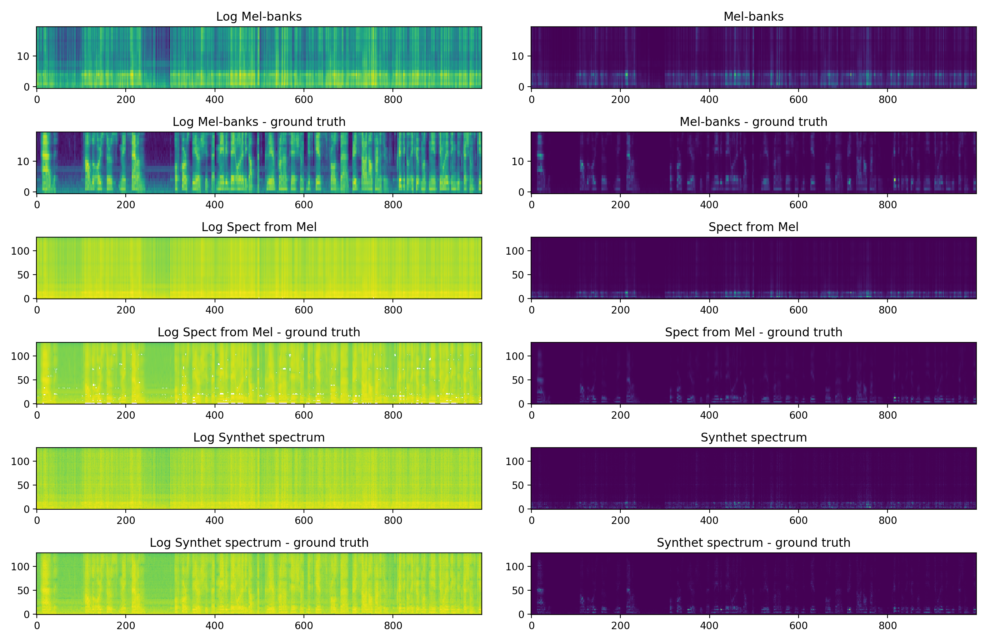

250
(129, 20)


/anaconda2/envs/python3/lib/python3.6/site-packages/ipykernel_launcher.py:49: RuntimeWarning: divide by zero encountered in log
/anaconda2/envs/python3/lib/python3.6/site-packages/ipykernel_launcher.py:49: RuntimeWarning: invalid value encountered in log
/anaconda2/envs/python3/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: divide by zero encountered in log
/anaconda2/envs/python3/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in log


(1000, 129)
(1000, 129)
125


/anaconda2/envs/python3/lib/python3.6/site-packages/ipykernel_launcher.py:60: RuntimeWarning: divide by zero encountered in log
/anaconda2/envs/python3/lib/python3.6/site-packages/ipykernel_launcher.py:61: RuntimeWarning: divide by zero encountered in log


In [86]:
#ipython -pylab
import scipy.io.wavfile as spiowav

AUD_fs = 8000
fig_counter = 0
max_subplots = 6
col_subplots = 2

def add_simple_spect(spect, name):
    global fig_counter
    fig_counter += 1
    ax = plt.subplot(max_subplots, col_subplots, fig_counter)
    ax.set_title(name)
    #plt.figure(figsize = figsize)
    plt.tight_layout()
    plt.imshow(spect.T,aspect='auto');plt.gca().invert_yaxis()


fig = plt.figure(figsize = (7 * col_subplots,3 * max_subplots / col_subplots))

fbank_mx= mel_fbank_mx(aud_window, fs=AUD_fs, NUMCHANS=20)
print(aud_window)
print(fbank_mx.shape)

#TRAIN data:
fea = model.predict(nn_in[:1000])
fea_des = nn_out[:1000]
#TEST data:
#fea = model.predict(nn_val_in[:1000])
#fea_des = nn_val_out[:1000]

#print(fea.shape)
add_simple_spect(fea, "Log Mel-banks"); add_simple_spect(np.exp(fea), "Mel-banks")
add_simple_spect(fea_des, "Log Mel-banks - ground truth"); add_simple_spect(np.exp(fea_des), "Mel-banks - ground truth")
#Audio(specgram2sig((np.exp(fea).dot(np.linalg.pinv(fbank_mx))), window, noverlap), rate = sample_rate, autoplay=True) 



# play signal reconstructed from mel filter bank energies
Z = np.random.randn(128128) # excitaion by white noise
#Z = np.zeros(len(x)) 
Z[0::17] = 1.0            # add some voicing
Z[0::35] = 2.0            # add some voicing
Z[0::75] = 20.0            # add some voicing
Z[0::152] = 15.0            # add some voicing
Z[0::380] = 10.0            # add some voicing
Z[0::80] = 10.0            # add some voicing

add_simple_spect(np.log((np.exp(fea).dot(np.linalg.pinv(fbank_mx)))), "Log Spect from Mel"); add_simple_spect(np.abs((np.exp(fea).dot(np.linalg.pinv(fbank_mx)))), "Spect from Mel")
add_simple_spect(np.log((np.exp(fea_des).dot(np.linalg.pinv(fbank_mx)))), "Log Spect from Mel - ground truth"); add_simple_spect(np.abs((np.exp(fea_des).dot(np.linalg.pinv(fbank_mx)))), "Spect from Mel - ground truth")

print((np.exp(fea).dot(np.linalg.pinv(fbank_mx))).shape)
print(spectrogram(Z, 256, 128).shape)
print(aud_overlap)
SS = (np.exp(fea).dot(np.linalg.pinv(fbank_mx))) * spectrogram(Z, 256, 128)
SS_des = (np.exp(fea_des).dot(np.linalg.pinv(fbank_mx))) * spectrogram(Z, 256, 128)

play_audio(specgram2sig(SS, aud_window, aud_overlap), autoplay=True) 
play_audio(specgram2sig(SS_des, aud_window, aud_overlap), autoplay=False) 
add_simple_spect(np.log(np.abs(SS)), "Log Synthet spectrum"); add_simple_spect(np.abs(SS), "Synthet spectrum")
add_simple_spect(np.log(np.abs(SS_des)), "Log Synthet spectrum - ground truth"); add_simple_spect(np.abs(SS_des), "Synthet spectrum - ground truth")





In [ ]:
# NOT USED

data_len_session2 = 97

## cycle
for s_id in range(1,6):
    get_comm_test(data_tab, s_id, te_id, data_len = (data_len_session2 if s_id == 2 else None))
    get_comm_train(data_tab, s_id, te_id, data_len = (data_len_session2 if s_id == 2 else None))

## only actual session
get_comm_test(data_tab, sessionid, te_id, data_len = (data_len_session2 if sessionid == 2 else None))
get_comm_train(data_tab, sessionid, te_id, data_len = (data_len_session2 if sessionid == 2 else None))


# creation of fair dataset for NN training (excluding commands that will be used for evalution)
## cycle
for s_id in range(1,6):
    data_tab = get_trial_desc(base_dir + "/session"+str(s_id)+"/Session"+str(s_id)+".xlsx")
    
    loud_ind, _, _ = get_filt_ind_maps(data_tab, loud = True, silent = False, command = True, timit = True, data_len = (data_len_session2 if s_id == 2 else None))
    loud_ind = set(loud_ind)
    comm_forbid = set([i[0] for i in get_comm_test(data_tab,s_id, data_len = (data_len_session2 if s_id == 2 else None))])
    fil_ind = loud_ind - comm_forbid
    
## only actual session
loud_ind, _, _ = get_filt_ind_maps(data_table, loud = True, silent = False, command = True, timit = True, data_len = (data_len_session2 if sessionid == 2 else None))
loud_ind = set(loud_ind)
comm_forbid = set([i[0] for i in get_comm_test(data_table,sessionid, data_len = (data_len_session2 if sessionid == 2 else None))])
fil_ind = loud_ind - comm_forbid    






# Simple Synthetizer

(48481,)


<IPython.core.display.Javascript object>


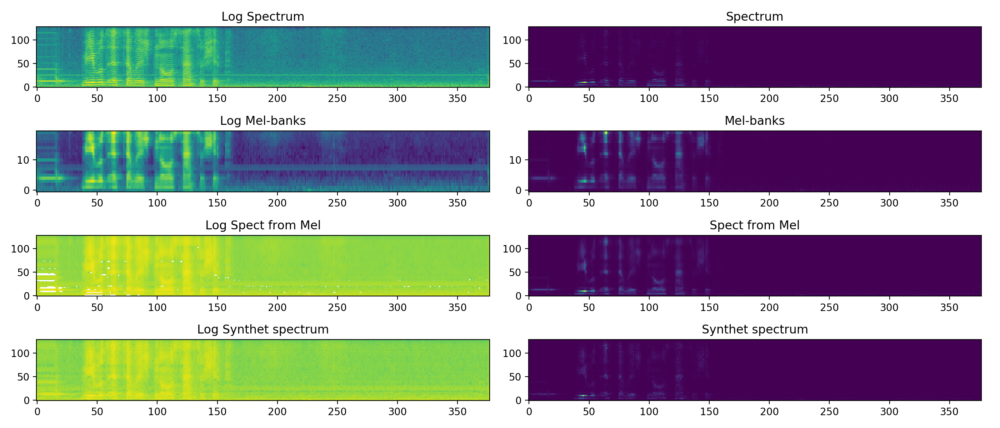

(129, 20)


/anaconda2/envs/python3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: divide by zero encountered in log
/anaconda2/envs/python3/lib/python3.6/site-packages/ipykernel_launcher.py:66: RuntimeWarning: invalid value encountered in log


/anaconda2/envs/python3/lib/python3.6/site-packages/ipykernel_launcher.py:71: RuntimeWarning: divide by zero encountered in log


In [88]:
#ipython -pylab
import scipy.io.wavfile as spiowav

i = 0
x = SEG_AUD[i][0]#[::5]


fig_counter = 0
max_subplots = 4
col_subplots = 2

def add_simple_spect(spect, name):
    global fig_counter
    fig_counter += 1
    ax = plt.subplot(max_subplots, col_subplots, fig_counter)
    ax.set_title(name)
    #plt.figure(figsize = figsize)
    plt.tight_layout()
    plt.imshow(spect.T,aspect='auto');plt.gca().invert_yaxis()





print(x.shape)
sample_rate = AUD_fs
#sample_rate = AUD_fs / 5




#utils.soundsc(x) # play original signal
play_audio(x, autoplay=False) 

window = 256
noverlap = 128


fig = plt.figure(figsize = (7 * col_subplots,3 * max_subplots / col_subplots))
    
#plot spectrogram
#S=spectrogram(x, np.hanning(window), noverlap)
S=spectrogram(x, window, noverlap)
add_simple_spect(np.log(np.abs(S)), "Log Spectrum"); add_simple_spect(np.abs(S), "Spectrum")

# play signal reconstructed from spectrogram
play_audio(specgram2sig(S, window, noverlap), autoplay=False) 

# extract and plot log mel filter bank energies
fbank_mx= mel_fbank_mx(window, fs=sample_rate, NUMCHANS=20)#, LOFREQ=0.0, HIFREQ=4000.0)
print(fbank_mx.shape)
fea = fbank_htk(x, window, noverlap, fbank_mx, USEPOWER=False, PREEMCOEF=0.7, ZMEANSOURCE=True)
add_simple_spect(fea, "Log Mel-banks"); add_simple_spect(np.exp(fea), "Mel-banks")
#Audio(specgram2sig((np.exp(fea).dot(np.linalg.pinv(fbank_mx))), window, noverlap), rate = sample_rate, autoplay=True) 

# play signal reconstructed from mel filter bank energies
Z = np.random.randn(len(x)) # excitaion by white noise
#Z = np.zeros(len(x)) 
Z[0::17] = 1.0            # add some voicing
Z[0::35] = 2.0            # add some voicing
Z[0::75] = 20.0            # add some voicing
Z[0::152] = 15.0            # add some voicing
Z[0::380] = 10.0            # add some voicing
Z[0::80] = 10.0            # add some voicing

add_simple_spect(np.log((np.exp(fea).dot(np.linalg.pinv(fbank_mx)))), "Log Spect from Mel"); add_simple_spect(np.abs((np.exp(fea).dot(np.linalg.pinv(fbank_mx)))), "Spect from Mel")

SS = (np.exp(fea).dot(np.linalg.pinv(fbank_mx))) * spectrogram(Z, window, noverlap)

play_audio(specgram2sig(SS, window, noverlap), autoplay=True) 
add_simple_spect(np.log(np.abs(SS)), "Log Synthet spectrum"); add_simple_spect( np.abs(SS), "Synthet spectrum")


## extract and plot log mel filter bank energies
#fbank_mx= mel_fbank_mx(window, fs=sample_rate, NUMCHANS=20, LOFREQ=0.0, HIFREQ=4000.0)
#fea = features.fbank_htk(x, window, noverlap, fbank_mx, USEPOWER=False, PREEMCOEF=0.7, ZMEANSOURCE=True)
#figure(); imshow(fea.T)
#
## play signal reconstructed from mel filter bank energies
#Z = np.random.randn(len(x)) # excitaion by white noise
##Z[0::80] = 10.0            # add some voicing
#SS = (np.exp(fea).dot(np.linalg.pinv(fbank_mx))) * features.spectrogram(Z, window, noverlap)
#utils.soundsc(features.specgram2sig(SS, window, noverlap))



# Replicate features

In [6]:
import collections

def recursively_default_dict():
    return collections.defaultdict(recursively_default_dict)

def get_sample_sum(signal, win_s = 9):
    # Add one column of zeroes
    #print(  np.hstack((np.zeros((signal.shape[0],1)),signal))[:2,:10])
    signal = np.hstack((np.zeros((signal.shape[0],1)),signal))
    cs = np.cumsum(signal,axis=1)
    sam_avg = cs[:,win_s:] - cs[:,:-win_s]
    #print(sam_avg[0,:3])
    return sam_avg

def get_sample_avg(signal, win_s = 9):    
    return get_sample_sum(signal, win_s) / win_s

def get_window_sum(signal, win_len, win_shift):
    return get_sample_sum(signal,win_len)[:,::win_shift]

def get_window_avg(signal, win_len, win_shift):
    return get_sample_avg(signal,win_len)[:,::win_shift]
    
def get_window_energy(signal, win_len, win_shift):
    return get_window_avg(np.power(signal, 2), win_len, win_shift)

    
def get_zero_crossing(signal):
    sig = signal > 0
    sig1 = np.hstack((sig[:,:1],sig))
    sig2 = np.hstack((sig,sig[:,-1:]))
    return (sig1 != sig2)[:,:-1]

def get_zero_crossing_per_frame(signal, win_len, win_shift):
    return get_window_sum(get_zero_crossing(signal), win_len, win_shift)
   

    
#print(SEG_EMG[0][0][:12])
#print(sum(SEG_EMG[0][0][:9]))
    
def replicate_features(x):
    win_s = 31     # 15 ms -> 30,72,  ( 9. ) 
    win_shift = 20 # 10 ms -> 20.48,  ( 6. )
    win_len = 55   # 27 ms -> 55.296, (16.2)
    # alternatively: 32 ms Blackman filter, 134 Hz cutoff freq -> low/high 

    # Remove means
    avg = [np.mean(xx,1, keepdims = True) for xx in x]
    x = [xx - aa for xx,aa in zip(x,avg)]

    w = [get_sample_avg(get_sample_avg(xx,win_s),win_s) for xx in x]
    # now should ignore first and last (2*(win_s - 1) / 2) samples 
    x = [xx[:,(win_s - 1):-(win_s - 1)] for xx in x]

    p = [xx - ww for xx,ww in zip(x,w)]
    r = [np.abs(pp) for pp in p]

    z = [get_zero_crossing_per_frame(pp, win_len, win_shift) for pp in p]


    w_avg = [get_window_avg(ww, win_len, win_shift) for ww in w]
    r_avg = [get_window_avg(rr, win_len, win_shift) for rr in r]

    Pw = [get_window_energy(ww, win_len, win_shift) for ww in w]
    Pr = [get_window_energy(rr, win_len, win_shift) for rr in r]





    # features = []
    # for i in range(len(Pw)): # all examples (trials) in x
    #     features.append([])
    #     for ii in range(len(Pw[i])): # all electrodes EMG/EEG; 8/32 
    #         features[i].append(np.array([(f[i][ii]) for f in [Pw, Pr, w_avg, r_avg, z]]).T)
    # 
    # context_w = 15        
    # context_features = []
    # 
    # for i,f in enumerate(features):
    #     context_features.append([])
    #     for ii,ff in enumerate(features[i]): 
    #         #print(framing(ff,2 * context_w + 1).shape)
    #         context_features[i].append(framing(ff,2 * context_w + 1))        
    # 




    replicated_features = []
    for i in range(len(Pw)): # all examples (trials) in x
        trial_features = [[(f[i][ii]) for f in [Pw, Pr, w_avg, r_avg, z]] for ii in range(len(Pw[i]))] # ii = all electrodes EMG/EEG; 8/32 
        
        replicated_features.append(np.transpose(np.array(trial_features),(2,0,1)))
        #print(features[i].shape)


    context_w = 15        
    context_features = [(framing(f,2 * context_w + 1)) for f in replicated_features]
    
    # Now in shape: ELECTRODES, SAMPLES, FEATURES
    # I need replicated features in shape: SAMPLES, ELECTRODES, FEATURES
    replicated_features = [np.transpose(rf,(1,0,2)) for rf in replicated_features]
    
    return replicated_features, context_features, win_shift

replicated_features, context_features, win_shift = replicate_features(SEG_EMG)

In [7]:
#print(features[8][0])
#print(features[9][0].shape)
#print(Pw[9][0])
#print(len(SEG_EMG[10][0]))
#print(len(SEG_EMG[9][0]))

#print(len(Pw[10][0]))
#print(len(Pw[9][0]))

#print(len(z[10][0]))
#print(len(z[9][0]))

#print(len(w[10][0]))
#print(len(x[10][0]))


#print(len(get_zero_crossing_per_frame(p[10][:,:], win_len, win_shift)[0]))


#print(len(get_window_avg(w[10][:,:], win_len, win_shift)[0]))
print(len(context_features))
print(len(context_features[0]))
print(len(context_features[0][0]))
print(len(context_features[0][0][0]))
print(len(context_features[0][0][0][0]))
print()
print(len(replicated_features))
print(len(replicated_features[0]))
print(len(replicated_features[0][0]))
print(len(replicated_features[0][0][0]))

210
377
31
8
5

210
8
407
5


In [8]:
#context_features = [(pp,Pr[i][ii],w_avg[i][ii],r_avg[i][ii],z[i][ii]) for i,p in enumerate(Pw) for ii,pp in enumerate(p)] 

print(len(replicated_features))
print(len(replicated_features[0]))
print(len(replicated_features[0][0]))
print(replicated_features[0][0][0])

print(len(Pw))
print(len(Pw[0]))
print(len(Pw[0][0]))
print(Pw[0][0][0])

print(len(Pw[0][0]))
print(context_features[0][0])

210
8
407
[ 7.84740478e+03  3.64201180e+01 -8.82766029e+01  4.56916427e+00
  1.10000000e+01]


NameError: name 'Pw' is not defined

In [13]:
print(len(features))
# examples * channels * len_per_recording
print(len(Pw[0][0]))
print(np.array(Pw))

420
407


ValueError: could not broadcast input array from shape (8,407) into shape (8)

In [52]:
print(get_zero_crossing(p[0]).shape)
print(z[0].shape)

print(get_zero_crossing(p[0])[0,:55])
print(p[0][0,:55])
print(z[0][0][0:2])

(8, 8194)
(8, 407)
[False False False False False False False  True  True False  True False
 False False False False False False False False  True False False  True
 False False False False False False False False False  True False False
 False False  True False False False False False False False  True False
  True False False False  True  True False]
[ -9.92773087 -12.58812056 -17.20154344 -17.52821748 -11.19248485
  -6.34095321  -3.40689907   0.91783639  -0.87238848  -0.04022493
   1.50709575   3.82847574   2.80113578   3.05425576   6.16292969
   7.6318231    6.35013608   3.82225933   0.96329204   0.20018101
  -0.78429027  -3.27230066  -3.63632478   1.29286954   8.44843428
   6.26859025   8.51643867  10.9899546    7.25957036   5.6297284
   1.96827578   0.56747757   0.34095006  -0.49054471  -4.49547279
  -6.85766878  -7.08819447  -5.00730899   0.22809749   5.27250906
   5.25314689   5.03468411   3.66429122   3.4016321    6.17509998
   2.51510359  -4.36637241  -2.38156722   0.80248158

In [286]:
print(w[0].shape)
print(w_avg[0].shape)
print(r_avg[0].shape)
print(Pw[0].shape)
print(Pr[0].shape)
print(z[0].shape)


print(p[0].shape)
print(p[0][1][20:50])
sum(zero_crossing(p[0])[1][20:50])
#print(np.logical_xor(p[0] > 0,p[0] > 1))

(8, 10222)
(8, 509)
(8, 509)
(8, 509)
(8, 509)
(8, 509)
(8, 10222)
[ -3.99135591  -1.89708013   4.18352385   7.06318804   6.17570134
   4.25926271   4.67700282   4.95376905   5.8661693    1.33677496
  -9.69948515 -10.48660936  -4.16698003  -2.24368884   0.70826671
   4.91390372   6.36053434   3.30328199   0.79194899  -0.91615793
  -3.34312322  -5.511709    -3.60328375  -0.25742576   1.50622762
   1.50864092   5.01175834  11.20630226  12.95018554   3.91779848]


5

In [147]:
abc = [1,2,3,4,5,6,7,8,9,10,11,12]
print(abc[::5])

[1, 6, 11]


## Train classifier

In [ ]:
#def get_comm_train(data_table, sess_id, test_id, labels_as_id = False, data_len = None):
#    _, id2comm, comm2id = get_filt_ind_maps(data_table, timit = False,allow_only_targ = True, allow_list=use_commands, data_len=data_len)
#    if (sess_id == test_id):
#        return [(vv,(labels2id[i] if labels_as_id else i)) for i,v in comm2id.items() if len(v)>2 for vv in v[2:]]  
#    else:
#        return [(i,(labels2id[v] if labels_as_id else v)) for i,v in id2comm.items()]
#
#def get_comm_test(data_table, sess_id, test_id, labels_as_id = False, data_len = None):
#    if (sess_id == test_id):
#        _, _, comm2id = get_filt_ind_maps(data_table, timit = False,allow_only_targ = True, allow_list=use_commands, data_len=data_len)
#        return [(vv,(labels2id[i] if labels_as_id else i)) for i,v in comm2id.items() for vv in v[:2]]
#    else:
#        return []

## cycle
for s_id in range(1,6):
    get_comm_test(data_tab, s_id, te_id, data_len = (data_len_session2 if s_id == 2 else None))
    get_comm_train(data_tab, s_id, te_id, data_len = (data_len_session2 if s_id == 2 else None))

## only actual session
get_comm_test(data_tab, sessionid, te_id, data_len = (data_len_session2 if sessionid == 2 else None))
get_comm_train(data_tab, sessionid, te_id, data_len = (data_len_session2 if sessionid == 2 else None))


In [219]:
print("")
print("TEST/TRAIN division:")
se_id = 7
te_id = se_id
silent = True
loud = True
#labels_as_id = True
labels_as_id = False
data_tab = get_trial_desc(base_dir + "/session"+str(se_id)+"/Session"+str(se_id)+".xlsx")
comm_ind, id2comm, comm2id = get_filt_ind_maps(data_tab, timit = False,allow_only_targ = True, allow_list=use_commands, silent=silent, loud=loud)

#comm_count = sorted([(i,len(l)) for i,l in comm2id.items()],key=lambda tup: tup[0])
#print(comm_count)
#print(len(comm_count))
print(id2comm)
print("Test", get_comm_test(data_tab,se_id, te_id,labels_as_id=labels_as_id, silent=silent, loud=loud))
print("Train", get_comm_train(data_tab,se_id, te_id, labels_as_id=labels_as_id, silent=silent, loud=loud))
print("")
print(sorted(list(id2comm)))
print(sorted([i[0] for i in get_comm_test(data_tab,se_id, te_id, silent=silent, loud=loud)]))
print(sorted([i[0] for i in get_comm_train(data_tab,se_id, te_id, silent=silent, loud=loud)]))


TEST/TRAIN division:
{0: 'eight', 1: 'eight', 2: 'divide', 3: 'divide', 4: 'five', 5: 'five', 6: 'multiply', 7: 'multiply', 8: 'two', 9: 'two', 10: 'four', 11: 'four', 12: 'seven', 13: 'seven', 14: 'six', 15: 'six', 16: 'three', 17: 'three', 18: 'nine', 19: 'nine', 20: 'add', 21: 'add', 22: 'one', 23: 'one', 24: 'subtract', 25: 'subtract', 26: 'zero', 27: 'zero', 28: 'subtract', 29: 'subtract', 30: 'percent', 31: 'percent', 33: 'add', 35: 'five', 36: 'one', 37: 'one', 38: 'divide', 39: 'divide', 40: 'seven', 41: 'seven', 42: 'multiply', 43: 'multiply', 44: 'nine', 45: 'nine', 46: 'zero', 47: 'zero', 48: 'two', 49: 'two', 50: 'eight', 51: 'eight', 52: 'three', 53: 'three', 54: 'divide', 55: 'divide', 56: 'percent', 57: 'percent', 58: 'seven', 59: 'seven', 60: 'six', 61: 'six', 62: 'zero', 63: 'zero', 64: 'four', 65: 'four', 66: 'six', 67: 'six', 68: 'four', 69: 'four', 70: 'three', 71: 'three', 72: 'percent', 73: 'percent', 74: 'multiply', 75: 'multiply', 77: 'add', 78: 'one', 79: 'one

In [ ]:
test_example_count = 5
#TODO: add validation set
save_features = True
save_features_dir = base_dir

context=5
OFFSET_start=0.35
OFFSET_end=0.2
#OFFSET_end=2.0


#OFFSET_start_bio=int(OFFSET_start*BIO_fs)
#OFFSET_end_bio=int(OFFSET_end*BIO_fs)
#OFFSET_start_aud=int(OFFSET_start*AUD_fs)
#OFFSET_end_aud=int(OFFSET_end*AUD_fs)

OFFSET_start_bio = None
OFFSET_end_bio   = None
OFFSET_start_aud = None
OFFSET_end_aud   = None

emg_mel_banks_count = 10  

shift_mult = 1

#TODO: do something when the window is not the same (problem in framing -> add zeroes or remove some parts?) 375 zeroes to both sides

emg_wind_mult = 4
eeg_wind_mult = 1
aud_wind_mult = 1


# BASE SHIFT - 15.625 ms
bio_base_window = 64 ; bio_shift = 32  * shift_mult
aud_base_window = 250; aud_shift = 125 * shift_mult

emg_window = bio_base_window * emg_wind_mult
eeg_window = bio_base_window * eeg_wind_mult
aud_window = aud_base_window * aud_wind_mult

emg_overlap = emg_window - bio_shift 
eeg_overlap = eeg_window - bio_shift 
aud_overlap = aud_window - aud_shift 

# 64  * 32 = 2048 31.25 s 
# 250 * 32 = 8000


targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = True, silent = False, loud = True)

fil_ind = targ_ind


take_only_first_coef = None

def get_dataset(indices):
    A_aud_mb = []
    A_emg_spect = []
    A_emg_spect_log = []
    A_emg_mb = []
    for ind in indices:
        emg_data = SEG_EMG[ind][OFFSET_start_bio:OFFSET_end_bio]
        audio_data = SEG_AUD[ind][OFFSET_start_aud:OFFSET_end_aud]

        #TODO, do it nicer:
        #add_aud_zeroes = [int((emg_wind_mult - aud_wind_mult) * aud_base_window / 2)* [0]]
       # audio_data = np.concatenate((add_aud_zeroes, audio_data, add_aud_zeroes), axis = 1)
        remove_aud_points = ((emg_wind_mult - aud_wind_mult) * aud_base_window) // 2
        audio_data = audio_data[:,remove_aud_points:-remove_aud_points]
        aud_mb = get_aud_mel_bank(audio_data,aud_window, aud_overlap, 20, AUD_fs)

        # TODO: take_only_first_coef = all?
        emg_spect = get_spect(emg_data, emg_window, emg_overlap, take_only_first_coef = take_only_first_coef, use_log = False)
        emg_spect_log = get_spect(emg_data, emg_window, emg_overlap, take_only_first_coef = take_only_first_coef)
        emg_mb = get_bio_mel_bank(emg_data, emg_window, emg_overlap, emg_mel_banks_count, BIO_fs)#, HIFREQ=512) 


        A_aud_mb.append(aud_mb)  
        A_emg_spect.append(emg_spect)
        A_emg_spect_log.append(emg_spect_log )
        A_emg_mb.append(emg_mb)

        #print(aud_mb.shape)
        #print(emg_mb.shape)
        #print(emg_spect.shape)



        # TODO: try append context?, remove offsets, dont_use only 20 coeffs, take phase

        continue;

        bio_fea_eeg=None
        for fea_ind in range(32):
            bio_fea_pom=exp_context_append(context,get_bio_fea(BIO_EEG[fea_ind,BIO_st:BIO_en],BIO_fs),[])

            if bio_fea_eeg is None:
                bio_fea_eeg=bio_fea_pom
            else:
                bio_fea_eeg=np.concatenate((bio_fea_eeg,bio_fea_pom),axis=1)



        bio_fea_emg=None
        for fea_ind in range(8):
            bio_fea_pom=exp_context_append(context,get_bio_fea(BIO_EMG[fea_ind,BIO_st:BIO_en],BIO_fs),[])

            if bio_fea_emg is None:
                bio_fea_emg=bio_fea_pom
            else:
                bio_fea_emg=np.concatenate((bio_fea_emg,bio_fea_pom),axis=1)


        AUD_st=AUD_TRG_ind[ind][0]+OFFSET_start_aud
        #AUD_en=AUD_TRG_ind[ind][1]-OFFSET_end_aud
        AUD_en=int(AUD_st+np.shape(bio_fea_eeg)[0]/100*AUD_fs+0.015*AUD_fs)
        print("AUD_len_mb: "+str((AUD_en-AUD_st)/float(AUD_fs) ) + " From: " +str(AUD_st)+ " To: " + str(AUD_en)  )       

        aud_fea_mb=exp_context_append(0,get_aud_fea(AUD_wav[AUD_st:AUD_en],AUD_fs),[])

    print(np.array(A_aud_mb).shape)
    print(np.concatenate(np.array(A_aud_mb)).shape)
    return A_aud_mb, A_emg_mb, A_emg_spect, A_emg_spect_log


# REGRESSION
#TODO: do it better than 15 ms * 20 removal!
cut_st = 25
cut_en = 125
TRN_aud_mb, TRN_emg_mb, TRN_emg_spect, TRN_emg_spect_log = [np.concatenate([example[cut_st:cut_en] for example in x]) for x in get_dataset(fil_ind[test_example_count:])]
TST_aud_mb, TST_emg_mb, TST_emg_spect, TST_emg_spect_log = [np.concatenate([example[cut_st:cut_en] for example in x]) for x in get_dataset(fil_ind[:test_example_count])]


if save_features:
    # TODO: add normalization
    #!mkdir {save_features_dir + "/features"}
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "aud_mb"        + "_train", TRN_aud_mb)
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_mb"        + "_train", TRN_emg_mb)
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_spect"     + "_train", TRN_emg_spect)
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_spect_log" + "_train", TRN_emg_spect_log)

    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "aud_mb"        + "_test", TST_aud_mb)
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_mb"        + "_test", TST_emg_mb)
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_spect"     + "_test", TST_emg_spect)
    np.save(save_features_dir + "/features/sess"+ str(sessionid) + "_" + "emg_spect_log" + "_test", TST_emg_spect_log)


#print(AUD_TRG_ind)
#print(BIO_TRG_ind)

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras import layers
from tensorflow.keras import Input



nn_in     = TRN_emg_spect_log
nn_val_in = TST_emg_spect_log
#nn_in     = TRN_aud_mb
#nn_val_in = TST_aud_mb


nn_out     = TRN_aud_mb
nn_val_out = TST_aud_mb




num_epochs = 50
batch_size = 32


def build_simple_model(input_dim, output_dim, activation = 'relu'):
    """Returns first and last layers"""
    #TODO: try all activations?
    nn_inp = Input(shape = (input_dim,))
    nn_h = layers.Dense(50, activation=activation)(nn_inp)
    nn_h = layers.Dense(50, activation=activation)(nn_h)
    #nn_h = layers.Dense(150, activation=activation)(nn_h)
    nn_out = layers.Dense(output_dim)(nn_h)
    return nn_inp, nn_out




nn_inp_lay, nn_out_lay = build_simple_model(nn_in.shape[-1], nn_out.shape[-1])
model = Model(nn_inp_lay, nn_out_lay)
model.compile(optimizer='adam',loss='mse',metrics=['mae'])
model.summary()



## Show r and signal

{"don't lose the chuck key": [0], 'vapor pressure method': [2], 'percent': [4, 177, 285], 'so he hides the mayonnaise': [6], 'twenty five the sheik replied': [8], 'divide': [10, 181], 'clear pronunciation is appreciated': [14], 'how did one join them': [16], "it's a formality you know": [18], 'this was easy for us': [20], 'seven': [22, 202], 'right': [25, 143], 'a bullet she answered': [27], 'movies never have enough villains': [29], 'his technique is genuinely masterful': [31], 'this is a sleeping capsule': [33], "don't do charlie's dirty dishes": [35], 'four': [37, 123, 260], 'melancholy obsession': [39], 'either that or a veterinarian': [41], 'eight': [43, 217], "this kid's froze bad": [45], 'five': [47, 129], 'theocracy reconsidered': [48], 'they were shattered': [50], 'dolphins are intelligent marine mammals': [52], 'a rabbit punch redoubled him': [54], 'two': [56, 219], 'six': [58, 173, 262], 'climb': [60, 212], 'who wants this deed done': [62], "stimulating discussions keep stud

<IPython.core.display.Javascript object>


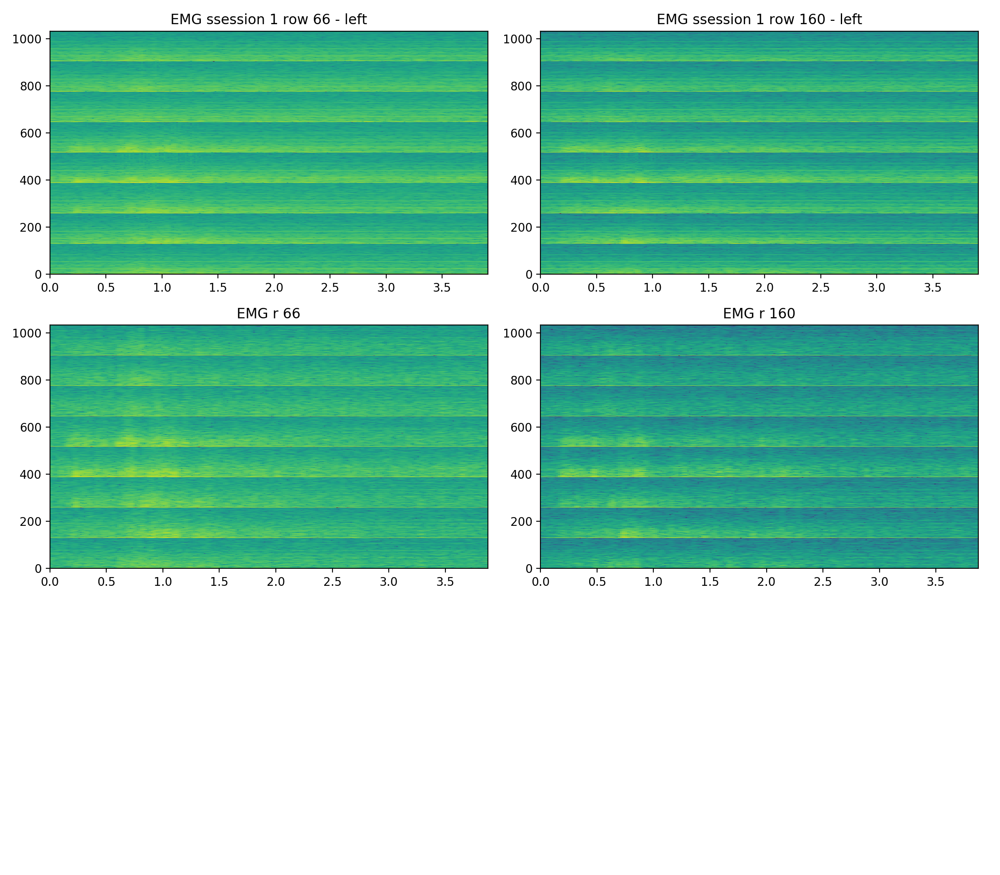

<IPython.core.display.Javascript object>


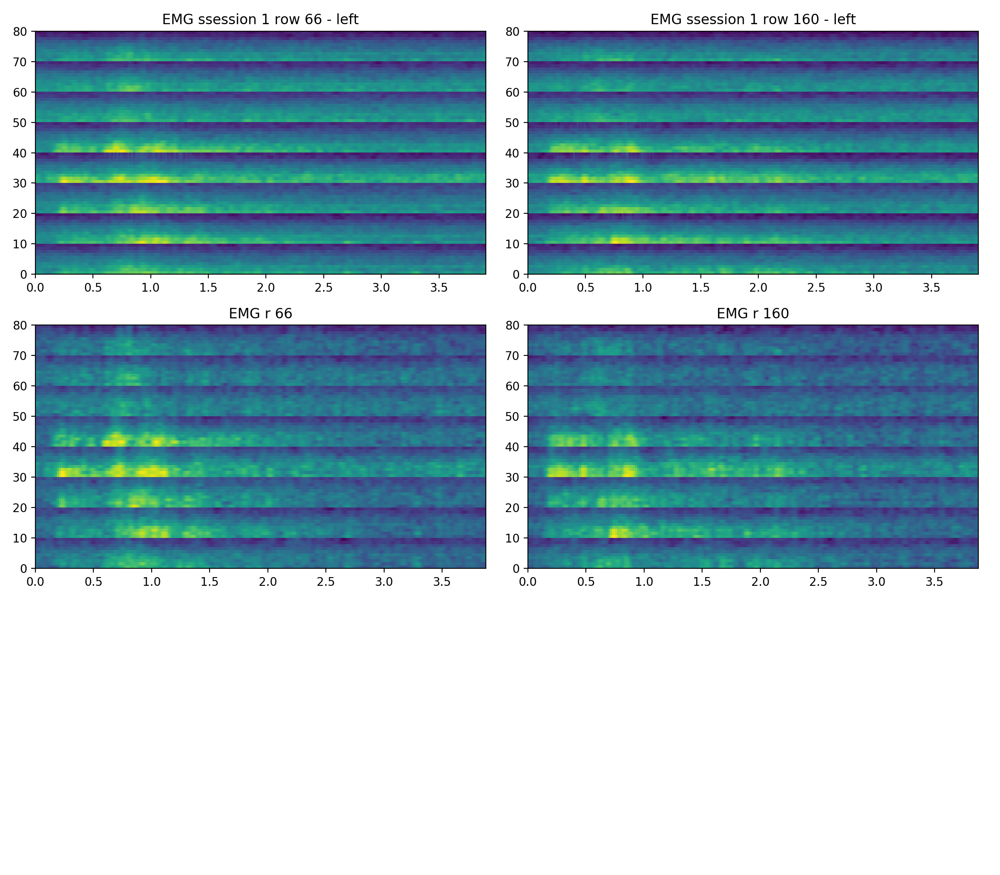

-369.5324707222213
308.3748937252133


<IPython.core.display.Javascript object>


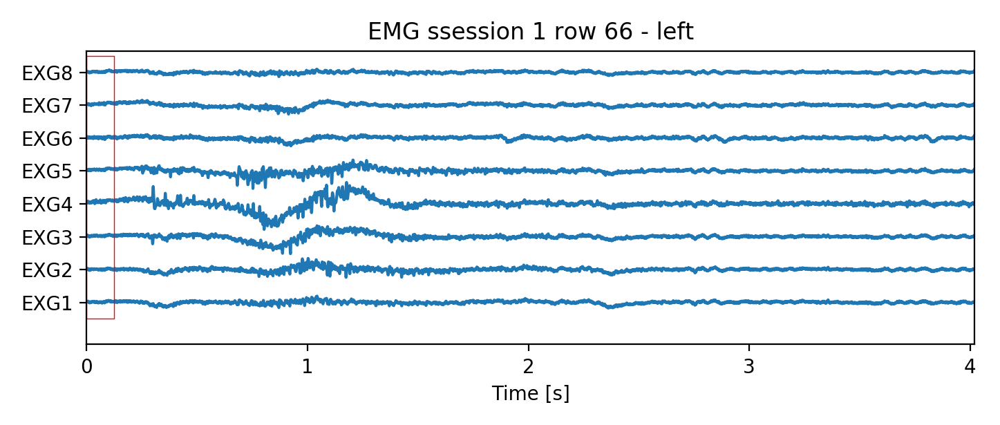

-219.89298152077177
341.93719029134917


<IPython.core.display.Javascript object>


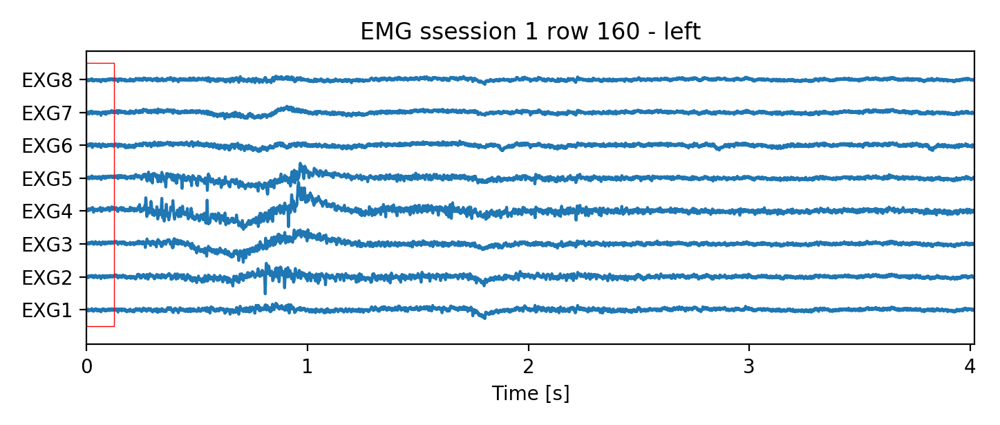

0.0004231986365947904
177.48779913081614


<IPython.core.display.Javascript object>


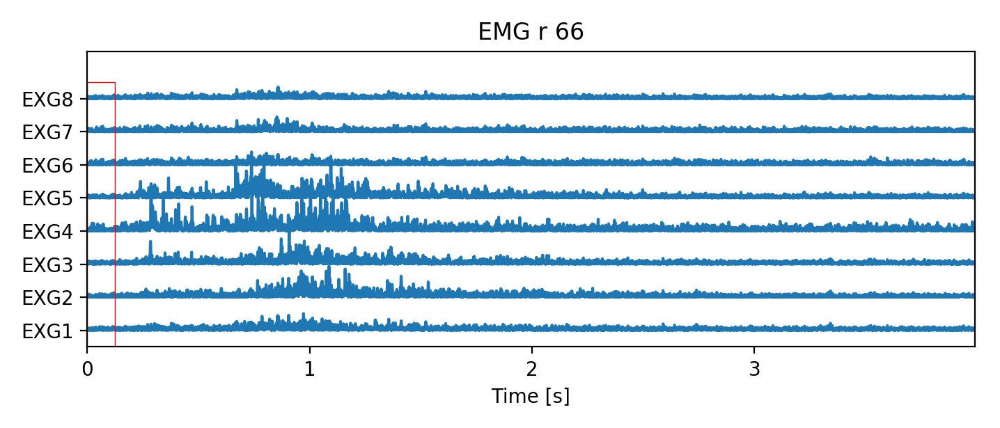

5.6704246556904536e-05
219.1238843747523


<IPython.core.display.Javascript object>


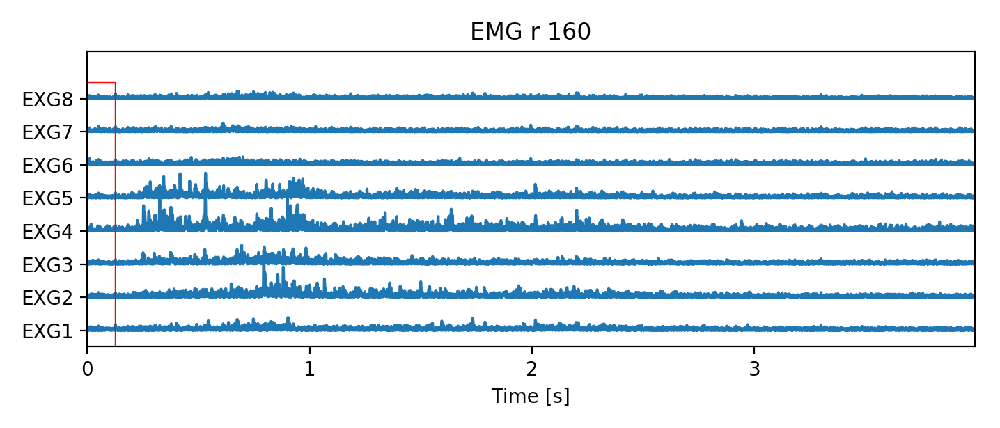

In [194]:
def show_all_plots(BIO_EEG, BIO_EMG, EEG_L, EMG_L, description = ""):#, window_bio, window_aud, noverlap):
    line_w = 3 # How many free (black) points (as separation) in figures between 2 electrodes    
    
    if False: #EEG
        eeg_down_s = 1
        eeg_time_down = 1./1
        
        eeg_window  = 64; eeg_window  = int(eeg_window  / eeg_time_down)
        eeg_overlap = 32; eeg_overlap = int(eeg_overlap / eeg_time_down)
        
        #show_data(name = "EEG",data =BIO_EEG, labels = session1_BIO["EEG_ch_L"], downsampl_factor = 1, win_start = 0 / 1000., win_len = 100 / 1000., fs = BIO_fs)
        show_data("EEG " + description, BIO_EEG,EEG_L, fs = BIO_fs, win_len= eeg_window/float(BIO_fs) * eeg_down_s, use_same_scale=False)
        #print(BIO_EEG.shape)
    
    
    # 4,1 or 1, 0.25 seems reasonable
    if True: #EMG
        emg_mel_banks_count = 10        
        emg_down_s = 1
        emg_time_down = 1./4        
        #emg_down_s = 4
        #emg_time_down = 1./1
        emg_window  = 64; emg_window  = int(emg_window  / emg_time_down)
        #emg_overlap = 32; emg_overlap = emg_window - emg_overlap*2 
        emg_overlap = 32; emg_overlap = emg_window - emg_overlap 
        #emg_overlap = 32; emg_overlap = int(emg_overlap / emg_time_down)
                        
        show_data("EMG " + description, BIO_EMG,EMG_L, fs = BIO_fs, win_len= emg_window/float(BIO_fs) * emg_down_s, use_same_scale=False) 
        
        # Spectral analysis                
        if True: 
            # if no need for line separation, use this
            emg_spect = get_spect(BIO_EMG[:][:,::emg_down_s], emg_window, emg_overlap)
            #emg_spect = get_spect(BIO_EMG[:][:,::emg_down_s], emg_window, emg_overlap, use_log = False)
            emg_mb = get_bio_mel_bank(BIO_EMG[:][:,::emg_down_s], emg_window, emg_overlap, emg_mel_banks_count, int(BIO_fs/emg_down_s))        
            add_emg_spect(emg_spect , "EMG " + description,((emg_window-emg_overlap)/float(BIO_fs)*emg_down_s)*emg_spect.shape[0], EMG_L)
            add_emg_mel(emg_mb , "EMG " + description,((emg_window-emg_overlap)/float(BIO_fs)*emg_down_s)*emg_mb.shape[0], EMG_L)
         
        if False:
            emg_spect = np.log(np.abs(spectrogram(BIO_EMG[0,::emg_down_s], emg_window, emg_overlap)))
            emg_spec_bins = emg_spect.shape[1]        
            emg_fbank_mx= mel_fbank_mx(emg_window, fs=int(BIO_fs/emg_down_s), NUMCHANS=emg_mel_banks_count)#, LOFREQ=0.0, HIFREQ=4000.0)
            emg_mb = fbank_htk(BIO_EMG[0,::emg_down_s], emg_window, emg_overlap, emg_fbank_mx, USEPOWER=False, PREEMCOEF=None, ZMEANSOURCE=True)
            emg_mel_bins = emg_mb.shape[1]
            for i in range(1,BIO_EMG.shape[0]):
                emg_spect = np.hstack((emg_spect, np.zeros((emg_spect.shape[0],line_w)), np.log(np.abs(spectrogram(BIO_EMG[i,::emg_down_s], emg_window, emg_overlap)))))
                emg_mb = np.hstack((emg_mb, np.zeros((emg_mb.shape[0],line_w)), fbank_htk(BIO_EMG[i,::emg_down_s], emg_window, emg_overlap, emg_fbank_mx, USEPOWER=False, PREEMCOEF=None, ZMEANSOURCE=True)))

            add_emg_spect(emg_spect , "EMG " + description,((emg_window-emg_overlap)/float(BIO_fs)*emg_down_s)*emg_spect.shape[0], EMG_L, True, BIO_EMG.shape[0], emg_spec_bins, line_w)
            add_emg_mel(emg_mb , "EMG " + description,((emg_window-emg_overlap)/float(BIO_fs)*emg_down_s)*emg_mb.shape[0], EMG_L, True, BIO_EMG.shape[0], emg_mel_bins, line_w)
    

emg_spec_counter = 0
emg_mel_counter = 0
max_subplots = 3
col_subplots = 2
#window = 256
#noverlap = 128

# TODO: resample if want any frequencies
# 32  * 64 = 2048
# 125 * 64 = 8000

# 64  * 32 = 2048 31.25 s 
# 250 * 32 = 8000

def add_spect(fig_counter, spect, name, duration, labels = None, draw_line = False, line_max = 8, line_sampl = 20, line_w = 4):
    ax = plt.subplot(max_subplots, col_subplots, fig_counter)
    ax.set_title(name)
    
    if draw_line:
        for i in range(1,line_max):
            ax.axhspan((line_sampl + line_w)*i - line_w + 1.5, (line_sampl + line_w)*i - 0.5,color="black")
        ax.set_yticks([(line_sampl + line_w)*(i + 0.5) for i in range(line_max)])
        ax.set_yticklabels(labels)
        ax.set_xlabel("Time [s]")
    #plt.figure(figsize = figsize)
    plt.tight_layout()

    plt.imshow(spect.T,aspect='auto',extent=[0,duration,spect.shape[1],0]);plt.gca().invert_yaxis()
    
def add_emg_spect(*args):    
    global emg_spec_counter
    emg_spec_counter += 1
    plt.figure(emg_spect_fig_name) 
    add_spect(emg_spec_counter, *args)
    
def add_emg_mel(*args):
    global emg_mel_counter
    emg_mel_counter += 1
    plt.figure(emg_mel_fig_name) 
    add_spect(emg_mel_counter, *args)

emg_spect_fig_name = "EMG_spect"
emg_mel_fig_name = "EMG_Mel"
i = 8
# try i = 223, session1
if VISUALIZE:

    targ_ind, id2targ, targ2id = get_filt_ind_maps(data_table, timit = True, silent = False, loud = True)
    print(targ2id)
    emg_spec_counter = 0
    emg_mel_counter = 0
    max_subplots = 3
    col_subplots = 2
    _ = plt.figure(emg_spect_fig_name, figsize = (6 * col_subplots,7 * max_subplots / col_subplots))
    _ = plt.figure(emg_mel_fig_name, figsize = (6 * col_subplots,7 * max_subplots / col_subplots))
            
#    for i in targ2id[id2targ[66]]:
#        show_all_plots(SEG_EEG[i], SEG_EMG[i], SEG_AUD[i], EEG_L, EMG_L, "sesssion " + str(sessionid) + " row " + str(i) + " - " + id2targ[i])
#        play_audio(SEG_AUD[i])
        
    num = 66
    for i in targ2id[id2targ[num]][:2]:
        show_all_plots(SEG_EEG[i], SEG_EMG[i], EEG_L, EMG_L, "ssession " + str(sessionid) + " row " + str(i) + " - " + id2targ[i])
        #play_audio(SEG_AUD[i])

    for i in targ2id[id2targ[num]][:2]:
        show_all_plots(SEG_EEG[i], r[i], EEG_L, EMG_L, "r " + str(i))
        #play_audio(SEG_AUD[i])


# Create features

In [352]:
context=5
OFFSET_start=0.35
#OFFSET_end=0.2
OFFSET_end=2.0


OFFSET_start_bio=int(OFFSET_start*BIO_fs)
OFFSET_end_bio=int(OFFSET_end*BIO_fs)

OFFSET_start_aud=int(OFFSET_start*AUD_fs)
OFFSET_end_aud=int(OFFSET_end*AUD_fs)

SHOW_IMAGE=False


fea_train=None
fea_test=None
fea_train_ind=0
fea_test_ind=0
fea_test_pitch=None





for ind in fil_ind:
    #ind=169

    #if (data_table['Rejected'][ind] == 0.0):
    print("Sample: " + str(ind))

    BIO_st=BIO_TRG_ind[ind][0]+OFFSET_start_bio
    BIO_en=BIO_TRG_ind[ind][1]-OFFSET_end_bio
    print("BIO_len: "+str((BIO_en-BIO_st)/float(BIO_fs) ) )
    #if ((BIO_en-BIO_st)/BIO_fs) < 1.0:
    #    print("Skipping.. segment is to short (an ERROR?)")
    #    continue

    bio_fea_eeg=None
    for fea_ind in range(32):
        bio_fea_pom=exp_context_append(context,get_bio_fea(BIO_EEG[fea_ind,BIO_st:BIO_en],BIO_fs),[])

        if bio_fea_eeg is None:
            bio_fea_eeg=bio_fea_pom
        else:
            bio_fea_eeg=np.concatenate((bio_fea_eeg,bio_fea_pom),axis=1)



    bio_fea_emg=None
    for fea_ind in range(8):
        bio_fea_pom=exp_context_append(context,get_bio_fea(BIO_EMG[fea_ind,BIO_st:BIO_en],BIO_fs),[])

        if bio_fea_emg is None:
            bio_fea_emg=bio_fea_pom
        else:
            bio_fea_emg=np.concatenate((bio_fea_emg,bio_fea_pom),axis=1)


    AUD_st=AUD_TRG_ind[ind][0]+OFFSET_start_aud
    #AUD_en=AUD_TRG_ind[ind][1]-OFFSET_end_aud
    AUD_en=int(AUD_st+np.shape(bio_fea_eeg)[0]/100*AUD_fs+0.015*AUD_fs)
    print("AUD_len_mb: "+str((AUD_en-AUD_st)/float(AUD_fs) ) + " From: " +str(AUD_st)+ " To: " + str(AUD_en)  )       

    aud_fea_mb=exp_context_append(0,get_aud_fea(AUD_wav[AUD_st:AUD_en],AUD_fs),[])

    if True:
        AUD_st=int((AUD_TRG_ind[ind][0]+OFFSET_start_aud)/AUD_fs*100)
        #AUD_en=AUD_TRG_ind[ind][1]-OFFSET_end_aud
        AUD_en=int(AUD_st+np.shape(bio_fea_eeg)[0])
        print("AUD_len_lsp: "+str((AUD_en-AUD_st)/100 ) + " From: " +str(AUD_st)+ " To: " + str(AUD_en) )       
        aud_fea_lsp=AUD_lsp[AUD_st:AUD_en,:]

    if True:
        AUD_st=int((AUD_TRG_ind[ind][0]+OFFSET_start_aud)/AUD_fs*100)
        #AUD_en=AUD_TRG_ind[ind][1]-OFFSET_end_aud
        AUD_en=int(AUD_st+np.shape(bio_fea_eeg)[0])
        print("AUD_len_mfcc: "+str((AUD_en-AUD_st)/100 ) + " From: " +str(AUD_st)+ " To: " + str(AUD_en) )       
        aud_fea_mfcc=AUD_mfcc[AUD_st:AUD_en,:]
        aud_pitch=AUD_pitch_raw[AUD_st:AUD_en]

    if False:
        plt.close('all')
        plt.figure(figsize=(6, 10))
        ax1 = plt.subplot2grid((6, 1), (0, 0), rowspan=4)
        ax2 = plt.subplot2grid((6, 1), (4, 0), rowspan=1)
        ax3 = plt.subplot2grid((6, 1), (5, 0) )        
        ax1.imshow(bio_fea_eeg.T,aspect="auto",vmin=-1.7,vmax=1.7)
        #plt.set_title('EEG - Session 1, index ' + str(ind))        
        print(np.min(bio_fea_eeg), np.max(bio_fea_eeg))

        ax2.imshow(bio_fea_emg.T,aspect="auto",vmin=-2,vmax=2)
        #ax2.set_title('EMG')
        print(np.min(bio_fea_emg), np.max(bio_fea_emg))

        #ax3.imshow(aud_fea.T,aspect="auto",vmin=-5,vmax=12)
        #ax3.set_title('Speech')
        #print(np.min(aud_fea), np.max(aud_fea))



    if SHOW_IMAGE:
        #plt.close('all')
        plt.figure(ind,figsize=(6, 10))
        ax1 = plt.subplot2grid((8, 1), (0, 0), rowspan=4)
        ax2 = plt.subplot2grid((8, 1), (4, 0), rowspan=1)
        ax3 = plt.subplot2grid((8, 1), (5, 0) )        
        ax4 = plt.subplot2grid((8, 1), (6, 0) )        
        ax5 = plt.subplot2grid((8, 1), (7, 0) )        
        ax1.imshow(bio_fea_eeg.T,aspect="auto",vmin=-1.7,vmax=1.7)
        ax1.set_title('EEG - Session 1, index ' + str(ind))        
        print(np.min(bio_fea_eeg), np.max(bio_fea_eeg))

        ax2.imshow(bio_fea_emg.T,aspect="auto",vmin=-2,vmax=2)
        ax2.set_title('EMG')
        print(np.min(bio_fea_emg), np.max(bio_fea_emg))

        ax3.imshow(aud_fea_mb.T,aspect="auto",vmin=-5,vmax=12)
        ax3.set_title('Speech - MB')
        print(np.min(aud_fea_mb), np.max(aud_fea_mb))

        ax4.imshow(aud_fea_lsp.T,aspect="auto",vmin=0,vmax=3)
        ax4.set_title('Speech - LSP')
        print(np.min(aud_fea_lsp), np.max(aud_fea_lsp))

        ax5.imshow(aud_fea_mfcc.T,aspect="auto",vmin=0,vmax=3)
        ax5.set_title('Speech - MFCC')
        print(np.min(aud_fea_mfcc), np.max(aud_fea_mfcc))



        plt.tight_layout()

    #if ind > 3:
    #    break;        



    #fea_pom=np.concatenate((bio_fea_emg,aud_fea_mb),axis=1)
    #fea_pom=np.concatenate((bio_fea_emg,aud_fea_lsp),axis=1)
    fea_pom=np.concatenate((bio_fea_emg,aud_fea_mfcc),axis=1)
    #fea_pom=np.concatenate((bio_fea_eeg,aud_fea_mfcc),axis=1)


    if ind > 240:
        print("Adding to test fea: " + str(np.shape(fea_pom)) + " From: " +str(fea_test_ind)+ " To: " +str(fea_test_ind + np.shape(fea_pom)[0] -1 ) )
        fea_test_ind=fea_test_ind+np.shape(fea_pom)[0];

        if fea_test is None:
            fea_test=fea_pom
            fea_test_pitch=aud_pitch
        else:
            fea_test=np.concatenate((fea_test,fea_pom),axis=0)
            fea_test_pitch=np.concatenate((fea_test_pitch,aud_pitch),axis=0)
    else:
        print("Adding to train fea: " + str(np.shape(fea_pom)) + " From: " +str(fea_train_ind)+ " To: " +str(fea_train_ind + np.shape(fea_pom)[0] -1 ) )
        fea_train_ind=fea_train_ind+np.shape(fea_pom)[0];

        if fea_train is None:
            fea_train=fea_pom
        else:
            fea_train=np.concatenate((fea_train,fea_pom),axis=0)

    #print(np.shape(fea))


print(np.shape(fea_train))
print(np.shape(fea_test))
        
       
        
    
    
#print(AUD_TRG_ind)
#print(BIO_TRG_ind)

Sample: 0
BIO_len: 1.6904296875
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
(171, 60)
(60,)
AUD_len_mb: 1.0149873027389806 From: 1183755 To: 1228520
44104


UnboundLocalError: local variable 'fbanks' referenced before assignment

In [53]:
AUD_lsp_raw=np.loadtxt(base_dir + "/session"+sessionid+"/Session"+sessionid+"_8kHz.lsp.txt")
AUD_lsp=np.reshape(AUD_lsp_raw,(-1,21))


#session1_BIO['EEG', 'EMG', 'Trgr', 'fs', 'gain', 'EEG_ch_L', 'EMG_ch_L', 'Trgr_ch_L']
#session1_AUDTRG["atrgr_mat"]

In [54]:
AUD_mfcc_raw=np.loadtxt(base_dir + "/session"+sessionid+"/Session"+sessionid+"_8kHz.mfcc.txt")
AUD_mfcc=np.reshape(AUD_mfcc_raw,(-1,21))
AUD_pitch_raw=np.loadtxt(base_dir + "/session"+sessionid+"/Session"+sessionid+"_8kHz.pitch.txt")
print(AUD_mfcc_raw)
print(AUD_mfcc)

[ 5.73049    1.55181    0.113442  ... -0.122344   0.294149  -0.0989241]
[[ 5.73049e+00  1.55181e+00  1.13442e-01 ... -1.40626e-02 -9.83631e-03
  -1.61575e-02]
 [ 3.91051e+00  2.37141e+00  6.07457e-01 ... -8.15416e-02 -4.75444e-02
  -4.05460e-02]
 [ 3.82819e+00  2.71449e+00  7.43302e-01 ...  1.36993e-01  1.65378e-02
  -7.80620e-02]
 ...
 [ 3.64579e+00  2.12470e+00  3.88598e-01 ... -6.46669e-03  1.50301e-01
  -1.05005e-01]
 [ 3.80677e+00  2.50702e+00  5.13457e-01 ...  1.13067e-02  3.59469e-03
  -1.14165e-01]
 [ 3.58358e+00  1.96308e+00  5.19767e-01 ... -1.22344e-01  2.94149e-01
  -9.89241e-02]]


In [8]:
np.random.shuffle(fea_train)
np.save(base_dir + "/session"+sessionid+"/train_EMG_10ms_20MB_c"+str(context)+"_AUD_10ms_21MFCC_c0",fea_train)
np.save(base_dir + "/session"+sessionid+"/test_EMG_10ms_20MB_c"+str(context)+"_AUD_10ms_21MFCC_c0",fea_test)
np.save(base_dir + "/session"+sessionid+"/test_pitch_c0",fea_test_pitch)
np.savetxt(base_dir + "/session"+sessionid+"/test_pitch_c0.txt",fea_test_pitch,fmt='%f')

In [20]:
np.savetxt(base_dir + "/session"+sessionid+"/test_pitch_c0.txt",fea_test_pitch,fmt='%f')

In [100]:
from scipy.io import wavfile
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import re
import os.path as path


data_table=get_trial_desc(base_dir + "/trial_summary_20181224_215657_UO.xlsx")
session1=np.load(base_dir + "/session1/Session1_filtered_bio_data.npz");

#fs, wav = wavfile.read(base_dir + "/session1/audio_20181224_215657_UO.wav", 'r');  
#trg_mat=segment_audio_signal(wav, fs, npeaks= trigger_fname="/mnt/matylda6/szoke/SILENT_SPEECH/SCRIPTS/trigger_struct.mat" )
a,b,c,d=segment_bio_signal(session1["EEG"], session1["EMG"], session1["Trgr"], data_table)




don't lose the chuck key
1.992
(32, 10262)


<IPython.core.display.Javascript object>


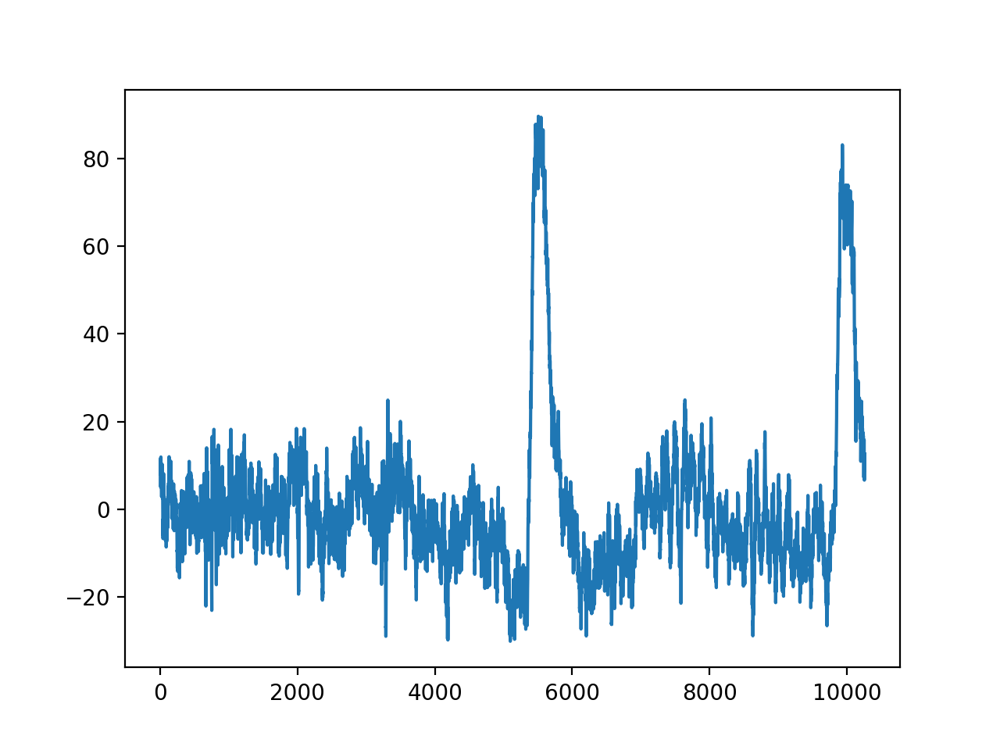

<IPython.core.display.Javascript object>


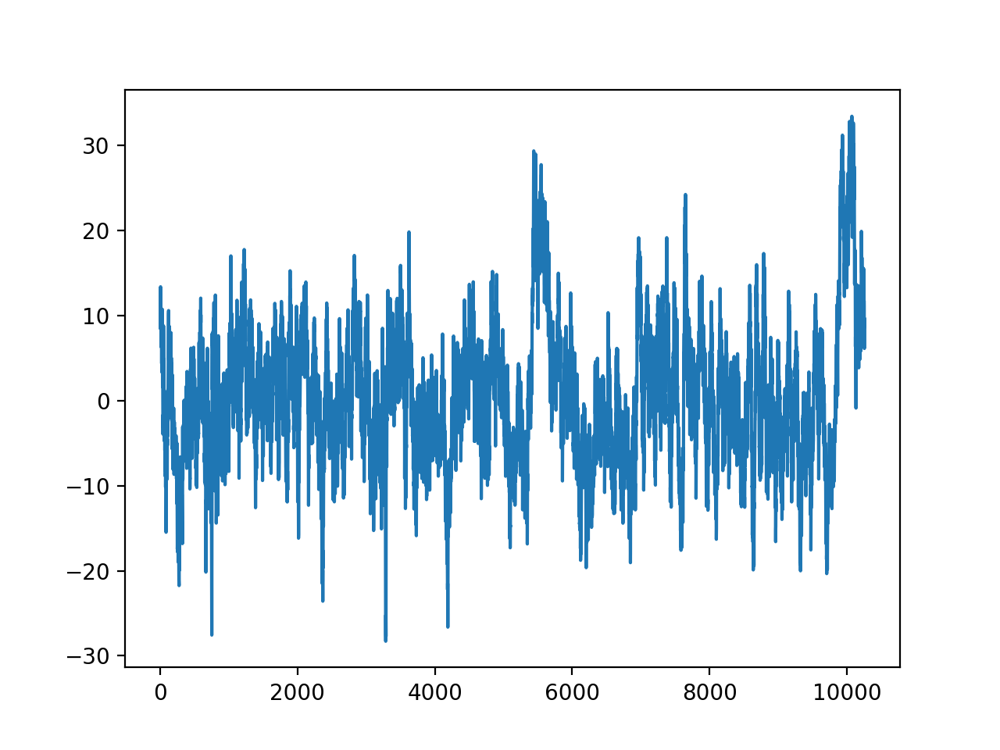

<IPython.core.display.Javascript object>


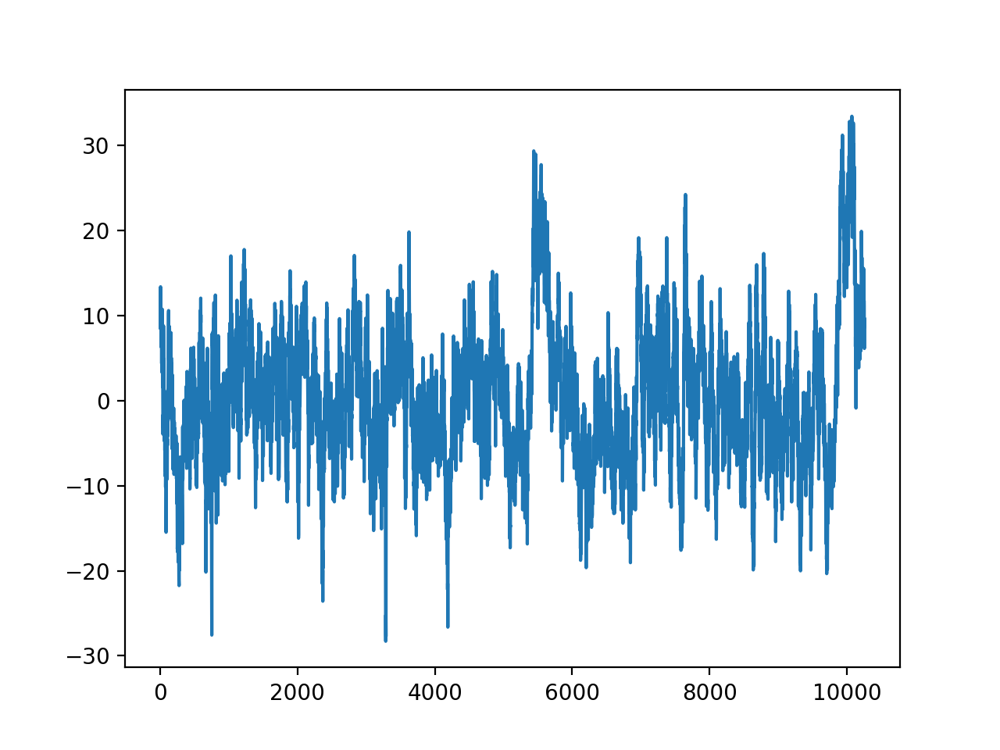

In [101]:
print(d["Target"][1])
print(d["AudioDuration"][1])
print(np.shape(d["EEG"][1]))
plt.figure(1)
plt.plot(d["EEG"][1][1,:])
plt.figure(2)
plt.plot(d["EEG"][1][25,:])

# Helper functions

In [ ]:
 #import pyedflib
import numpy as np
import scipy.io as sio
from scipy.io import wavfile
from scipy import signal
import matplotlib.pyplot as plt
import xlrd as xls
   
def read_bdf_bio_data(fname, EEG_ch_idxs = list(range(32)), EMG_ch_idxs = list(range(32,40)), Trgr_ch_idxs = [40]):
    """ Description:
        This function reads the bdf or edf files of EEG/EMG and returns 
        signal and channel labels in sepaprate variables.
        
        Channel indexes for different signal types are assumed as inputs 
        for future use but, have been assigned with defult vaules for the
        current format.
        
        output:
        sigs are in (#ch x #samples) shape numpy arrays.
        ch labels are lists of strings.
    """
    f = pyedflib.EdfReader(fname)
    n = f.signals_in_file
    ch_labels = f.getSignalLabels()
    sig = np.zeros((n, f.getNSamples()[0]))
    fs = f.getSampleFrequency(0)
    for i in np.arange(n):
        sig[i, :] = f.readSignal(i)
    f._close()
    del f
    
    # separating signals ....
    EEG = sig[EEG_ch_idxs,:]
    EMG = sig[EMG_ch_idxs,:]
    Trgr = np.uint16(sig[Trgr_ch_idxs,:])
    
    # separating  channel labels ....
    EEG_ch_L = [ch_labels[idx] for idx in EEG_ch_idxs]
    EMG_ch_L = [ch_labels[idx] for idx in EMG_ch_idxs]
    Trgr_ch_L = [ch_labels[idx] for idx in Trgr_ch_idxs]
    gain = 1/32 # a fixed value that is predefined for biosemi amplifier (it is already applied on data)
    #####################################################
    return EEG, EMG, Trgr, fs, gain, EEG_ch_L, EMG_ch_L, Trgr_ch_L
##################################################################
##################################################################
##################################################################    
        
def eliminate_drift(X, coeff_path = 'drift_filt_fir_4096_[.5].mat'):
    mat_contents = sio.loadmat(coeff_path)
    b = mat_contents['Num']
    
    # applying FIR filter with correction for phase shift (zero phase) ....
    a = np.ones(1)
    b = np.reshape(b,b.shape[-1])
    Y = signal.filtfilt(b, a, X)
    
    # taking out the mean ....
    Y = Y - np.mean(Y,axis=-1,keepdims=True)
    #####################################################
    return Y
##################################################################
##################################################################
################################################################## 

def eliminate_60Hz (X, fs=2048, Q =30.0):
    f0 = 60.0  # Frequency to be removed from signal (Hz)
    # Design notch filter...
    b, a = signal.iirnotch(f0,Q,fs)
    Y = signal.filtfilt(b, a, X)
    #####################################################
    return Y
##################################################################
##################################################################
################################################################## 

def get_trial_desc(fname, wsh_idx=0):
    # Opening the excel desc workbook and worksheet ...
    desc_wb = xls.open_workbook(fname)
    desc_wsh = desc_wb.sheet_by_index(wsh_idx)
    
    # reading the data into a dictionary of lists ...
    data_table = {desc_wsh.cell(0,c_idx).value:[desc_wsh.cell(r_idx,c_idx).value
            for r_idx in range(1,desc_wsh.nrows)] for c_idx in range(desc_wsh.ncols)}
    
    # closing the workbook ...
    desc_wb.release_resources()
    del desc_wb
    #####################################################
    return data_table
##################################################################
##################################################################
################################################################## 

def segment_bio_signal(EEG, EMG, Trgr, data_table):
    # getting triger edges ......
    trgr_edges = np.int32(Trgr[0,1:]) - np.int32(Trgr[0,:-1])
    trgr_edges = np.insert(trgr_edges,0,0)
    onset_idxs = np.where(trgr_edges!=0)[0]
    
    # getting trigger values ......
    trgr_vals = Trgr[:,onset_idxs]
    trgr_vals = np.reshape(trgr_vals,trgr_vals.shape[-1])
    
    # removing zero valued triggers and onsets .....
    onset_idxs = np.delete(onset_idxs,np.where(trgr_vals==0))
    trgr_vals = np.delete(trgr_vals,np.where(trgr_vals==0))
    
    # froming ordered pairs of trgr values and onsets .....
    onset_mat = np.reshape(onset_idxs,[int(onset_idxs.shape[0]/2),2])
    trgr_mat = np.reshape(trgr_vals,[int(trgr_vals.shape[0]/2),2])
    
    #data_table['EEG']  = [EEG[:,onset_mat[r_idx,0]:onset_mat[r_idx,1]] for r_idx in range(onset_mat.shape[0])]
    #data_table['EMG']  = [EMG[:,onset_mat[r_idx,0]:onset_mat[r_idx,1]] for r_idx in range(onset_mat.shape[0])]
    #data_table['biosemi_trgrs'] = trgr_mat
    trigger_dict = {'trgr_mat':trgr_mat, 'trgr_vals': trgr_mat}
    
    #####################################################
    #return data_table['EEG'], data_table['EMG'], trigger_dict, data_table
##################################################################
##################################################################
################################################################## 
    
def segment_audio_signal(audio, fs, ntrials=288, min_trial_l = 1.5, trigger_fname = 'trigger_struct.mat'):
    # loading the beep tamplates ....
    mat_contents = sio.loadmat(trigger_fname)
    s_tmplate = mat_contents['triggers']['start'][0,0][:,0]
    e_tmplate = mat_contents['triggers']['end'][0,0][:,0]
    data = np.float64(audio[:,0])
    
    """ 
    Detecting the start beeps' onsets....
    
        first a bandpass filter of [350 450]Hz is applied on audio signal to 
        improve SNR for the start beeps (400Hz) and then trigger detection is 
        applied using matched filter and adaptive peak prominence value ... 
    """
    s_onsets = find_audio_trgrs (butter_bandpass_filter(data, 350, 450, fs), s_tmplate, fs, npeaks=ntrials)
    s_onsets -= int(s_tmplate.shape[0]/2)
    
    """ 
    Detecting the end beeps' onsets....
    
        first a bandpass filter of [150 250]Hz is applied on audio signal to 
        improve SNR for the end beeps (200Hz) and then trigger detection is 
        applied using matched filter and adaptive peak prominence value ... 
    """
    e_onsets = find_audio_trgrs (butter_bandpass_filter(data, 150, 250, fs), e_tmplate, fs, npeaks=ntrials)
    e_onsets -= int(e_tmplate.shape[0]/2)
    
    trgr_mat =np.concatenate((np.reshape(s_onsets,[s_onsets.shape[0],1]), np.reshape(e_onsets,[e_onsets.shape[0],1])),axis = -1) 
    
    # checking if the trial lenghts are bigger than min_trial_l ....
    if any((e_onsets-s_onsets)<fs*min_trial_l):
#        raise ValueError('Start and end trigger distances does not seems correct!')
        print('Start and end trigger distances does not seems correct!')
    #####################################################
    return trgr_mat
##################################################################
##################################################################
################################################################## 

def find_audio_trgrs (data, trgr_tmplt, fs, npeaks=288, height = .3, prominence = .9,
                      adaptation_resolution = .05, max_iteration = 1000):
    convolved = signal.fftconvolve(data,trgr_tmplt,'same')
    nfact = running_sum(np.power(data,2),trgr_tmplt.shape[0])
    nfact = np.sqrt(nfact) * np.sqrt(np.sum(np.power(trgr_tmplt,2)))
    n_convolved = np.divide(convolved,nfact)
    
    resolution = adaptation_resolution
    peaks, _ = signal.find_peaks(abs(n_convolved), distance = fs , height=height, prominence=prominence,wlen = int(fs*.3))
    # looping over prominance value until the number of peaks matches the npeaks...
    ct = 0
    was_negative = False
    while len(peaks) != npeaks and ct< max_iteration:
        ct +=1
        if len(peaks)<npeaks:
            if was_negative:
                raise ValueError('Could not find a match at trigger detection!')
            if 'was_bigger' in locals() and was_bigger:
                resolution /= 2
            was_bigger = False
            prominence -= resolution
        else:
            if 'was_bigger' in locals() and not(was_bigger): 
                resolution /= 2
            was_bigger = True
            prominence += resolution
        print(prominence)
        
        was_negative=False
        if prominence<0:
            prominence=0
        
        if prominence<1e-32:
            was_negative = True
        peaks, _ = signal.find_peaks(abs(n_convolved), distance = int(fs*1.5) , height=height, prominence=prominence,wlen = int(fs*.3))
    
    if len(peaks) != npeaks:
        raise ValueError('Could not find a match at trigger detection!')
    #####################################################
    return peaks
##################################################################
##################################################################
##################################################################         
    
def running_sum(x, N):
    if N%2 ==1:
        cumsum = np.cumsum(np.concatenate((np.zeros([int(N/2)+1]),x,np.zeros([int(N/2)])))) 
    else:
        cumsum = np.cumsum(np.concatenate((np.zeros([int(N/2)]),x,np.zeros([int(N/2)])))) 
    #####################################################
    return (cumsum[N:] - cumsum[:-N])
##################################################################
##################################################################
##################################################################    
    
def eliminate_high_freq(X, coeff_path = 'audio_lfilter.mat'):
    mat_contents = sio.loadmat(coeff_path)
    b = mat_contents['Num']
    
    # applying FIR filter with correction for phase shift (zero phase) ....
    a = np.ones(1)
    b = np.reshape(b,b.shape[-1])
    Y = signal.filtfilt(b, a, X)
    #####################################################
    return Y
##################################################################
##################################################################
##################################################################
    


def butter_bandpass_filter(data, lowcut, highcut, fs, order=4):
    b, a = signal.butter(order, [lowcut/fs, highcut/fs], btype='band')
    y = signal.filtfilt(b, a, data)
    return y
    
        


#  Confusion matrix, PMF, accuracy

## Function definitions

In [83]:
import os
import re
import numpy as np
import math
import scipy.io as sio
from scipy.io import wavfile
from scipy import signal
import xlrd as xls
from sklearn.metrics import confusion_matrix
import itertools
import matplotlib.pyplot as plt
from sklearn import svm, datasets
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from matplotlib import lines
from collections import namedtuple
from matplotlib.legend import Legend
import math


def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    #plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    #if (not normalize):
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
            #if (cm[i,j] != 0):
                plt.text(j, i, format(cm[i, j], fmt),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()


def get_conf_data(data, ignore_first = True): 
    interested_index = 1 if ignore_first else 0
    leng = int(math.sqrt(len(data)))
    seg_data = []
    for i in range(leng):
        seg_data.append(sorted(data[i*leng:(i+1)*leng],key=lambda tup: tup[6]))
    labels = sorted(list({(v[4]) for v in seg_data[0]}))
    lab2ind = {v:i for i,v in enumerate(labels)}
    #print(lab2ind)
    true_labels = [lab2ind[v[interested_index][1]]  for v in seg_data]
    pred_labels = [lab2ind[v[interested_index][4]]  for v in seg_data]
    
    acc_count = np.sum(np.array(true_labels) == np.array(pred_labels))
    acc = acc_count / float(leng)
    
    #true_plus_loudness = [(v[interested_index][1],v[interested_index][0])  for v in seg_data]
    #pred_plus_loudness = [(v[interested_index][4],v[interested_index][3])  for v in seg_data]
    #for i in range(len(a)):
    #    if (a[i][0] == b[i][0]):
    #        print(a[i],b[i])
    return seg_data, acc, true_labels, pred_labels,labels

def plot_conf(title, true_labels, pred_labels, labels, save_suf,no_dot_fname, save_figs):
    plt.figure(figsize=(10,10))
    plot_confusion_matrix(confusion_matrix(true_labels, pred_labels), classes=labels,title=title )
    if (save_figs):
        plt.savefig(os.path.join(save_dir, 'cm_' + no_dot_fname + save_suf))

def plot_line_pmf(seg_data, name, downsample, ignore_first = True):
    correct_index = -1 if ignore_first else 0
    counts = np.zeros(len(seg_data[0]) + correct_index)
    orig_counts = np.zeros(len(seg_data[0]) + correct_index)
    for example in seg_data:
        label = example[0][1]
        for index, output in enumerate(example):
            if (ignore_first and index == 0):
                # always closets to itself
                continue
            if (output[4] == label):
                orig_counts[(index + correct_index)] +=1
                counts[(index + correct_index)/downsample] +=1

    #print(orig_counts[0])
    #print(orig_counts[0] / np.sum(orig_counts))
    samples_count = np.sum(orig_counts)
    counts = counts[:int(math.ceil(len(counts)/float(downsample)))]
    pdf = counts / float(samples_count)
    
    #print(counts)
    #print(sum(counts))
    #print(len(seg_data[0]))

    exp_ind = np.dot(np.arange(len(orig_counts)),orig_counts) / float(samples_count) * 100 / len(orig_counts-1)
    #print(exp_ind) 
    ax = plt.gca()
    col = plt.plot(np.arange(len(pdf))/float(len(pdf)-1)*100, pdf)[0].get_color()
    col = plt.scatter(np.arange(len(pdf))/float(len(pdf)-1)*100, pdf, label=name).get_facecolors()[0].tolist()
    #col = plt.plot(np.arange(len(pdf))/float(len(pdf)-1)*100, pdf, label=name)[0].get_color()
    #col = plt.scatter(np.arange(len(pdf))/float(len(pdf)-1)*100, pdf).get_facecolors()[0].tolist()
    plt.axvline(x=exp_ind,linewidth=2,color=col)
    plt.xlim(0, 100)
    
    plt.xlabel("Index position [%]")
    plt.ylabel("Probability []")
    vertical_line = lines.Line2D([], [], marker='|', color="black", linestyle='None',
                          markersize=13, markeredgewidth=1.5, label='Mean position')
    handles, _ = ax.get_legend_handles_labels()  
    plt.legend(handles = handles + [vertical_line],numpoints=3,loc="best")
    plt.tight_layout()
    return exp_ind

def read_interpret_dtw_output(fname,show_cm,save_figs, ignore_first = True):
    with open(os.path.join(input_dir,fname), "r") as f_lines:   
        #div = [re.findall(r'^(.)_(.*?)_(\d+) vs. (.)_(.*?)_(\d+) = (.*)', line)[0] for line in lines]
        div = [re.findall(r'^(.) (.*?) (\d+) (.) (.*?) (\d+) (.*)', line)[0] for line in f_lines]
        #if (fname[-4:] == "sort"):
        div.sort()
        #print(div)

    data = [(a,b,int(c),d,e,int(f),float(g)) for a,b,c,d,e,f,g in div]  
    data_s = [(a,b,int(c),d,e,int(f),float(g)) for a,b,c,d,e,f,g in div if a == "S" and d == "S"]  
    data_l = [(a,b,int(c),d,e,int(f),float(g)) for a,b,c,d,e,f,g in div if a == "L" and d == "L"]  


    seg_data_all_all, all_all_acc,true_labels, pred_labels,labels = get_conf_data(data, ignore_first = ignore_first)
    seg_data_sil_sil, sil_sil_acc,true_labels_s,pred_labels_s,_ = get_conf_data(data_s, ignore_first = ignore_first)
    seg_data_lou_lou, lou_lou_acc, true_labels_l, pred_labels_l,_ = get_conf_data(data_l, ignore_first = ignore_first)


    dat_l = int(math.sqrt(len(data)))
    half_dat_l = dat_l/2
    lou_all_acc = np.sum((np.array(true_labels) == np.array(pred_labels))[:half_dat_l]) / float(half_dat_l)
    sil_all_acc = np.sum((np.array(true_labels) == np.array(pred_labels))[half_dat_l:]) / float(half_dat_l)
    seg_data_lou_all = seg_data_all_all[:half_dat_l]
    seg_data_sil_all = seg_data_all_all[half_dat_l:]

    chance_level = 1/float(len(labels))

    end_str = ", chance level: " + str(chance_level)
    print(str(all_all_acc) + " ALL TO ALL acc "+ end_str)
    print(str(lou_all_acc) + " LOUD TO ALL acc " + end_str)
    print(str(sil_all_acc) + " SILENT TO ALL acc " + end_str)
    print(str(lou_lou_acc) + " LOUD TO LOUD acc: " + end_str)
    print(str(sil_sil_acc) + " SILENT TO SILENT acc: " + end_str)
    #print(true_labels)
    #print(pred_labels)

    #for i in seg_data_s:
    #    for j in i:
    #        print (j)


    no_dot_fname = re.findall(r'^([^\.]*)', fname)[0]

    if show_cm:
        plot_conf('ALL TO ALL CM', true_labels, pred_labels, labels, "_ALL_ALL",no_dot_fname, save_figs)
        plot_conf('LOUD TO ALL CM',true_labels[:half_dat_l],pred_labels[:half_dat_l], labels, "_LOU_ALL",no_dot_fname, save_figs)
        plot_conf('SILENT TO ALL CM',true_labels[half_dat_l:],pred_labels[half_dat_l:],labels,"_SIL_ALL",no_dot_fname, save_figs)
        plot_conf('LOUD TO LOUD CM',true_labels_l, pred_labels_l,labels,"_LOU_LOU",no_dot_fname, save_figs)
        plot_conf('SILENT TO SILENT CM', true_labels_s, pred_labels_s, labels, "_SIL_SIL",no_dot_fname, save_figs)

    plt_name = "PMF - 1 bin = " + str(downsample_prob_acc) + " indices (" + no_dot_fname[2:] + ")"
    plt.figure(plt_name, figsize =(8,5))
    plt.title(plt_name)
    means = []
    means.append(plot_line_pmf(seg_data_all_all, "ALL to ALL",       downsample_prob_acc * 2, ignore_first = ignore_first))
    means.append(plot_line_pmf(seg_data_lou_all, "LOUD to ALL",      downsample_prob_acc * 2, ignore_first = ignore_first))
    means.append(plot_line_pmf(seg_data_sil_all, "SILENT to ALL",    downsample_prob_acc * 2, ignore_first = ignore_first))
    means.append(plot_line_pmf(seg_data_lou_lou, "LOUD to LOUD",     downsample_prob_acc, ignore_first = ignore_first))
    means.append(plot_line_pmf(seg_data_sil_sil, "SILENT to SILENT", downsample_prob_acc, ignore_first = ignore_first))
    if (save_figs):
        plt.savefig(os.path.join(save_dir, 'prob_' + no_dot_fname + "_" + str(downsample_prob_acc) + "_stacked"))
    return [all_all_acc, lou_all_acc, sil_all_acc, lou_lou_acc, sil_sil_acc], means,chance_level

def show_accuracies(accuracies, file_names, chance_lvls, save_figs, save_name, figsize, labels):
    fig, ax = plt.subplots(figsize = figsize)
    indices = np.arange(len(file_names))
    bar_width = 0.15

    for i in range(len(labels)):
        ax.bar(indices + i * bar_width, tuple(100 * accuracies[:,i]), bar_width, label=labels[i])
    seg_len = 1 / float(len(file_names))
    for i in range(len(file_names)):    
        plt.axhline(y=100 * chance_lvls[i], xmin = seg_len * i, xmax= seg_len * (i+1),linewidth=1.2,color="black")

    ax.set_ylabel('Accuracy [%]')
    #ax.set_title('Accuracies')
    ax.set_ylim(0, 1.5 * 100 * accuracies.ravel().max())

    plt.xticks(indices + (len(labels)-1) * bar_width / 2.0, tuple(file_names), rotation=0)

    vertical_line = lines.Line2D([], [], marker='_', color="black", linestyle='None', markersize=16, markeredgewidth=2.5, label='Chance level')
    handles, _ = ax.get_legend_handles_labels()  
    #plt.legend(handles = handles + [vertical_line],numpoints=1,loc="best",frameon=False)
    ax.legend(handles = handles[:3], loc='upper left', frameon=False)
    leg = Legend(ax, handles[3:] + [vertical_line], labels[3:] + ['Chance level'], loc='upper right', frameon=False)
    ax.add_artist(leg);
    fig.tight_layout()
    if (save_figs):
        plt.savefig(os.path.join(save_dir, save_name))
    
def show_means(means, file_names, save_figs, save_name, figsize, labels):
    fig, ax = plt.subplots(figsize = figsize)
    indices = np.arange(len(file_names))
    bar_width = 0.15

    for i in range(len(labels)):
        ax.bar(indices + i * bar_width, tuple(means[:,i]), bar_width, label=labels[i])
    seg_len = 1 / float(len(file_names)) 
    plt.axhline(y=50, linewidth=1.2,color="black")

    ax.set_ylabel('Index [%]')
    ax.set_title('Mean indices')
    ax.set_ylim(0, 100)

    plt.xticks(indices + (len(labels)-1) * bar_width / 2.0, tuple(file_names), rotation=0)

    vertical_line = lines.Line2D([], [], marker='_', color="black", linestyle='None', markersize=16, markeredgewidth=2.5, label='Chance level')
    handles, _ = ax.get_legend_handles_labels()  
    #plt.legend(handles = handles + [vertical_line],numpoints=1,loc="best",frameon=False)
    ax.legend(handles = handles[:3], loc='upper left', frameon=False)
    leg = Legend(ax, handles[3:] + [vertical_line], labels[3:] + ['Chance level'], loc='upper right', frameon=False)
    ax.add_artist(leg);
    fig.tight_layout()
    if (save_figs):
        plt.savefig(os.path.join(save_dir, save_name))
        
        
def is_same_session(fname):
    # Same sessions?    
    res = re.findall(r'^(dtw)?\d?.*?S(\d).*?S(\d)', fname)[0]
    #print(res)
    return int(res[1]) == int(res[2])
    

['1_S1vsS1_tr-S1_EMG.out_sort', '1_S3vsS3_tr-S1_EMG.out_sort', '1_S3vsS4_tr-S1_EMG.out_sort', '1_S4vsS4_tr-S1_EMG.out_sort', '2_S3vsS3_tr-S4_EMG.out_sort', '2_S4vsS4_tr-S3_EMG_globCMN.out_sort', '2_S4vsS4_tr-S3_EMG_segCMN.out_sort', '3_S4vsS4_tr-S13_EMGEEG.out_sort', '3_S4vsS4_tr-S1_EMGEEG.out_sort']
0.12121212121212122 ALL TO ALL acc , chance level: 0.0714285714286
0.15151515151515152 LOUD TO ALL acc , chance level: 0.0714285714286
0.09090909090909091 SILENT TO ALL acc , chance level: 0.0714285714286
0.12121212121212122 LOUD TO LOUD acc: , chance level: 0.0714285714286
0.06060606060606061 SILENT TO SILENT acc: , chance level: 0.0714285714286


<IPython.core.display.Javascript object>


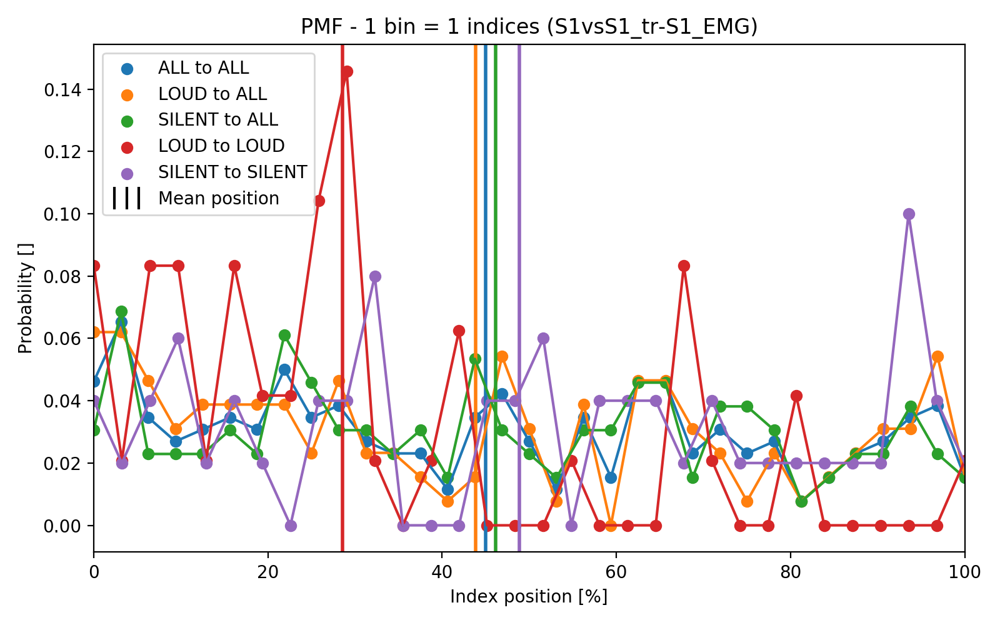

0.15 ALL TO ALL acc , chance level: 0.0666666666667
0.075 LOUD TO ALL acc , chance level: 0.0666666666667
0.225 SILENT TO ALL acc , chance level: 0.0666666666667
0.125 LOUD TO LOUD acc: , chance level: 0.0666666666667
0.05 SILENT TO SILENT acc: , chance level: 0.0666666666667


<IPython.core.display.Javascript object>


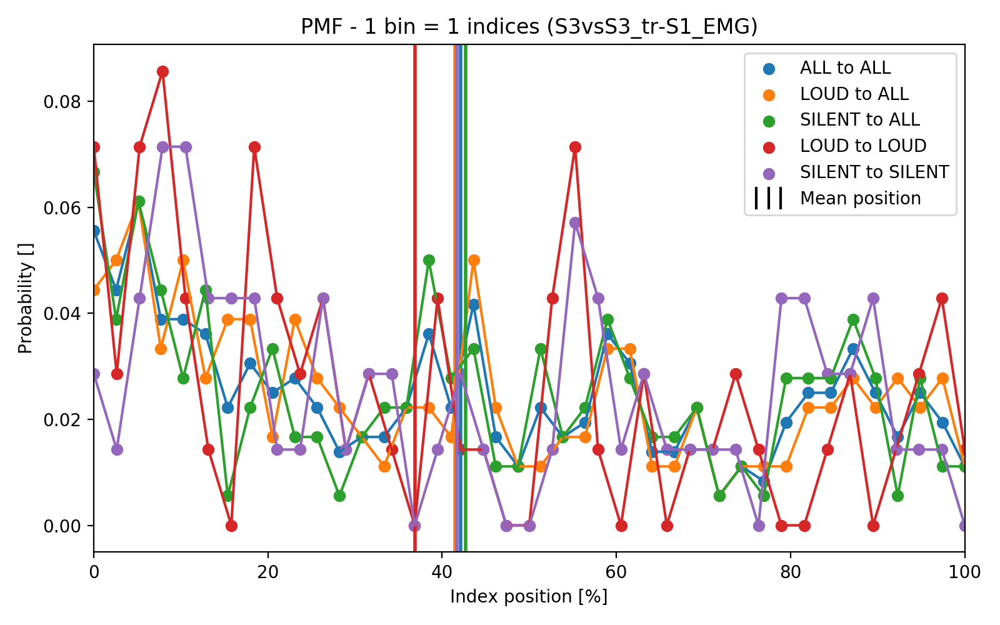

0.2125 ALL TO ALL acc , chance level: 0.0666666666667
0.175 LOUD TO ALL acc , chance level: 0.0666666666667
0.25 SILENT TO ALL acc , chance level: 0.0666666666667
0.125 LOUD TO LOUD acc: , chance level: 0.0666666666667
0.175 SILENT TO SILENT acc: , chance level: 0.0666666666667


<IPython.core.display.Javascript object>


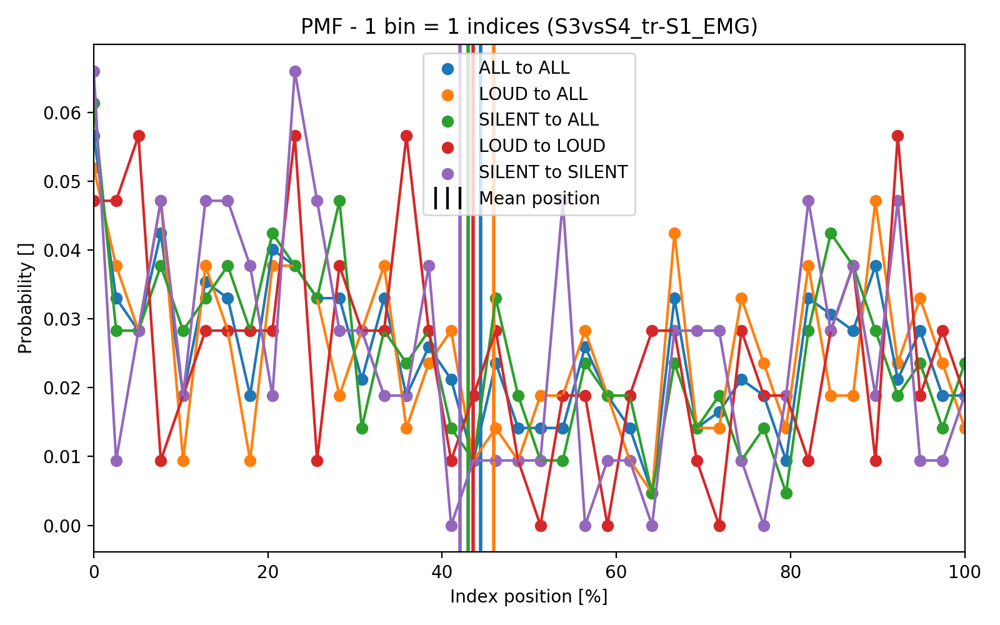

0.1 ALL TO ALL acc , chance level: 0.0666666666667
0.1 LOUD TO ALL acc , chance level: 0.0666666666667
0.1 SILENT TO ALL acc , chance level: 0.0666666666667
0.1 LOUD TO LOUD acc: , chance level: 0.0666666666667
0.05 SILENT TO SILENT acc: , chance level: 0.0666666666667


<IPython.core.display.Javascript object>


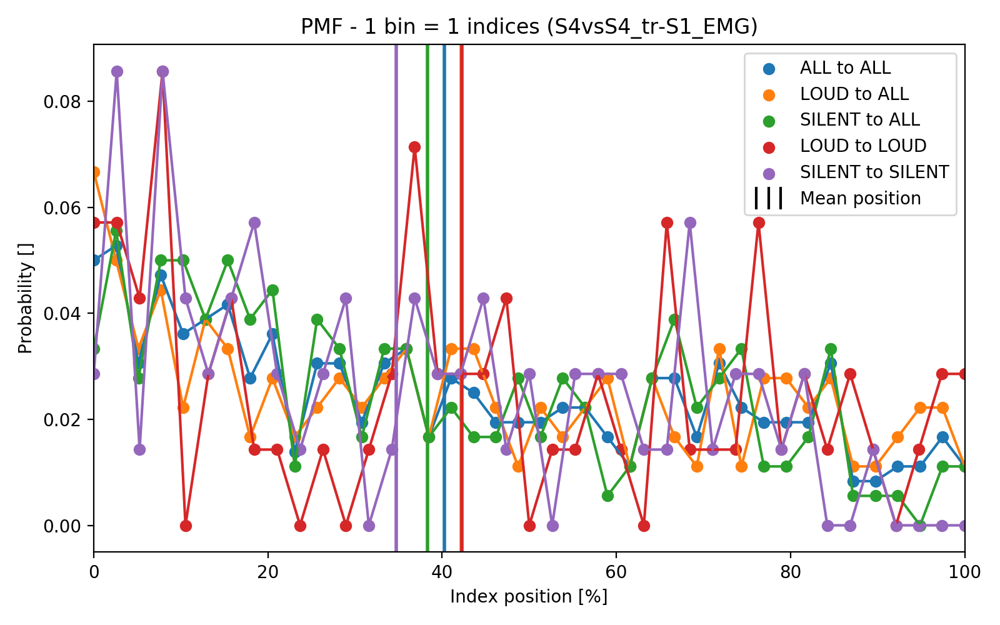

0.0875 ALL TO ALL acc , chance level: 0.0666666666667
0.075 LOUD TO ALL acc , chance level: 0.0666666666667
0.1 SILENT TO ALL acc , chance level: 0.0666666666667
0.15 LOUD TO LOUD acc: , chance level: 0.0666666666667
0.05 SILENT TO SILENT acc: , chance level: 0.0666666666667


<IPython.core.display.Javascript object>


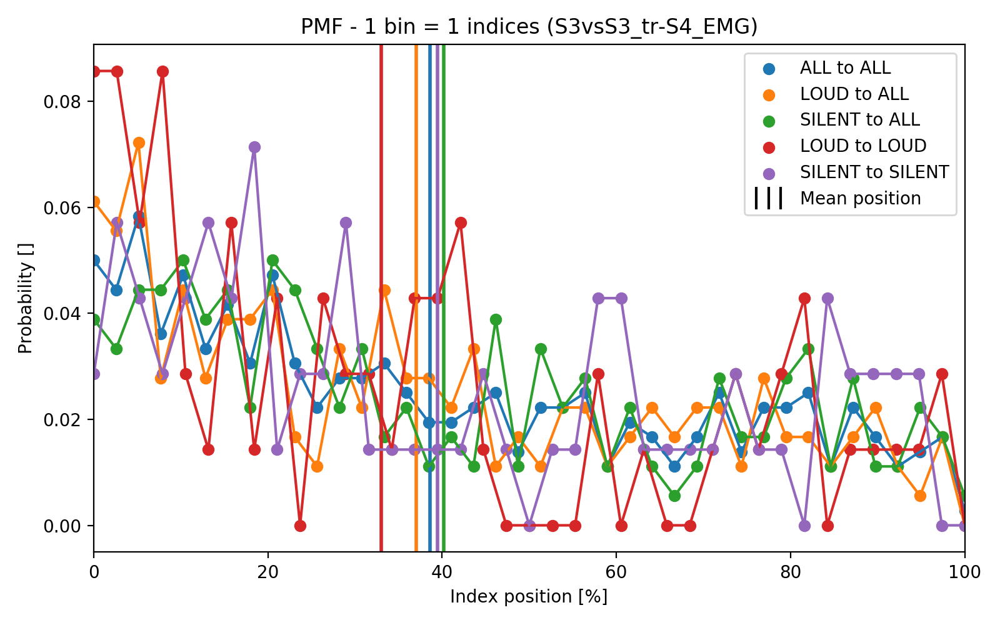

0.2125 ALL TO ALL acc , chance level: 0.0666666666667
0.225 LOUD TO ALL acc , chance level: 0.0666666666667
0.2 SILENT TO ALL acc , chance level: 0.0666666666667
0.05 LOUD TO LOUD acc: , chance level: 0.0666666666667
0.175 SILENT TO SILENT acc: , chance level: 0.0666666666667


<IPython.core.display.Javascript object>


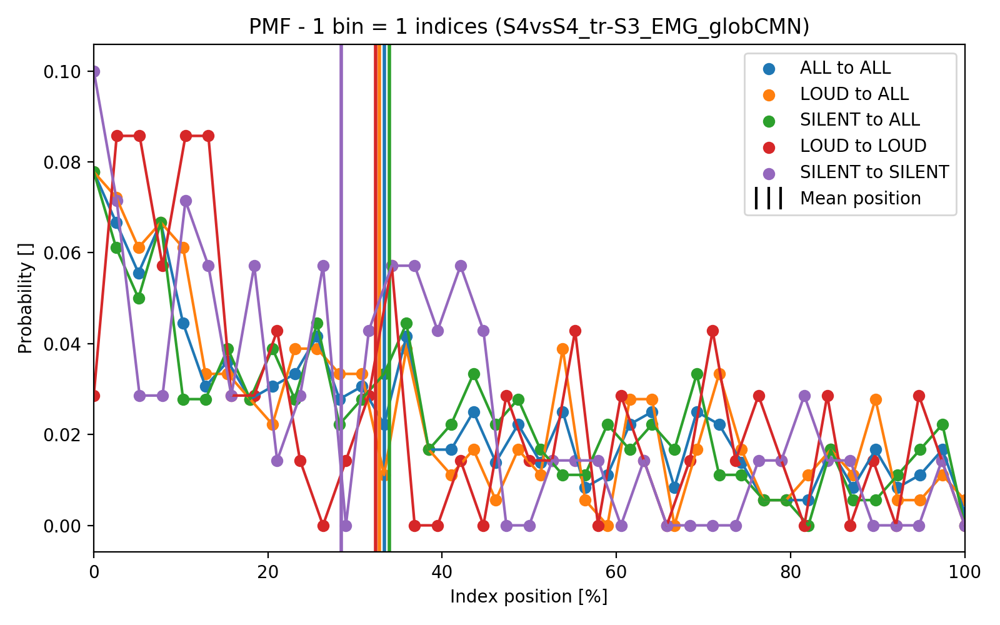

0.1875 ALL TO ALL acc , chance level: 0.0666666666667
0.175 LOUD TO ALL acc , chance level: 0.0666666666667
0.2 SILENT TO ALL acc , chance level: 0.0666666666667
0.125 LOUD TO LOUD acc: , chance level: 0.0666666666667
0.175 SILENT TO SILENT acc: , chance level: 0.0666666666667


<IPython.core.display.Javascript object>


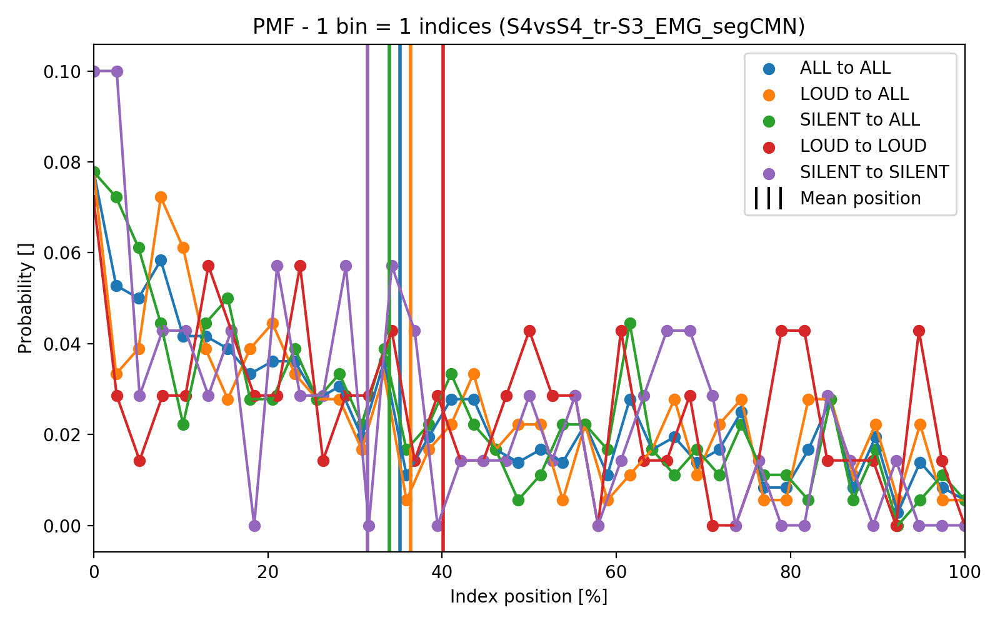

0.0875 ALL TO ALL acc , chance level: 0.0666666666667
0.15 LOUD TO ALL acc , chance level: 0.0666666666667
0.025 SILENT TO ALL acc , chance level: 0.0666666666667
0.225 LOUD TO LOUD acc: , chance level: 0.0666666666667
0.0 SILENT TO SILENT acc: , chance level: 0.0666666666667


<IPython.core.display.Javascript object>


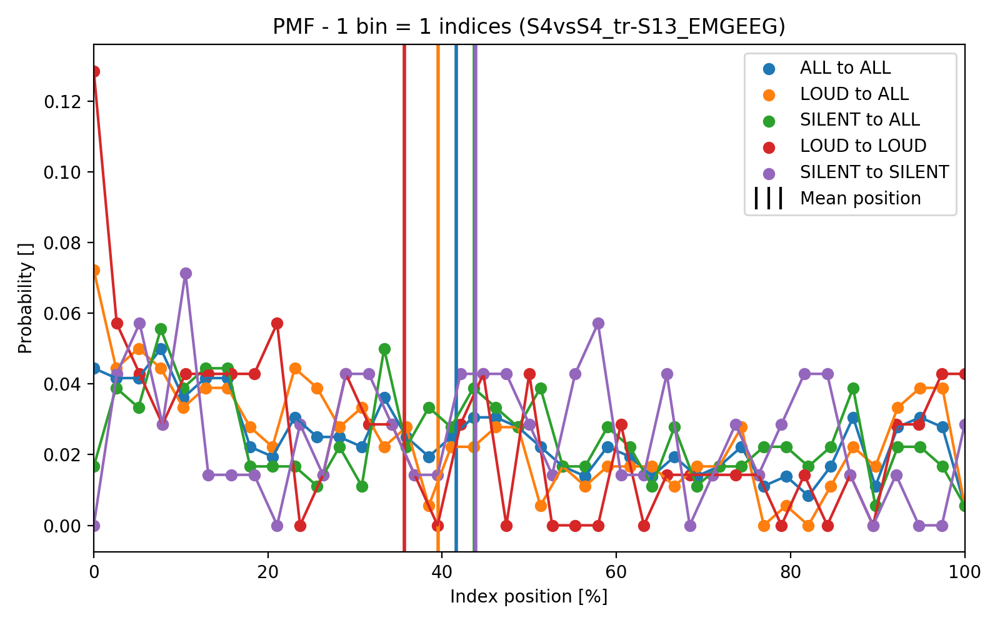

0.075 ALL TO ALL acc , chance level: 0.0666666666667
0.075 LOUD TO ALL acc , chance level: 0.0666666666667
0.075 SILENT TO ALL acc , chance level: 0.0666666666667
0.05 LOUD TO LOUD acc: , chance level: 0.0666666666667
0.075 SILENT TO SILENT acc: , chance level: 0.0666666666667


<IPython.core.display.Javascript object>


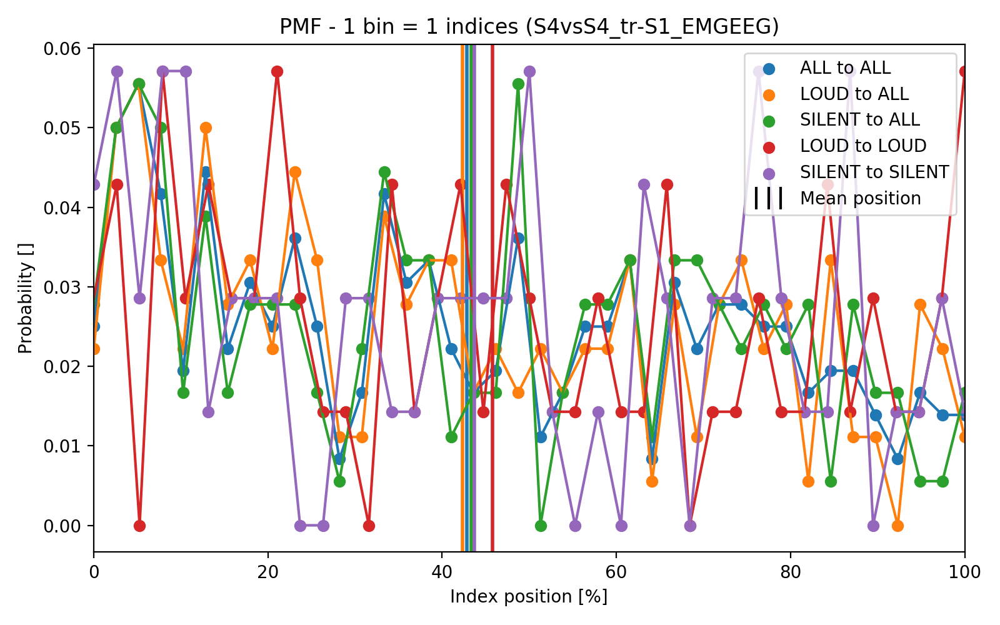

['S1vsS1\ntr-S1\nEMG', 'S3vsS3\ntr-S1\nEMG', 'S3vsS4\ntr-S1\nEMG', 'S4vsS4\ntr-S1\nEMG', 'S3vsS3\ntr-S4\nEMG', 'S4vsS4\ntr-S3\nEMG\nglobCMN', 'S4vsS4\ntr-S3\nEMG\nsegCMN', 'S4vsS4\ntr-S13\nEMGEEG', 'S4vsS4\ntr-S1\nEMGEEG']


<IPython.core.display.Javascript object>


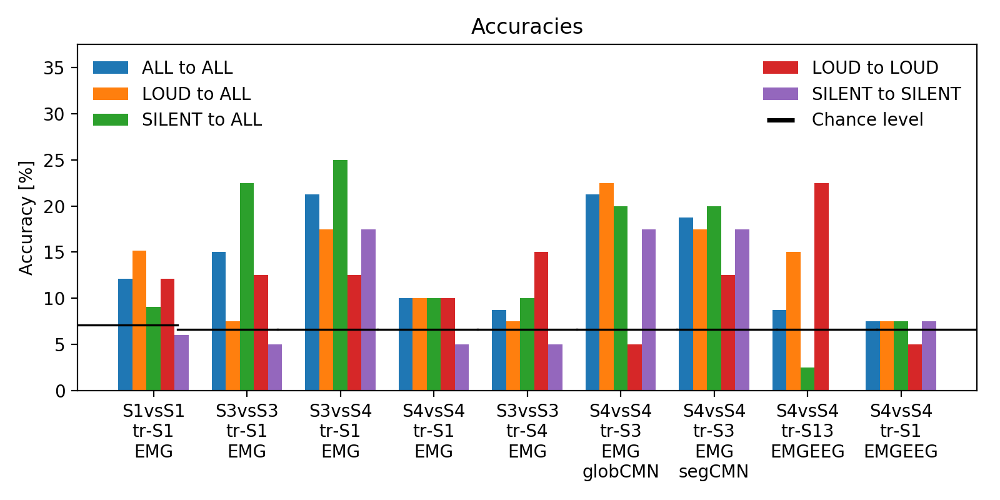

<IPython.core.display.Javascript object>


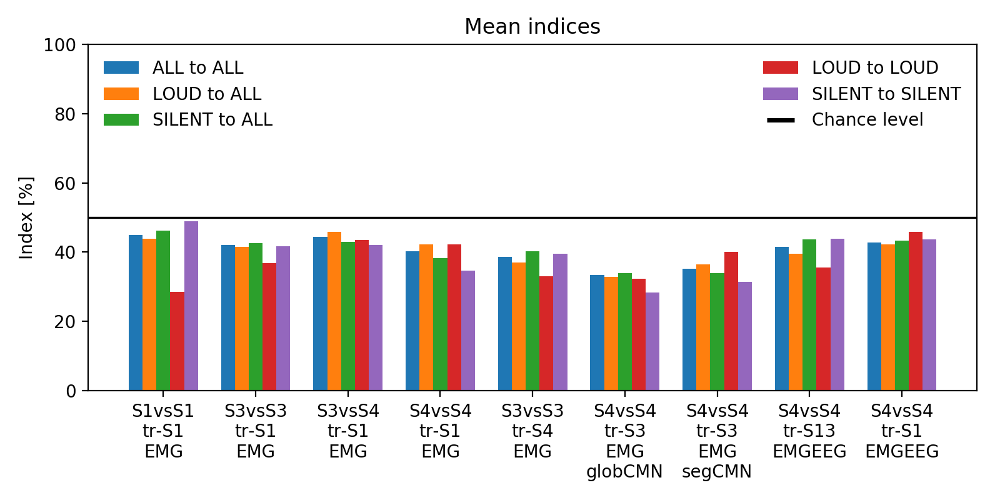

In [405]:
import os
import time
downsample_prob_acc = 1
show_cm = False
#show_cm = True
input_dir = "silent_data/dtw_out_detail"
#input_dir = "silent_data/dtw_out_manag"
#input_dir = "."
save_dir = "silent_data/visual"
save_figs = False # if want to save, dont forget to: 
#VISUALIZE = True
#fname = "dtw_bn_s1.out_no_cmncvn"
#fname = "dtw_S3vsS4_bn_s1_cmncvn.out"
fname = "dtw_bn_s1_cmncvn.out"
fname = "dtw_S4vsS4_GlobCMN_bn_s3_100x15_cmncvn.out"
fname = "dtw_S1vsS1_bn_s1_cmncvn.out_sort"
fname = "1_S3vsS4_tr-S1_EMG.out_sort"


if VISUALIZE:
    #read_interpret_dtw_output(fname,show_cm,False, ignore_first = is_same_session(fname))
    if True:
    #if False:
        file_names = sorted(os.listdir(input_dir))
        print(file_names)
        accuracies = []
        means = []
        chance_lvls = []
        for fname in file_names:                   
            a,m,c = read_interpret_dtw_output(fname,show_cm,save_figs, ignore_first = is_same_session(fname))
            accuracies.append(a)
            means.append(m)
            chance_lvls.append(c)

        accuracies = np.array(accuracies)
        means = np.array(means)
        chance_lvls = np.array(chance_lvls)
        #file_names = [re.sub('_',  '\n', re.findall(r'^([^\.]*)', fname)[0][4:-7]) for fname in file_names]
        file_names = [re.sub('_',  '\n', re.findall(r'^([^\.]*)', fname)[0][2:]) for fname in file_names]
        print(file_names)
        #print(accuracies)
        #print(file_names)
            
        minute = str(int(time.time() / 60))
        
        # DETAIL:
        if (input_dir == "silent_data/dtw_out_detail"):
            figsize = (8,4)
            labels = ["ALL to ALL", "LOUD to ALL", "SILENT to ALL", "LOUD to LOUD", "SILENT to SILENT"]
            show_accuracies(accuracies, file_names, chance_lvls, save_figs, 'accuracies_' + "detail" +  minute, figsize, labels)
            show_means(means, file_names, save_figs, 'means_'  + "detail" + minute, figsize, labels)

        if (input_dir == "silent_data/dtw_out_manag"):
            figsize = (4,4)
            labels = ["ALL to ALL", "LOUD to LOUD", "SILENT to SILENT"]
            means = np.delete(means,(1,2),axis=1)
            accuracies = np.delete(accuracies,(1,2),axis=1)
            chance_lvls = np.delete(chance_lvls,(1,2),axis=1)
            show_accuracies(accuracies, file_names, chance_lvls, save_figs, 'accuracies_' + "manag" +  minute, figsize, labels)
            show_means(means, file_names, save_figs, 'means_'  + "manag" + minute, figsize, labels)

    

<IPython.core.display.Javascript object>


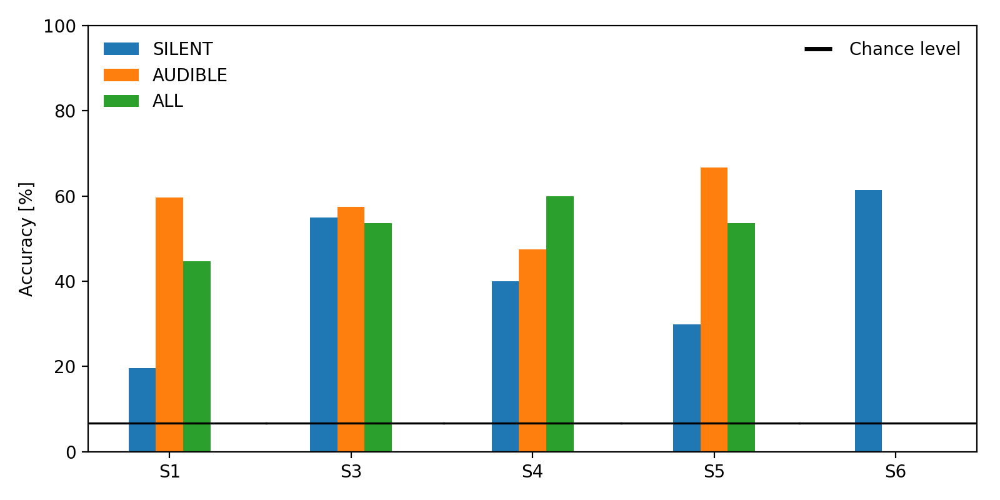

In [85]:
# For the paper

a = np.array([[0.196 , 0.550 , 0.400 , 0.298 , 0.614],
[0.596 , 0.575 , 0.475 , 0.667 , 0],
[0.447 , 0.537 , 0.600 , 0.537 , 0]]).T

show_accuracies(a, ["S1","S3","S4","S5","S6"], [0.067,0.067,0.067,0.067,0.067,0.067,0.067,0.067], False, 'accuracies_' + "manag", (8,4), ["SILENT", "AUDIBLE", "ALL"])



In [54]:
# Erase output after import
from IPython.display import clear_output
clear_output()





In [55]:
framerate = 44100
t = np.linspace(0,5,framerate*5)
data = np.sin(2*np.pi*220*t) + np.sin(2*np.pi*224*t)


In [67]:
from IPython.display import Audio
Audio(data,rate=framerate,autoplay=True)
print(data.shape)

(220500,)


In [64]:
#get_ipython().magic(u'matplotlib inline')
%matplotlib notebook

In [554]:
from platform import python_version
print(python_version())

3.6.8


StopIteration: 

In [1]:
import numpy as np
a = np.array([[1,2,3],[8,8,8],[3,9,0]])
np.sum(a, axis = 0)

array([12, 19, 11])

# Train vs Test divison:

In [9]:
# From spectral

#cut_st = 25
#cut_en = 125
#TRN_aud_mb, TRN_emg_mb, TRN_emg_spect, TRN_emg_spect_log = [np.concatenate([example[cut_st:cut_en] for example in x]) for x in get_dataset(fil_ind[test_example_count:])]
#TST_aud_mb, TST_emg_mb, TST_emg_spect, TST_emg_spect_log = [np.concatenate([example[cut_st:cut_en] for example in x]) for x in get_dataset(fil_ind[:test_example_count])]


In [69]:


data_table, SEG_EEG, SEG_EMG, SEG_AUD, BIO_fs, AUD_fs, EEG_L, EMG_L, data_len, stim_type, target, prompt, id2tar, tar2id = load_seg_data(7, True, True, True, False)



test_ex_per_class = 2


test_ids  = [val for keys,vals in tar2id.items() for val in vals[:test_ex_per_class]]
train_ids = [val for keys,vals in tar2id.items() for val in vals[test_ex_per_class:]]

print(test_ids)
print(train_ids)

#if False:
if True:
    print(stim_type)
    print(target)
    print(prompt)

    print(id2tar)
    print(tar2id)

    print(test_ids)
    print(train_ids)
    #print([id2tar[test_id] for test_id in test_ids])
    #print([id2tar[train_id] for train_id in train_ids])

st = 500
end = 4000


#EMG_signal_clipping = True
EMG_signal_clipping = False

EMG_signal_max = 6000
EMG_signal_min = -6000

if EMG_signal_clipping:    
    SEG_EMG = [np.clip(recording,EMG_signal_min,EMG_signal_max) for recording in SEG_EMG]

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 30, 31]
[48, 49, 79, 80, 103, 104, 149, 150, 159, 160, 198, 199, 36, 37, 52, 53, 107, 108, 139, 140, 173, 174, 187, 188, 33, 77, 78, 97, 98, 161, 162, 163, 164, 189, 190, 208, 209, 40, 41, 72, 73, 105, 106, 131, 132, 151, 152, 169, 170, 46, 47, 89, 90, 115, 116, 129, 130, 147, 148, 202, 203, 62, 63, 66, 67, 111, 112, 135, 136, 185, 186, 191, 192, 38, 39, 56, 57, 109, 110, 117, 118, 175, 176, 193, 194, 58, 59, 64, 65, 99, 100, 133, 134, 145, 146, 204, 205, 50, 51, 68, 69, 93, 94, 137, 138, 171, 172, 177, 178, 42, 43, 85, 86, 87, 88, 127, 128, 157, 158, 181, 182, 32, 74, 113, 114, 119, 120, 153, 154, 165, 166, 195, 196, 34, 35, 75, 76, 83, 84, 125, 126, 141, 142, 200, 201, 28, 29, 81, 82, 91, 92, 121, 122, 167, 168, 179, 180, 197, 44, 45, 60, 61, 95, 96, 123, 124, 183, 184, 206, 207, 54, 55, 70, 71, 101, 102, 143, 144, 155, 156]
['silent' 'silent' 'silent' 'silent' 'silent' 'silent' 'si

In [11]:
tar_id2tar_name = dict(enumerate(tar2id.keys()))
tar_name2tar_id = {v: k for k, v in tar_id2tar_name.items()}

id2tar_id = {k: tar_name2tar_id[id2tar[k]] for k in id2tar}
tar_id2id = {tar_name2tar_id[k]:v for k,v in tar2id.items()}

print(tar_id2tar_name)
print(tar_name2tar_id)

print(id2tar_id)
print(tar_id2id)
print(tar2id)

{0: 'eight', 1: 'divide', 2: 'five', 3: 'multiply', 4: 'two', 5: 'four', 6: 'seven', 7: 'six', 8: 'three', 9: 'nine', 10: 'add', 11: 'one', 12: 'subtract', 13: 'zero', 14: 'percent'}
{'eight': 0, 'divide': 1, 'five': 2, 'multiply': 3, 'two': 4, 'four': 5, 'seven': 6, 'six': 7, 'three': 8, 'nine': 9, 'add': 10, 'one': 11, 'subtract': 12, 'zero': 13, 'percent': 14}
{0: 0, 1: 0, 2: 1, 3: 1, 4: 2, 5: 2, 6: 3, 7: 3, 8: 4, 9: 4, 10: 5, 11: 5, 12: 6, 13: 6, 14: 7, 15: 7, 16: 8, 17: 8, 18: 9, 19: 9, 20: 10, 21: 10, 22: 11, 23: 11, 24: 12, 25: 12, 26: 13, 27: 13, 28: 12, 29: 12, 30: 14, 31: 14, 32: 10, 33: 2, 34: 11, 35: 11, 36: 1, 37: 1, 38: 6, 39: 6, 40: 3, 41: 3, 42: 9, 43: 9, 44: 13, 45: 13, 46: 4, 47: 4, 48: 0, 49: 0, 50: 8, 51: 8, 52: 1, 53: 1, 54: 14, 55: 14, 56: 6, 57: 6, 58: 7, 59: 7, 60: 13, 61: 13, 62: 5, 63: 5, 64: 7, 65: 7, 66: 5, 67: 5, 68: 8, 69: 8, 70: 14, 71: 14, 72: 3, 73: 3, 74: 10, 75: 11, 76: 11, 77: 2, 78: 2, 79: 0, 80: 0, 81: 12, 82: 12, 83: 11, 84: 11, 85: 9, 86: 9, 87: 

In [12]:

#name = "H"
#plt.figure(name)
#plt.title(name)
#end_ind = []
#ar_cou, ar_val, _ = plt.hist([v for v in max_v[:,2] if v > -10000 and v < 10000])
#plt.legend()
#plt.xlabel("micro Volts")

In [13]:
#print(np.min([rec.shape[1] for rec in SEG_EMG]))

In [14]:
#[rec.shape for rec in SEG_EMG]
#8233
ind = 4


MAX_VAL = 10000

print(len(SEG_EMG[:10]))

print([a[:3,:-8200] for a in SEG_EMG[:5]])

print([a.shape for a in [a[:3,:-8200] for a in SEG_EMG[:5]]])

def max_min_energy(cls):
    min_v, max_v, energy = [],[],[]    
    for i in tar2id[cls]:
        min_v.append(np.min(SEG_EMG[i], axis = 1))
        max_v.append(np.max(SEG_EMG[i],axis = 1))
        energy.append(np.var(SEG_EMG[i],axis =1))
        energy[-1][np.where(min_v[-1] <= -MAX_VAL)] = 0 # do not count outliers        
        energy[-1][np.where(max_v[-1] >=  MAX_VAL)] = 0 # do not count outliers        
    min_v = [a[np.where(a > -MAX_VAL)] for a in np.array(min_v).T]
    max_v = [a[np.where(a < MAX_VAL)] for a in np.array(max_v).T]
    energy = np.array(energy).T    


    #avg_min = [np.average([v for v in min_v[elec,:] if v > -MAX_VAL]) for elec in range(min_v.shape[0])]
    #avg_max = [np.average([v for v in max_v[elec,:] if v <  MAX_VAL]) for elec in range(max_v.shape[0])]
    #avg_energy = [np.average([v for v in energy[elec,:] if v != 0]) for elec in range(energy.shape[0])]
    
    if False:
        print(avg_min)
        print(avg_max)
        print(avg_energy)
    #print(energy.shape)
    return min_v, max_v, energy #, avg_min, avg_max, avg_energy



all_v = []
for k in tar2id:
    all_v.append(max_min_energy(k))
#all_v = np.array(all_v)
#print(len(all_v))
print(EMG_L)

10
[array([[ -65.95908557,  -63.97341376,  -65.21262771,  -66.93861711,
         -70.78769377,  -73.61286297,  -75.23243746,  -80.64770475,
         -84.10421136,  -78.99697226,  -71.46351301,  -67.32101755,
         -65.0351064 ,  -65.62610111,  -67.7631902 ,  -67.54645939,
         -68.28877494,  -72.95420378,  -73.62812904,  -67.26848278,
         -65.61348777,  -70.2768999 ,  -76.65572811,  -81.02550208,
         -85.66647233,  -90.98955599,  -93.38079326,  -93.73327595,
         -92.82270407,  -94.27631479,  -95.4478803 ,  -98.57372858,
        -103.61576192, -104.32309408,  -98.32468459,  -93.78454198,
         -91.15031051,  -87.12076227,  -89.20683953,  -88.6679235 ,
         -87.41669088,  -85.39248604,  -86.71663635,  -86.7539244 ,
         -83.92467452,  -82.73530095,  -84.30922987,  -87.13725382,
         -90.2965852 ,  -91.3575269 ,  -92.6341577 ,  -95.40403562,
         -96.03455137],
       [-127.60488337, -126.78744136, -129.42626472, -131.69108542,
        -135.2861625

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


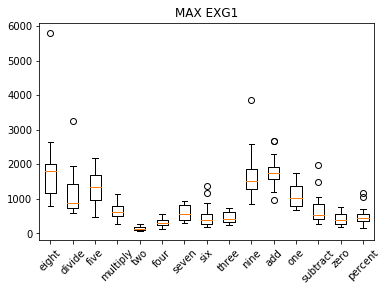

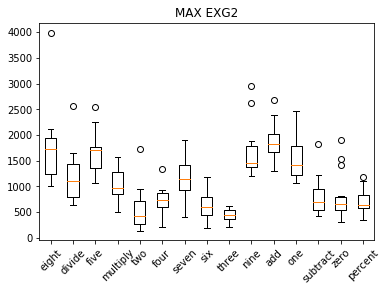

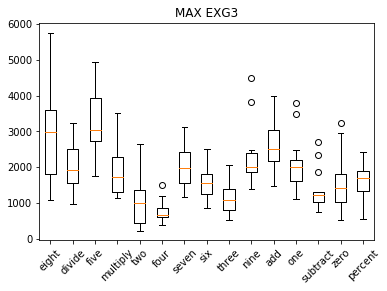

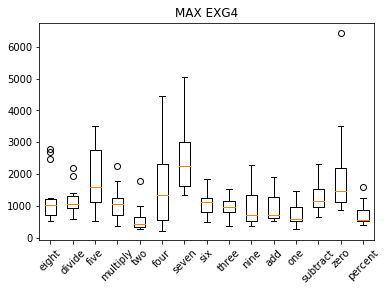

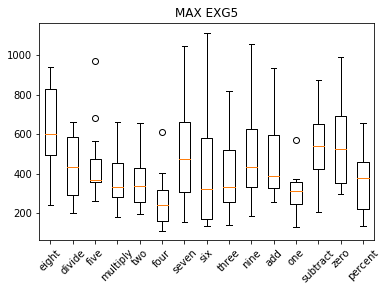

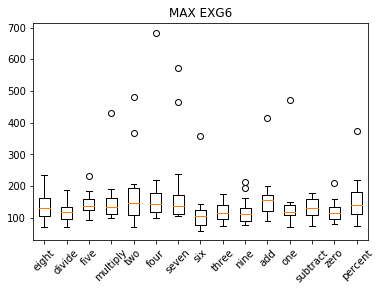

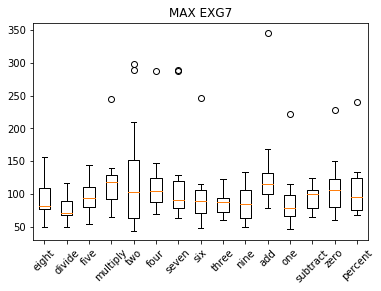

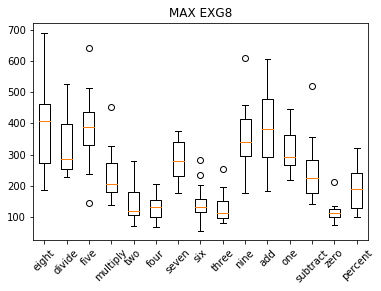

In [15]:
import numpy as np
import matplotlib.pyplot as plt

print(list(range(len(tar2id))))
#type_ = 0 # min
type_ = 1 # max
#type_ = 2 # energy
#plt.figure()
for e in range(8):
    data = [all_v[i][type_][e] for i in range(len(all_v)) ]
    #print(data)
    #print(data)
    #data = all_v[0,0]
    #data = [all_v[0,0][0],all_v[0,0][1],all_v[0,0][2],all_v[0,0][3],all_v[0,0][4],all_v[0,0][5],all_v[0,0][6],all_v[0,0][7],all_v[0,0][8]]
    #print(data)

    fig7, ax7 = plt.subplots()
    #ax = plt.subplot(4, 2, e + 1)
    
    ax7.set_title(("MIN " if type_ == 0 else ("MAX " if type_ == 1 else "ENERGY ")) + EMG_L[e])
    ax7.boxplot(data)
    #ax7.set_xticks(np.array(tar2id.keys()))
    
    plt.xticks(np.arange(len(tar2id)) + 1,list(tar2id.keys()),rotation = 45)
    plt.show()


In [16]:
def show_all_plots(BIO_EEG, BIO_EMG, EEG_L, EMG_L, description = "", use_same_scale=True):#, window_bio, window_aud, noverlap):
    line_w = 3 # How many free (black) points (as separation) in figures between 2 electrodes    
    
    if True: #EMG
        emg_mel_banks_count = 10        
        emg_down_s = 1
        emg_time_down = 1./4        
        #emg_down_s = 4
        #emg_time_down = 1./1
        emg_window  = 64; emg_window  = int(emg_window  / emg_time_down)
        #emg_overlap = 32; emg_overlap = emg_window - emg_overlap*2 
        emg_overlap = 32; emg_overlap = emg_window - emg_overlap 
        #emg_overlap = 32; emg_overlap = int(emg_overlap / emg_time_down)
                        
        show_data("EMG " + description, BIO_EMG,EMG_L, fs = BIO_fs, win_len= emg_window/float(BIO_fs) * emg_down_s, use_same_scale=use_same_scale) 
        
        # Spectral analysis                
        if False: 
            # if no need for line separation, use this
            emg_spect = get_spect(BIO_EMG[:][:,::emg_down_s], emg_window, emg_overlap)
            #emg_spect = get_spect(BIO_EMG[:][:,::emg_down_s], emg_window, emg_overlap, use_log = False)
            emg_mb = get_bio_mel_bank(BIO_EMG[:][:,::emg_down_s], emg_window, emg_overlap, emg_mel_banks_count, int(BIO_fs/emg_down_s))        
            add_emg_spect(emg_spect , "EMG " + description,((emg_window-emg_overlap)/float(BIO_fs)*emg_down_s)*emg_spect.shape[0], EMG_L)
            add_emg_mel(emg_mb , "EMG " + description,((emg_window-emg_overlap)/float(BIO_fs)*emg_down_s)*emg_mb.shape[0], EMG_L)

emg_spec_counter = 0
emg_mel_counter = 0
max_subplots = 3
col_subplots = 2
#window = 256
#noverlap = 128

# TODO: resample if want any frequencies
# 32  * 64 = 2048
# 125 * 64 = 8000

# 64  * 32 = 2048 31.25 s 
# 250 * 32 = 8000

def add_spect(fig_counter, spect, name, duration, labels = None, draw_line = False, line_max = 8, line_sampl = 20, line_w = 4):
    ax = plt.subplot(max_subplots, col_subplots, fig_counter)
    ax.set_title(name)
    
    if draw_line:
        for i in range(1,line_max):
            ax.axhspan((line_sampl + line_w)*i - line_w + 1.5, (line_sampl + line_w)*i - 0.5,color="black")
        ax.set_yticks([(line_sampl + line_w)*(i + 0.5) for i in range(line_max)])
        ax.set_yticklabels(labels)
        ax.set_xlabel("Time [s]")
    #plt.figure(figsize = figsize)
    plt.tight_layout()

    plt.imshow(spect.T,aspect='auto',extent=[0,duration,spect.shape[1],0]);plt.gca().invert_yaxis()
    
def add_emg_spect(*args):    
    global emg_spec_counter
    emg_spec_counter += 1
    plt.figure(emg_spect_fig_name) 
    add_spect(emg_spec_counter, *args)
    
def add_emg_mel(*args):
    global emg_mel_counter
    emg_mel_counter += 1
    plt.figure(emg_mel_fig_name) 
    add_spect(emg_mel_counter, *args)

emg_spect_fig_name = "EMG_spect"
emg_mel_fig_name = "EMG_Mel"
i = 8


if VISUALIZE:

    print(tar2id)
    emg_spec_counter = 0
    emg_mel_counter = 0
    max_subplots = 8
    col_subplots = 2
    _ = plt.figure(emg_spect_fig_name, figsize = (6 * col_subplots,7 * max_subplots / col_subplots))
    _ = plt.figure(emg_mel_fig_name, figsize = (6 * col_subplots,7 * max_subplots / col_subplots))
            
#    for i in targ2id[id2targ[66]]:
#        show_all_plots(SEG_EEG[i], SEG_EMG[i], SEG_AUD[i], EEG_L, EMG_L, "sesssion " + str(sessionid) + " row " + str(i) + " - " + id2targ[i])
#        play_audio(SEG_AUD[i])
        
    num = 66
#    for i in tar2id[id2tar[0]][:15]:
    #for i in tar2id[id2tar[66]][:15]:
    #for i in tar2id[id2tar[12]][:15]:
#    for i in tar2id[id2tar[12]][:15]:
    for i in [0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 24, 26, 30]:
#    for i in test_ids:
#        show_all_plots(SEG_EEG[i], SEG_EMG[i], EEG_L, EMG_L, "Session " + str(sessionid) + " row " + str(i) + " - " + id2tar[i])
        show_all_plots(SEG_EEG[i], data[i], EEG_L, EMG_L, "Session " + str(sessionid) + " row " + str(i) + " - " + id2tar[i], use_same_scale=False)
        #play_audio(SEG_AUD[i])


{'eight': [0, 1, 48, 49, 79, 80, 103, 104, 149, 150, 159, 160, 198, 199], 'divide': [2, 3, 36, 37, 52, 53, 107, 108, 139, 140, 173, 174, 187, 188], 'five': [4, 5, 33, 77, 78, 97, 98, 161, 162, 163, 164, 189, 190, 208, 209], 'multiply': [6, 7, 40, 41, 72, 73, 105, 106, 131, 132, 151, 152, 169, 170], 'two': [8, 9, 46, 47, 89, 90, 115, 116, 129, 130, 147, 148, 202, 203], 'four': [10, 11, 62, 63, 66, 67, 111, 112, 135, 136, 185, 186, 191, 192], 'seven': [12, 13, 38, 39, 56, 57, 109, 110, 117, 118, 175, 176, 193, 194], 'six': [14, 15, 58, 59, 64, 65, 99, 100, 133, 134, 145, 146, 204, 205], 'three': [16, 17, 50, 51, 68, 69, 93, 94, 137, 138, 171, 172, 177, 178], 'nine': [18, 19, 42, 43, 85, 86, 87, 88, 127, 128, 157, 158, 181, 182], 'add': [20, 21, 32, 74, 113, 114, 119, 120, 153, 154, 165, 166, 195, 196], 'one': [22, 23, 34, 35, 75, 76, 83, 84, 125, 126, 141, 142, 200, 201], 'subtract': [24, 25, 28, 29, 81, 82, 91, 92, 121, 122, 167, 168, 179, 180, 197], 'zero': [26, 27, 44, 45, 60, 61, 95,

NameError: name 'show_data' is not defined

<Figure size 864x2016 with 0 Axes>

<Figure size 864x2016 with 0 Axes>

# RawNet

## Architecture 

In [9]:
import inspect
import numpy as np
import keras
import tensorflow as tf
from keras import regularizers, optimizers, utils, models, initializers, constraints
from keras.layers import Conv1D, Conv2D, MaxPooling1D, GlobalAveragePooling1D, BatchNormalization, Dense, Activation, Input, Add, Dropout, LeakyReLU, GRU
import keras.backend as K
from keras.models import Model
from keras.engine.topology import Layer
from keras.activations import softmax
import os


code_directory = "/Users/martinsustek/Downloads/RawNet-master/"

    

def simple_loss(y_true, y_pred):
    return K.mean(y_pred)

def zero_loss(y_true, y_pred):
    return 0.5 * K.sum(y_pred, axis=0)

class spk_basis_loss(Dense):
    def __init__(self, units,
                s = 5.,
                kernel_initializer='glorot_uniform',
                kernel_regularizer=None,
                kernel_constraint=None,
                **kwargs):
        if 'input_shape' not in kwargs and 'input_dim' in kwargs:
            kwargs['input_shape'] = (kwargs.pop('input_dim'),)
        super(Dense, self).__init__(**kwargs)
        self.units = units
        self.s = s

        self.kernel_initializer = initializers.get(kernel_initializer)
        self.kernel_regularizer = regularizers.get(kernel_regularizer)
        self.kernel_constraint = constraints.get(kernel_constraint)


    def build(self, input_shape):
        assert len(input_shape[0]) >= 2
        input_dim = input_shape[0][-1]

        self.kernel = self.add_weight(shape=(input_dim, self.units),
                                      initializer=self.kernel_initializer,
                                      name='kernel',
                                      regularizer=self.kernel_regularizer,
                                      constraint=self.kernel_constraint)
        self.bias = None
        self.built = True


    def call(self, inputs):
        inputs_x = inputs[0]
        inputs_y = inputs[1]

        input_length = K.sum(inputs_x**2., axis = 1, keepdims = True)**0.5
        input_length /= self.s ** 0.5
        input_length += 0.0001

        kernel_length = K.sum(self.kernel**2., axis = 0, keepdims = True)**0.5
        kernel_length /= self.s ** 0.5
        kernel_length += 0.0001

        inputs_norm = inputs_x / input_length
        kernel_norm = self.kernel / kernel_length

        label_onehot = inputs_y
        negative_mask = tf.fill([self.units, self.units], 1.) - tf.eye(self.units)
        # shape = [#spk, #spk]

        loss_BS = K.mean(tf.matmul(kernel_norm, kernel_norm,
            adjoint_a = True # transpose second matrix
            ) * negative_mask  ) 

        inner_output = K.dot(inputs_x, self.kernel)
        softmax_output = softmax(inner_output)
        #loss_s = K.categorical_crossentropy(inputs_y, softmax_output)

        return [softmax_output, loss_BS]


    def compute_output_shape(self, input_shape):
        return [(input_shape[0][0], self.units), (input_shape[0][0], 1)]



class CenterLossLayer(Layer):

    def __init__(self, alpha, nb_center, dim_embd, **kwargs):
        super().__init__(**kwargs)
        self.alpha = alpha
        self.nb_center = nb_center
        self.dim_embd = dim_embd

    def build(self, input_shape):
        self.centers = self.add_weight(name='centers',
                   shape=(self.nb_center, self.dim_embd),
                   initializer='uniform',
                   trainable=False)
        super().build(input_shape)

    def call(self, x, mask=None):

        delta_centers = K.dot(K.transpose(x[1]), (K.dot(x[1], self.centers) - x[0]))  # 10x2
        center_counts = K.sum(K.transpose(x[1]), axis=1, keepdims=True) + 1  # 10x1
        delta_centers /= center_counts
        new_centers = self.centers - self.alpha * delta_centers
        self.add_update((self.centers, new_centers), x)

        self.result = x[0] - K.dot(x[1], self.centers)
        self.result = K.sum(self.result ** 2, axis=1, keepdims=True) #/ K.dot(x[1], center_counts)
        return self.result # Nx1

    def compute_output_shape(self, input_shape):
        return K.int_shape(self.result)

def residual_block_conv(input_tensor, filters = [], initializer = None, regularizer = None, base_name = None,
                        use_bn = True, ker_s1 = 3, ker_s2 = 3, use_res = True):

    x = Conv1D(filters[0], ker_s1, strides = 1, activation = None,
               kernel_initializer = initializer, kernel_regularizer = regularizer,
               padding = 'same', name = base_name+'_Conv1')(input_tensor)
    if use_bn:
        x = BatchNormalization(name=base_name+'_BN1')(x)
    x = LeakyReLU(name=base_name+'_Act1')(x)

    x = Conv1D(filters[1], ker_s2, strides = 1, activation = None,
               kernel_initializer = initializer, kernel_regularizer = regularizer,
               padding = 'same', name = base_name+'_Conv2')(x)
    if use_bn:
        x = BatchNormalization(name=base_name+'_BN2')(x)

    #in this case: set filter length to 1
    if use_res:
        if K.int_shape(input_tensor)[-1] != K.int_shape(x)[-1]:
            input_tensor = Conv1D(filters[1], 1, strides=1, activation = None,
                   kernel_initializer = initializer, kernel_regularizer = regularizer,
                   padding = 'same', name = base_name+'_transform')(input_tensor)
            if use_bn:
                input_tensor = BatchNormalization(name=base_name+'_BN_transform')(input_tensor)
        x = Add()([input_tensor, x])
    x = LeakyReLU(name=base_name+'_Act2')(x)

    return x

ModuleNotFoundError: No module named 'tensorflow'

### RawNet Pretrain

In [18]:
def get_model_RawNetPretrain(argDic, dim_input):
    inputs = Input(shape = (None, dim_input), name='input')
    c_input = Input(shape = (argDic['nb_classes'],))

    #strided Conv
    x = Conv1D(argDic['nb_s_conv_filt'], 3, strides=3,
            activation = None,
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            padding = 'valid',
            name = 'strided_conv')(inputs)
    if USE_BN:
        x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    for i in range(1, 3):
        x = residual_block_conv(x, argDic['nb_conv_filt'][0],
            initializer = argDic['initializer'],
            regularizer = regularizers.l2(argDic['wd']),
            base_name = 'res_conv_block_%d'%i,use_bn = USE_BN, use_res = USE_RESID)
        x = MaxPooling1D(pool_size=3)(x)

    for i in range(3, 7):
        x = residual_block_conv(x, argDic['nb_conv_filt'][1],
            initializer = argDic['initializer'],
            regularizer = regularizers.l2(argDic['wd']),
            base_name = 'res_conv_block_%d'%i,use_bn = USE_BN, use_res = USE_RESID)
        x = MaxPooling1D(pool_size=3)(x)

    x = residual_block_conv(x, argDic['nb_conv_filt'][2],
        initializer = argDic['initializer'],
        regularizer = regularizers.l2(argDic['wd']),
        base_name = 'res_conv_block_9',use_bn = USE_BN, use_res = USE_RESID)
#WTF???
#    x = MaxPooling1D(pool_size=3)(x)

    x = Conv1D(argDic['nb_conv_filt'][3], 1, strides=1,
            activation = None,
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            padding = 'same',
            name = 'last_conv')(x)
    if USE_BN:
        x = BatchNormalization(axis=-1)(x)
    x = LeakyReLU()(x)

    x = Dropout(0.5)(x)
    x = GlobalAveragePooling1D()(x)

    for i in range(len(argDic['nb_dense_node'])):
        if i == len(argDic['nb_dense_node']) -1:
            name = 'code'
        else:
            name = 'dense_act_%d'%(i+1)
        x = Dense(argDic['nb_dense_node'][i],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']))(x)
        if USE_BN:
            x = BatchNormalization(axis=-1)(x)
        x = LeakyReLU(name = name)(x)

    softmax_output, s_bs_out = spk_basis_loss(units = argDic['nb_classes'],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            name = 's_bs_loss')([x, c_input])

    c_out = CenterLossLayer(alpha = argDic['c_alpha'],
            nb_center = argDic['nb_classes'],
            dim_embd = argDic['nb_dense_node'][-1],
            name='c_loss')([x, c_input])

    return [Model(inputs=[inputs, c_input], output=[s_bs_out, c_out, softmax_output]), inspect.stack()[0][3].split("_")[-1]]

### RawNet with GRU

In [19]:
def get_model_RawNetGru(argDic, dim_input):
    inputs = Input(shape = (None, dim_input), name='input')
    c_input = Input(shape = (argDic['nb_classes'],))

    #strided Conv
    x = Conv1D(argDic['nb_s_conv_filt'], 3, strides=3,
            activation = None,
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            padding = 'valid',
            name = 'strided_conv')(inputs)
    if USE_BN:
        x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    for i in range(1, 3):
        x = residual_block_conv(x, argDic['nb_conv_filt'][0],
            initializer = argDic['initializer'],
            regularizer = regularizers.l2(argDic['wd']),
            base_name = 'res_conv_block_%d'%i,use_bn = USE_BN, use_res = USE_RESID)
        x = MaxPooling1D(pool_size=3)(x)

    for i in range(3, 7):
        x = residual_block_conv(x, argDic['nb_conv_filt'][1],
            initializer = argDic['initializer'],
            regularizer = regularizers.l2(argDic['wd']),
            base_name = 'res_conv_block_%d'%i,use_bn = USE_BN, use_res = USE_RESID)
        x = MaxPooling1D(pool_size=3)(x)

    for i in range(0, len(argDic['nb_gru_node'])):
        r_seq = False if i == len(argDic['nb_gru_node']) -1 else True
        x = GRU(argDic['nb_gru_node'][i],
            activation='tanh',
            recurrent_activation='hard_sigmoid',
            kernel_initializer='glorot_uniform',
            recurrent_initializer='orthogonal',
            kernel_regularizer=regularizers.l2(argDic['wd']),
            recurrent_regularizer=regularizers.l2(argDic['wd']),
            dropout=0.0,
            recurrent_dropout=argDic['req_drop'],
            implementation=1,
            return_sequences= r_seq,
            go_backwards=False,
            reset_after=False,
            name = 'gru_%d'%i)(x)

    for i in range(len(argDic['nb_dense_node'])):
        if i == len(argDic['nb_dense_node']) -1:
            name = 'code'
        else:
            name = 'gru_dense_act_%d'%(i+1)
        x = Dense(argDic['nb_dense_node'][i],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            name = 'gru_dense_%d'%i)(x)
        if USE_BN:
            x = BatchNormalization(axis=-1, name='gru_BN_%d'%i)(x)
        x = LeakyReLU(name = name)(x)

    softmax_output, s_bs_out = spk_basis_loss(units = argDic['nb_classes'],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            name = 's_bs_loss')([x, c_input])

    c_out = CenterLossLayer(alpha = argDic['c_alpha'],
            nb_center = argDic['nb_classes'],
            dim_embd = argDic['nb_dense_node'][-1],
            name='c_loss')([x, c_input])

    return [Model(inputs=[inputs, c_input], output=[s_bs_out, c_out, softmax_output]), inspect.stack()[0][3].split("_")[-1]]







### RawNet with GRU - small

In [20]:
def get_model_RawNetGruSmall(argDic, dim_input):
    inputs = Input(shape = (None, dim_input), name='input')
    c_input = Input(shape = (argDic['nb_classes'],))

    #strided Conv
    x = Conv1D(argDic['nb_s_conv_filt'], 5,
            activation = None,
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            padding = 'valid',
            name = 'strided_conv')(inputs)
    if USE_BN:
        x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    for i in range(1, 3):
        x = residual_block_conv(x, [32,32],
            initializer = argDic['initializer'],
            regularizer = regularizers.l2(argDic['wd']),
            base_name = 'res_conv_block_%d'%i,use_bn = USE_BN, use_res = USE_RESID)
        x = MaxPooling1D(pool_size=3)(x)


    for i in range(0, len(argDic['nb_gru_node'])):
        r_seq = False if i == len(argDic['nb_gru_node']) -1 else True
        x = GRU(argDic['nb_gru_node'][i],
            activation='tanh',
            recurrent_activation='hard_sigmoid',
            kernel_initializer='glorot_uniform',
            recurrent_initializer='orthogonal',
            kernel_regularizer=regularizers.l2(argDic['wd']),
            recurrent_regularizer=regularizers.l2(argDic['wd']),
            dropout=0.0,
            recurrent_dropout=argDic['req_drop'],
            implementation=1,
            return_sequences= r_seq,
            go_backwards=False,
            reset_after=False,
            name = 'gru_%d'%i)(x)

    for i in range(len(argDic['nb_dense_node'])):
        if i == len(argDic['nb_dense_node']) -1:
            name = 'code'
        else:
            name = 'gru_dense_act_%d'%(i+1)
        x = Dense(argDic['nb_dense_node'][i],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            name = 'gru_dense_%d'%i)(x)
        if USE_BN:
            x = BatchNormalization(axis=-1, name='gru_BN_%d'%i)(x)
        x = LeakyReLU(name = name)(x)

    softmax_output, s_bs_out = spk_basis_loss(units = argDic['nb_classes'],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            name = 's_bs_loss')([x, c_input])

    c_out = CenterLossLayer(alpha = argDic['c_alpha'],
            nb_center = argDic['nb_classes'],
            dim_embd = argDic['nb_dense_node'][-1],
            name='c_loss')([x, c_input])

    return [Model(inputs=[inputs, c_input], output=[s_bs_out, c_out, softmax_output]), inspect.stack()[0][3].split("_")[-1]]







### RawNet with GRU - smaller

In [21]:
def get_model_RawNetGruSmaller(argDic, dim_input):
    inputs = Input(shape = (None, dim_input), name='input')
    c_input = Input(shape = (argDic['nb_classes'],))

    #strided Conv
    x = Conv1D(argDic['nb_s_conv_filt'], 3,
            activation = None,
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            padding = 'valid',
            name = 'strided_conv')(inputs)
    if USE_BN:
        x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    for i in range(1, 4):
        x = residual_block_conv(x, [32,32],
            initializer = argDic['initializer'],
            regularizer = regularizers.l2(argDic['wd']),
            base_name = 'res_conv_block_%d'%i,use_bn = USE_BN, use_res = USE_RESID, ker_s1 = 3, ker_s2 = 3)
        x = MaxPooling1D(pool_size=3)(x)


    for i in range(0, len(argDic['nb_gru_node'])):
        r_seq = False if i == len(argDic['nb_gru_node']) -1 else True
        x = GRU(argDic['nb_gru_node'][i],
            activation='tanh',
            recurrent_activation='hard_sigmoid',
            kernel_initializer='glorot_uniform',
            recurrent_initializer='orthogonal',
            kernel_regularizer=regularizers.l2(argDic['wd']),
            recurrent_regularizer=regularizers.l2(argDic['wd']),
            dropout=0.0,
            recurrent_dropout=argDic['req_drop'],
            implementation=1,
            return_sequences= r_seq,
            go_backwards=False,
            reset_after=False,
            name = 'gru_%d'%i)(x)

    for i in range(len(argDic['nb_dense_node'])):
        if i == len(argDic['nb_dense_node']) -1:
            name = 'code'
        else:
            name = 'gru_dense_act_%d'%(i+1)
        x = Dense(argDic['nb_dense_node'][i],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            name = 'gru_dense_%d'%i)(x)
        if USE_BN:
            x = BatchNormalization(axis=-1, name='gru_BN_%d'%i)(x)
        x = LeakyReLU(name = name)(x)

    softmax_output, s_bs_out = spk_basis_loss(units = argDic['nb_classes'],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            name = 's_bs_loss')([x, c_input])

    c_out = CenterLossLayer(alpha = argDic['c_alpha'],
            nb_center = argDic['nb_classes'],
            dim_embd = argDic['nb_dense_node'][-1],
            name='c_loss')([x, c_input])

    
    
    
    return [Model(inputs=[inputs, c_input], output=[s_bs_out, c_out, softmax_output]), inspect.stack()[0][3].split("_")[-1]]




### RawNet with GRU - each electrode separately

In [22]:

def get_model_RawNetGruElectSepar(argDic, dim_input):
    inputs = Input(shape = (None, dim_input), name='input')
    c_input = Input(shape = (argDic['nb_classes'],))


    # 1D shape - batch, len , 8/1 electr
    # --------------------> convolution over all electrodes + 
    
    # 2D shape - batch, len , 8/1 electr, 5 features 

    #strided Conv
    if len(dim_input) == 2:
        x = Conv2D(argDic['nb_s_conv_filt'], 3,
            activation = None,
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            padding = 'valid',
            name = 'strided_conv')(inputs)
        
    else:
        x = Conv1D(argDic['nb_s_conv_filt'], 3,
            activation = None,
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            padding = 'valid',
            name = 'strided_conv')(inputs)
    
    
    
    if USE_BN:
        x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    for i in range(1, 4):
        x = residual_block_conv(x, [32,32],
            initializer = argDic['initializer'],
            regularizer = regularizers.l2(argDic['wd']),
            base_name = 'res_conv_block_%d'%i,use_bn = USE_BN, use_res = USE_RESID, ker_s1 = 3, ker_s2 = 3)
        x = MaxPooling1D(pool_size=3)(x)


    for i in range(0, len(argDic['nb_gru_node'])):
        r_seq = False if i == len(argDic['nb_gru_node']) -1 else True
        x = GRU(argDic['nb_gru_node'][i],
            activation='tanh',
            recurrent_activation='hard_sigmoid',
            kernel_initializer='glorot_uniform',
            recurrent_initializer='orthogonal',
            kernel_regularizer=regularizers.l2(argDic['wd']),
            recurrent_regularizer=regularizers.l2(argDic['wd']),
            dropout=0.0,
            recurrent_dropout=argDic['req_drop'],
            implementation=1,
            return_sequences= r_seq,
            go_backwards=False,
            reset_after=False,
            name = 'gru_%d'%i)(x)

    for i in range(len(argDic['nb_dense_node'])):
        if i == len(argDic['nb_dense_node']) -1:
            name = 'code'
        else:
            name = 'gru_dense_act_%d'%(i+1)
        x = Dense(argDic['nb_dense_node'][i],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            name = 'gru_dense_%d'%i)(x)
        if USE_BN:
            x = BatchNormalization(axis=-1, name='gru_BN_%d'%i)(x)
        x = LeakyReLU(name = name)(x)

    softmax_output, s_bs_out = spk_basis_loss(units = argDic['nb_classes'],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            name = 's_bs_loss')([x, c_input])

    c_out = CenterLossLayer(alpha = argDic['c_alpha'],
            nb_center = argDic['nb_classes'],
            dim_embd = argDic['nb_dense_node'][-1],
            name='c_loss')([x, c_input])

    
    
    
    return [Model(inputs=[inputs, c_input], output=[s_bs_out, c_out, softmax_output]), inspect.stack()[0][3].split("_")[-1]]




### Repl features

In [23]:
from keras.layers.core import Reshape
from keras.backend import squeeze
from keras.layers import Lambda

def get_model_RawNetGruReplFeat(argDic, *dim_input):
    #print(dim_input)
    inputs = Input(shape = (None, *dim_input), name='input')
    c_input = Input(shape = (argDic['nb_classes'],))

    # 1D shape - batch, len , 8/1 electr
    # --------------------> convolution over all electrodes + 
    
    # 2D shape - batch, len , 8/1 electr, 5 features 

    #strided Conv
    
    #rows, cols, channels
    #print(inputs)
    if len(dim_input) == 2:
        x = Conv2D(argDic['nb_s_conv_filt'], (3, dim_input[0]),
            activation = None,
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            padding = 'valid',
            name = 'strided_conv')(inputs)
        #print(x.shape)
        #print(x.shape.as_list())
        #print(x.shape[:2])
        #print(x.shape[3:])
        #print((*x.shape[:2],x.shape[3]))
        #x = Reshape((None,None,-1))(x)
        #tf.keras.backend.squeeze(x,axis)


        x = Lambda(lambda xx: squeeze(xx, 2))(x)  # remove the dummy dimension
        #print(x.shape)
        #print(K.backend())

        #inputs.
        #x = Conv1D(argDic['nb_s_conv_filt'], 3,
        #    activation = None,
        #    kernel_initializer = argDic['initializer'],
        #    kernel_regularizer = regularizers.l2(argDic['wd']),
        #    padding = 'valid',
        #    name = 'strided_conv')(inputs)
        
    else:
        
        x = Conv1D(argDic['nb_s_conv_filt'], 3,
            activation = None,
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            padding = 'valid',
            name = 'strided_conv')(inputs)
    
    #K.print_tensor(x, message="x is: ")
    #print("AAA")
    #print(x.shape)
    if USE_BN:
        x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    for i in range(1, 4):
        x = residual_block_conv(x, [32,32],
            initializer = argDic['initializer'],
            regularizer = regularizers.l2(argDic['wd']),
            base_name = 'res_conv_block_%d'%i,use_bn = USE_BN, use_res = USE_RESID, ker_s1 = 3, ker_s2 = 3)
        x = MaxPooling1D(pool_size=3)(x)


    for i in range(0, len(argDic['nb_gru_node'])):
        r_seq = False if i == len(argDic['nb_gru_node']) -1 else True
        x = GRU(argDic['nb_gru_node'][i],
            activation='tanh',
            recurrent_activation='hard_sigmoid',
            kernel_initializer='glorot_uniform',
            recurrent_initializer='orthogonal',
            kernel_regularizer=regularizers.l2(argDic['wd']),
            recurrent_regularizer=regularizers.l2(argDic['wd']),
            dropout=0.0,
            recurrent_dropout=argDic['req_drop'],
            implementation=1,
            return_sequences= r_seq,
            go_backwards=False,
            reset_after=False,
            name = 'gru_%d'%i)(x)

    for i in range(len(argDic['nb_dense_node'])):
        if i == len(argDic['nb_dense_node']) -1:
            name = 'code'
        else:
            name = 'gru_dense_act_%d'%(i+1)
        x = Dense(argDic['nb_dense_node'][i],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            name = 'gru_dense_%d'%i)(x)
        if USE_BN:
            x = BatchNormalization(axis=-1, name='gru_BN_%d'%i)(x)
        x = LeakyReLU(name = name)(x)

    softmax_output, s_bs_out = spk_basis_loss(units = argDic['nb_classes'],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            name = 's_bs_loss')([x, c_input])

    c_out = CenterLossLayer(alpha = argDic['c_alpha'],
            nb_center = argDic['nb_classes'],
            dim_embd = argDic['nb_dense_node'][-1],
            name='c_loss')([x, c_input])

    
    
    
    return [Model(inputs=[inputs, c_input], outputs=[s_bs_out, c_out, softmax_output]), inspect.stack()[0][3].split("_")[-1]]




### Repl features - small

In [71]:
from keras.layers.core import Reshape
from keras.backend import squeeze
from keras.layers import Lambda

def get_model_RawNetGruReplFeatSmall(argDic, *dim_input):
    #print(dim_input)
    inputs = Input(shape = (None, *dim_input), name='input')
    c_input = Input(shape = (argDic['nb_classes'],))

    # 1D shape - batch, len , 8/1 electr
    # --------------------> convolution over all electrodes + 
    
    # 2D shape - batch, len , 8/1 electr, 5 features 

    #strided Conv
    
    #rows, cols, channels
    if len(dim_input) == 2:
        x = Conv2D(argDic['nb_s_conv_filt'], (argDic['ker_len_conv_filt'], dim_input[0]),
            activation = None,
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            padding = 'valid',
            name = 'strided_conv')(inputs)
        x = Lambda(lambda xx: squeeze(xx, 2))(x)  # remove the dummy dimension

    else:
        
        x = Conv1D(argDic['nb_s_conv_filt'], 3,
            activation = None,
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            padding = 'valid',
            name = 'strided_conv')(inputs)
    
    if USE_BN:
        x = BatchNormalization()(x)
    x = LeakyReLU()(x)

    for i in range(1, 1):
        x = residual_block_conv(x, [32,32],
            initializer = argDic['initializer'],
            regularizer = regularizers.l2(argDic['wd']),
            base_name = 'res_conv_block_%d'%i,use_bn = USE_BN, use_res = USE_RESID, ker_s1 = 3, ker_s2 = 3)
        x = MaxPooling1D(pool_size=3)(x)


    for i in range(0, len(argDic['nb_gru_node'])):
        r_seq = False if i == len(argDic['nb_gru_node']) -1 else True
        x = GRU(argDic['nb_gru_node'][i],
            activation='tanh',
            recurrent_activation='hard_sigmoid',
            kernel_initializer='glorot_uniform',
            recurrent_initializer='orthogonal',
            kernel_regularizer=regularizers.l2(argDic['wd']),
            recurrent_regularizer=regularizers.l2(argDic['wd']),
            dropout=0.0,
            recurrent_dropout=argDic['req_drop'],
            implementation=1,
            return_sequences= r_seq,
            go_backwards=False,
            reset_after=False,
            name = 'gru_%d'%i)(x)

    for i in range(len(argDic['nb_dense_node'])):
        if i == len(argDic['nb_dense_node']) -1:
            name = 'code'
        else:
            name = 'gru_dense_act_%d'%(i+1)
        x = Dense(argDic['nb_dense_node'][i],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            name = 'gru_dense_%d'%i)(x)
        if USE_BN:
            x = BatchNormalization(axis=-1, name='gru_BN_%d'%i)(x)
        x = LeakyReLU(name = name)(x)

    softmax_output, s_bs_out = spk_basis_loss(units = argDic['nb_classes'],
            kernel_initializer = argDic['initializer'],
            kernel_regularizer = regularizers.l2(argDic['wd']),
            name = 's_bs_loss')([x, c_input])

    c_out = CenterLossLayer(alpha = argDic['c_alpha'],
            nb_center = argDic['nb_classes'],
            dim_embd = argDic['nb_dense_node'][-1],
            name='c_loss')([x, c_input])

    
    
    
    return [Model(inputs=[inputs, c_input], outputs=[s_bs_out, c_out, softmax_output]), inspect.stack()[0][3].split("_")[-1]]




In [25]:


replicated_features

[array([[[ 7.84740478e+03,  3.64201180e+01, -8.82766029e+01,
           4.56916427e+00,  1.10000000e+01],
         [ 9.95426052e+03,  2.63418832e+01, -9.92175889e+01,
           3.98047116e+00,  1.40000000e+01],
         [ 1.27681023e+04,  2.54564102e+01, -1.12474064e+02,
           4.06951162e+00,  1.40000000e+01],
         ...,
         [ 1.33739593e+03,  1.04686315e+02,  3.64688147e+01,
           8.09128298e+00,  4.00000000e+00],
         [ 1.20287786e+03,  3.29348808e+01,  3.43724111e+01,
           4.75771680e+00,  6.00000000e+00],
         [ 8.97511728e+02,  2.59220235e+01,  2.97597398e+01,
           4.05769501e+00,  9.00000000e+00]],
 
        [[ 3.01375149e+04,  2.66095277e+01, -1.73019891e+02,
           4.28395286e+00,  7.00000000e+00],
         [ 3.67083654e+04,  1.96902123e+01, -1.91069414e+02,
           3.72848265e+00,  9.00000000e+00],
         [ 4.43978981e+04,  1.65780666e+01, -2.10097318e+02,
           3.54807734e+00,  8.00000000e+00],
         ...,
         [ 1.29

## Training

In [36]:
def a(*b):
    print((None,*b))
a((1,2))

(None, (1, 2))


In [26]:
import os
import numpy as np
#np.random.seed(1016)
import yaml
import queue
import struct
import pickle as pk
from multiprocessing import Process
from threading import Thread
from tqdm import tqdm
from time import sleep
from keras.utils import multi_gpu_model, plot_model, to_categorical
from keras.optimizers import *
from keras.models import Model
#from sklearn.metrics import roc_curve
from scipy.optimize import brentq
from scipy.interpolate import interp1d


def cos_sim(a,b):
    return np.dot(a,b) / (np.linalg.norm(a) * np.linalg.norm(b))

def simple_loss(y_true, y_pred):
    return K.mean(y_pred)

def zero_loss(y_true, y_pred):
    return 0.5 * K.sum(y_pred, axis=0)

def compose_spkFeat_dic(lines, model, f_desc_dic, base_dir):
    '''
    Extracts speaker embeddings from a given model
    =====

    lines: (list) A list of strings that indicate each utterance
    model: (keras model) DNN that extracts speaker embeddings,
        output layer should be rmoved(model_pred)
    f_desc_dic: (dictionary) A dictionary of file objects
    '''
    dic_spkFeat = {}
    for line in tqdm(lines, desc='extracting spk feats'):
        k, f, p = line.strip().split(' ')
        p = int(p)
        if f not in f_desc_dic:
            f_tmp = '/'.join([base_dir, f])
            f_desc_dic[f] = open(f_tmp, 'rb')

        f_desc_dic[f].seek(p)
        l = struct.unpack('i', f_desc_dic[f].read(4))[0]# number of samples of each utterance
        utt = np.asarray(struct.unpack('%df'%l, f_desc_dic[f].read(l * 4)), dtype=np.float32)# read binary utterance 
        spkFeat = model.predict(utt.reshape(1,-1,1))[0]# extract speaker embedding from utt
        dic_spkFeat[k] = spkFeat

    return dic_spkFeat

def make_spkdic(lines):
    '''
    Returns a dictionary where
        key: (str) speaker name
        value: (int) unique integer for each speaker
    '''
    idx = 0
    dic_spk = {}
    list_spk = []
    for line in lines:
        k, f, p = line.strip().split(' ')
        spk = k.split('/')[0]
        if spk not in dic_spk:
            dic_spk[spk] = idx
            list_spk.append(spk)
            idx += 1
    return (dic_spk, list_spk)

def compose_batch(lines, data, dic_spk, nb_samp, samp_max_shift):
    '''
    Compose one mini-batch using utterances in `lines'

    nb_samp: (int) duration of utterance at train phase.
        Fixed for each mini-batch for mini-batch training.
    '''
    batch = []
    for line in lines:
        utt = np.swapaxes(data[line][EL_ST:EL_END],0,1)
        _nb_samp = len(utt)
        #print(_nb_samp)
        assert _nb_samp - samp_max_shift >= nb_samp
        cut = np.random.randint(low = 0, high = samp_max_shift)
        utt = utt[cut:cut+nb_samp,:]
        batch.append(utt)

    return (np.asarray(batch, dtype=np.float32), np.asarray([dic_spk[line] for line in lines]))

def process_epoch(lines, data, q, batch_size, dic_spk, nb_samp, samp_max_shift): 
    '''
    Wrapper function for processing mini-batches for the train set once.
    '''

    nb_batch = int(len(lines) / batch_size)
    for i in range(nb_batch):
        while True:
            if q.full():
                sleep(0.1)
            else:
                q.put(compose_batch(lines[i*batch_size: (i+1)*batch_size], data,
                    dic_spk, nb_samp,
                    samp_max_shift))
                break

    return







### Run
        

In [79]:
#ARCHITECTURE = "RawNetPretrain"
#ARCHITECTURE = "RawNetGru"
#ARCHITECTURE = "RawNetGruSmall"
#ARCHITECTURE = "RawNetGruSmaller"
#ARCHITECTURE = "RawNetGruReplFeat"
ARCHITECTURE = "RawNetGruReplFeatSmall"


USE_REPLICATED_FEATURES = True
#USE_REPLICATED_FEATURES = False

USE_ONLY_ONE_ELECTRODE = False
# Which one to use:
USE_ELECTRODE = 2

CONTINUE = False

USE_BN = False
USE_RESID = False

x = SEG_EMG

import datetime, time
    

#======================================================================#
#==Yaml load===========================================================#
#======================================================================#
def load_yaml(path):
    dir_yaml = path
    with open(dir_yaml, 'r') as f_yaml:
        parser = yaml.load(f_yaml)

    #dir_dev_scp = parser['dev_scp']
    #with open(dir_dev_scp, 'r') as f_dev_scp:
    #	dev_lines = f_dev_scp.readlines()
    #dic_spk, list_spk = make_spkdic(dev_lines)
    parser['ARCHITECTURE'] = ARCHITECTURE
    parser['USE_BN'] = USE_BN
    parser['USE_RESID'] = USE_RESID
    parser['USE_REPLICATED_FEATURES'] = USE_REPLICATED_FEATURES
    parser['CONTINUE'] = CONTINUE
    parser['model']['nb_classes'] = len(tar2id)
    #print('# spk: ', len(list_spk))
    parser['model']['batch_size'] = int(parser['batch_size'] / parser['nb_gpu'])
    assert parser['batch_size'] % parser['nb_gpu']  == 0
    parser['EMG_clipped_signal'] = EMG_signal_clipping

    return parser

print("Mohl bych jeste zkusit tu regularizaci ----> nejdriv nastavit velky a postupem casu snizovat (zvetsovat vahu xentropie)\n\
Zkusit nenormalizovat nebo poslat statistiky az nekam k rnn")

parser = load_yaml(os.path.join(code_directory,"01-trn_RawNet.yaml"))

# Normalization
data = SEG_EMG
if bool(parser['normalize_mean_per_electrode']):
    data = [d - np.mean(d,axis=1, keepdims= True) for d in data]
if bool(parser['normalize_variance_per_electrode']):
    data = [d /(np.std(d, axis=1, keepdims=True) + 0.001) for d in data]

# 
if USE_REPLICATED_FEATURES:
    data, _, window_shift = replicate_features(data)
    parser['nb_samp'] = parser['nb_samp'] // window_shift
    parser['samp_max_shift'] = parser['samp_max_shift'] // window_shift
    
# TODO: zkusit jen filtry o vysce 1

if True:
#for USE_ELECTRODE in range(8):
    if (USE_ONLY_ONE_ELECTRODE):
        EL_ST = USE_ELECTRODE
        EL_END = EL_ST + 1
        print('EL: %d'%(USE_ELECTRODE))
    else:
        EL_ST = None
        EL_END = None


    trials = train_ids
    val_trials = test_ids
    nb_batch = int(len(trials) / parser['batch_size'])

    global q
    q = queue.Queue(maxsize=1000)
    dummy_y = np.zeros((parser['batch_size'], 1))

    #======================================================================#
    #==Pre-train===========================================================#
    #======================================================================#
    if not CONTINUE:
        model_input_shape = 1 if USE_ONLY_ONE_ELECTRODE else 8
        if (USE_REPLICATED_FEATURES):
            model_input_shape = (model_input_shape,len(data[0][0][0]))
        else:
            model_input_shape = (model_input_shape,)
        #print(model_input_shape)
        model, m_name = eval("get_model_" + ARCHITECTURE + "(parser['model'],*model_input_shape)")
        model_pred = Model(inputs=model.get_layer('input').input, outputs=model.get_layer('code').output)
    else:
        print("!!! --- CONTINUING --- !!!\n\n")
    save_dir = base_dir + '/' + m_name + '_' + parser['name'] + '/' + datetime.datetime.fromtimestamp(time.time()).strftime('%Y-%m-%d_%H_%M') + "/"
    #make folders
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    with open(save_dir + 'summary.txt' ,'w+') as f_summary:
        model.summary(print_fn=lambda x: f_summary.write(x + '\n'))

    f_params = open(save_dir + 'f_params.txt', 'w')
    if CONTINUE:
        f_params.write('!!! --- CONTINUING --- !!!\n\n')
    for k, v in parser.items():
        print(k, v)
        f_params.write('{}:\t{}\n'.format(k, v))
    f_params.write('DNN model params\n')

    for k, v in parser['model'].items():
        f_params.write('{}:\t{}\n'.format(k, v))
    print(m_name)
    f_params.write('model_name: %s\n'%m_name)
    f_params.close()

    '''#uncomment to save model architecture in json
    model_json = model.to_json()
    with open(save_dir + 'arc.json', 'w') as f_json:
        f_json.write(model_json)
    '''

    if not os.path.exists(save_dir  + 'models/'):
        os.makedirs(save_dir + 'models/')


    #unzip for model graph visualization (need extra libraries)
    #plot_model(model, to_file=parser['save_dir'] +'visualization.png', show_shapes=True)

    optimizer = eval(parser['optimizer'])(lr=parser['lr'], decay = 0.0, amsgrad = bool(parser['amsgrad']))
    # THIS IS IN 2nd part of training in raw net!
    #parser['c_lambda'] = parser['c_lambda'] * 0.01

    if not CONTINUE:
#        if bool(parser['mg']):
#            model_mg = multi_gpu_model(model, gpus=parser['nb_gpu'])
#            model_mg.compile(optimizer = optimizer,
#                loss = {'s_bs_loss':simple_loss,
#                        'c_loss':zero_loss},
#                loss_weights = {'s_bs_loss':1, 'c_loss':parser['c_lambda']},
#                metrics=['accuracy'])
        model.compile(optimizer = optimizer,
                loss = [simple_loss, zero_loss, keras.losses.categorical_crossentropy],
                loss_weights = [parser['bs_lambda'], parser['c_lambda'], parser['xent_lambda']],
            metrics=['accuracy'])

    best_val_acc = 0.
    with open(save_dir + 'results.txt', 'w', buffering=1) as f_res:
        for epoch in range(parser['epoch']):
            np.random.shuffle(trials)
            p = Thread(target = process_epoch, args = (trials, data,
                                    q,
                                    parser['batch_size'],
                                    id2tar_id,
                                    parser['nb_samp'],
                                    parser['samp_max_shift']))
            p.start()

            #train one epoch!
            loss = 999.
            loss1 = 999.
            loss2 = 999.
            loss3 = 999.
            acc1 = acc2 = acc3 = 0
            pbar = range(nb_batch)
            for b in pbar:
                #pbar.set_description('epoch: %d, loss: %.3f, loss_bs: %.3f, loss_c: %.3f, loss_ce: %.3f, acc %.3f'%(epoch, loss, loss1, loss2 * parser['c_lambda'], loss3, acc3))
                while True:
                    if q.empty():
                        sleep(0.1)

                    else:
                        x, y = q.get()
                        y = to_categorical(y, num_classes=parser['model']['nb_classes'])
                        if bool(parser['mg']):
                            loss, loss1, loss2, acc1, acc2 = model_mg.train_on_batch([x, y], [dummy_y, dummy_y])
                        else:
                            #print(model.train_on_batch([x, y], [dummy_y, dummy_y, y]))
                            loss, loss1, loss2, loss3, acc1, acc2, acc3 = model.train_on_batch([x, y], [dummy_y, dummy_y, y])

                        break
            p.join()


            #validate!
    #        dic_val = compose_spkFeat_dic(lines = val_lines,
    #                            model = model_pred,
    #                            f_desc_dic = {},
    #                            base_dir = parser['base_dir'])
    #        y = []
    #        y_score = []
    #        for smpl in val_trials:
    #            target, spkMd, utt = smpl.strip().split(' ')
    #            target = int(target)
    #            cos_score = cos_sim(dic_val[spkMd], dic_val[utt])
    #            y.append(target)
    #            y_score.append(cos_score)
    #        fpr, tpr, thresholds = roc_curve(y, y_score, pos_label=1)
    #        eer = brentq(lambda x: 1. - x - interp1d(fpr, tpr)(x), 0., 1.)
    #        print('\nepoch: %d, val_eer: %f'%(int(epoch), eer))
    #        f_eer.write('%d %f '%(epoch, eer))
    #
    #        if float(eer) < best_val_eer:
    #            best_val_eer = float(eer)
    #            model.save_weights(save_dir +  'models_pretrn/best_model_on_validation.h5')
    #
    #
    #        #evaluate!
    #        dic_eval = compose_spkFeat_dic(lines = eval_lines,
    #                            model = model_pred,
    #                            f_desc_dic = {},
    #                            base_dir = parser['base_dir'])
    #
    #        f_res = open(save_dir + 'results_pretrn/epoch%s.txt'%(epoch), 'w')
    #        y = []
    #        y_score = []
    #        for smpl in trials:
    #            target, spkMd, utt = smpl.strip().split(' ')
    #            target = int(target)
    #            cos_score = cos_sim(dic_eval[spkMd], dic_eval[utt])
    #            y.append(target)
    #            y_score.append(cos_score)
    #            f_res.write('{score} {target}\n'.format(score=cos_score,target=target))
    #        f_res.close()
    #        fpr, tpr, thresholds = roc_curve(y, y_score, pos_label=1)
    #        '''
    #        #prints threshold
    #        #thresh = interp1d(fpr, thresholds)(eer)
    #        print(thresh)
    #        '''
    #        eer = brentq(lambda x: 1. - x - interp1d(fpr, tpr)(x), 0., 1.)
    #        print('\nepoch: %d, eer: %f'%(int(epoch), eer))
    #        f_eer.write('%f\n'%(eer))
    #
            min_len = np.min([data[rec].shape[1] for rec in val_trials])
            number_of_examples = len(val_trials)

            x = np.array([np.swapaxes(data[tr][EL_ST:EL_END,:min_len],0,1) for tr in val_trials])
            y = to_categorical([id2tar_id[i] for i in val_trials], num_classes=parser['model']['nb_classes'])
            val_dummy_y = np.zeros((number_of_examples, 1))

            val_res = model.evaluate([x, y],[val_dummy_y,val_dummy_y,y])
            val_acc = val_res[6]
            val_loss = val_res[3]

            print('epoch: %d, l: %.3f, l_bs: %.3f, l_c: %.3f, loss_ce: %.3f, acc: %.3f, val_acc: %.3f, val_loss_ce: %.3f'
                      %(epoch, loss, loss1 * parser['bs_lambda'], loss2 * parser['c_lambda'], loss3 * parser['xent_lambda'], acc3, val_acc, val_loss * parser['xent_lambda']))
            if float(val_acc) > best_val_acc:
                best_val_acc = val_acc
                model.save_weights(save_dir +  'models/best_model_on_validation.h5')


            if not bool(parser['save_best_only']):
                model.save_weights(save_dir +  'models/%d-%.4f.h5'%(epoch, val_acc))
            f_res.write('epoch: %d, l: %.3f, l_bs: %.3f, l_c: %.3f, loss_ce: %.3f, acc: %.3f, val_acc: %.3f, val_loss_ce: %.3f\n'%(epoch, loss, loss1, loss2 * parser['c_lambda'], loss3, acc3, val_acc, val_loss))

model3 = model

Mohl bych jeste zkusit tu regularizaci ----> nejdriv nastavit velky a postupem casu snizovat (zvetsovat vahu xentropie)
Zkusit nenormalizovat nebo poslat statistiky az nekam k rnn


/anaconda2/envs/python3/lib/python3.7/site-packages/ipykernel_launcher.py:32: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.


batch_size 32
normalize_variance_per_electrode 1
normalize_mean_per_electrode 1
nb_samp 200
samp_max_shift 25
base_dir /DB
optimizer Adam
opt_decay 0.0001
amsgrad 1
lr 0.001
epoch 60
save_dir /exp/model/networks/
name reproduce_RawNet
mg 0
nb_gpu 1
c_lambda 0.001
bs_lambda 5
xent_lambda 1
save_best_only 0
model {'nb_s_conv_filt': 128, 'ker_len_conv_filt': 6, 'initializer': 'he_normal', 'wd': 0.0001, 'nb_conv_filt': [[128, 128], [256, 256], [256, 256], 256], 'nb_dense_node': [64], 'c_alpha': 0.5, 'nb_gru_node': [1024], 'req_drop': 0.3, 'nb_classes': 15, 'batch_size': 32}
ARCHITECTURE RawNetGruReplFeatSmall
USE_BN False
USE_RESID False
USE_REPLICATED_FEATURES True
CONTINUE False
EMG_clipped_signal False
RawNetGruReplFeatSmall
30/30 [==============================] - 4s 129ms/step
epoch: 0, l: 3.804, l_bs: -0.418, l_c: 0.391, loss_ce: 3.661, acc: 0.000, val_acc: 0.067, val_loss_ce: 3.330
30/30 [==============================] - 2s 54ms/step
epoch: 1, l: 2.598, l_bs: -0.595, l_c: 0.114, lo

In [61]:
min_len = np.min([data[rec].shape[1] for rec in val_trials])

number_of_examples = len(val_trials)
print(number_of_examples)
print(min_len)

min_len = np.min([SEG_EMG[rec].shape[1] for rec in val_trials])
number_of_examples = len(val_trials)
print(number_of_examples)
print(min_len)
print()

print(len(data))
print(len(SEG_EMG))
print()
print(len(data[0]))
print(len(SEG_EMG[0]))

print()
print(len(data[0][0]))
print(len(SEG_EMG[0][0]))

print()
print(len(data[0][0][0]))

15
406
15
8233

210
210

8
8

407
8253

5


In [ ]:
min_len = np.min([data[rec].shape[1] for rec in val_trials])
number_of_examples = len(val_trials)

x = np.array([data[tr][EL_ST:EL_END,:min_len] for tr in val_trials])
y = [id2tar_id[i] for i in val_trials]
y = to_categorical(y, num_classes=parser['model']['nb_classes'])
val_dummy_y = np.zeros((number_of_examples, 1))


In [ ]:
#model.save_weights(save_dir +  'models_pretrn/%d-%.3f-%.3f-%.3f.h5'%(99, 0.478, -0.310, 152.995))
model, m_name = get_model_pretrn(parser['model'],1 if USE_ONLY_ONE_ELECTRODE else 8)
model_pred = Model(inputs=model.get_layer('input_pretrn').input, outputs=model.get_layer('code_pretrn').output)
model.load_weights(save_dir +  'models_pretrn/%d-%.3f-%.3f-%.3f.h5'%(99, 0.478, -0.310, 152.995), by_name = True)

In [181]:
number_of_examples = len(val_trials)

y = [10]
number_of_examples = 1

dummy_y = np.zeros((number_of_examples, 1))



#x = np.array([SEG_EMG[tr][2] for tr in val_trials])
#print(x)

#x, y = 
print(x.shape)
x = SEG_EMG[0][2].reshape(1,-1,1)

y = to_categorical(y, num_classes=parser['model']['nb_classes'])
print(y)
#y = y[3:4,:]
print(y.shape)
print(x.shape)
#print(model.predict([x, y]))
print(model.evaluate([x, y],[dummy_y,dummy_y,y]))
#print(model2.predict([x, y]))



(15, 8233, 1)
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
(1, 15)
(1, 8253, 1)
1/1 [==============================] - 0s 125ms/step
[2.5386855602264404, -0.01767111010849476, 29.491939544677734, 1.771310806274414, 1.0, 0.0, 1.0]


In [184]:
min_len = np.min([SEG_EMG[rec].shape[1] for rec in val_trials])
number_of_examples = len(val_trials)

x = np.array([SEG_EMG[tr][2][:min_len].reshape(-1,1) for tr in val_trials])
y = [id2tar_id[i] for i in val_trials]
y = to_categorical(y, num_classes=parser['model']['nb_classes'])
dummy_y = np.zeros((number_of_examples, 1))


print(model.evaluate([x, y],[dummy_y,dummy_y,y]))



15/15 [==============================] - 1s 67ms/step
[4.031569957733154, -0.01767111010849476, 397.3894958496094, 2.8962974548339844, 1.0, 0.0, 0.20000000298023224]


In [150]:
number_of_examples = len(val_trials)
dummy_y = np.zeros((number_of_examples, 1))
global q
q = queue.Queue(maxsize=1000)
p = Thread(target = process_epoch, args = (val_trials,
                        q,
                        number_of_examples,
                        id2tar_id,
                        parser['nb_samp'],
                        parser['samp_max_shift']))
p.start()



while True:
    if q.empty():
        sleep(0.1)
        print("a")
    else:
        print("b")
        x, y = q.get()
        print(x.shape)
        x = SEG_EMG[96][2].reshape(1,-1,1)
        print(x.shape)
        y = y[:1]
        dummy_y = np.zeros((len(y), 1))
        y = to_categorical(y, num_classes=parser['model']['nb_classes'])
        print(y)
        #y = y[3:4,:]
        print(y.shape)
        print(x.shape)
        print(model.predict([x, y]))
        print(model.evaluate([x, y],[dummy_y,dummy_y,y]))
        #print(model2.predict([x, y]))
        break
p.join()
print()

a
b
(15, 4000, 1)
(1, 8233, 1)
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
(1, 15)
(1, 8233, 1)
[array([-0.01767111], dtype=float32), array([[58.148277]], dtype=float32), array([[0.06435279, 0.00813395, 0.02426904, 0.01478574, 0.17055435,
        0.05001848, 0.02239194, 0.13869408, 0.05449242, 0.09845239,
        0.13579446, 0.0392353 , 0.13729979, 0.01887033, 0.02265488]],
      dtype=float32)]
1/1 [==============================] - 0s 87ms/step
[3.510331869125366, -0.01767111010849476, 29.074138641357422, 2.743374824523926, 1.0, 0.0, 0.0]



In [139]:
y = to_categorical(y, num_classes=parser['model']['nb_classes'])
model.predict([SEG_EMG[1][2],y])

ValueError: Error when checking input: expected input_pretrn to have 3 dimensions, but got array with shape (8233, 1)

In [ ]:
    
if False:
	#======================================================================#
	#==Train RawNet========================================================#
	#======================================================================#
	model, m_name = get_model(argDic = parser['model'])
	model_pred = Model(inputs=model.get_layer('input_RawNet').input, outputs=model.get_layer('code_RawNet').output)
	model.load_weights(save_dir+'models/best_model_on_validation.h5', by_name = True)


	with open(save_dir + 'summary_RawNet.txt' ,'w+') as f_summary:
		model.summary(print_fn=lambda x: f_summary.write(x + '\n'))
	
	if not os.path.exists(save_dir  + 'results_RawNet/'):
		os.makedirs(save_dir + 'results_RawNet/')
	if not os.path.exists(save_dir  + 'models_RawNet/'):
		os.makedirs(save_dir + 'models_RawNet/')
	f_eer = open(save_dir + 'eers_RawNet.txt', 'w', buffering=1)

	optimizer = eval(parser['optimizer'])(lr=parser['lr'], decay = parser['opt_decay'], amsgrad = bool(parser['amsgrad']))
	parser['c_lambda'] = parser['c_lambda'] * 0.01
	if bool(parser['mg']):
		model_mg = multi_gpu_model(model, gpus=parser['nb_gpu'])
		model_mg.compile(optimizer = optimizer,
			loss = {'gru_s_bs_loss':simple_loss,
					'gru_c_loss':zero_loss},
			loss_weights = {'gru_s_bs_loss':1, 'gru_c_loss':parser['c_lambda']},
			metrics=['accuracy'])
	model.compile(optimizer = optimizer,
			loss = {'gru_s_bs_loss':simple_loss,
					'gru_c_loss':zero_loss},
			loss_weights = {'gru_s_bs_loss':1, 'gru_c_loss': parser['c_lambda']},
		metrics=['accuracy'])
	
	best_val_eer = 99.
	for epoch in tqdm(range(parser['epoch'])):
		np.random.shuffle(dev_lines)
		p = Thread(target = process_epoch, args = (dev_lines,
								q,
								parser['batch_size'],
								parser['nb_samp'],
								dic_spk,
								parser['base_dir']))
		p.start()

		#train one epoch!
		loss = 999.
		loss1 = 999.
		loss2 = 999.
		pbar = tqdm(range(nb_batch))
		for b in pbar:
			pbar.set_description('epoch: %d, loss: %.3f, loss_s+bs: %.3f, loss_c: %.3f'%(epoch, loss, loss1, loss2))
			while True:
				if q.empty():
					sleep(0.1)
	
				else:
					x, y = q.get()
					y = to_categorical(y, num_classes=parser['model']['nb_classes'])
					if bool(parser['mg']):
						loss, loss1, loss2, acc1, acc2 = model_mg.train_on_batch([x, y], [dummy_y, dummy_y])
					else:
						loss, loss1, loss2, acc1, acc2 = model.train_on_batch([x, y], [dummy_y, dummy_y])
					
					break
		p.join()
	
		#validate!
		dic_val = compose_spkFeat_dic(lines = val_lines,
							model = model_pred,
							f_desc_dic = {},
							base_dir = parser['base_dir'])
		y = []
		y_score = []
		for smpl in val_trials:
			target, spkMd, utt = smpl.strip().split(' ')
			target = int(target)
			cos_score = cos_sim(dic_val[spkMd], dic_val[utt])
			y.append(target)
			y_score.append(cos_score)
		fpr, tpr, thresholds = roc_curve(y, y_score, pos_label=1)
		eer = brentq(lambda x: 1. - x - interp1d(fpr, tpr)(x), 0., 1.)
		print('\nepoch: %d, val_eer: %f'%(int(epoch), eer))
		f_eer.write('%d %f '%(epoch, eer))
		
		if float(eer) < best_val_eer:
			best_val_eer = float(eer)
			model.save_weights(save_dir +  'models_RawNet/best_model_on_validation.h5')
	
	
		#evaluate!
		dic_eval = compose_spkFeat_dic(lines = eval_lines,
							model = model_pred,
							f_desc_dic = {},
							base_dir = parser['base_dir'])
	
		f_res = open(save_dir + 'results_RawNet/epoch%s.txt'%(epoch), 'w')
		y = []
		y_score = []
		for smpl in trials:
			target, spkMd, utt = smpl.strip().split(' ')
			target = int(target)
			cos_score = cos_sim(dic_eval[spkMd], dic_eval[utt])
			y.append(target)
			y_score.append(cos_score)
			f_res.write('{score} {target}\n'.format(score=cos_score,target=target))
		f_res.close()
		fpr, tpr, thresholds = roc_curve(y, y_score, pos_label=1)
		'''
		#prints threshold
		#thresh = interp1d(fpr, thresholds)(eer)
		print(thresh)
		'''
		eer = brentq(lambda x: 1. - x - interp1d(fpr, tpr)(x), 0., 1.)
		print('\nepoch: %d, eer: %f'%(int(epoch), eer))
		f_eer.write('%f\n'%(eer))

		if not bool(parser['save_best_only']):
			model.save_weights(save_dir +  'models_RawNet/%d-%.4f.h5'%(epoch, eer))
	f_eer.close()

	#======================================================================#
	#==Extract RawNet Embeddings===========================================#
	#======================================================================#

	model.load_weights(save_dir + 'models_RawNet/best_model_on_validation.h5')
	if not os.path.exists(parser['gru_embeddings']):
		os.makedirs(parser['gru_embeddings'])

	print('Extracting Embeddings from GRU model: dev set')
	dev_dic_embeddings = compose_spkFeat_dic(lines = dev_lines,
		model = model_pred,
		f_desc_dic = {},
		base_dir = parser['base_dir'])

	print('Extracting Embeddings from GRU model: eval set')
	eval_dic_embeddings = compose_spkFeat_dic(lines = eval_lines,
		model = model_pred,
		f_desc_dic = {},
		base_dir = parser['base_dir'])

	f_embeddings = open(parser['gru_embeddings'] + 'speaker_embeddings_RawNet', 'wb')
	pk.dump({'dev_dic_embeddings': dev_dic_embeddings, 'eval_dic_embeddings': eval_dic_embeddings},
		f_embeddings,
		protocol = pk.HIGHEST_PROTOCOL)





# dummy

# dummy

In [202]:
import sys
def download_url(path, url):
    sys.stdout.write('Downloading from {4} into {path}\n')
    
download_url("a","b")

In [3]:
import numpy as np
a = np.arange(6).reshape(2,3) + 10

print(a.shape)
np.max(a, axis=0)

ModuleNotFoundError: No module named 'numpy'

In [51]:
import random

#Generate random number from interval (14,20) - float numbers
print(random.random()*6 + 14)

numpy.random.normal()

19.613873130020977


NameError: name 'numpy' is not defined

In [90]:
x = np.array([[[1,2,1,2], [3,4,1,2], [5,6,1,2]],[[1,2,1,2], [3,4,1,2], [5,6,1,2]]])
print()
print(x.shape)

print()
print(x.T.shape)


(2, 3, 4)

(4, 3, 2)


In [25]:
import numpy as np
a = np.array([0,10,20,30,40])
#a = np.array([0,100,200,300,400])
print(a.mean())
print(a.std())
print()


a = np.array([0,100,200,300,400])
print(a.mean())
print(a.std())

print()
print(a/a.std())

b = a/np.std(a)
print(a.mean()/np.std(a))
print(b.mean())


print(b)

print((a-a.mean())/a.std())

20.0
14.142135623730951

200.0
141.4213562373095

[0.         0.70710678 1.41421356 2.12132034 2.82842712]
1.414213562373095
1.414213562373095
[0.         0.70710678 1.41421356 2.12132034 2.82842712]
[-1.41421356 -0.70710678  0.          0.70710678  1.41421356]
